<a href="https://colab.research.google.com/github/rupinio/fastbook/blob/master/Chapter10/Image_colorization_test.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [28]:
!pip install torch_snippets
from torch_snippets import *
from torch_snippets.torch_loader import Report
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [11]:
from torchvision import datasets
import torch
data_folder = '~/cifar10/cifar/'
from torch.utils.data import DataLoader
datasets.CIFAR10(data_folder, download=True)

Files already downloaded and verified


Dataset CIFAR10
    Number of datapoints: 50000
    Root location: /root/cifar10/cifar/
    Split: Train

In [12]:
class Colorize(datasets.CIFAR10):
    def __init__(self, root, train):
        super().__init__(root, train)

    def __getitem__(self, ix):
        im, _ = super().__getitem__(ix)
        bw = im.convert('L').convert('RGB')
        bw, im = np.array(bw)/255., np.array(im)/255.
        bw, im = [torch.tensor(i).permute(2,0,1).to(device).float() for i in [bw,im]]
        return bw, im

trn_ds = Colorize('~/cifar10/cifar/', train=True)
val_ds = Colorize('~/cifar10/cifar/', train=False)

trn_dl = DataLoader(trn_ds, batch_size=256, shuffle=True)
val_dl = DataLoader(val_ds, batch_size=256, shuffle=False)

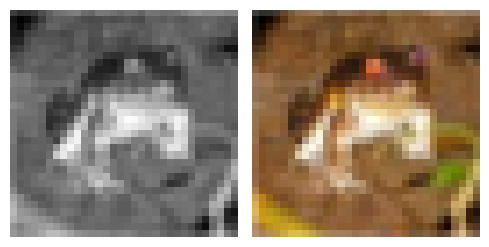

In [13]:
a,b = trn_ds[0]
subplots([a,b], nc=2)

In [21]:
import torch.nn as nn # import torch.nn as nn to define the nn module
import torch.optim as optim # import torch.optim as optim to use the Adam optimizer

class Identity(nn.Module):
    def __init__(self):
        super().__init__()
    def forward(self, x):
        return x

class DownConv(nn.Module):
    def __init__(self, ni, no, maxpool=True):
        super().__init__()
        self.model = nn.Sequential(
            nn.MaxPool2d(2) if maxpool else Identity(),
            nn.Conv2d(ni, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(no, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
        )
    def forward(self, x):
        return self.model(x)

class UpConv(nn.Module):
    def __init__(self, ni, no, maxpool=True):
        super().__init__()
        self.convtranspose = nn.ConvTranspose2d(ni, no, 2, stride=2)
        self.convlayers = nn.Sequential(
            nn.Conv2d(no+no, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(no, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
        )

    def forward(self, x, y):
        x = self.convtranspose(x)
        x = torch.cat([x,y], axis=1)
        x = self.convlayers(x)
        return x

class UNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.d1 = DownConv( 3, 64, maxpool=False)
        self.d2 = DownConv( 64, 128)
        self.d3 = DownConv( 128, 256)
        self.d4 = DownConv( 256, 512)
        self.d5 = DownConv( 512, 1024)
        self.u5 = UpConv (1024, 512)
        self.u4 = UpConv ( 512, 256)
        self.u3 = UpConv ( 256, 128)
        self.u2 = UpConv ( 128, 64)
        self.u1 = nn.Conv2d(64, 3, kernel_size=1, stride=1)

    def forward(self, x):
        x0 = self.d1( x) # 32
        x1 = self.d2(x0) # 16
        x2 = self.d3(x1) # 8
        x3 = self.d4(x2) # 4
        x4 = self.d5(x3) # 2
        X4 = self.u5(x4, x3)# 4
        X3 = self.u4(X4, x2)# 8
        X2 = self.u3(X3, x1)# 16
        X1 = self.u2(X2, x0)# 32
        X0 = self.u1(X1) # 3
        return X0

In [22]:
def get_model():
    model = UNet().to(device)
    optimizer = optim.Adam(model.parameters(), lr=1e-3)
    loss_fn = nn.MSELoss()
    return model, optimizer, loss_fn

In [23]:
def train_batch(model, data, optimizer, criterion):
    model.train()
    x, y = data
    _y = model(x)
    optimizer.zero_grad()
    loss = criterion(_y, y)
    loss.backward()
    optimizer.step()
    return loss.item()

@torch.no_grad()
def validate_batch(model, data, criterion):
    model.eval()
    x, y = data
    _y = model(x)
    loss = criterion(_y, y)
    return loss.item()

EPOCH: 0.250  trn_loss: 0.009  (15.41s - 6149.72s remaining)

EPOCH: 0.255  trn_loss: 0.008  (15.72s - 6144.70s remaining)

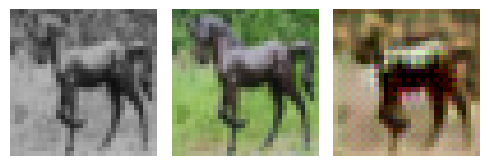

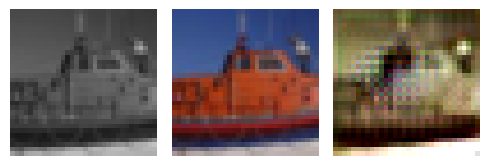

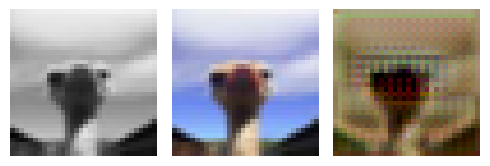

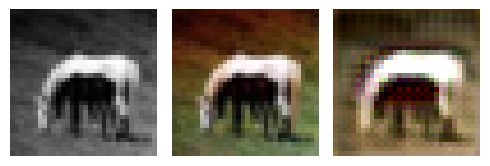

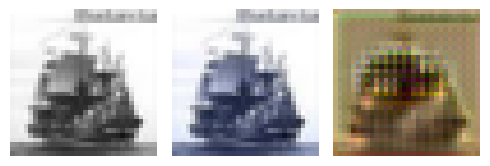

EPOCH: 0.505  trn_loss: 0.007  (31.59s - 6223.10s remaining)

EPOCH: 0.510  trn_loss: 0.008  (31.92s - 6223.50s remaining)

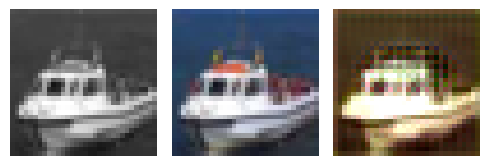

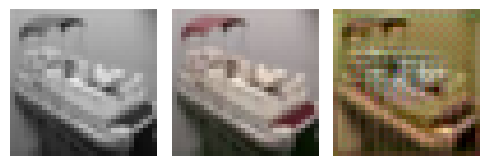

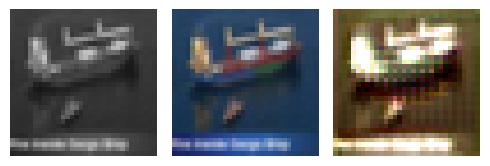

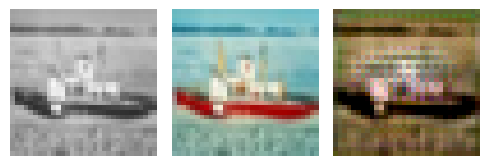

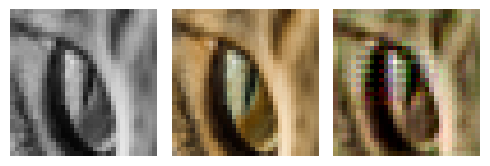

EPOCH: 0.760  trn_loss: 0.007  (48.12s - 6281.20s remaining)

EPOCH: 0.765  trn_loss: 0.006  (48.42s - 6278.37s remaining)

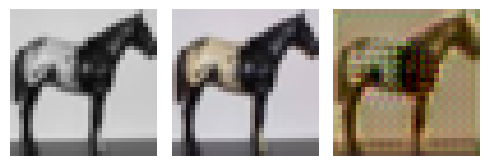

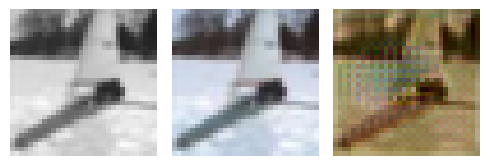

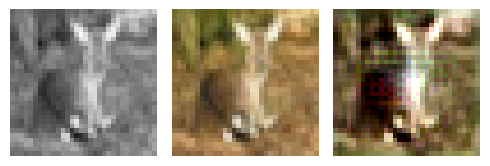

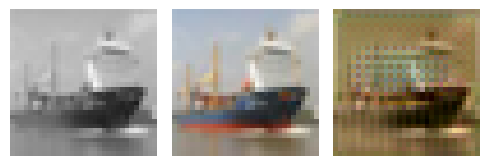

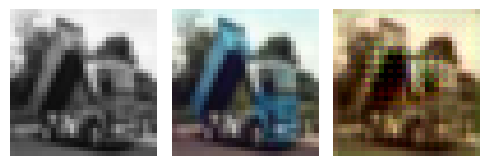

EPOCH: 1.000  val_loss: 0.005  (70.36s - 6965.26s remaining)

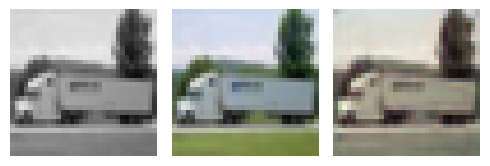

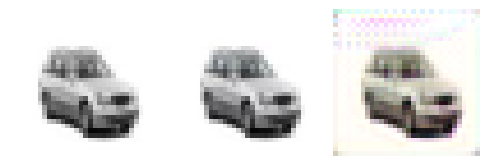

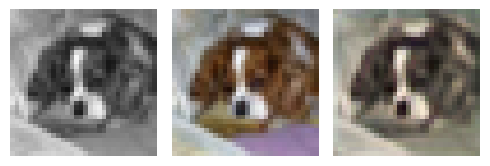

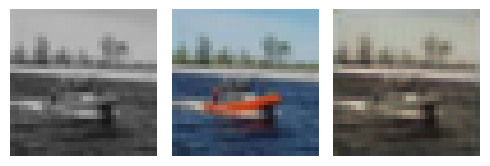

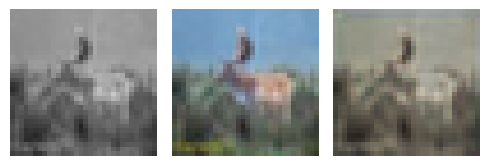

EPOCH: 1.250  trn_loss: 0.006  (86.31s - 6818.40s remaining)

EPOCH: 1.255  trn_loss: 0.007  (86.62s - 6814.86s remaining)

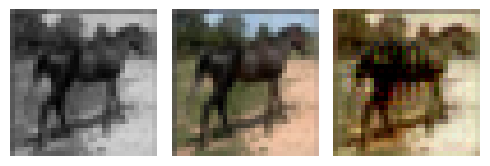

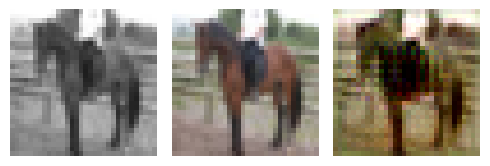

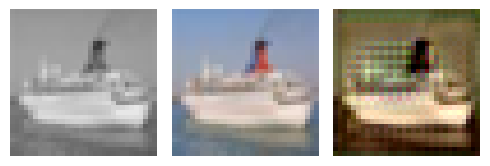

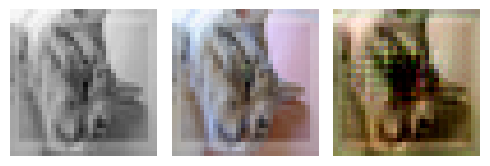

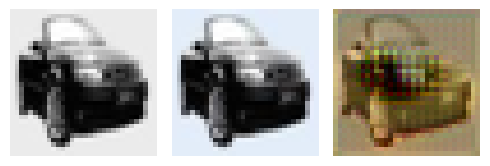

EPOCH: 1.505  trn_loss: 0.006  (103.01s - 6741.08s remaining)

EPOCH: 1.510  trn_loss: 0.006  (103.33s - 6738.77s remaining)

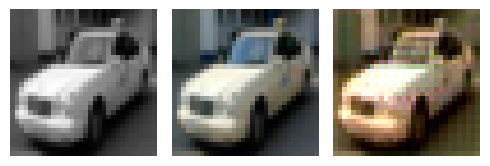

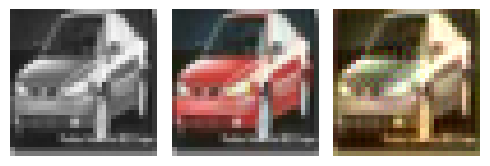

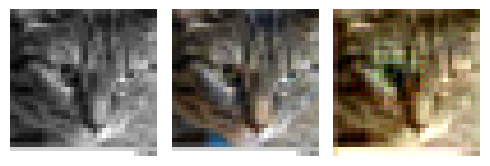

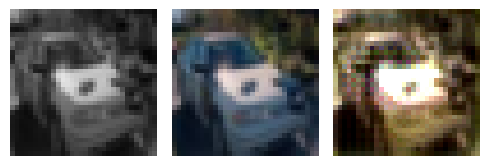

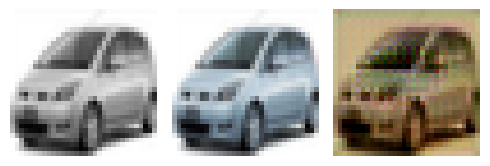

EPOCH: 1.760  trn_loss: 0.007  (119.60s - 6675.07s remaining)

EPOCH: 1.765  trn_loss: 0.006  (119.92s - 6673.06s remaining)

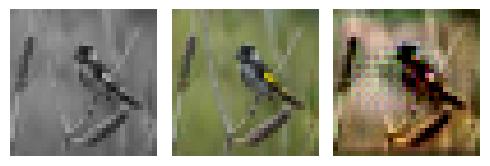

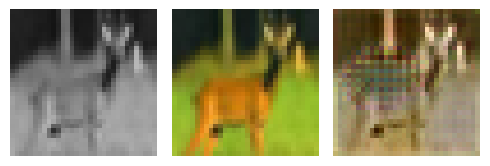

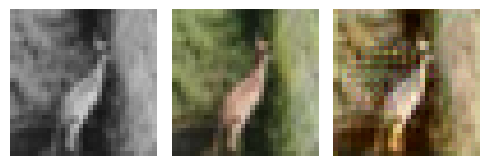

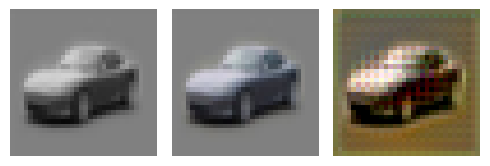

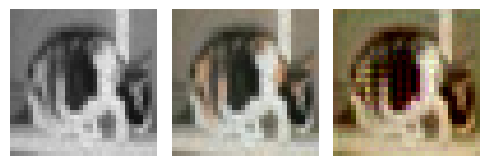

EPOCH: 2.000  val_loss: 0.004  (142.45s - 6980.16s remaining)

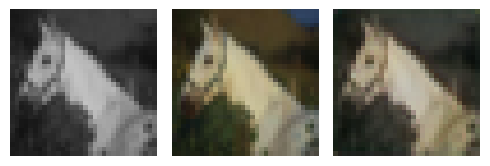

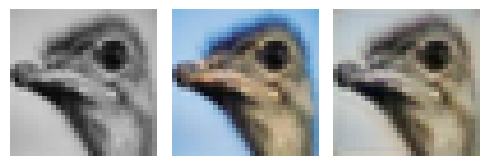

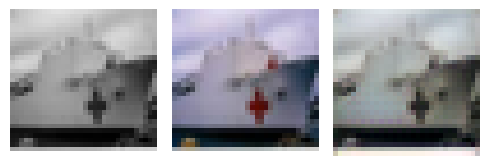

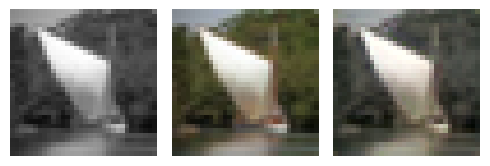

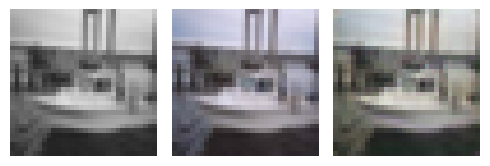

EPOCH: 2.250  trn_loss: 0.006  (158.59s - 6890.07s remaining)

EPOCH: 2.255  trn_loss: 0.006  (158.91s - 6887.94s remaining)

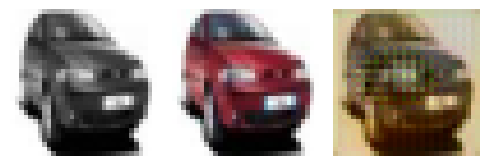

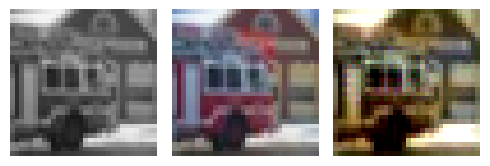

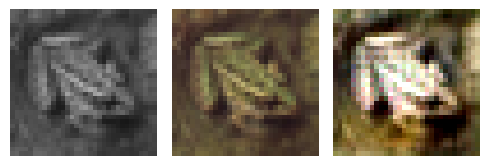

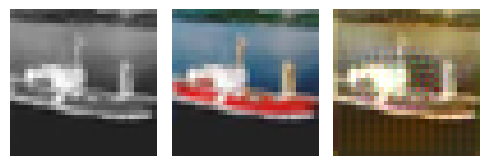

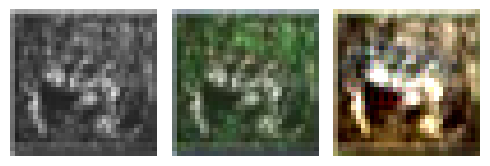

EPOCH: 2.505  trn_loss: 0.006  (175.15s - 6816.65s remaining)

EPOCH: 2.510  trn_loss: 0.007  (175.48s - 6815.07s remaining)

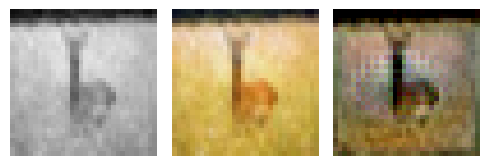

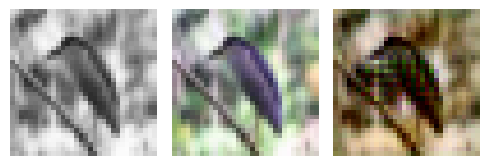

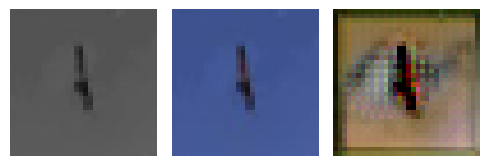

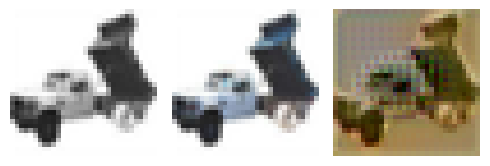

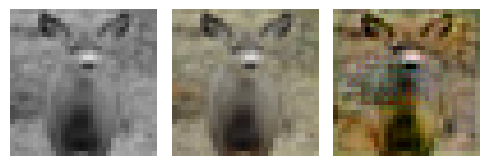

EPOCH: 2.760  trn_loss: 0.006  (191.93s - 6761.66s remaining)

EPOCH: 2.765  trn_loss: 0.006  (192.25s - 6759.80s remaining)

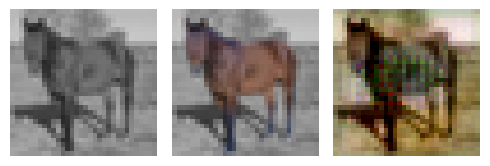

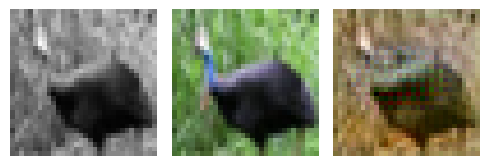

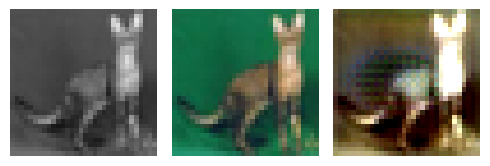

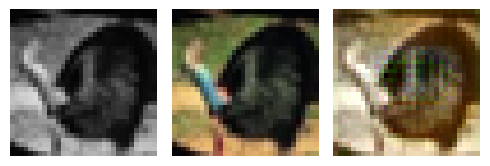

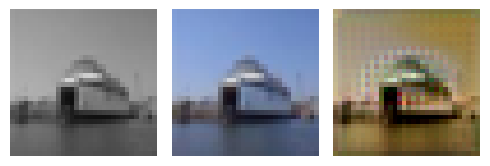

EPOCH: 3.000  val_loss: 0.004  (214.43s - 6933.08s remaining)

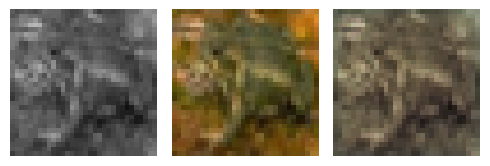

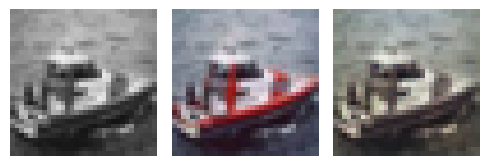

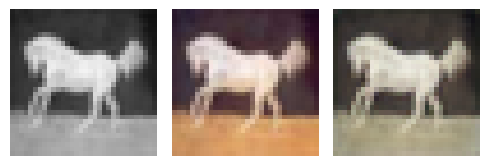

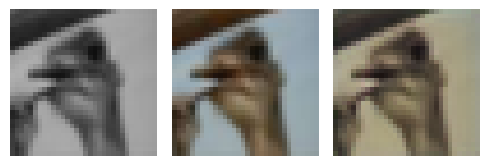

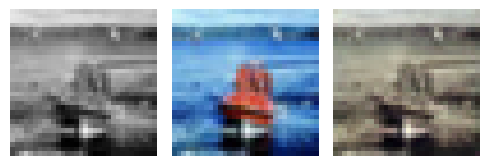

EPOCH: 3.250  trn_loss: 0.006  (231.30s - 6885.64s remaining)

EPOCH: 3.255  trn_loss: 0.005  (231.62s - 6883.86s remaining)

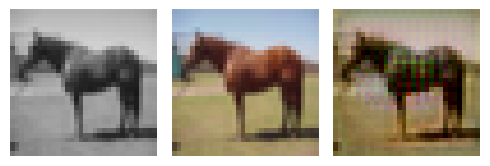

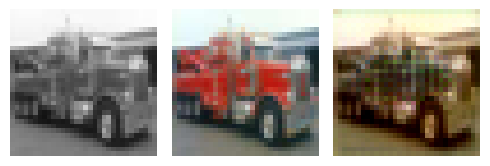

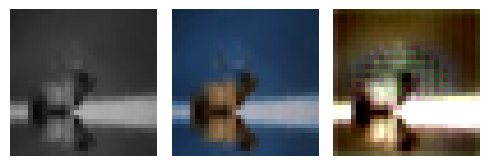

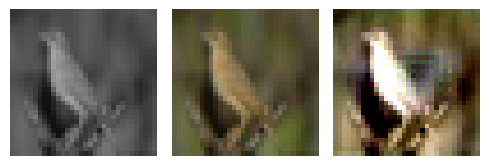

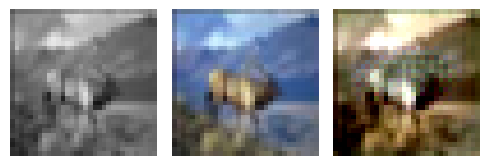

EPOCH: 3.505  trn_loss: 0.006  (247.83s - 6822.61s remaining)

EPOCH: 3.510  trn_loss: 0.005  (248.14s - 6820.98s remaining)

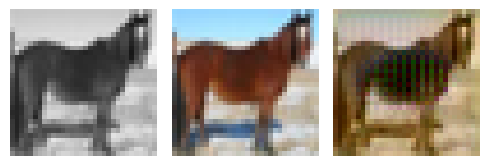

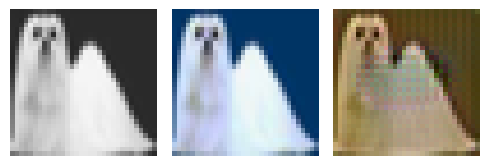

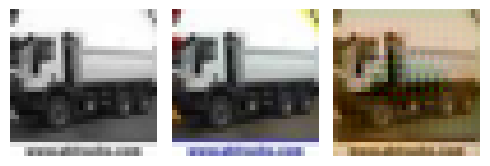

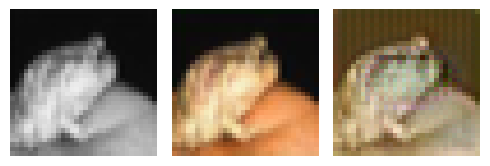

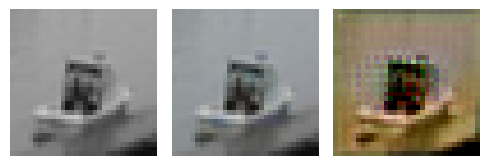

EPOCH: 3.760  trn_loss: 0.005  (264.49s - 6769.31s remaining)

EPOCH: 3.765  trn_loss: 0.005  (264.80s - 6767.80s remaining)

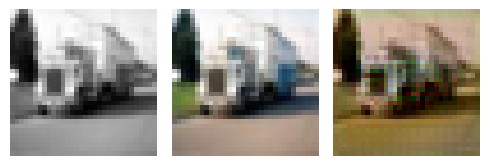

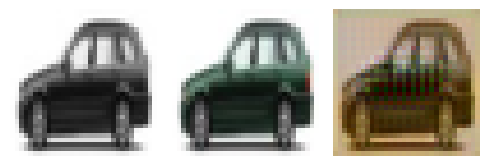

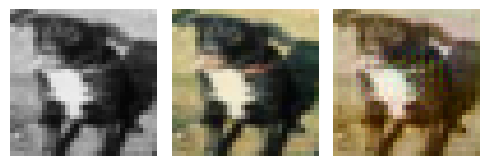

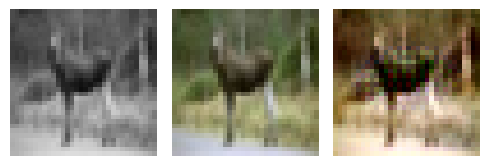

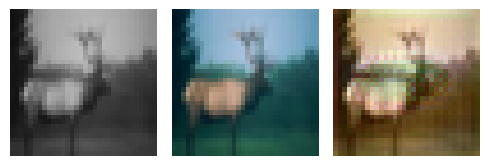

EPOCH: 4.000  val_loss: 0.004  (287.26s - 6894.16s remaining)

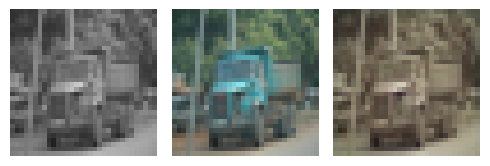

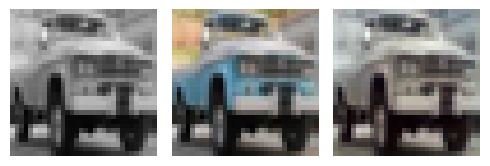

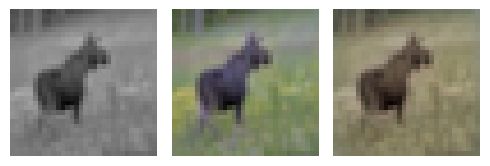

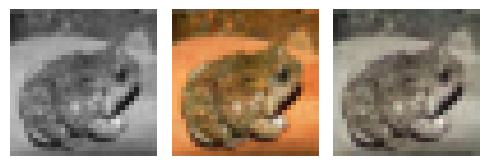

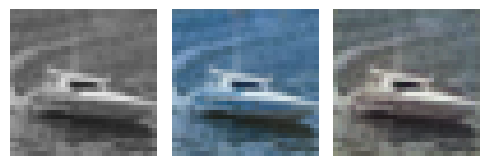

EPOCH: 4.250  trn_loss: 0.006  (303.59s - 6839.77s remaining)

EPOCH: 4.255  trn_loss: 0.005  (303.93s - 6838.85s remaining)

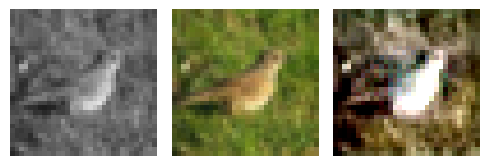

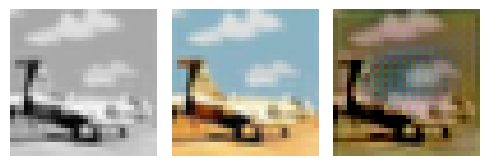

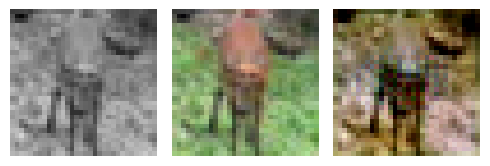

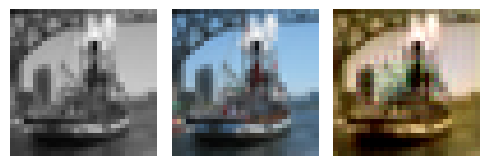

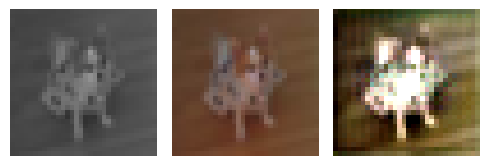

EPOCH: 4.505  trn_loss: 0.006  (320.64s - 6796.61s remaining)

EPOCH: 4.510  trn_loss: 0.006  (320.96s - 6795.31s remaining)

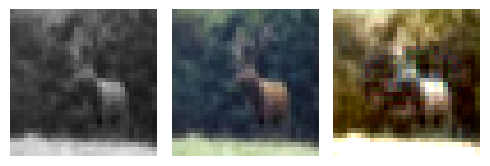

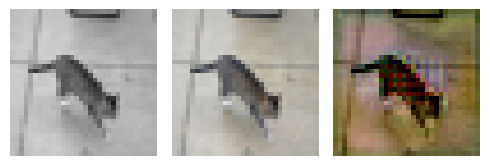

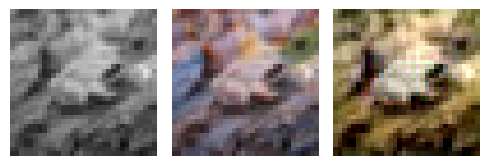

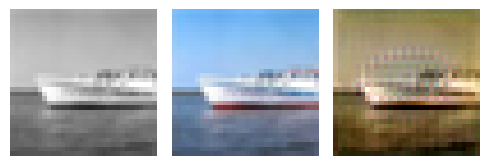

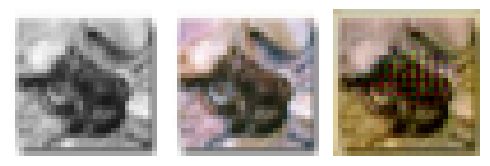

EPOCH: 4.760  trn_loss: 0.005  (337.35s - 6749.45s remaining)

EPOCH: 4.765  trn_loss: 0.006  (337.66s - 6748.14s remaining)

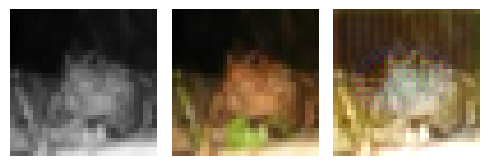

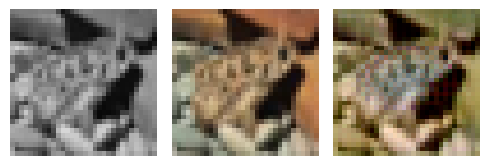

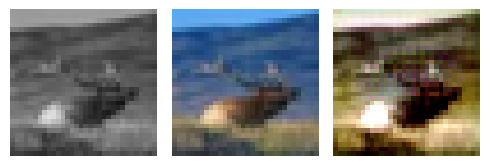

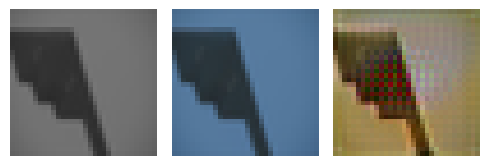

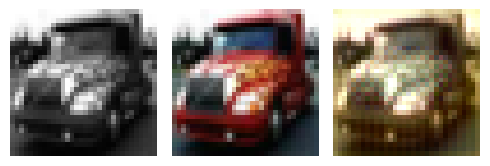

EPOCH: 5.000  trn_loss: 0.006  val_loss: 0.006  (360.40s - 6847.51s remaining)


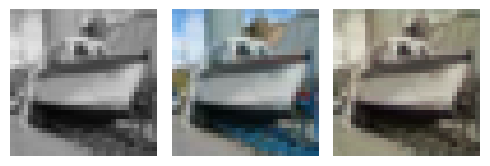

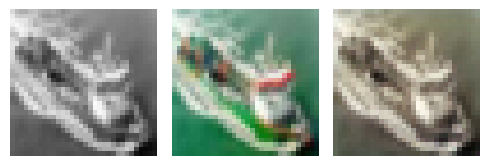

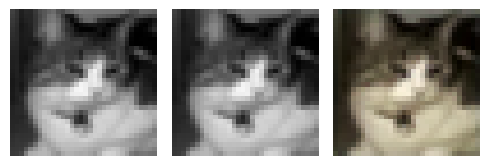

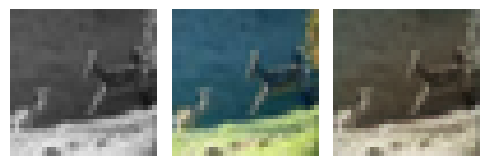

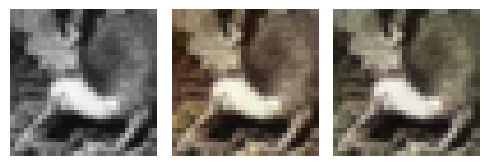

EPOCH: 5.250  trn_loss: 0.005  (377.01s - 6804.08s remaining)

EPOCH: 5.255  trn_loss: 0.005  (377.33s - 6802.85s remaining)

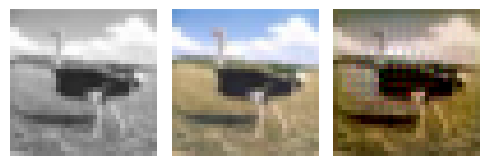

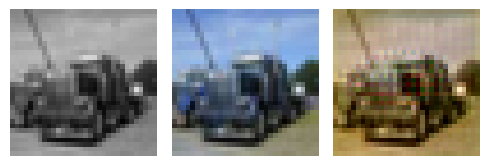

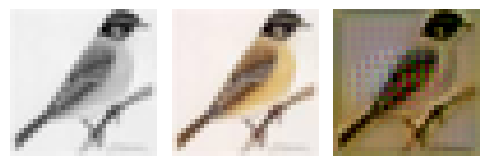

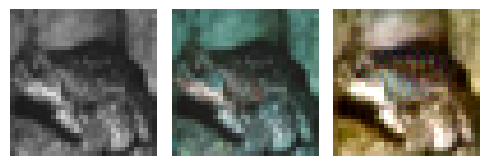

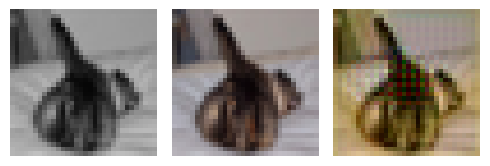

EPOCH: 5.505  trn_loss: 0.006  (394.01s - 6763.25s remaining)

EPOCH: 5.510  trn_loss: 0.005  (394.37s - 6762.75s remaining)

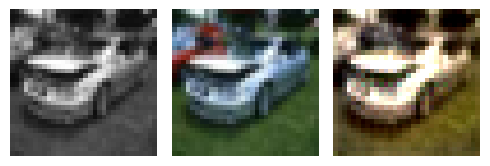

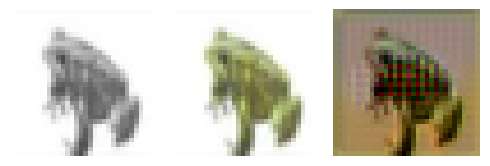

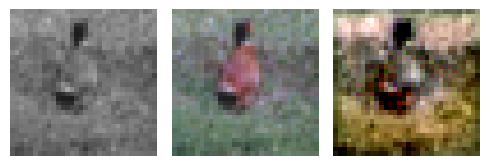

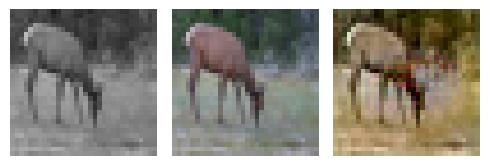

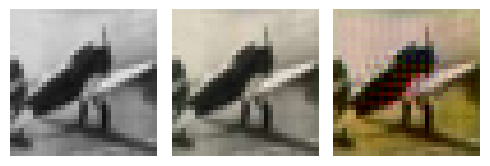

EPOCH: 5.760  trn_loss: 0.006  (411.07s - 6725.31s remaining)

EPOCH: 5.765  trn_loss: 0.005  (411.39s - 6724.21s remaining)

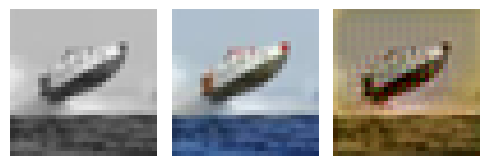

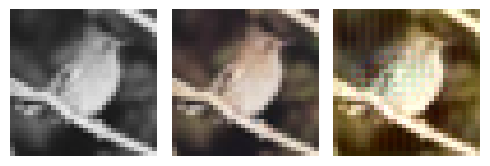

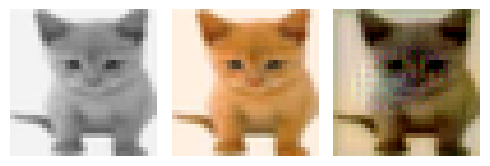

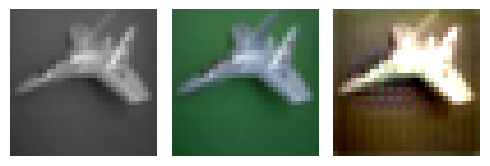

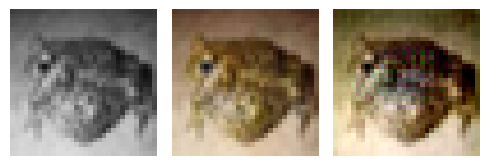

EPOCH: 6.000  val_loss: 0.006  (434.27s - 6803.58s remaining)

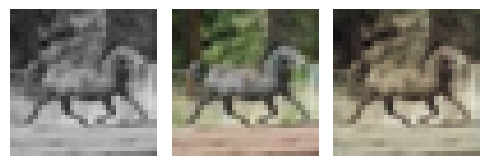

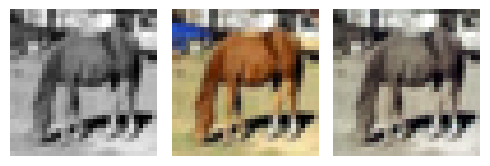

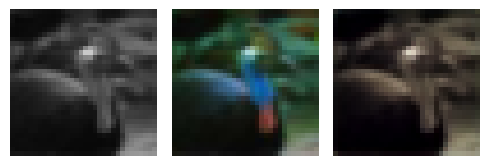

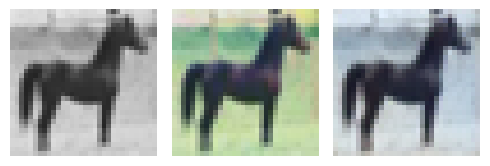

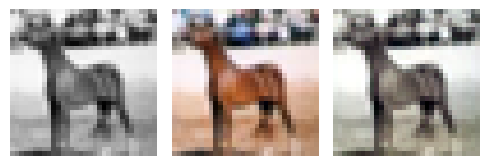

EPOCH: 6.250  trn_loss: 0.006  (450.76s - 6761.38s remaining)

EPOCH: 6.255  trn_loss: 0.005  (451.09s - 6760.40s remaining)

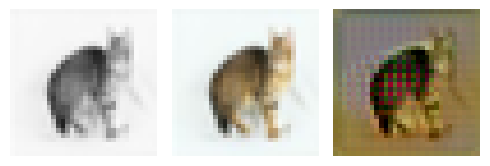

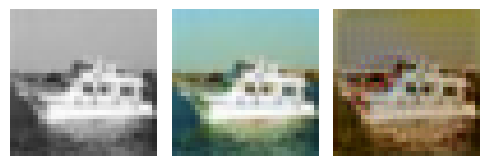

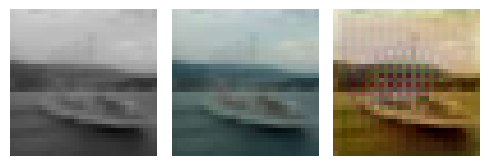

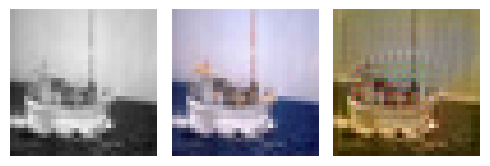

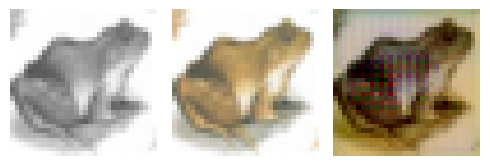

EPOCH: 6.505  trn_loss: 0.005  (467.71s - 6722.22s remaining)

EPOCH: 6.510  trn_loss: 0.004  (468.03s - 6721.13s remaining)

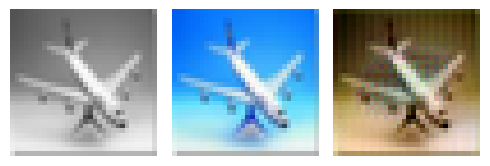

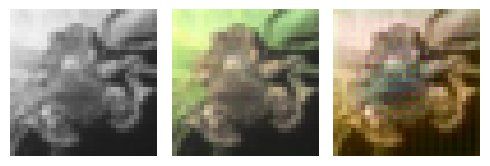

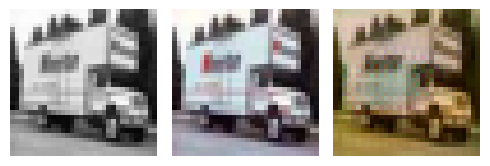

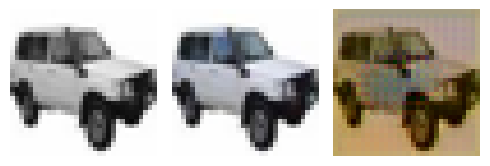

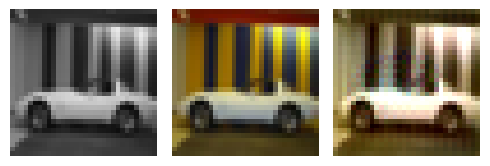

EPOCH: 6.760  trn_loss: 0.005  (484.88s - 6687.69s remaining)

EPOCH: 6.765  trn_loss: 0.006  (485.21s - 6686.81s remaining)

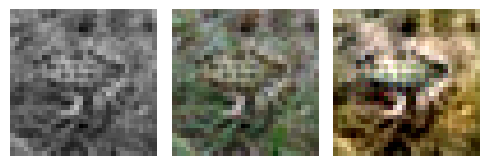

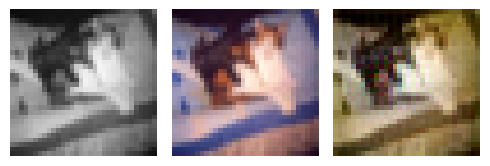

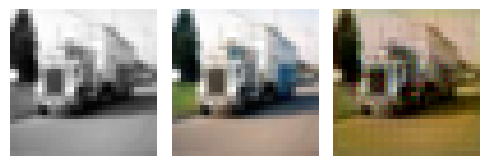

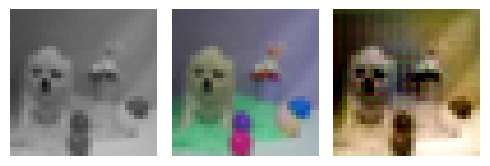

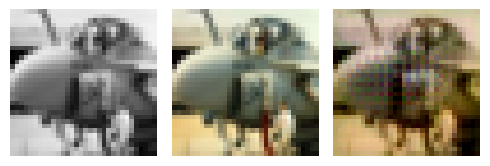

EPOCH: 7.000  val_loss: 0.004  (507.53s - 6742.85s remaining)

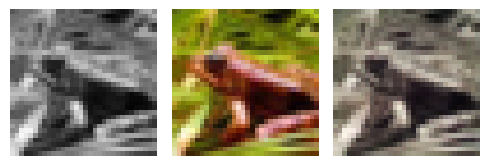

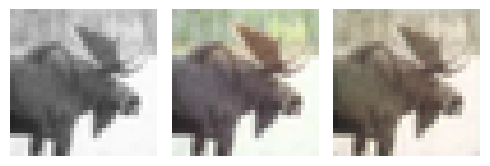

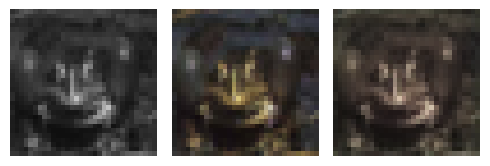

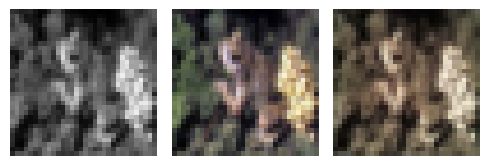

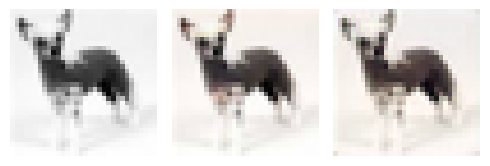

EPOCH: 7.250  trn_loss: 0.005  (524.66s - 6712.09s remaining)

EPOCH: 7.255  trn_loss: 0.005  (524.98s - 6711.07s remaining)

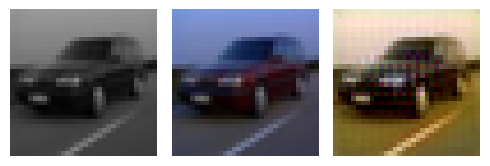

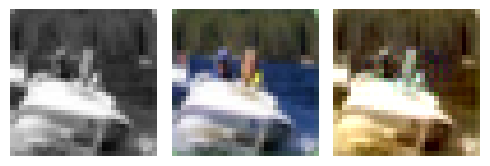

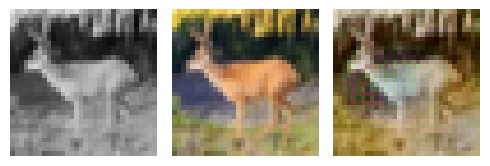

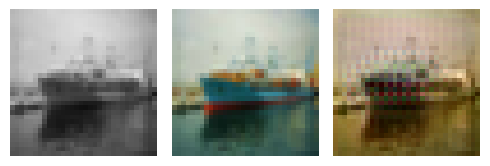

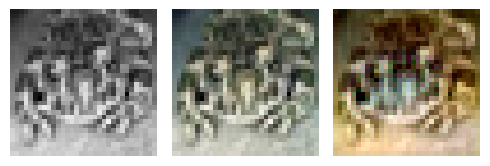

EPOCH: 7.505  trn_loss: 0.005  (541.52s - 6673.83s remaining)

EPOCH: 7.510  trn_loss: 0.006  (541.83s - 6672.81s remaining)

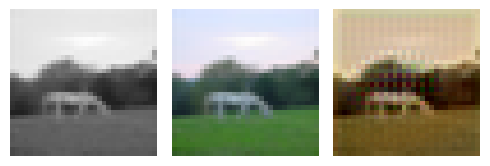

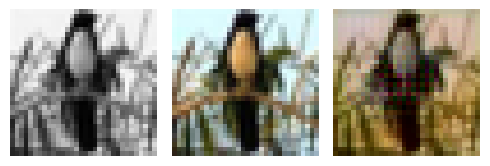

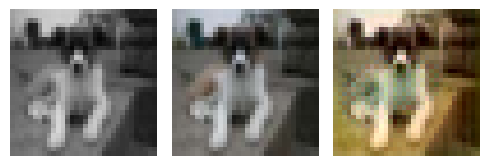

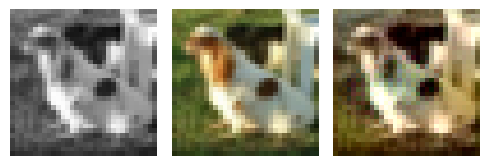

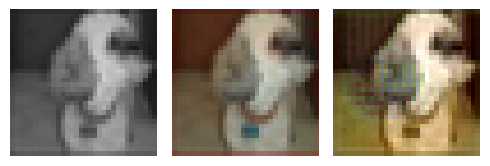

EPOCH: 7.760  trn_loss: 0.005  (558.37s - 6636.95s remaining)

EPOCH: 7.765  trn_loss: 0.006  (558.71s - 6636.27s remaining)

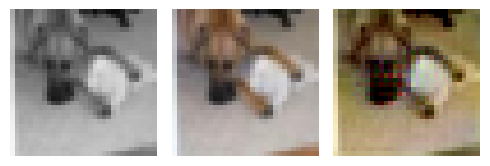

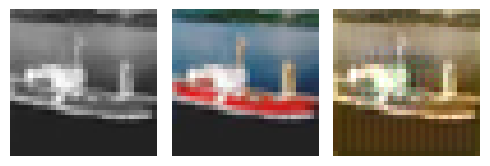

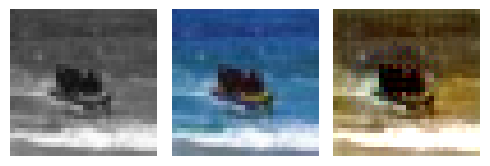

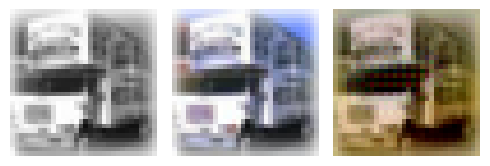

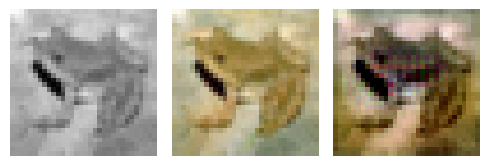

EPOCH: 8.000  val_loss: 0.004  (581.45s - 6686.71s remaining)

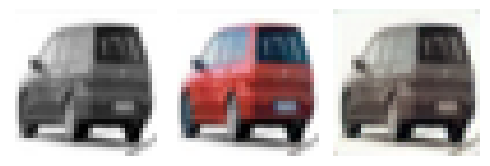

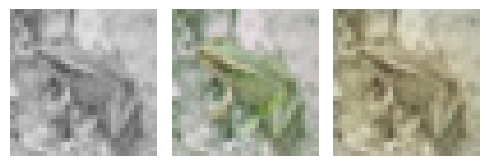

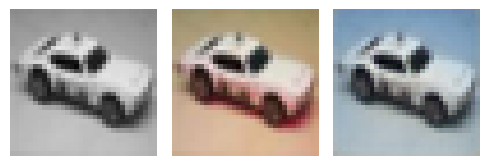

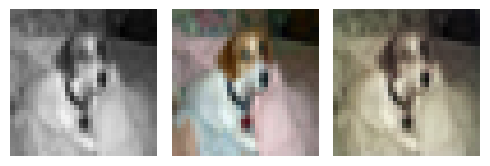

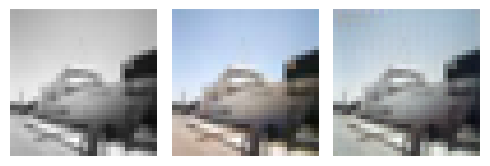

EPOCH: 8.250  trn_loss: 0.005  (597.97s - 6650.21s remaining)

EPOCH: 8.255  trn_loss: 0.005  (598.32s - 6649.57s remaining)

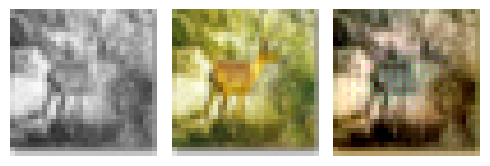

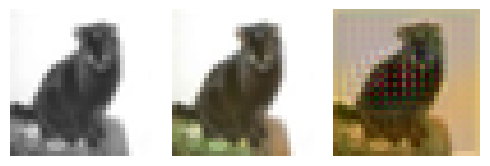

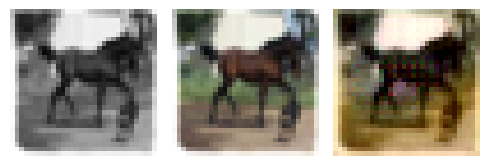

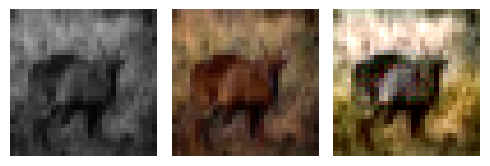

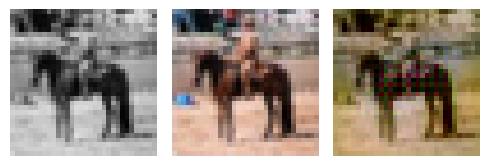

EPOCH: 8.505  trn_loss: 0.005  (615.18s - 6617.87s remaining)

EPOCH: 8.510  trn_loss: 0.006  (615.51s - 6617.11s remaining)

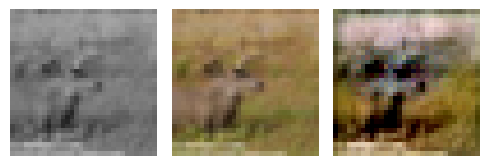

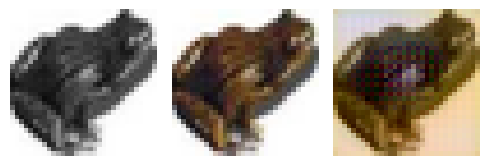

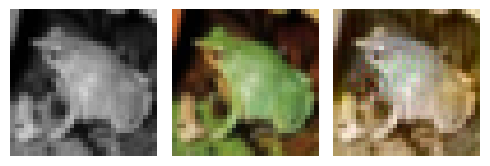

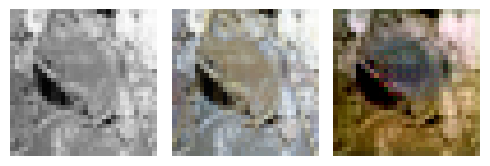

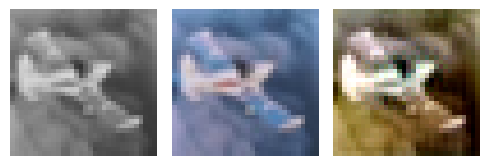

EPOCH: 8.760  trn_loss: 0.005  (632.47s - 6587.29s remaining)

EPOCH: 8.765  trn_loss: 0.005  (632.83s - 6586.86s remaining)

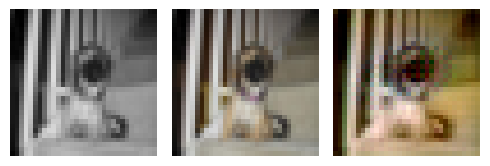

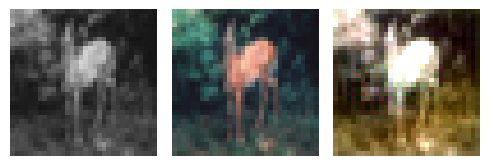

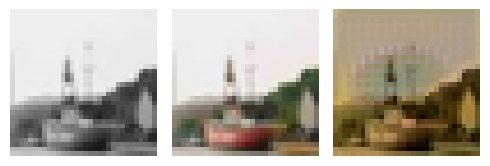

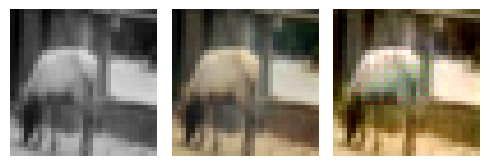

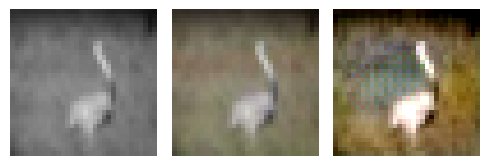

EPOCH: 9.000  val_loss: 0.004  (656.09s - 6633.82s remaining)

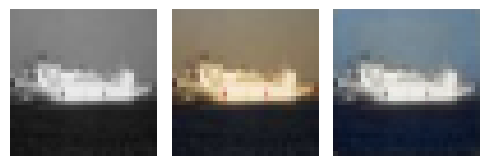

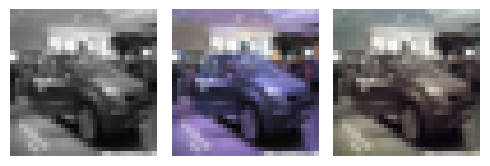

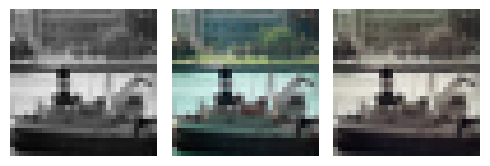

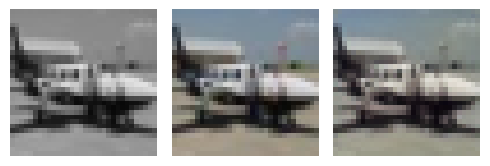

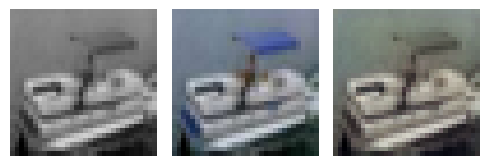

EPOCH: 9.250  trn_loss: 0.006  (672.60s - 6598.73s remaining)

EPOCH: 9.255  trn_loss: 0.005  (672.92s - 6597.84s remaining)

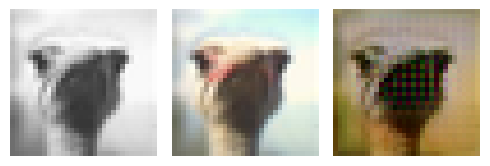

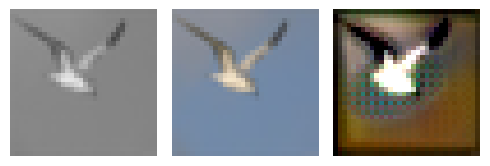

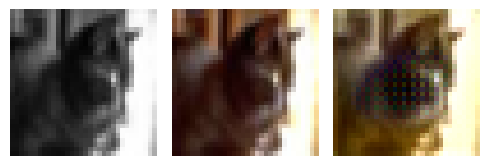

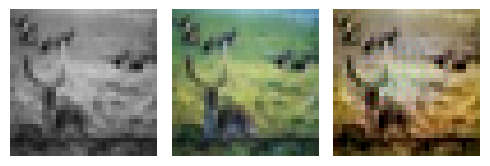

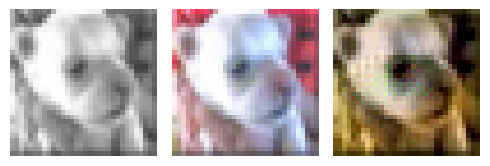

EPOCH: 9.505  trn_loss: 0.005  (689.71s - 6566.50s remaining)

EPOCH: 9.510  trn_loss: 0.005  (690.02s - 6565.60s remaining)

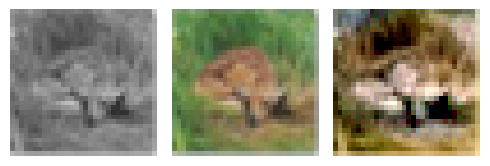

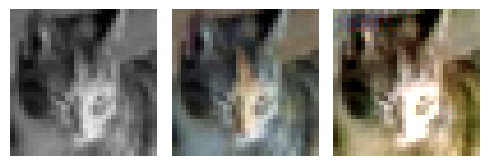

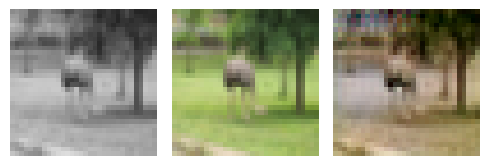

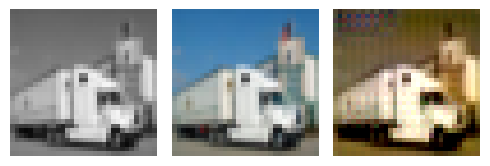

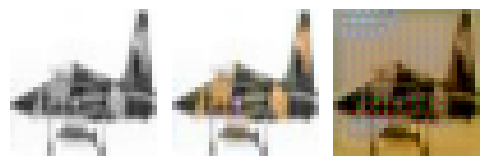

EPOCH: 9.760  trn_loss: 0.005  (706.60s - 6533.02s remaining)

EPOCH: 9.765  trn_loss: 0.004  (706.92s - 6532.16s remaining)

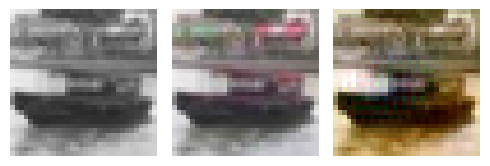

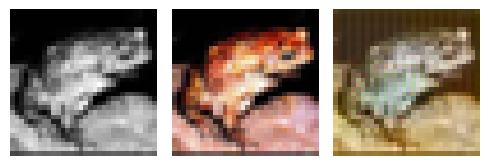

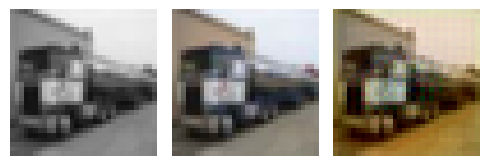

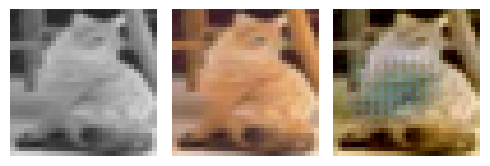

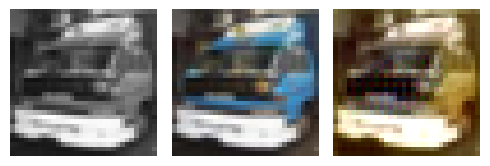

EPOCH: 10.000  trn_loss: 0.005  val_loss: 0.005  (729.73s - 6567.54s remaining)


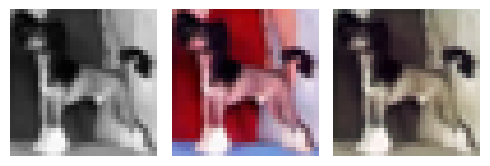

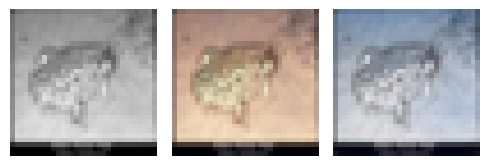

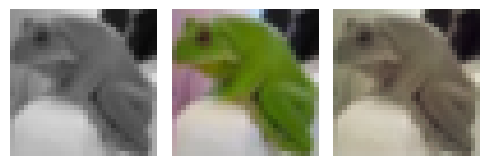

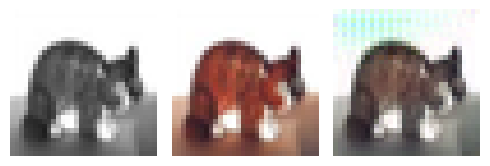

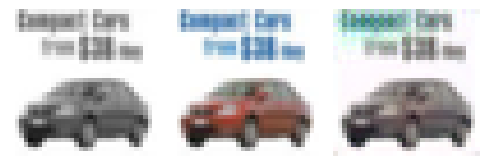

EPOCH: 10.250  trn_loss: 0.005  (746.53s - 6536.73s remaining)

EPOCH: 10.255  trn_loss: 0.005  (746.85s - 6535.88s remaining)

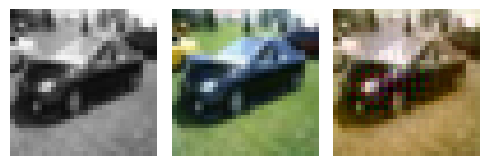

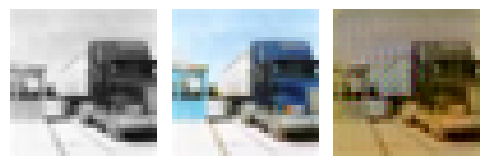

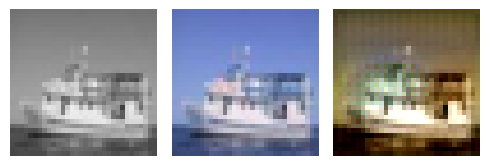

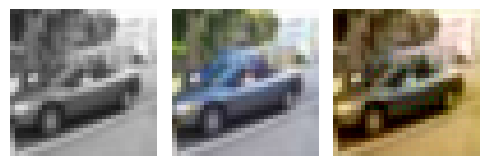

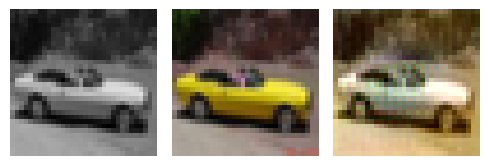

EPOCH: 10.505  trn_loss: 0.005  (763.38s - 6503.34s remaining)

EPOCH: 10.510  trn_loss: 0.005  (763.69s - 6502.50s remaining)

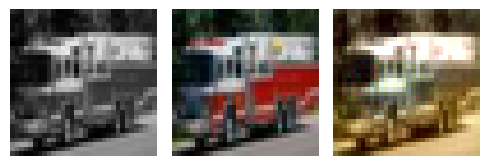

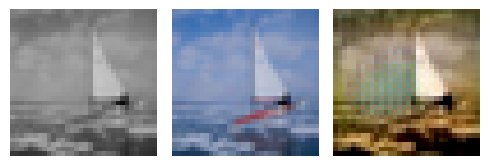

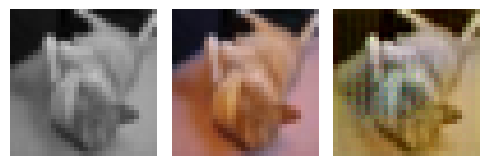

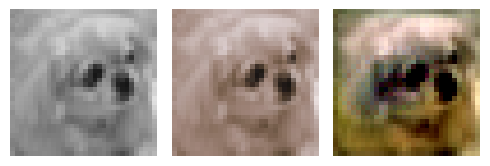

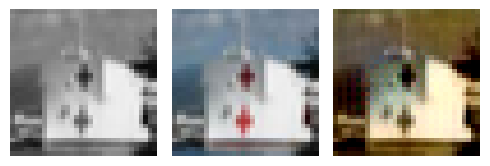

EPOCH: 10.760  trn_loss: 0.005  (780.58s - 6473.75s remaining)

EPOCH: 10.765  trn_loss: 0.006  (780.90s - 6472.92s remaining)

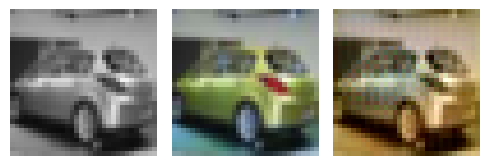

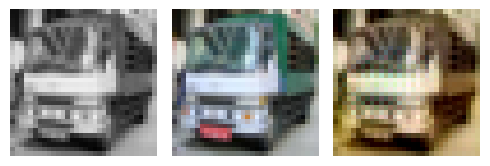

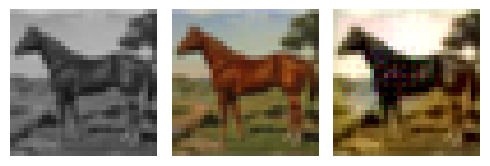

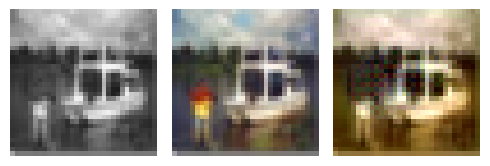

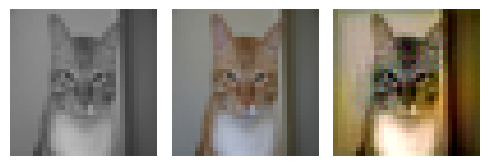

EPOCH: 11.000  val_loss: 0.003  (803.07s - 6497.54s remaining)

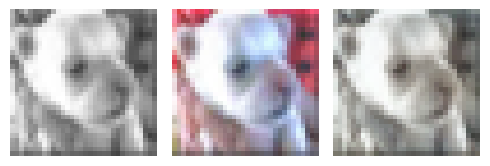

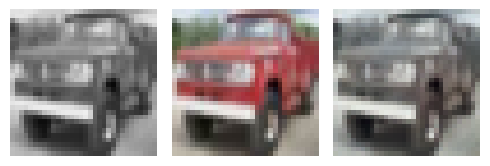

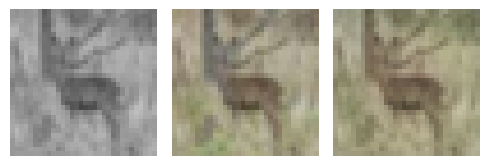

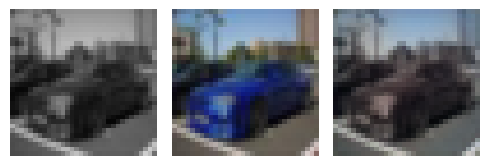

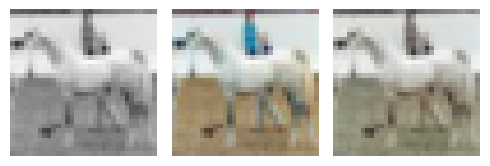

EPOCH: 11.250  trn_loss: 0.005  (820.18s - 6470.31s remaining)

EPOCH: 11.255  trn_loss: 0.005  (820.50s - 6469.51s remaining)

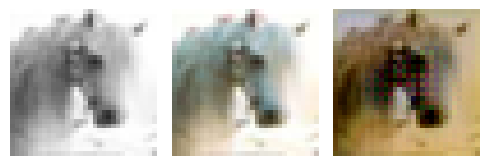

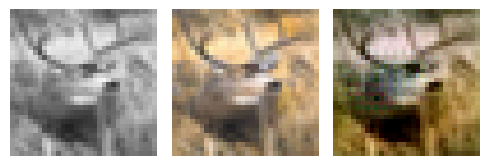

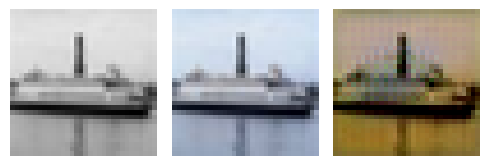

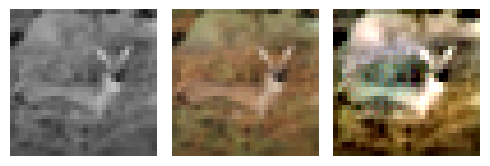

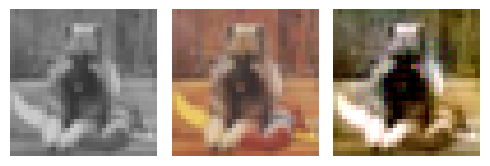

EPOCH: 11.505  trn_loss: 0.005  (837.11s - 6438.85s remaining)

EPOCH: 11.510  trn_loss: 0.005  (837.42s - 6438.04s remaining)

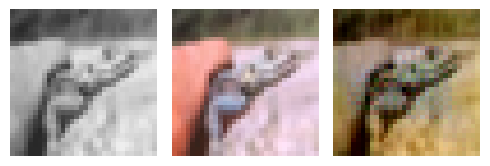

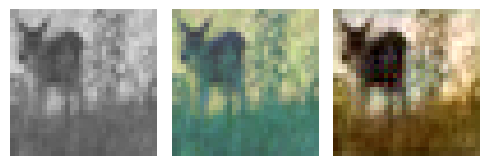

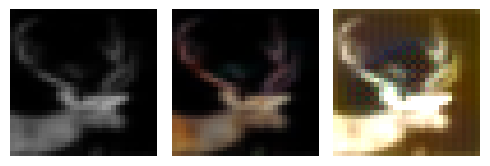

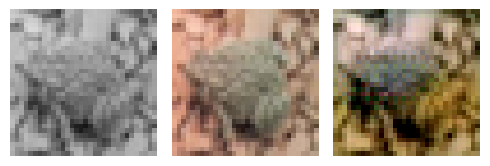

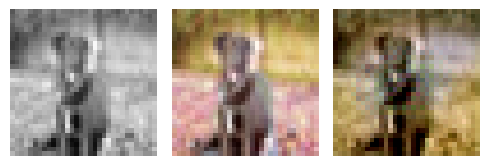

EPOCH: 11.760  trn_loss: 0.006  (854.00s - 6407.81s remaining)

EPOCH: 11.765  trn_loss: 0.005  (854.32s - 6407.03s remaining)

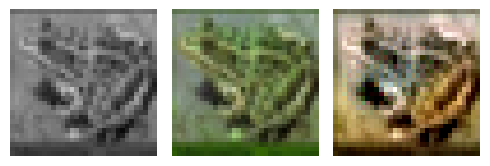

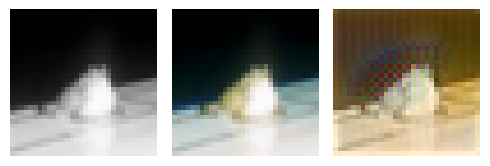

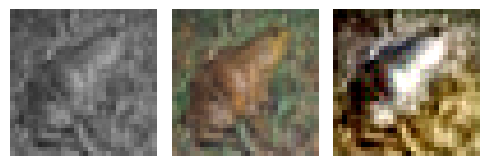

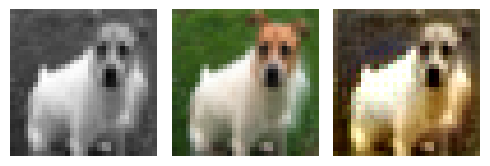

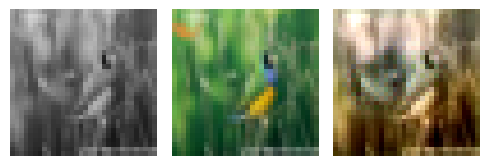

EPOCH: 12.000  val_loss: 0.003  (877.15s - 6432.42s remaining)

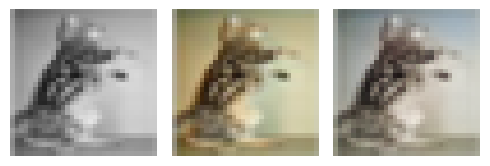

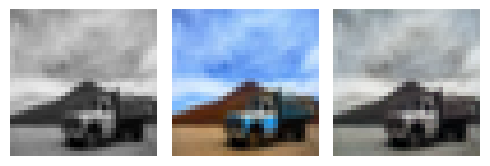

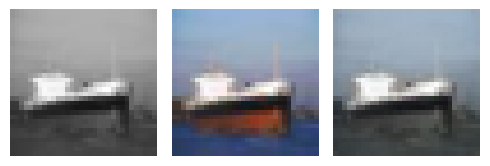

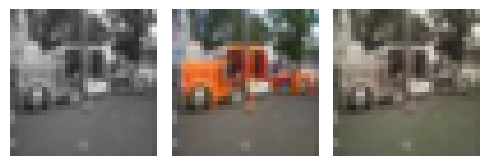

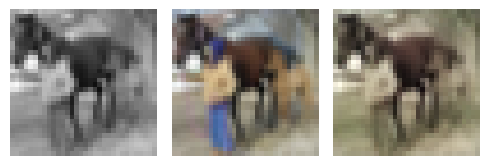

EPOCH: 12.250  trn_loss: 0.005  (894.19s - 6405.33s remaining)

EPOCH: 12.255  trn_loss: 0.005  (894.53s - 6404.74s remaining)

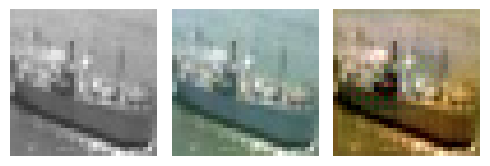

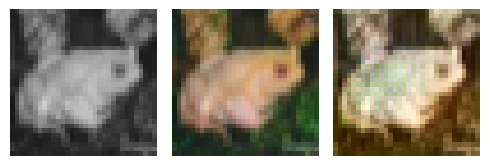

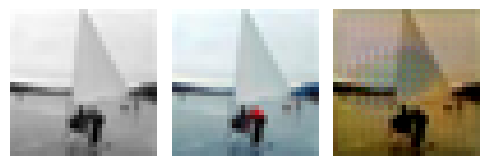

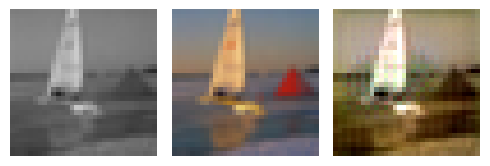

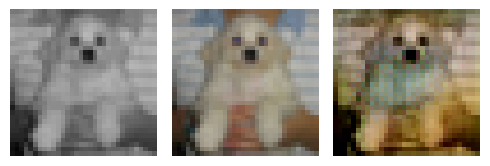

EPOCH: 12.505  trn_loss: 0.005  (911.54s - 6377.79s remaining)

EPOCH: 12.510  trn_loss: 0.006  (911.86s - 6377.06s remaining)

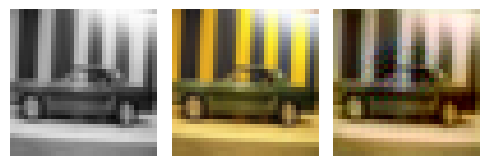

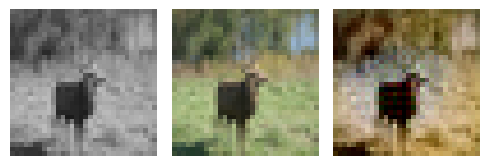

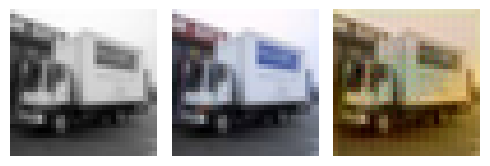

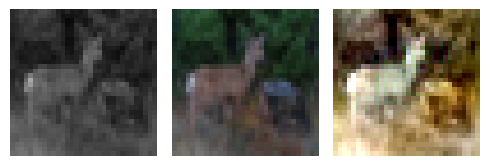

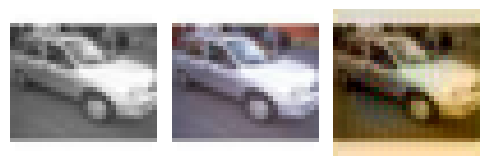

EPOCH: 12.760  trn_loss: 0.005  (928.65s - 6349.04s remaining)

EPOCH: 12.765  trn_loss: 0.005  (928.97s - 6348.37s remaining)

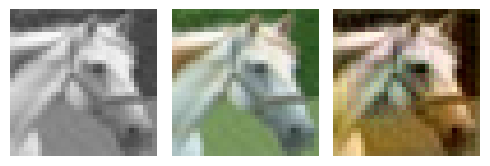

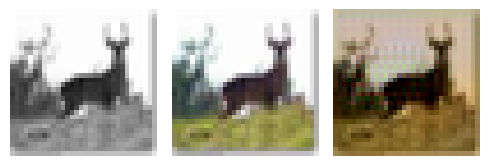

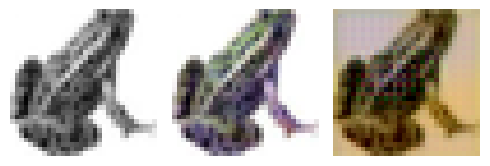

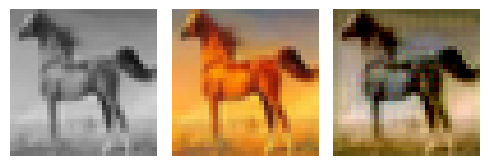

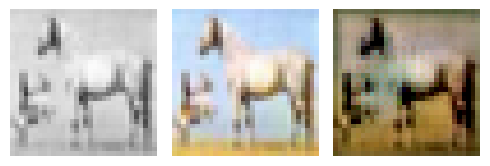

EPOCH: 13.000  val_loss: 0.004  (951.88s - 6370.25s remaining)

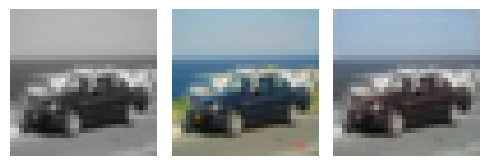

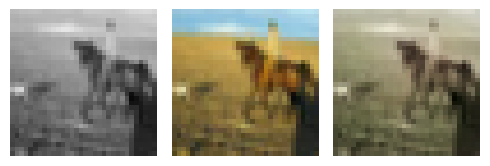

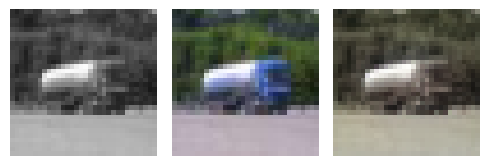

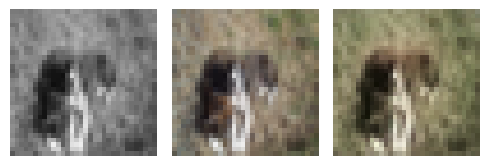

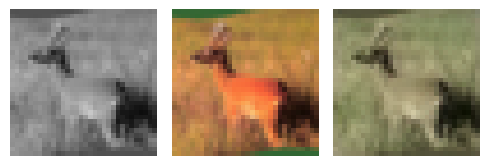

EPOCH: 13.250  trn_loss: 0.005  (968.60s - 6341.61s remaining)

EPOCH: 13.255  trn_loss: 0.005  (968.92s - 6340.85s remaining)

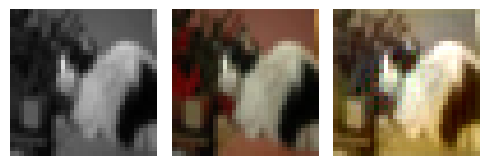

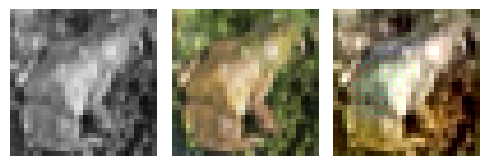

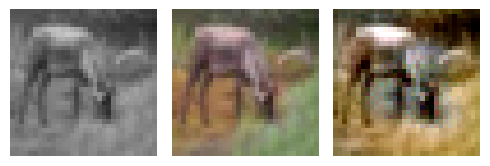

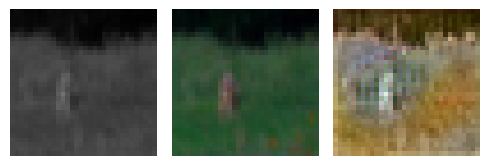

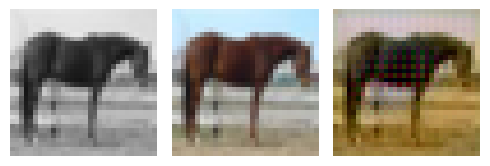

EPOCH: 13.505  trn_loss: 0.005  (985.83s - 6313.88s remaining)

EPOCH: 13.510  trn_loss: 0.006  (986.15s - 6313.15s remaining)

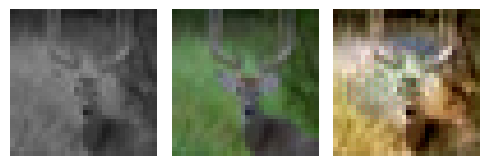

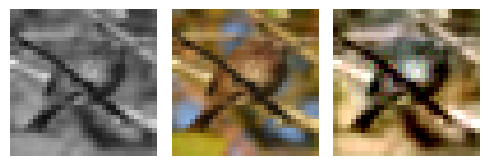

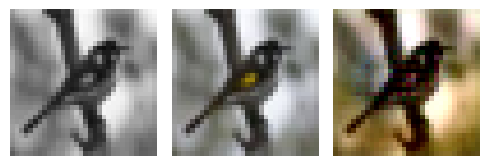

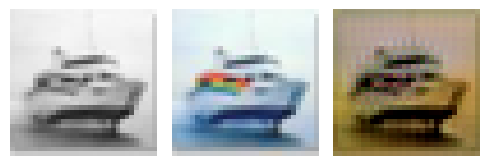

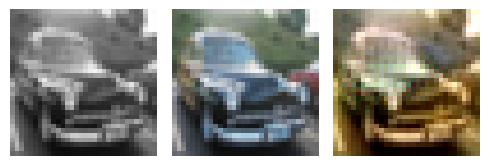

EPOCH: 13.760  trn_loss: 0.005  (1003.16s - 6287.13s remaining)

EPOCH: 13.765  trn_loss: 0.004  (1003.48s - 6286.43s remaining)

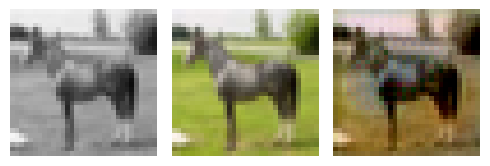

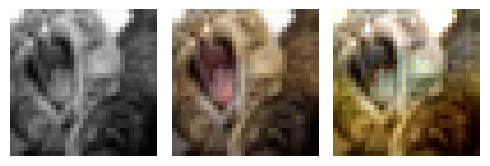

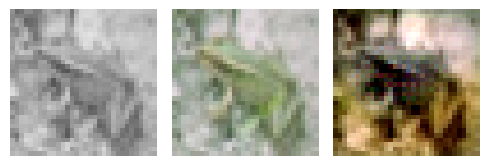

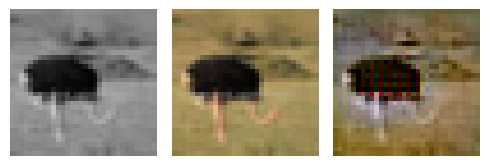

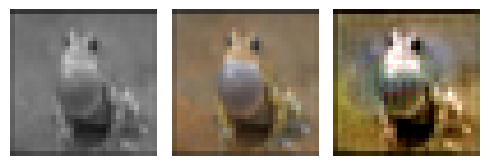

EPOCH: 13.950  val_loss: 0.006  (1025.48s - 6325.65s remaining)

EPOCH: 14.000  val_loss: 0.004  (1025.69s - 6300.64s remaining)

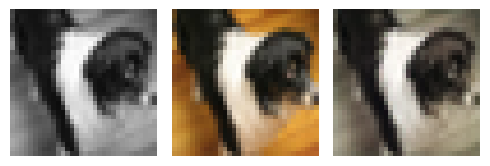

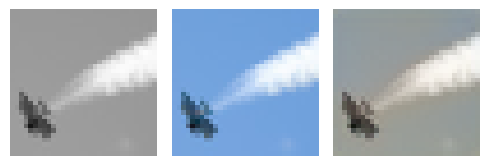

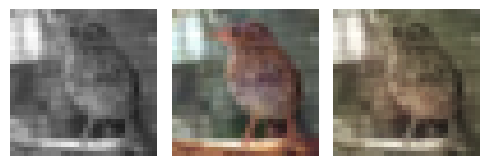

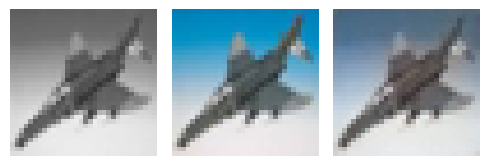

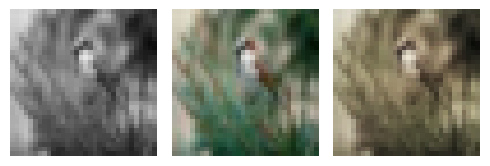

EPOCH: 14.250  trn_loss: 0.005  (1042.91s - 6275.73s remaining)

EPOCH: 14.255  trn_loss: 0.005  (1043.22s - 6275.02s remaining)

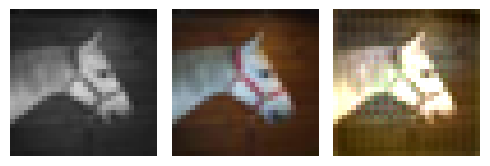

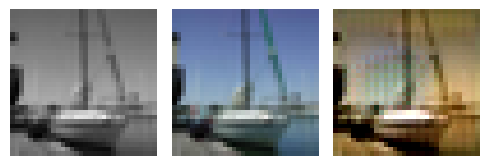

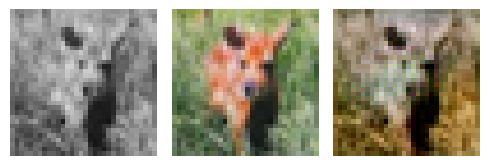

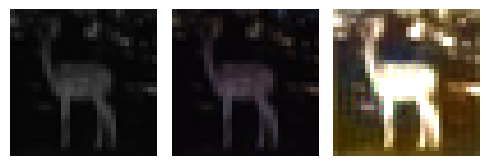

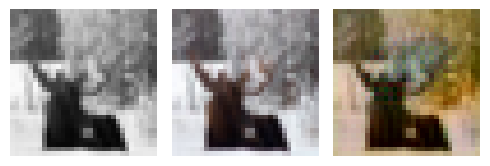

EPOCH: 14.505  trn_loss: 0.005  (1059.95s - 6247.46s remaining)

EPOCH: 14.510  trn_loss: 0.005  (1060.26s - 6246.73s remaining)

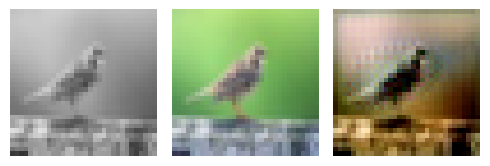

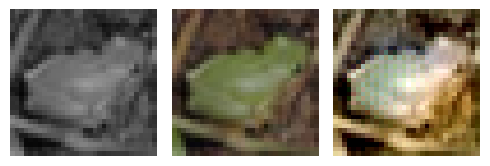

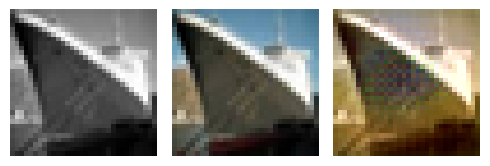

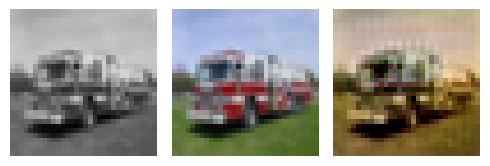

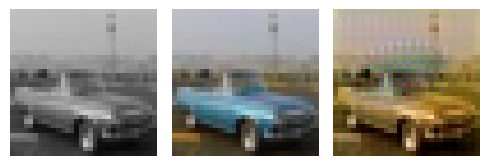

EPOCH: 14.760  trn_loss: 0.005  (1076.91s - 6219.14s remaining)

EPOCH: 14.765  trn_loss: 0.005  (1077.24s - 6218.50s remaining)

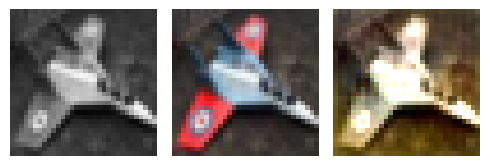

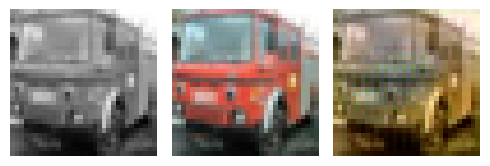

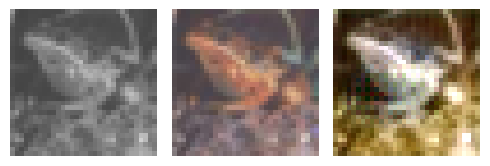

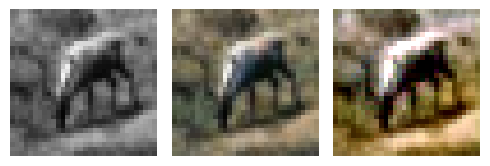

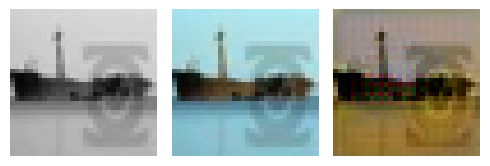

EPOCH: 15.000  trn_loss: 0.005  val_loss: 0.005  (1100.00s - 6233.33s remaining)


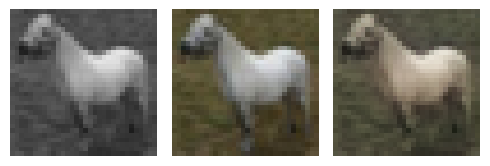

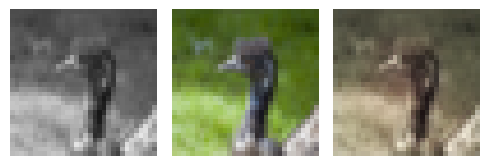

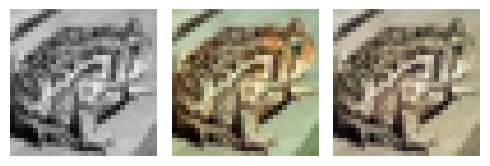

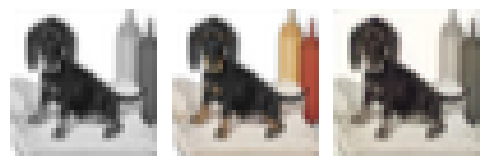

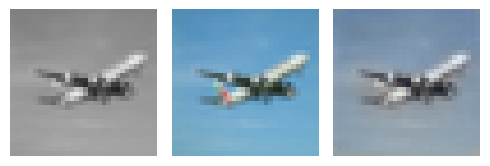

EPOCH: 15.255  trn_loss: 0.005  (1116.85s - 6204.32s remaining)

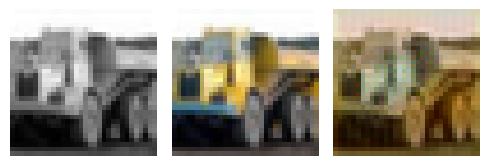

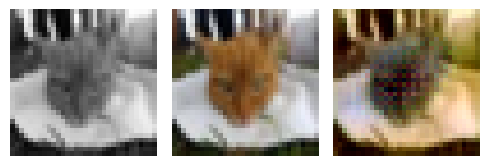

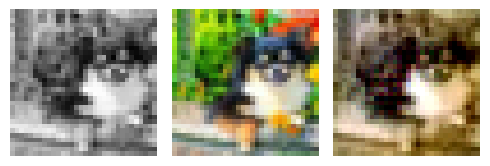

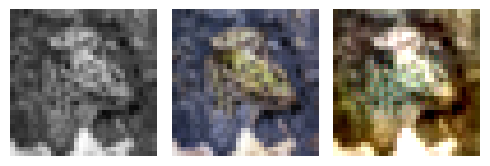

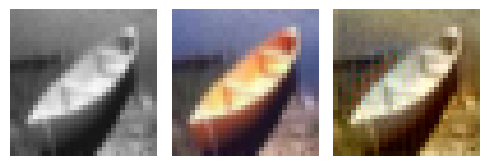

EPOCH: 15.505  trn_loss: 0.005  (1134.16s - 6180.62s remaining)

EPOCH: 15.510  trn_loss: 0.006  (1134.48s - 6179.94s remaining)

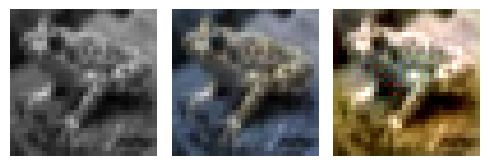

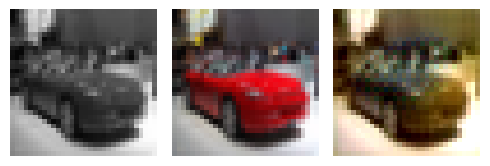

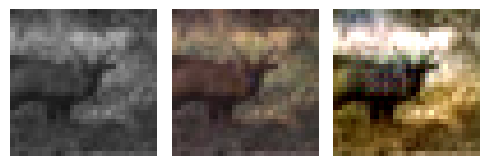

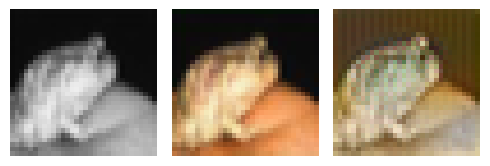

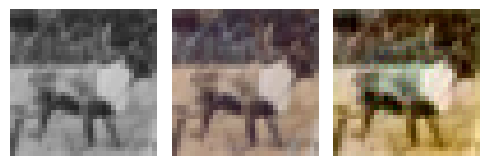

EPOCH: 15.760  trn_loss: 0.004  (1151.25s - 6153.53s remaining)

EPOCH: 15.765  trn_loss: 0.006  (1151.57s - 6152.89s remaining)

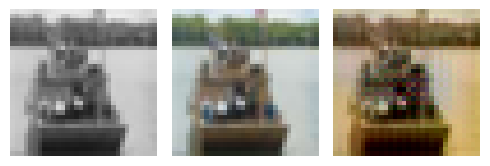

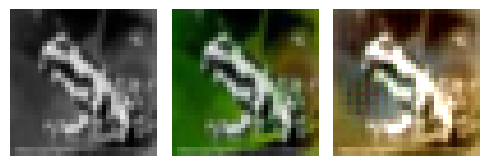

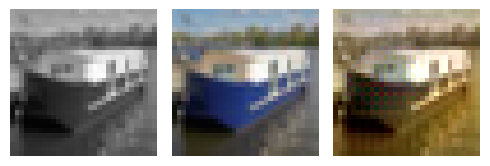

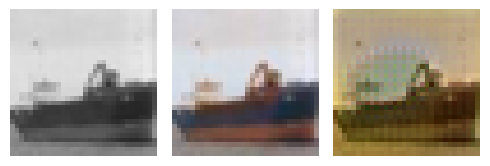

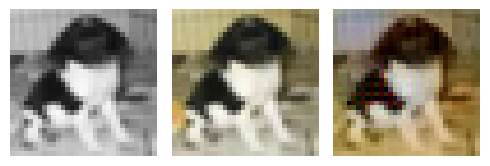

EPOCH: 16.000  val_loss: 0.004  (1174.60s - 6166.67s remaining)

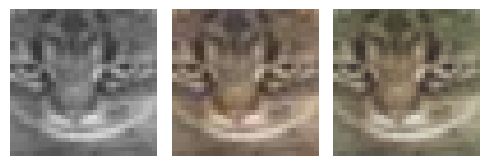

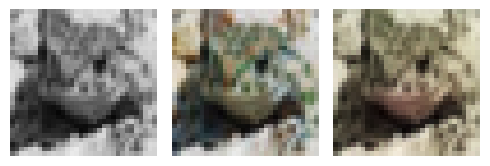

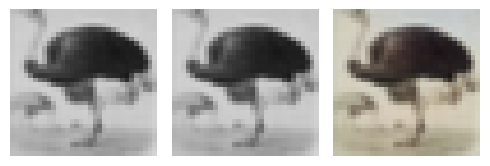

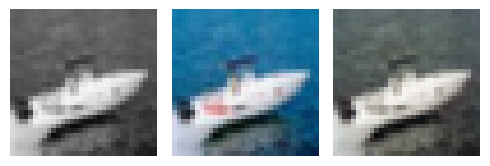

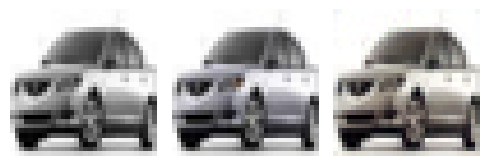

EPOCH: 16.250  trn_loss: 0.005  (1191.26s - 6139.55s remaining)

EPOCH: 16.255  trn_loss: 0.005  (1191.58s - 6138.90s remaining)

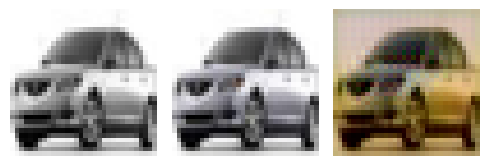

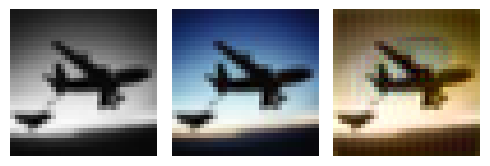

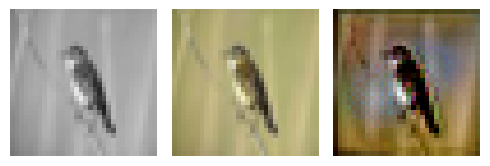

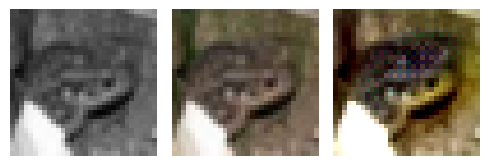

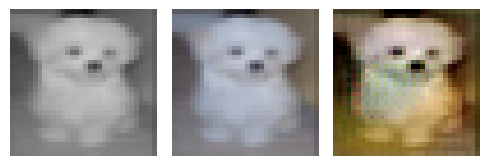

EPOCH: 16.505  trn_loss: 0.004  (1208.43s - 6113.15s remaining)

EPOCH: 16.510  trn_loss: 0.005  (1208.75s - 6112.48s remaining)

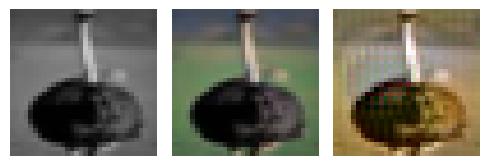

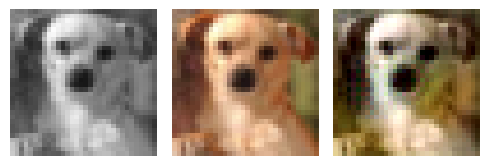

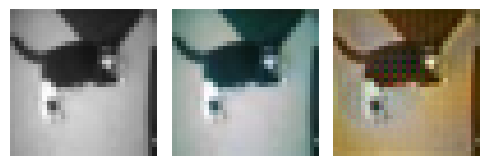

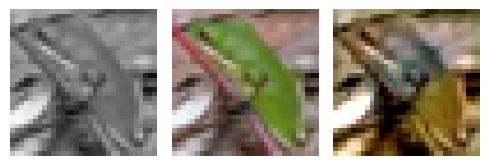

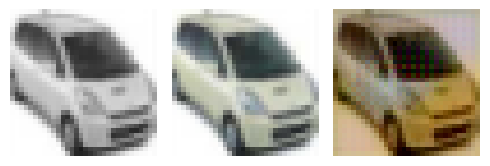

EPOCH: 16.760  trn_loss: 0.005  (1225.81s - 6088.01s remaining)

EPOCH: 16.765  trn_loss: 0.005  (1226.13s - 6087.36s remaining)

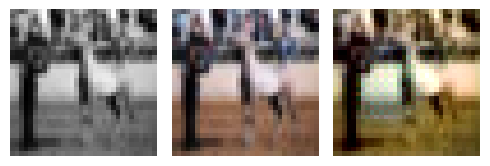

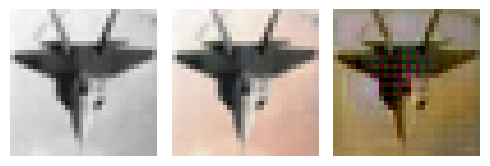

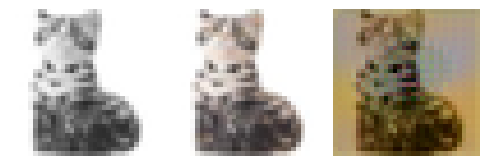

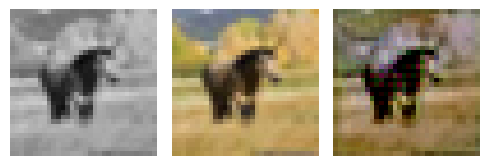

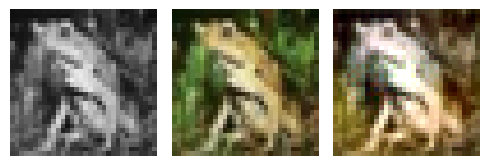

EPOCH: 17.000  val_loss: 0.003  (1248.71s - 6096.63s remaining)

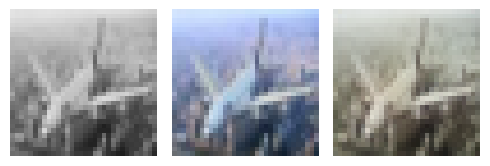

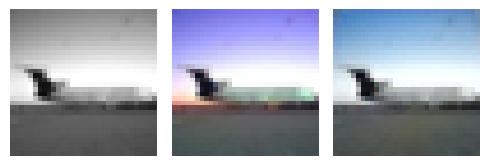

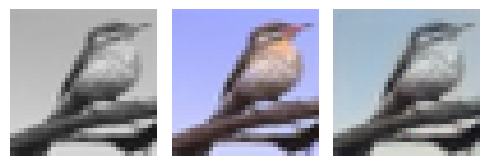

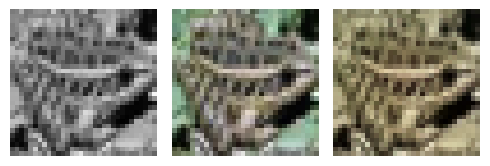

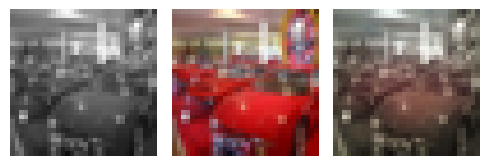

EPOCH: 17.250  trn_loss: 0.005  (1265.75s - 6071.94s remaining)

EPOCH: 17.255  trn_loss: 0.004  (1266.07s - 6071.28s remaining)

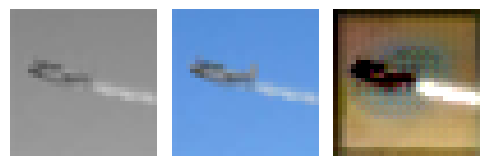

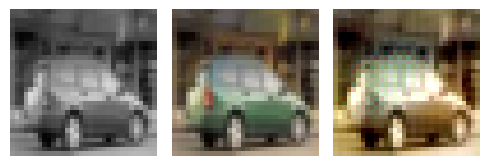

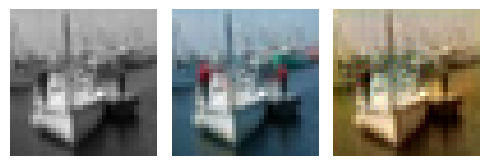

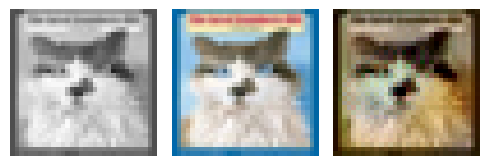

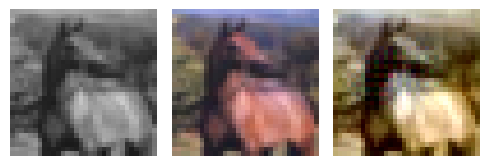

EPOCH: 17.505  trn_loss: 0.005  (1282.96s - 6046.12s remaining)

EPOCH: 17.510  trn_loss: 0.005  (1283.28s - 6045.47s remaining)

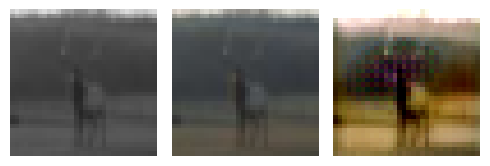

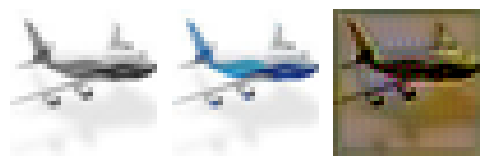

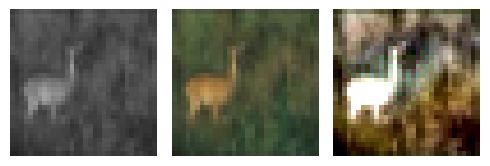

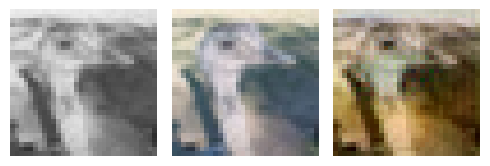

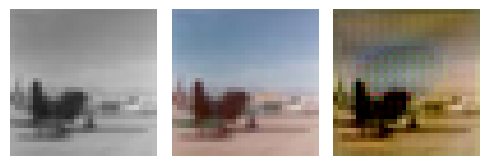

EPOCH: 17.760  trn_loss: 0.005  (1299.98s - 6019.64s remaining)

EPOCH: 17.765  trn_loss: 0.005  (1300.30s - 6019.01s remaining)

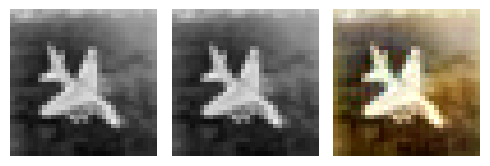

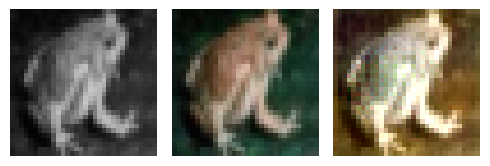

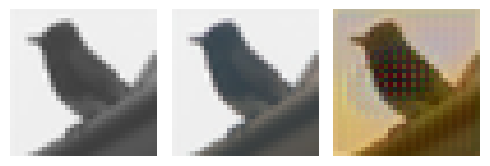

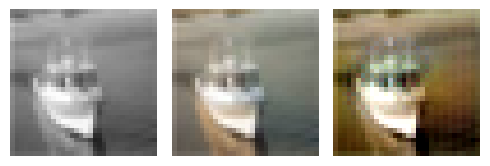

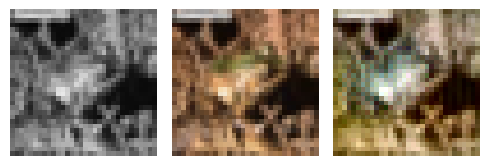

EPOCH: 18.000  val_loss: 0.003  (1323.21s - 6027.96s remaining)

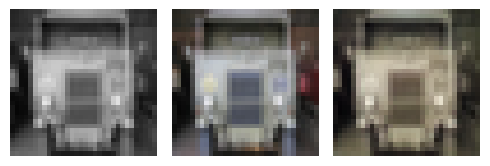

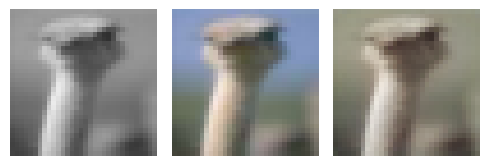

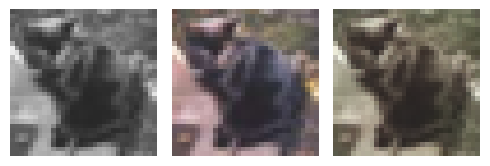

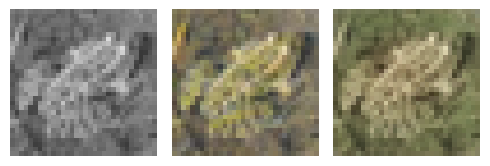

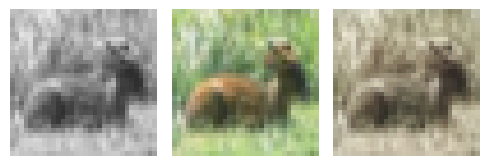

EPOCH: 18.250  trn_loss: 0.005  (1339.75s - 6001.33s remaining)

EPOCH: 18.255  trn_loss: 0.005  (1340.06s - 6000.70s remaining)

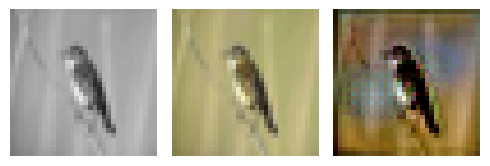

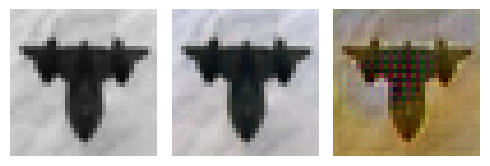

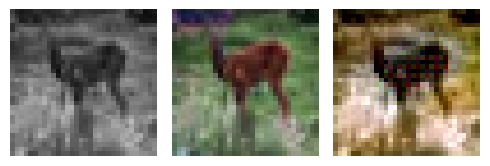

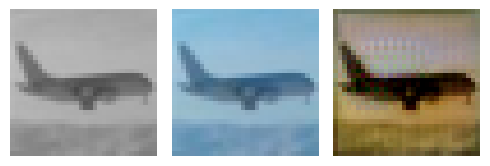

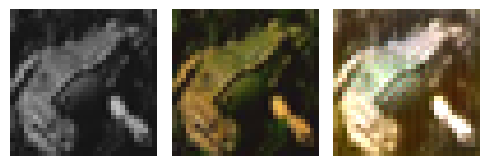

EPOCH: 18.505  trn_loss: 0.005  (1357.35s - 5977.65s remaining)

EPOCH: 18.510  trn_loss: 0.004  (1357.66s - 5977.01s remaining)

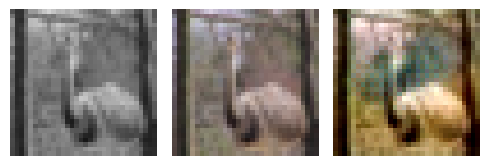

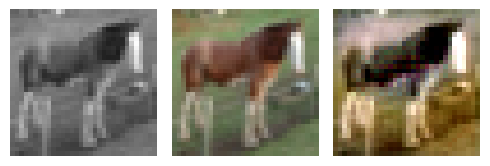

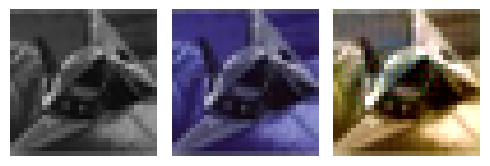

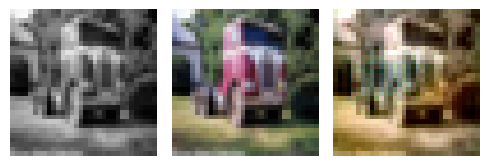

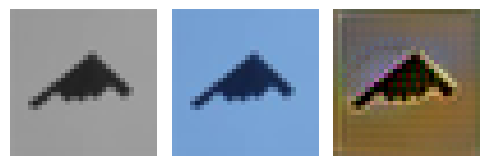

EPOCH: 18.760  trn_loss: 0.005  (1374.75s - 5953.24s remaining)

EPOCH: 18.765  trn_loss: 0.005  (1375.06s - 5952.63s remaining)

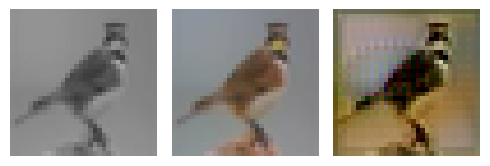

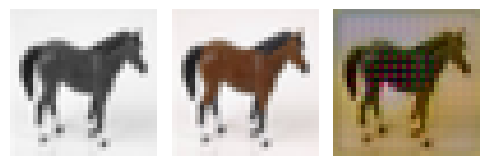

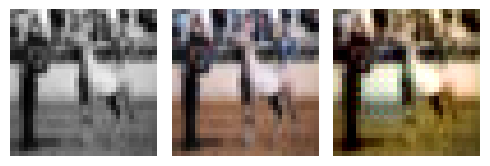

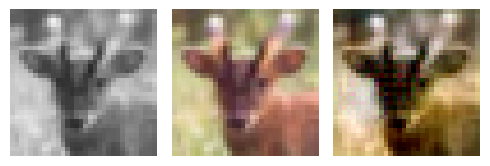

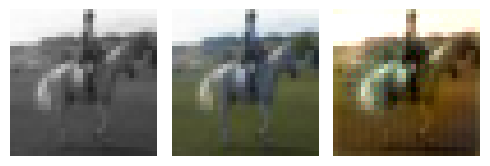

EPOCH: 19.000  val_loss: 0.003  (1398.30s - 5961.17s remaining)

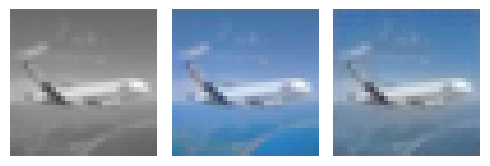

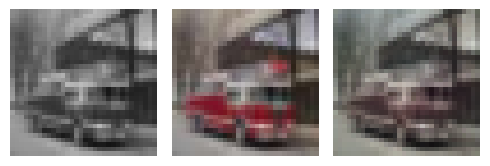

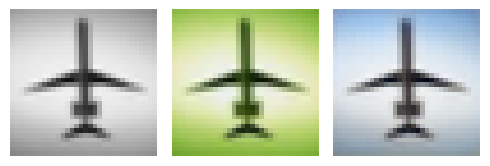

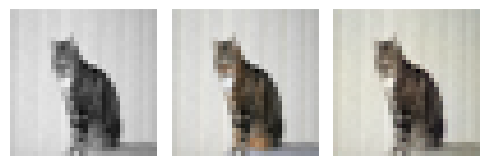

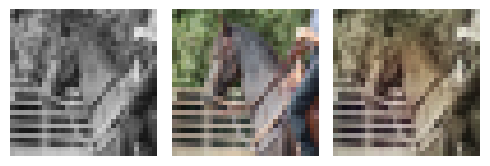

EPOCH: 19.250  trn_loss: 0.005  (1415.15s - 5936.28s remaining)

EPOCH: 19.255  trn_loss: 0.005  (1415.47s - 5935.69s remaining)

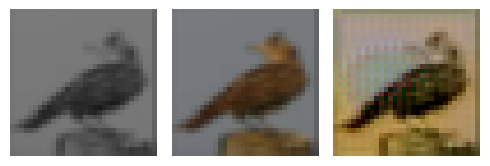

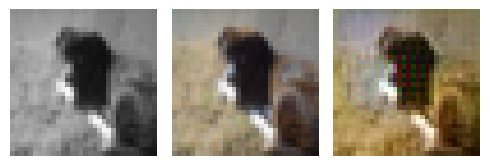

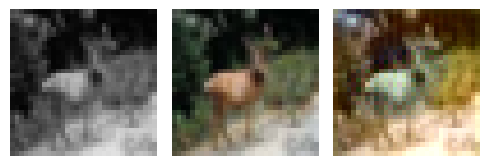

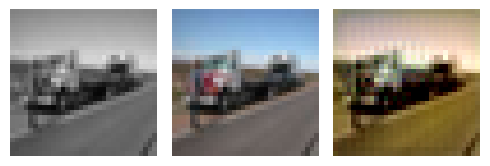

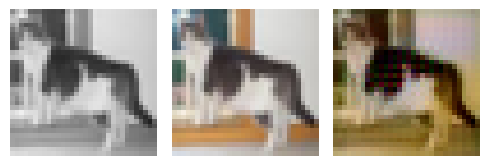

EPOCH: 19.505  trn_loss: 0.005  (1432.47s - 5911.61s remaining)

EPOCH: 19.510  trn_loss: 0.005  (1432.79s - 5911.00s remaining)

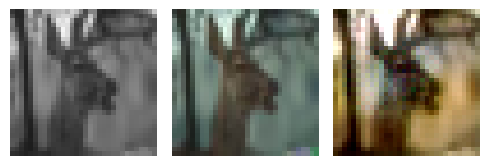

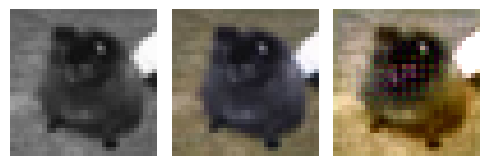

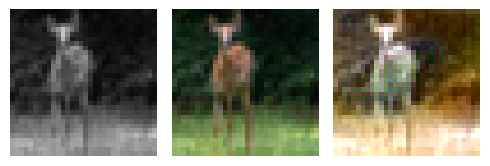

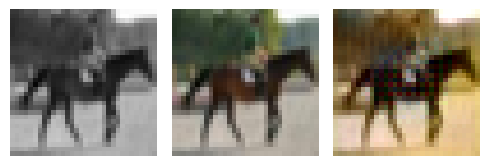

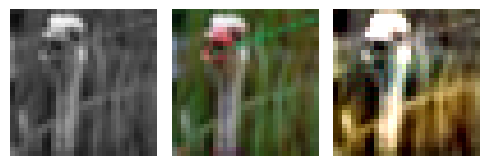

EPOCH: 19.760  trn_loss: 0.004  (1449.98s - 5887.89s remaining)

EPOCH: 19.765  trn_loss: 0.005  (1450.30s - 5887.29s remaining)

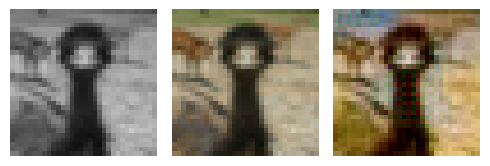

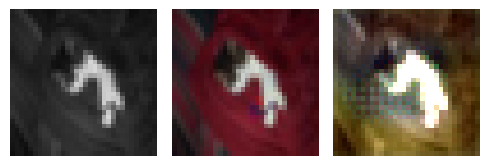

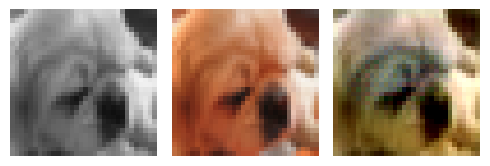

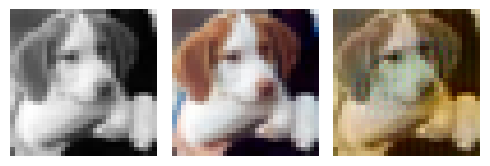

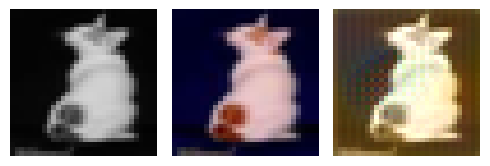

EPOCH: 19.950  val_loss: 0.005  (1472.59s - 5908.79s remaining)

EPOCH: 20.000  trn_loss: 0.005  val_loss: 0.005  (1472.79s - 5891.18s remaining)


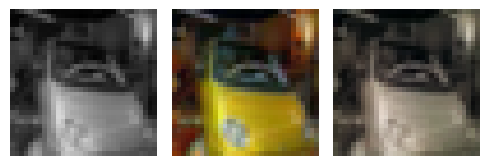

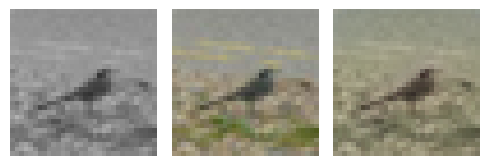

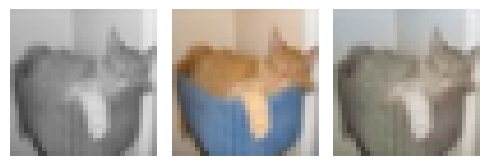

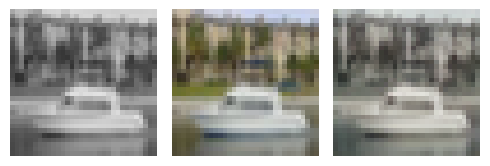

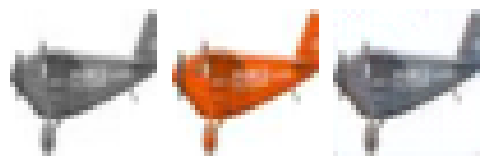

EPOCH: 20.250  trn_loss: 0.005  (1489.86s - 5867.47s remaining)

EPOCH: 20.255  trn_loss: 0.005  (1490.18s - 5866.87s remaining)

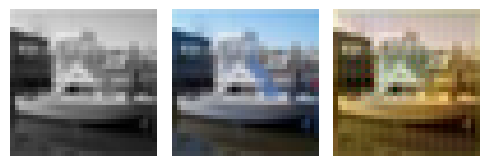

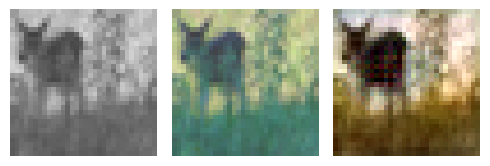

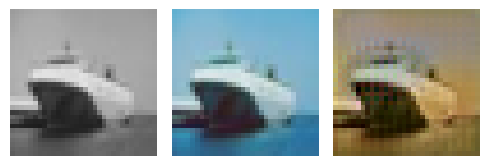

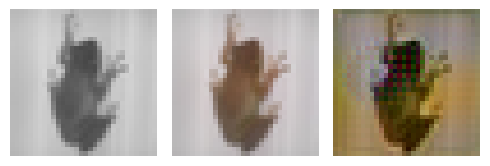

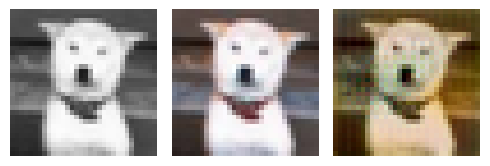

EPOCH: 20.505  trn_loss: 0.005  (1507.28s - 5843.46s remaining)

EPOCH: 20.510  trn_loss: 0.005  (1507.60s - 5842.89s remaining)

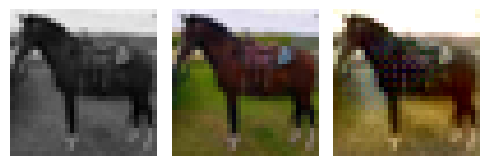

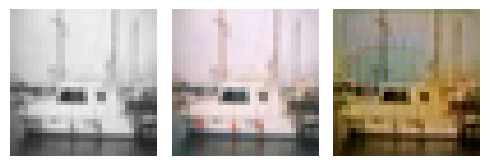

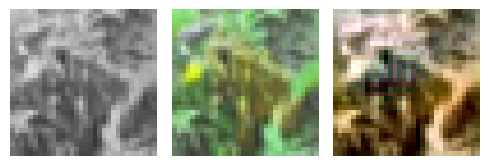

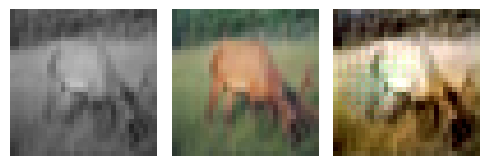

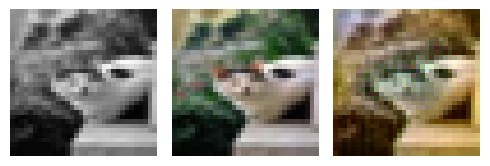

EPOCH: 20.760  trn_loss: 0.004  (1524.32s - 5818.19s remaining)

EPOCH: 20.765  trn_loss: 0.005  (1524.64s - 5817.60s remaining)

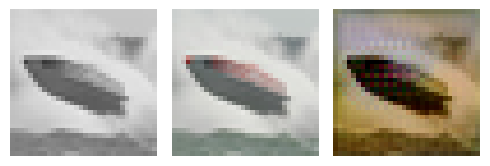

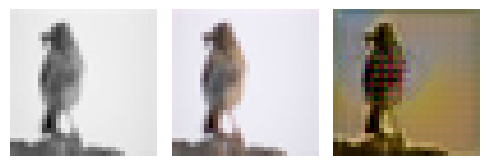

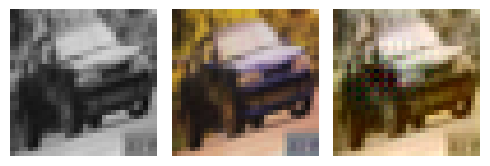

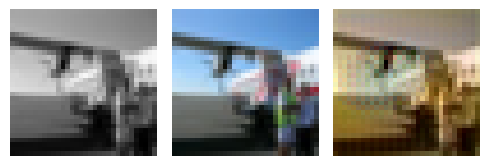

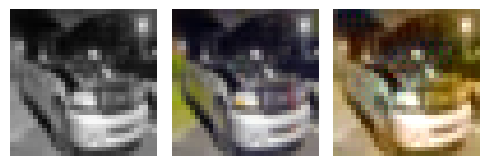

EPOCH: 21.000  val_loss: 0.003  (1547.50s - 5821.56s remaining)

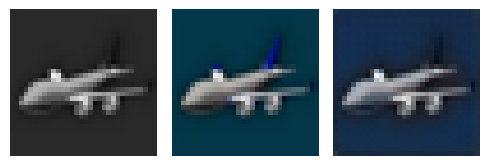

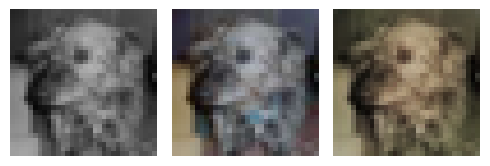

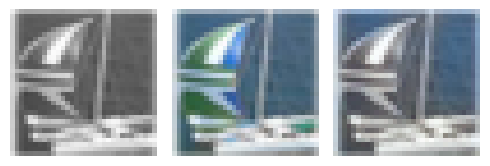

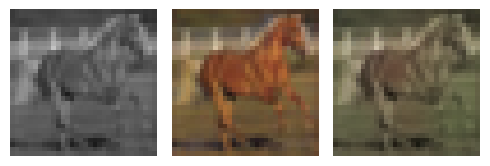

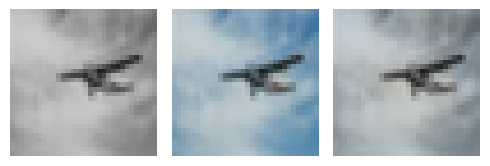

EPOCH: 21.250  trn_loss: 0.005  (1564.09s - 5796.33s remaining)

EPOCH: 21.255  trn_loss: 0.005  (1564.41s - 5795.73s remaining)

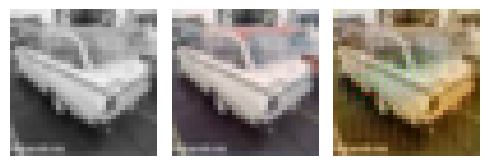

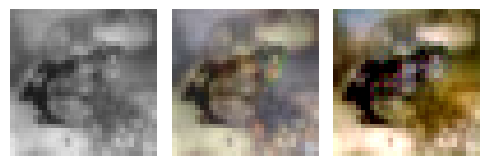

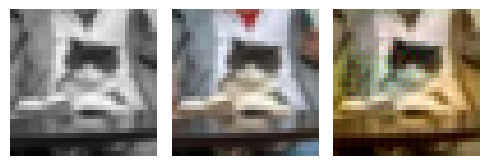

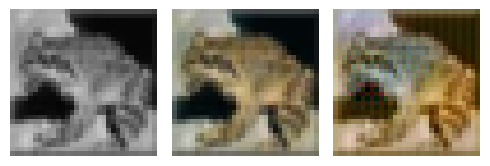

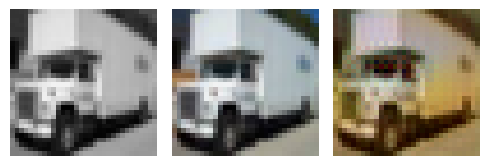

EPOCH: 21.505  trn_loss: 0.005  (1581.61s - 5772.97s remaining)

EPOCH: 21.510  trn_loss: 0.004  (1581.97s - 5772.53s remaining)

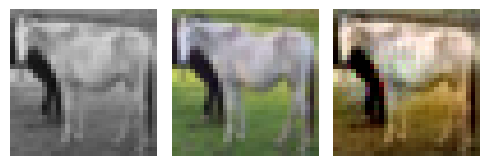

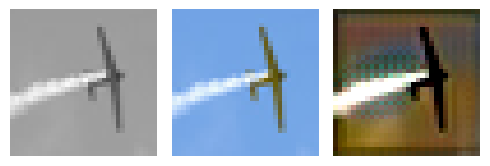

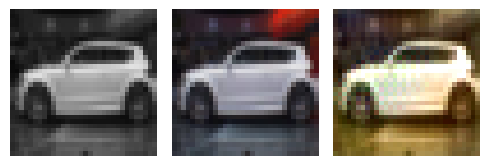

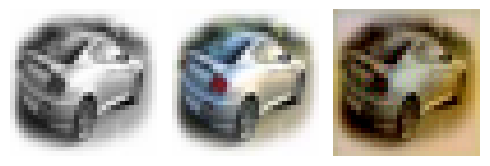

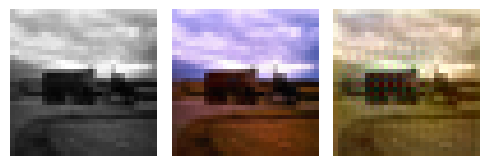

EPOCH: 21.760  trn_loss: 0.005  (1598.81s - 5748.59s remaining)

EPOCH: 21.765  trn_loss: 0.004  (1599.13s - 5748.01s remaining)

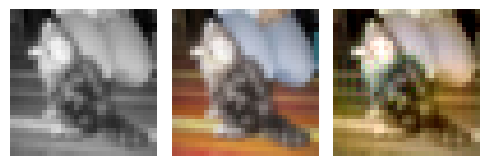

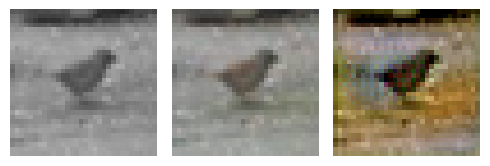

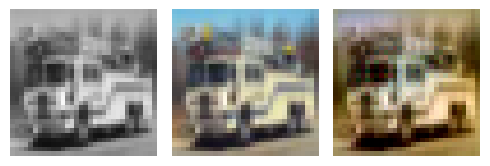

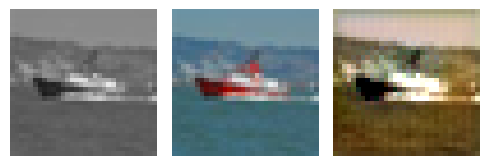

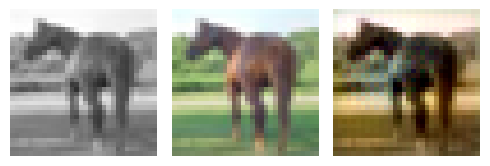

EPOCH: 22.000  val_loss: 0.003  (1622.16s - 5751.31s remaining)

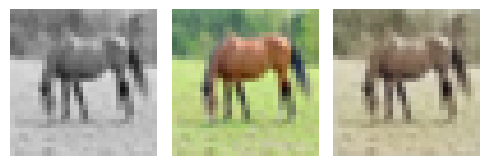

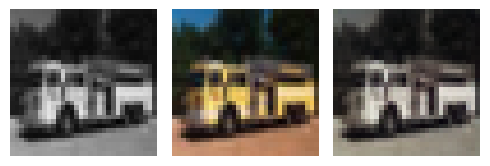

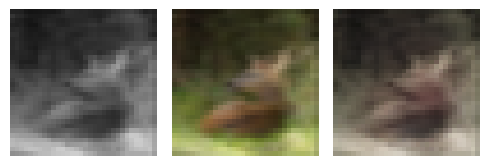

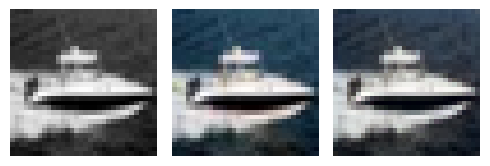

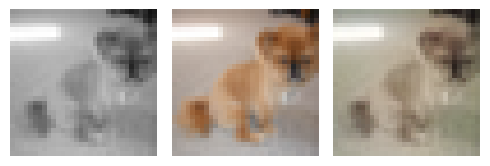

EPOCH: 22.250  trn_loss: 0.004  (1638.89s - 5726.92s remaining)

EPOCH: 22.255  trn_loss: 0.005  (1639.21s - 5726.34s remaining)

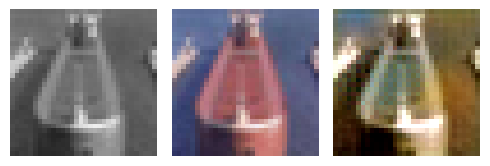

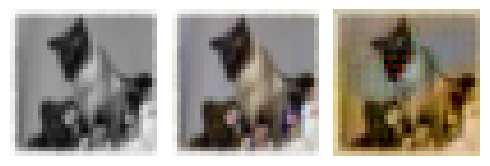

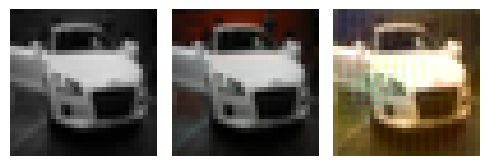

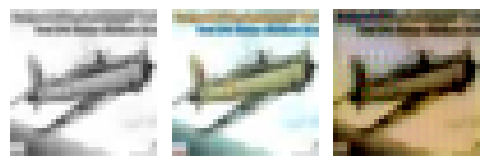

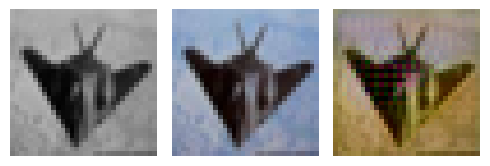

EPOCH: 22.505  trn_loss: 0.005  (1655.95s - 5702.17s remaining)

EPOCH: 22.510  trn_loss: 0.004  (1656.27s - 5701.60s remaining)

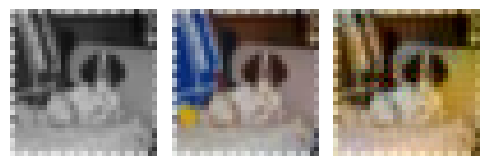

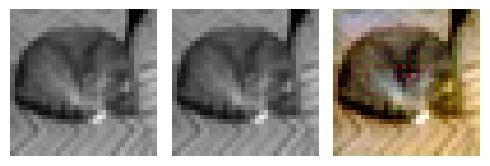

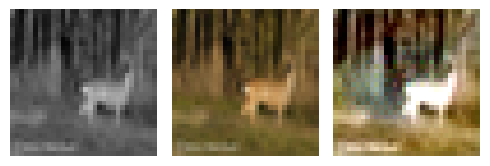

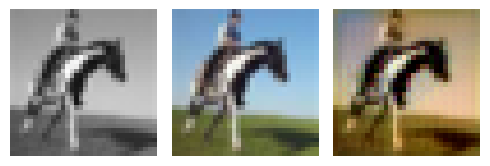

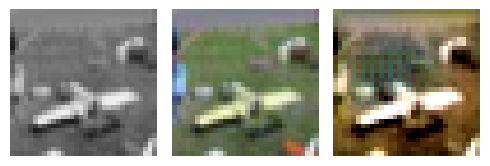

EPOCH: 22.760  trn_loss: 0.004  (1673.82s - 5680.32s remaining)

EPOCH: 22.765  trn_loss: 0.005  (1674.18s - 5679.92s remaining)

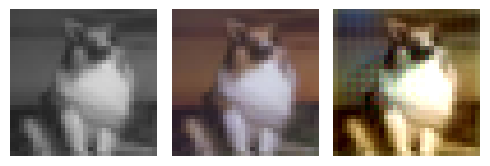

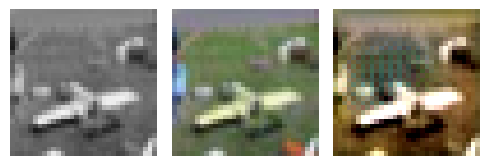

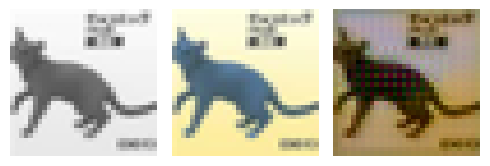

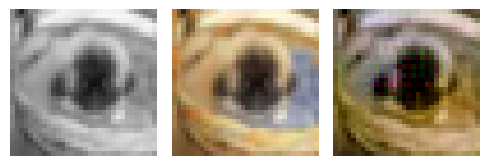

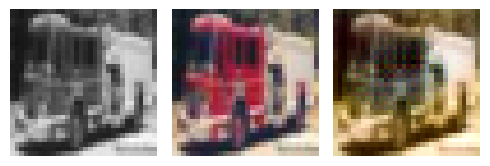

EPOCH: 22.950  val_loss: 0.005  (1696.84s - 5696.79s remaining)

EPOCH: 23.000  val_loss: 0.003  (1697.05s - 5681.42s remaining)

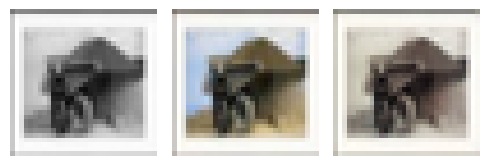

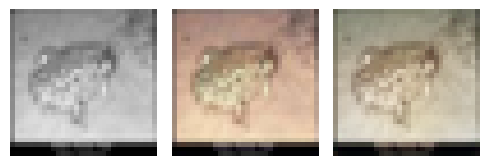

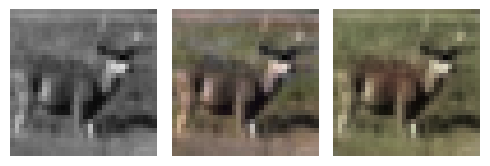

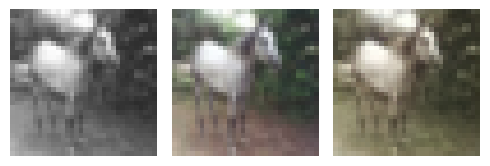

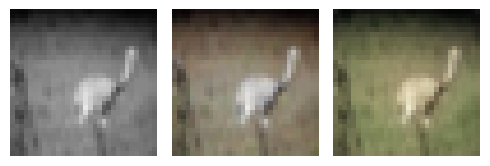

EPOCH: 23.250  trn_loss: 0.004  (1714.25s - 5658.86s remaining)

EPOCH: 23.255  trn_loss: 0.005  (1714.60s - 5658.42s remaining)

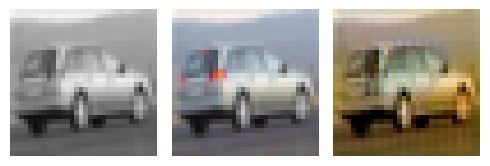

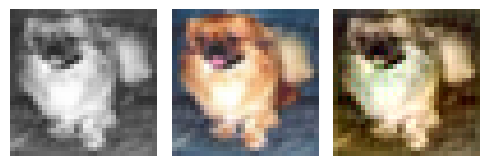

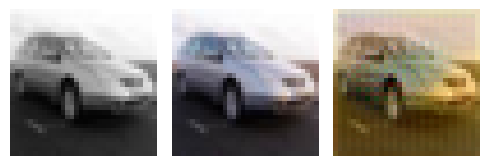

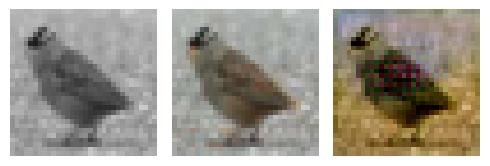

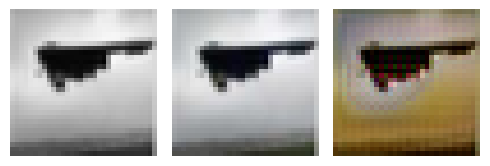

EPOCH: 23.505  trn_loss: 0.005  (1731.49s - 5634.96s remaining)

EPOCH: 23.510  trn_loss: 0.005  (1731.81s - 5634.39s remaining)

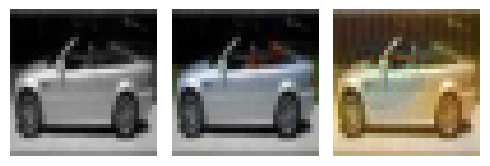

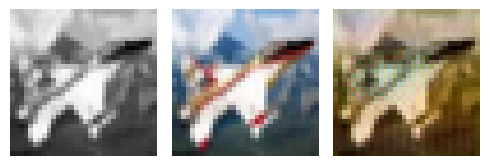

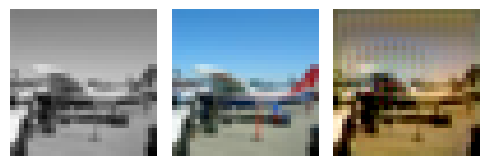

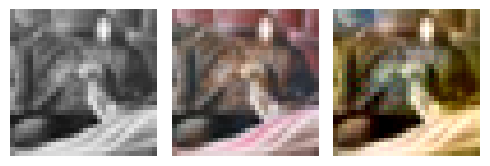

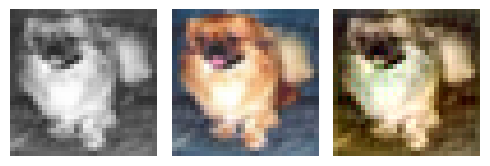

EPOCH: 23.760  trn_loss: 0.005  (1748.83s - 5611.49s remaining)

EPOCH: 23.765  trn_loss: 0.005  (1749.14s - 5610.93s remaining)

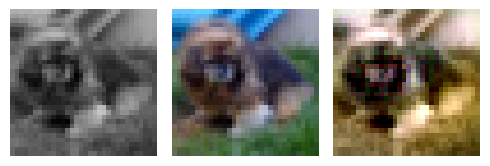

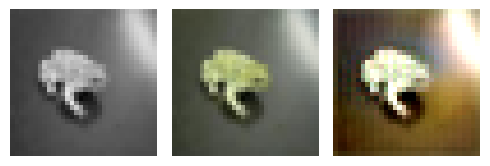

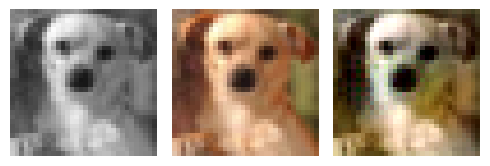

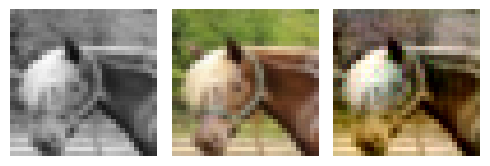

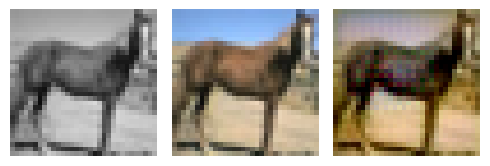

EPOCH: 23.950  val_loss: 0.005  (1772.47s - 5628.23s remaining)

EPOCH: 24.000  val_loss: 0.003  (1772.69s - 5613.53s remaining)

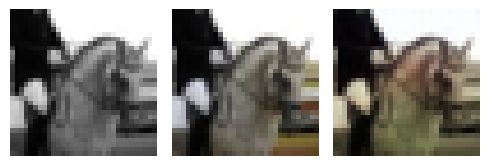

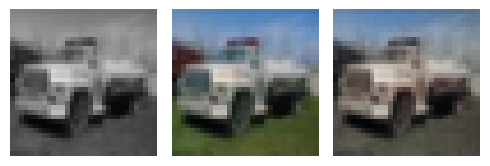

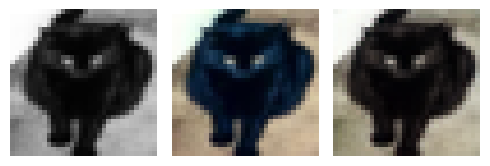

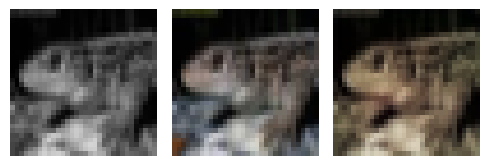

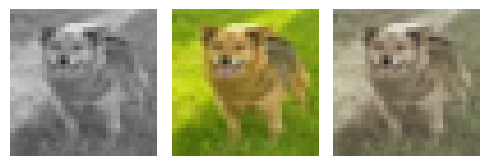

EPOCH: 24.250  trn_loss: 0.005  (1789.79s - 5590.79s remaining)

EPOCH: 24.255  trn_loss: 0.004  (1790.12s - 5590.26s remaining)

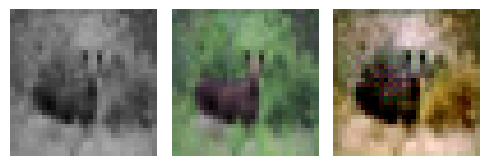

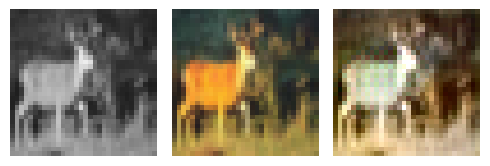

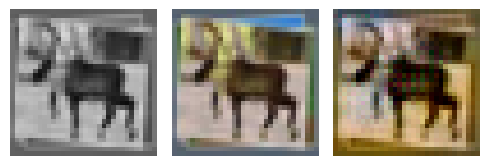

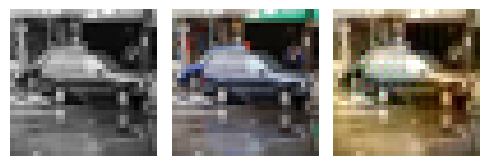

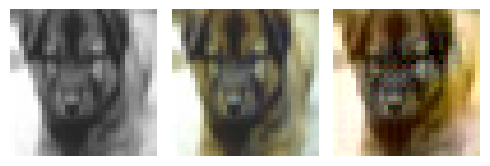

EPOCH: 24.505  trn_loss: 0.005  (1807.05s - 5567.12s remaining)

EPOCH: 24.510  trn_loss: 0.004  (1807.40s - 5566.67s remaining)

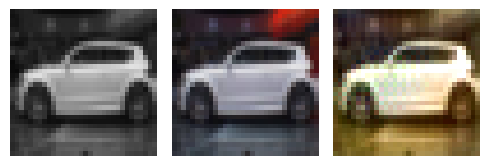

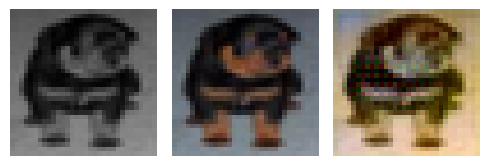

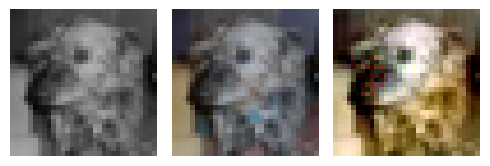

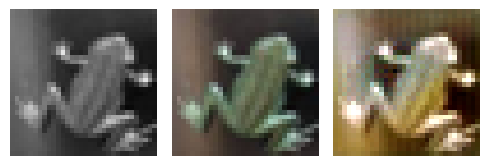

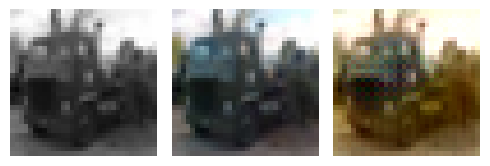

EPOCH: 24.760  trn_loss: 0.005  (1824.66s - 5544.65s remaining)

EPOCH: 24.765  trn_loss: 0.005  (1824.97s - 5544.08s remaining)

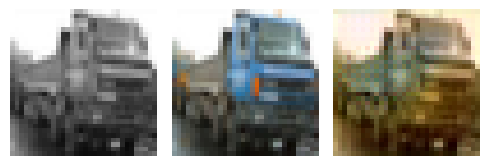

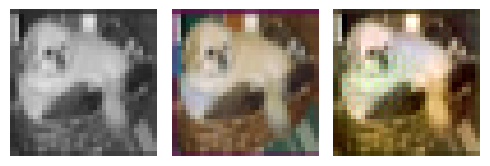

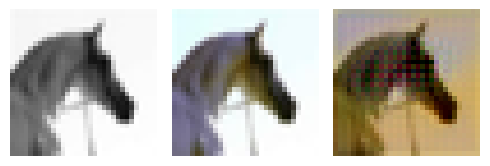

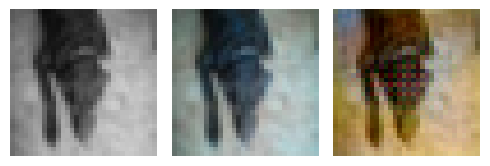

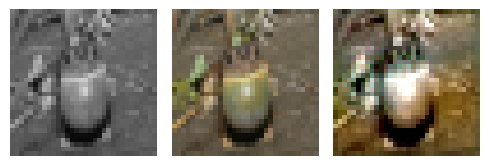

EPOCH: 25.000  trn_loss: 0.005  val_loss: 0.005  (1847.76s - 5543.29s remaining)


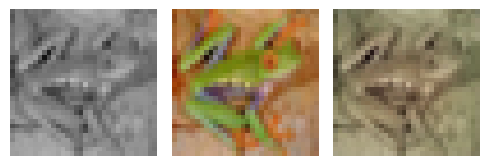

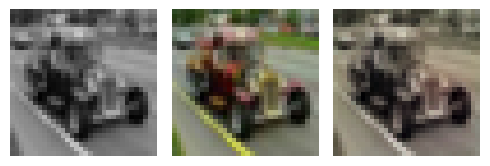

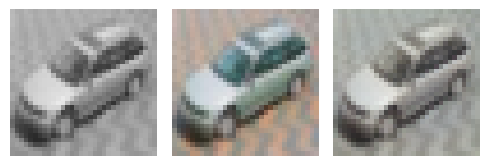

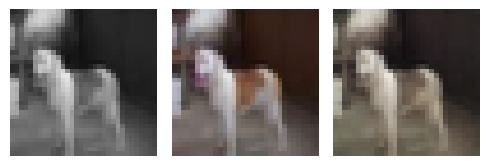

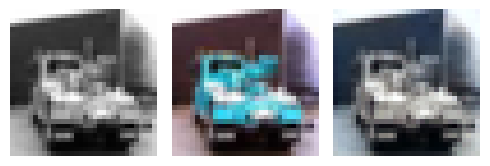

EPOCH: 25.250  trn_loss: 0.005  (1864.76s - 5520.42s remaining)

EPOCH: 25.255  trn_loss: 0.005  (1865.08s - 5519.89s remaining)

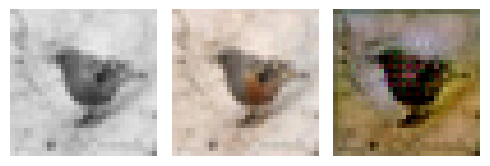

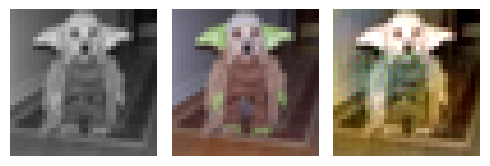

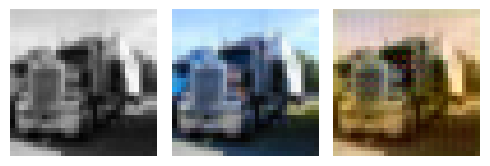

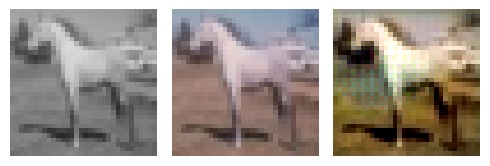

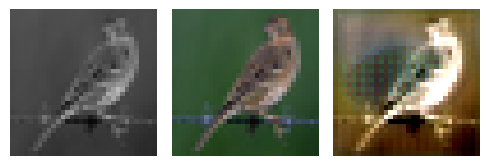

EPOCH: 25.505  trn_loss: 0.005  (1881.84s - 5496.45s remaining)

EPOCH: 25.510  trn_loss: 0.004  (1882.17s - 5495.93s remaining)

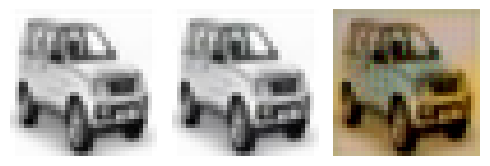

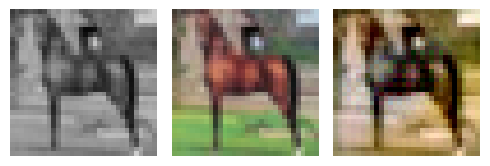

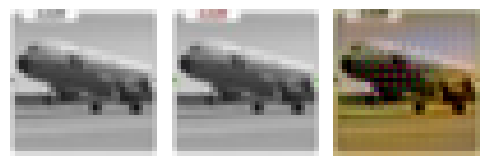

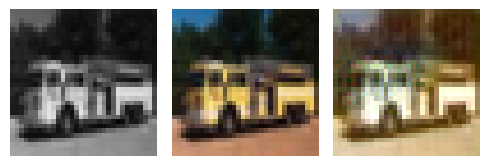

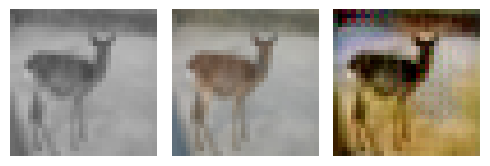

EPOCH: 25.760  trn_loss: 0.005  (1899.09s - 5473.09s remaining)

EPOCH: 25.765  trn_loss: 0.005  (1899.41s - 5472.57s remaining)

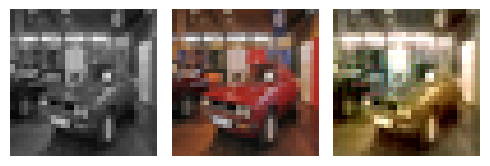

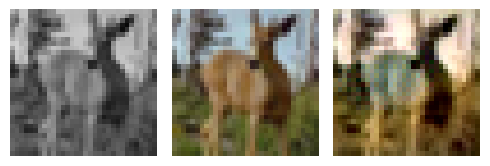

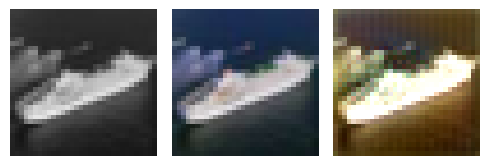

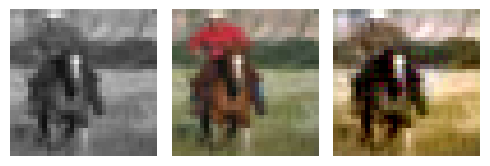

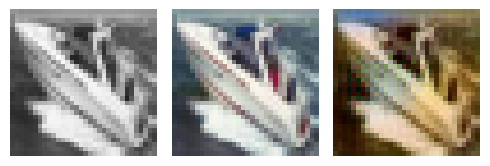

EPOCH: 25.950  val_loss: 0.005  (1922.28s - 5485.35s remaining)

EPOCH: 26.000  val_loss: 0.003  (1922.49s - 5471.70s remaining)

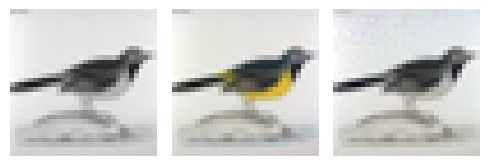

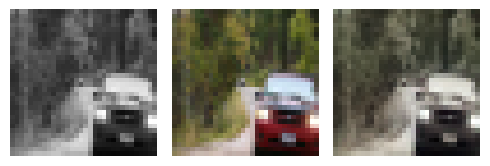

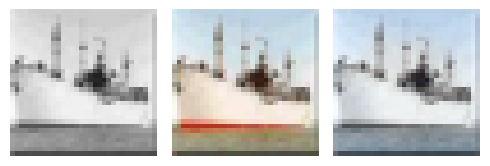

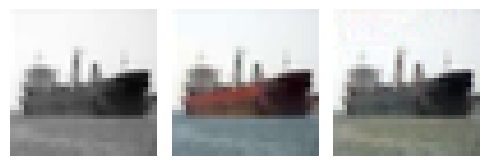

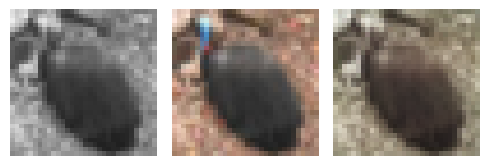

EPOCH: 26.250  trn_loss: 0.005  (1939.47s - 5448.98s remaining)

EPOCH: 26.255  trn_loss: 0.005  (1939.79s - 5448.44s remaining)

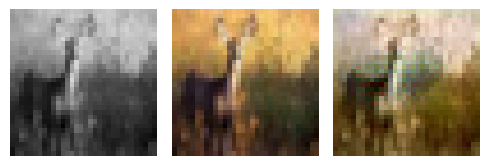

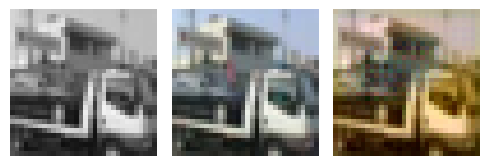

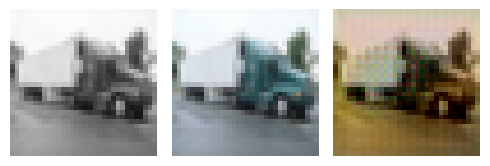

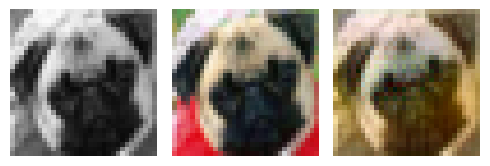

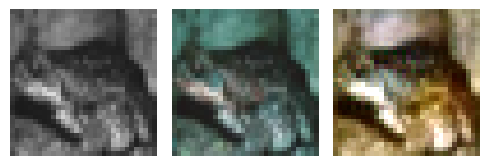

EPOCH: 26.505  trn_loss: 0.005  (1956.97s - 5426.39s remaining)

EPOCH: 26.510  trn_loss: 0.005  (1957.34s - 5426.00s remaining)

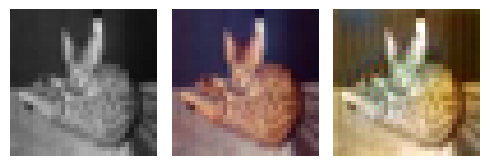

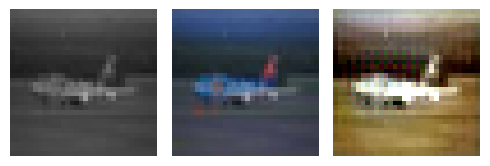

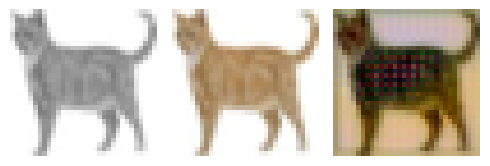

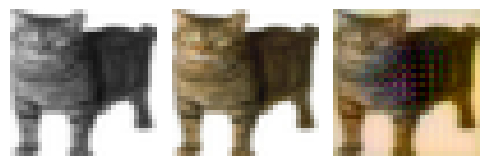

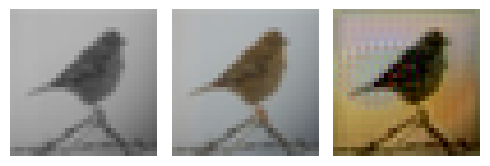

EPOCH: 26.760  trn_loss: 0.005  (1974.91s - 5405.10s remaining)

EPOCH: 26.765  trn_loss: 0.004  (1975.22s - 5404.57s remaining)

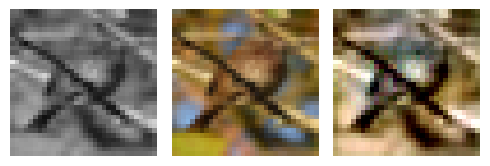

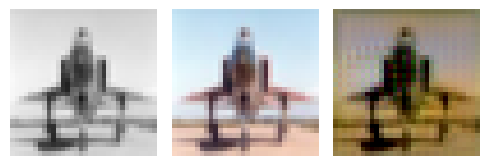

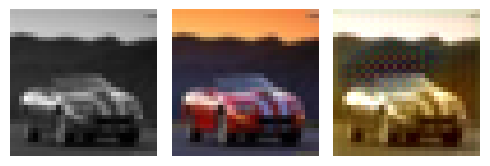

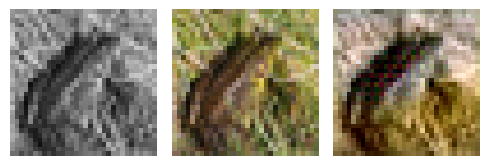

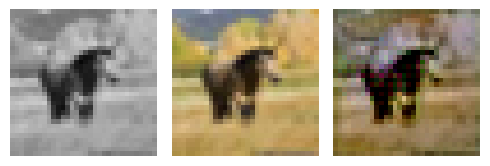

EPOCH: 27.000  val_loss: 0.003  (1998.29s - 5402.79s remaining)

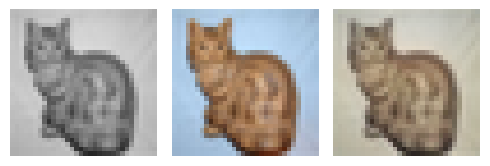

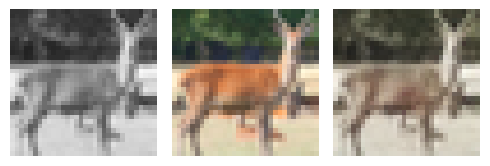

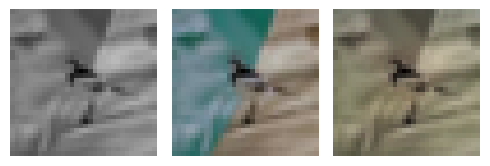

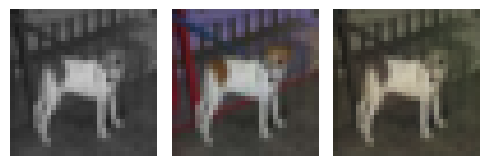

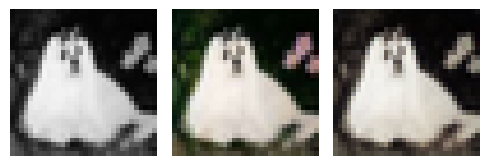

EPOCH: 27.250  trn_loss: 0.004  (2015.42s - 5380.62s remaining)

EPOCH: 27.255  trn_loss: 0.004  (2015.74s - 5380.08s remaining)

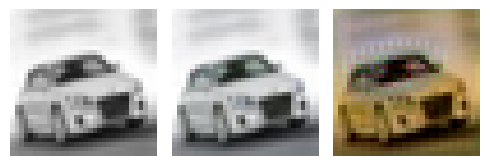

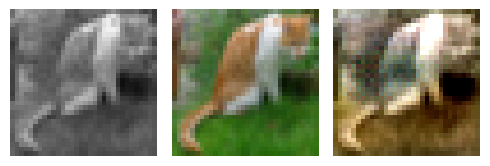

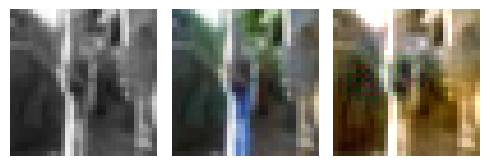

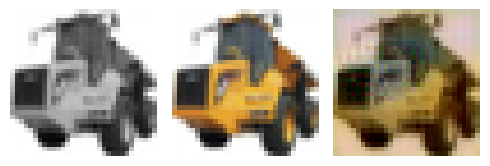

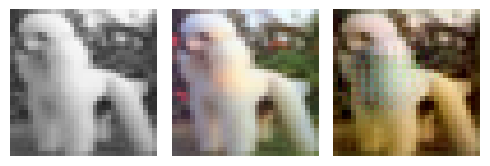

EPOCH: 27.505  trn_loss: 0.004  (2032.69s - 5357.55s remaining)

EPOCH: 27.510  trn_loss: 0.005  (2033.02s - 5357.03s remaining)

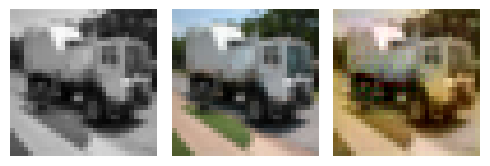

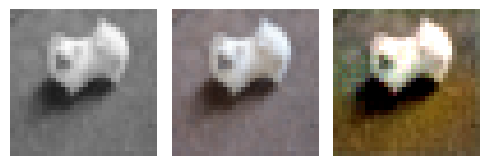

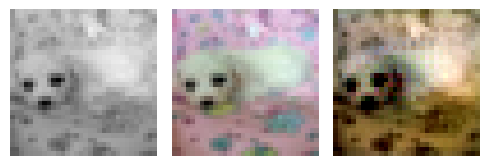

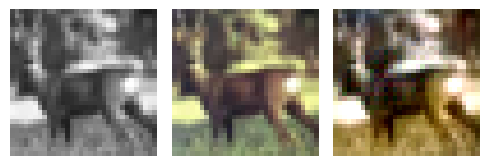

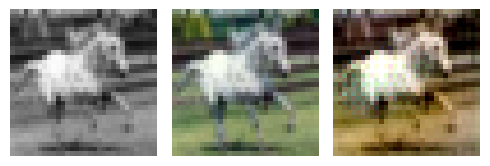

EPOCH: 27.760  trn_loss: 0.005  (2049.90s - 5334.41s remaining)

EPOCH: 27.765  trn_loss: 0.005  (2050.22s - 5333.88s remaining)

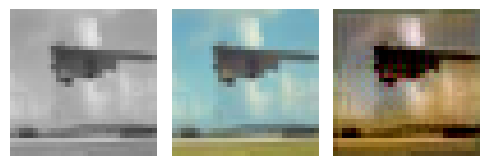

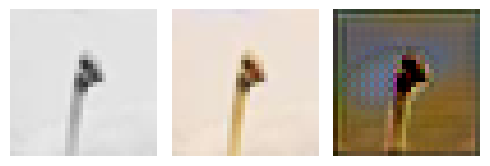

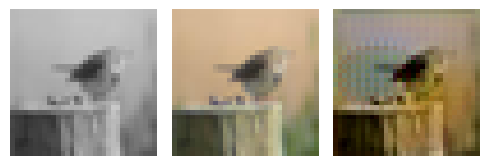

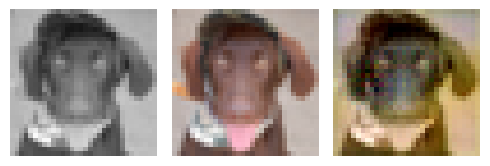

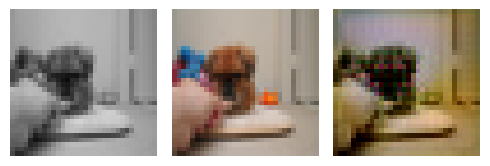

EPOCH: 27.950  val_loss: 0.005  (2073.44s - 5344.95s remaining)

EPOCH: 28.000  val_loss: 0.003  (2073.64s - 5332.23s remaining)

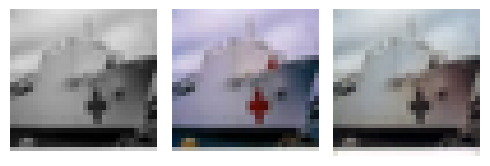

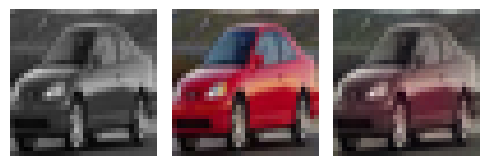

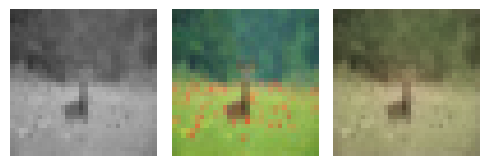

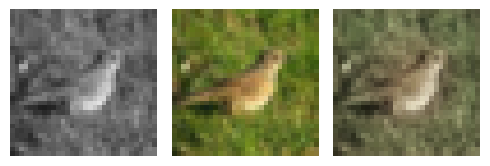

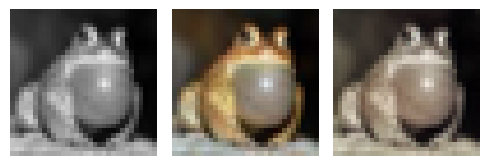

EPOCH: 28.250  trn_loss: 0.004  (2090.48s - 5309.45s remaining)

EPOCH: 28.255  trn_loss: 0.005  (2090.80s - 5308.94s remaining)

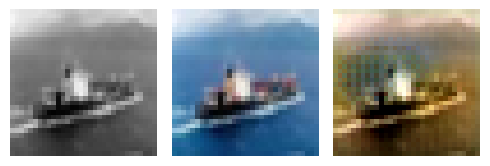

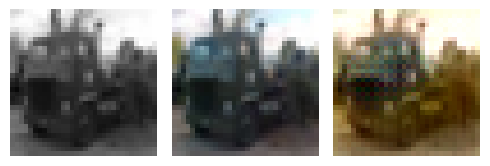

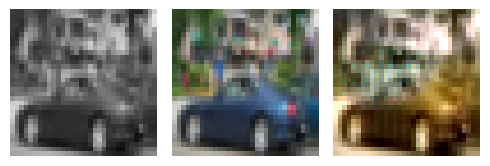

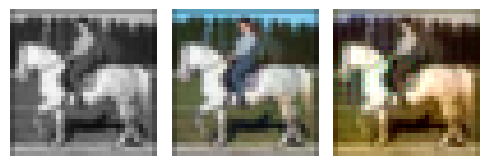

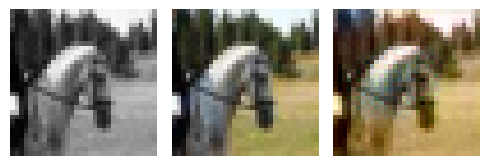

EPOCH: 28.505  trn_loss: 0.004  (2107.88s - 5286.87s remaining)

EPOCH: 28.510  trn_loss: 0.005  (2108.26s - 5286.49s remaining)

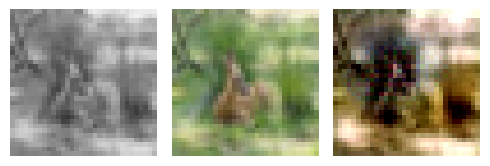

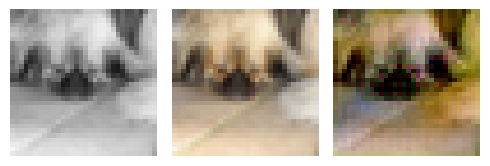

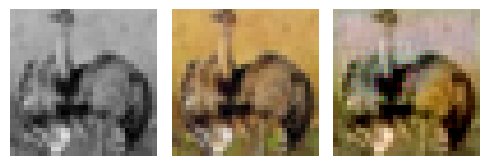

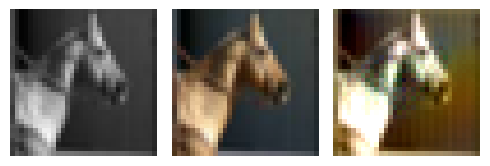

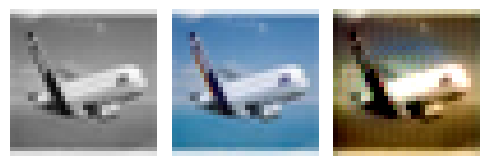

EPOCH: 28.760  trn_loss: 0.005  (2125.34s - 5264.52s remaining)

EPOCH: 28.765  trn_loss: 0.004  (2125.66s - 5263.99s remaining)

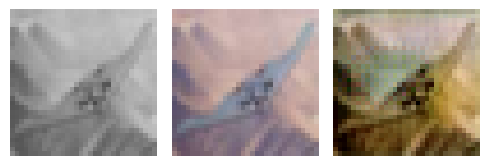

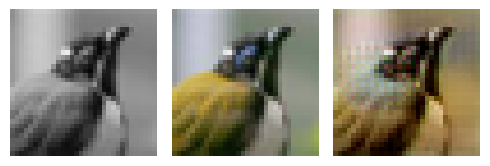

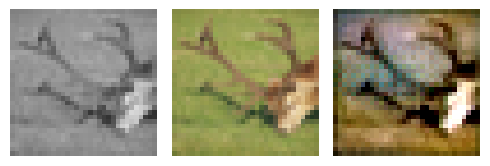

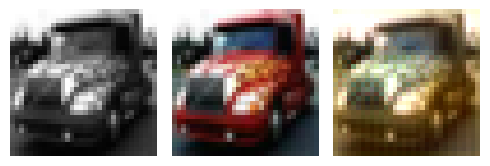

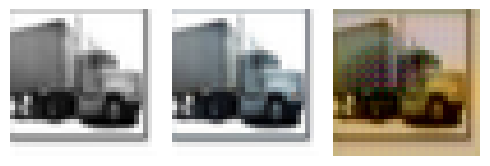

EPOCH: 29.000  val_loss: 0.003  (2149.09s - 5261.58s remaining)

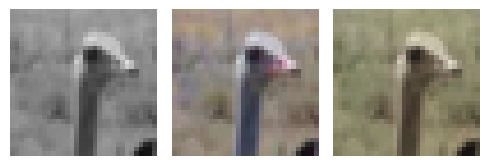

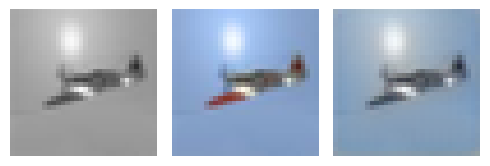

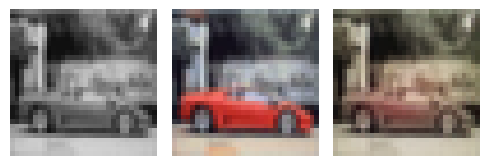

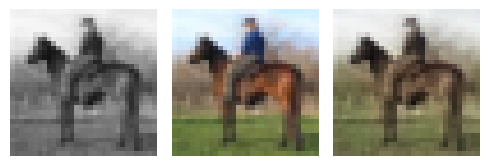

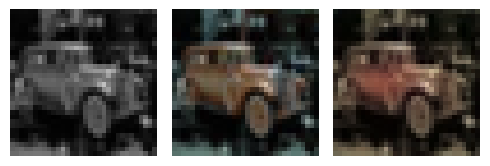

EPOCH: 29.250  trn_loss: 0.004  (2166.04s - 5239.22s remaining)

EPOCH: 29.255  trn_loss: 0.004  (2166.36s - 5238.70s remaining)

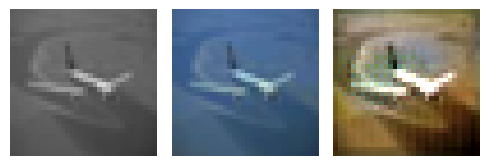

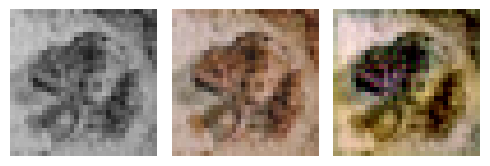

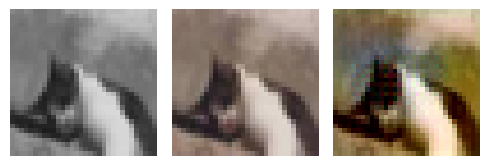

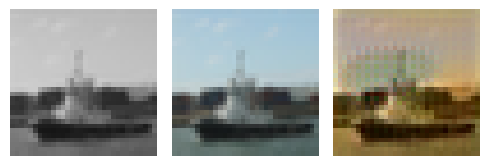

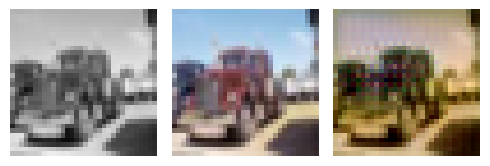

EPOCH: 29.505  trn_loss: 0.005  (2183.17s - 5216.13s remaining)

EPOCH: 29.510  trn_loss: 0.004  (2183.49s - 5215.62s remaining)

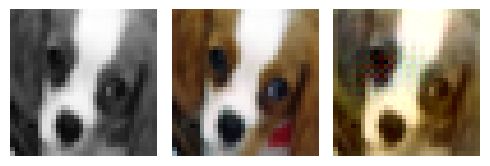

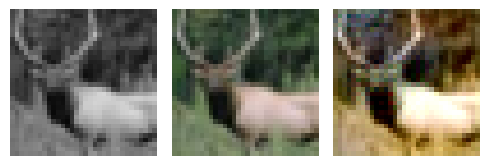

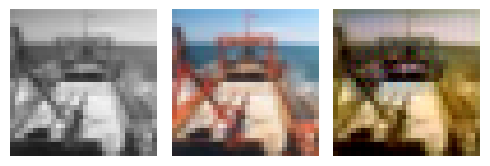

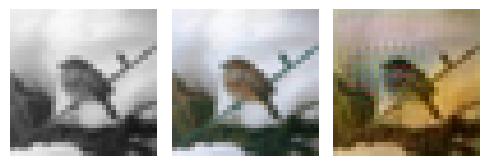

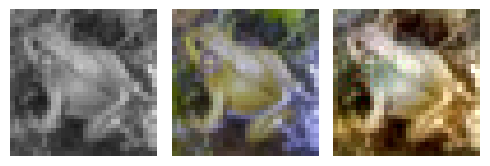

EPOCH: 29.760  trn_loss: 0.005  (2200.53s - 5193.66s remaining)

EPOCH: 29.765  trn_loss: 0.005  (2200.85s - 5193.16s remaining)

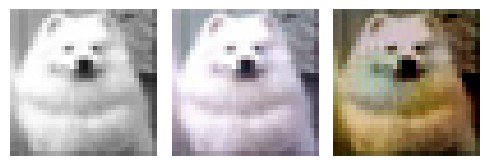

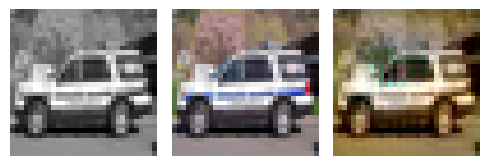

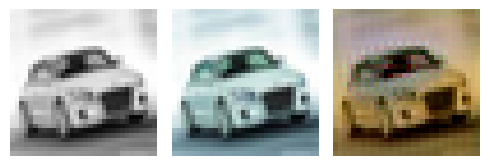

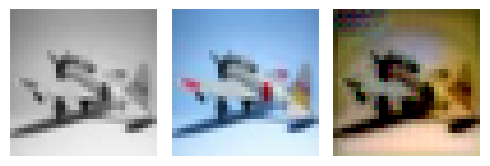

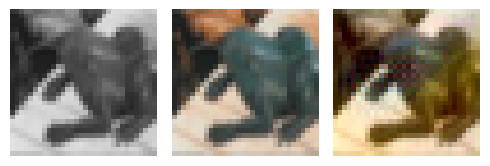

EPOCH: 30.000  trn_loss: 0.005  val_loss: 0.005  (2224.87s - 5191.37s remaining)


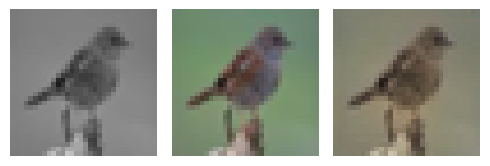

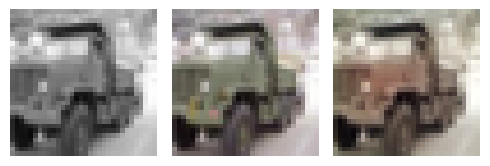

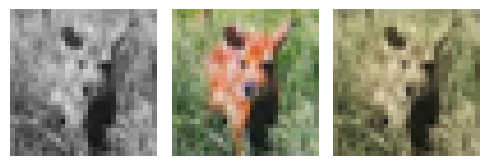

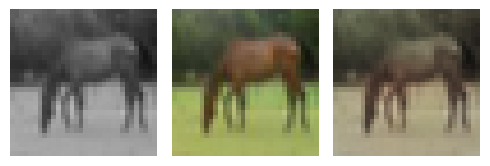

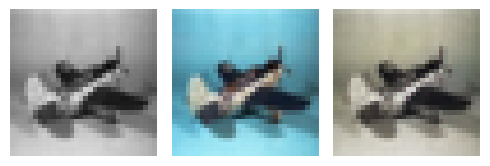

EPOCH: 30.250  trn_loss: 0.005  (2241.87s - 5169.26s remaining)

EPOCH: 30.255  trn_loss: 0.004  (2242.19s - 5168.76s remaining)

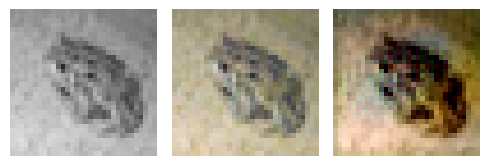

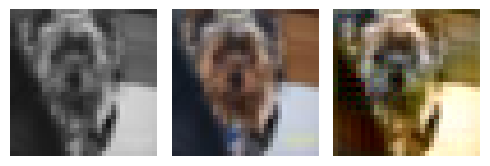

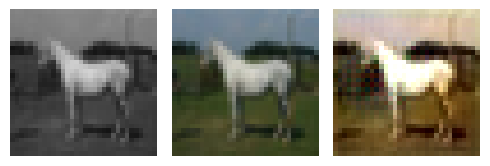

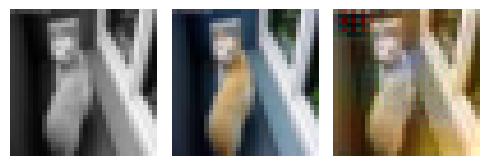

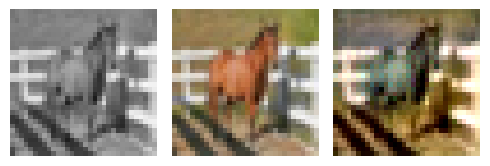

EPOCH: 30.505  trn_loss: 0.004  (2259.52s - 5147.49s remaining)

EPOCH: 30.510  trn_loss: 0.005  (2259.89s - 5147.11s remaining)

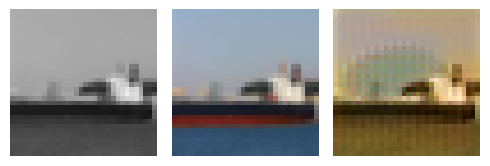

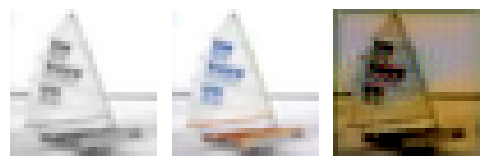

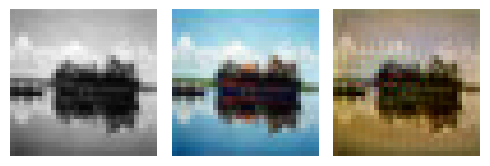

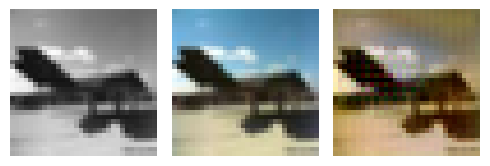

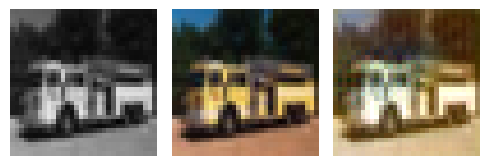

EPOCH: 30.760  trn_loss: 0.005  (2277.25s - 5125.98s remaining)

EPOCH: 30.765  trn_loss: 0.004  (2277.57s - 5125.48s remaining)

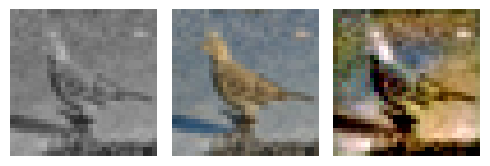

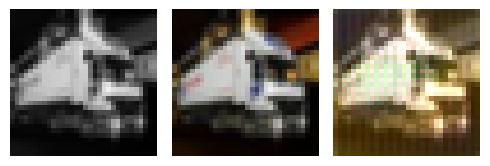

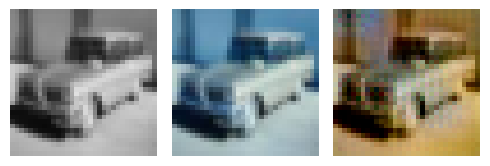

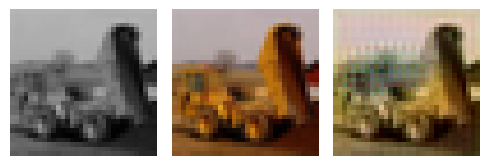

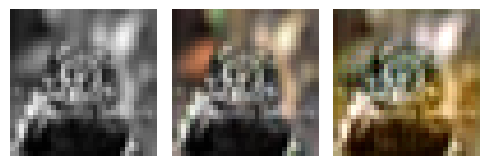

EPOCH: 31.000  val_loss: 0.003  (2300.62s - 5120.73s remaining)

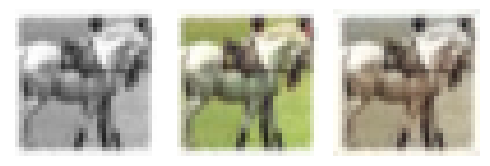

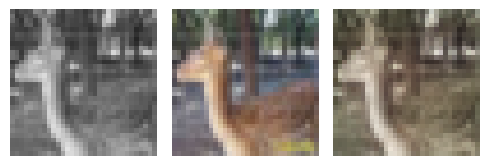

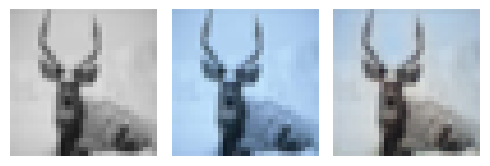

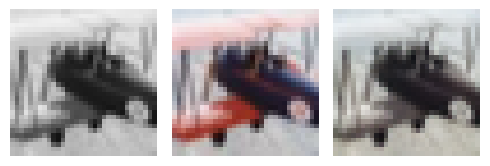

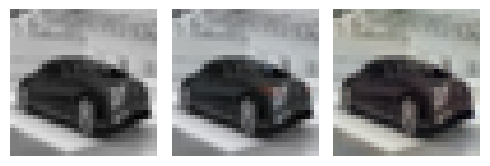

EPOCH: 31.250  trn_loss: 0.004  (2318.32s - 5100.31s remaining)

EPOCH: 31.255  trn_loss: 0.005  (2318.64s - 5099.81s remaining)

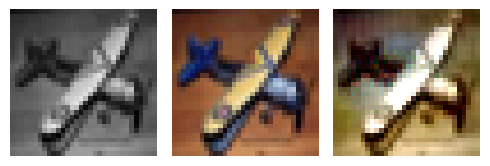

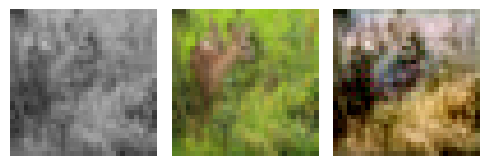

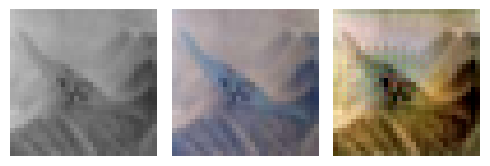

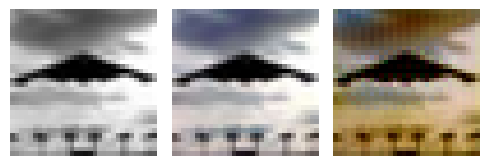

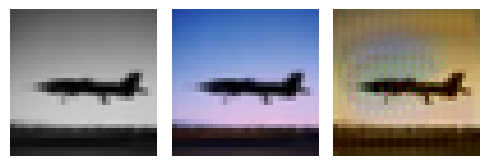

EPOCH: 31.505  trn_loss: 0.004  (2335.64s - 5077.88s remaining)

EPOCH: 31.510  trn_loss: 0.004  (2335.96s - 5077.38s remaining)

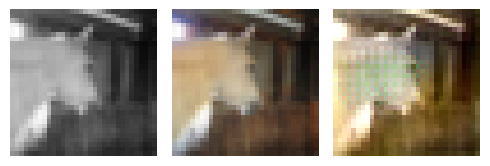

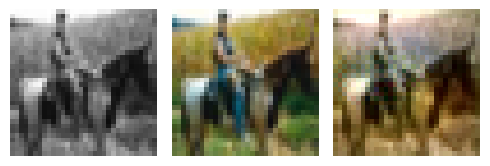

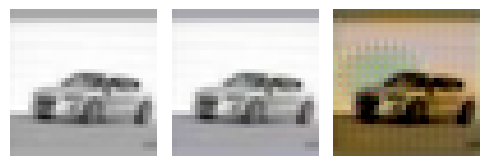

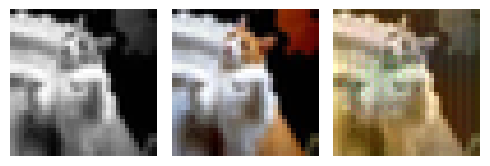

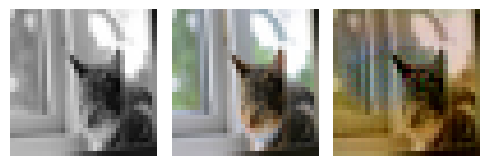

EPOCH: 31.760  trn_loss: 0.005  (2353.10s - 5055.85s remaining)

EPOCH: 31.765  trn_loss: 0.005  (2353.45s - 5055.42s remaining)

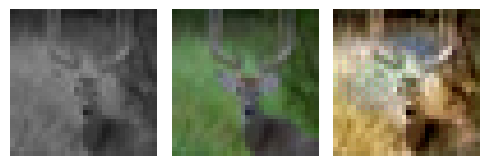

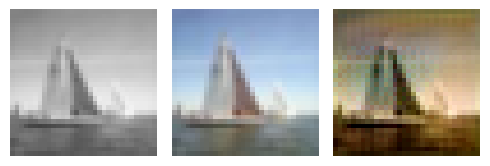

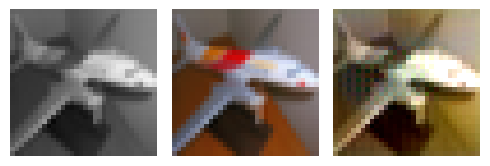

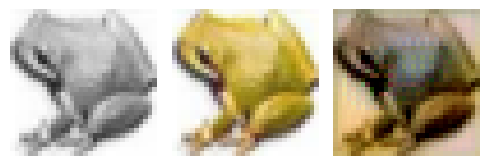

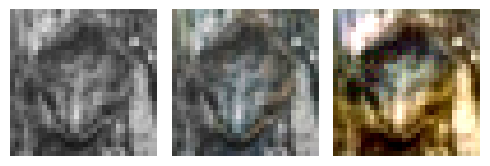

EPOCH: 32.000  val_loss: 0.003  (2377.40s - 5051.98s remaining)

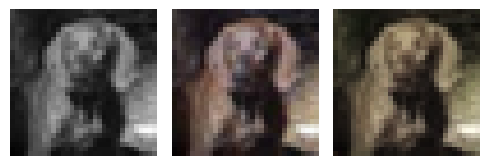

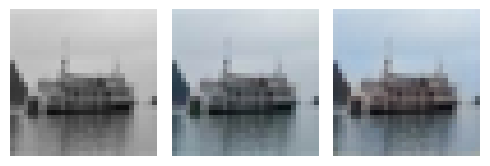

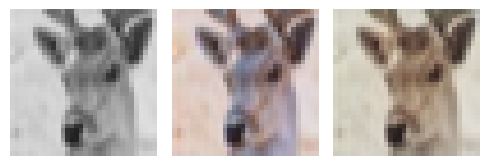

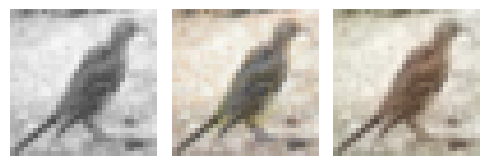

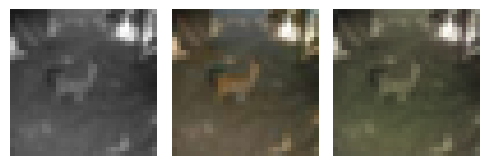

EPOCH: 32.250  trn_loss: 0.004  (2394.48s - 5030.26s remaining)

EPOCH: 32.255  trn_loss: 0.004  (2394.82s - 5029.80s remaining)

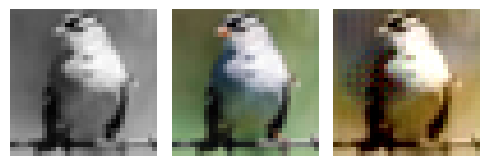

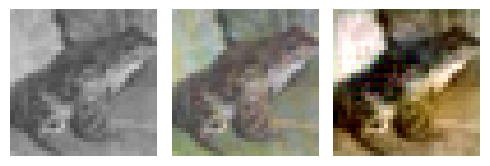

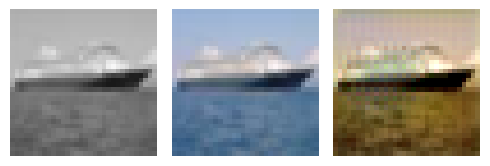

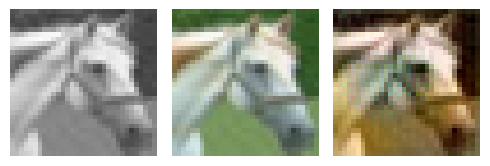

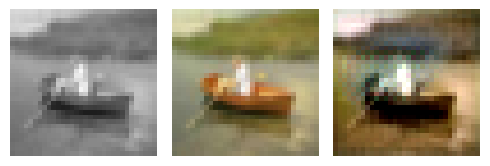

EPOCH: 32.505  trn_loss: 0.004  (2411.97s - 5008.32s remaining)

EPOCH: 32.510  trn_loss: 0.004  (2412.29s - 5007.81s remaining)

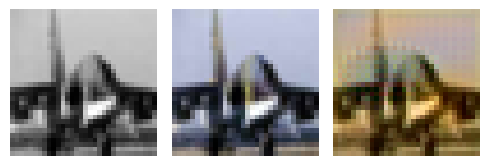

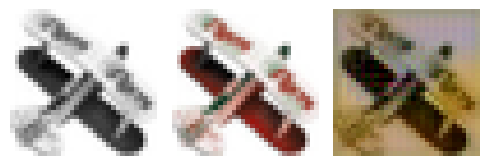

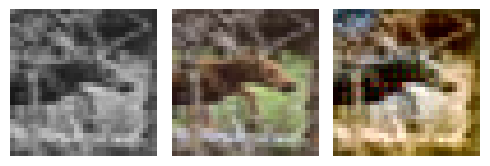

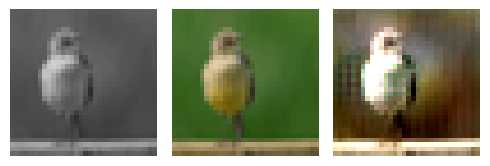

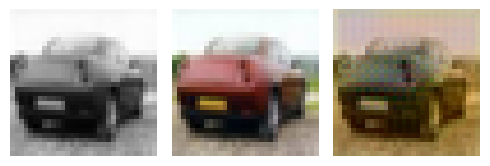

EPOCH: 32.760  trn_loss: 0.005  (2429.62s - 4986.76s remaining)

EPOCH: 32.765  trn_loss: 0.004  (2429.98s - 4986.34s remaining)

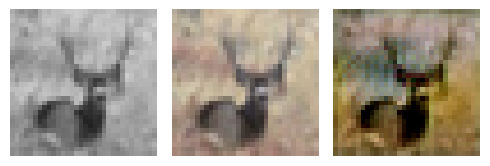

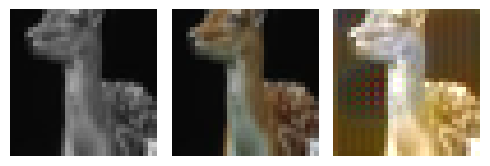

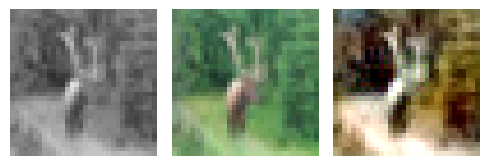

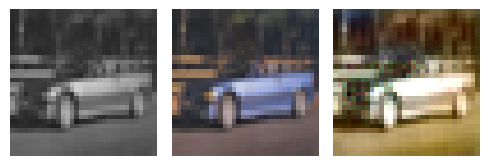

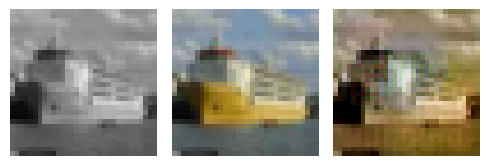

EPOCH: 33.000  val_loss: 0.003  (2452.89s - 4980.11s remaining)

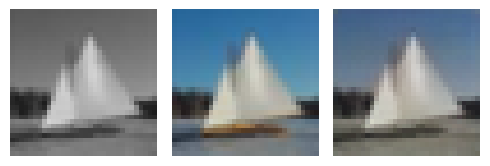

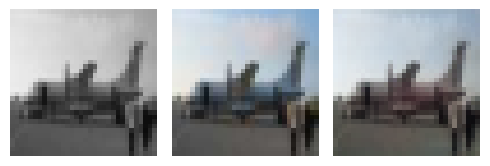

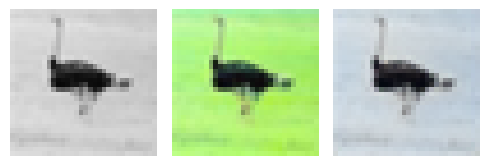

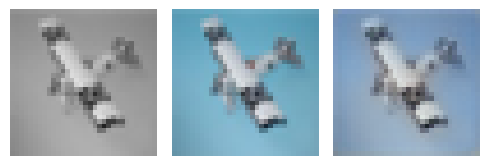

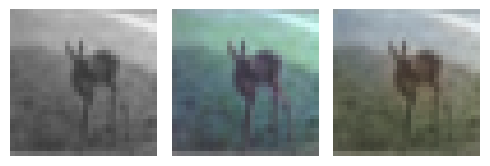

EPOCH: 33.250  trn_loss: 0.005  (2470.34s - 4959.26s remaining)

EPOCH: 33.255  trn_loss: 0.004  (2470.69s - 4958.82s remaining)

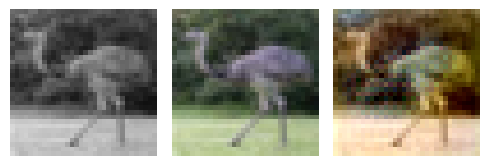

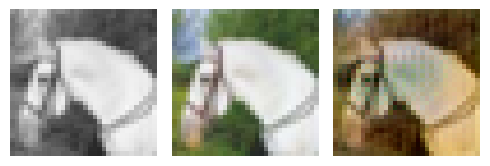

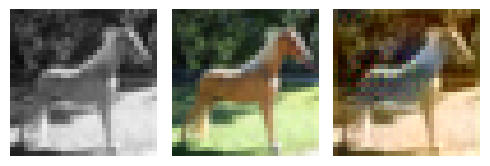

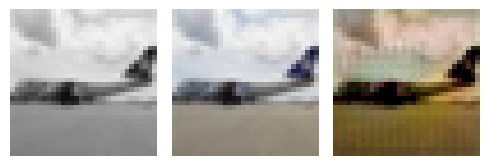

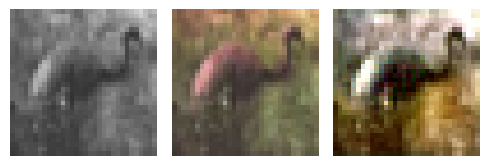

EPOCH: 33.505  trn_loss: 0.004  (2488.26s - 4938.25s remaining)

EPOCH: 33.510  trn_loss: 0.004  (2488.59s - 4937.78s remaining)

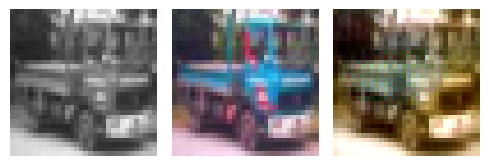

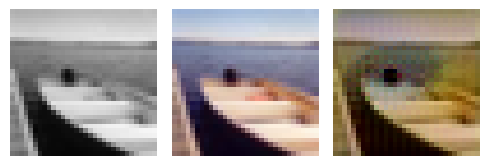

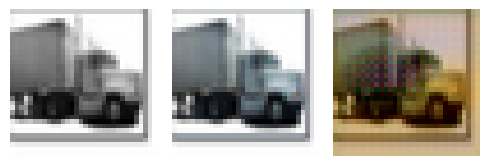

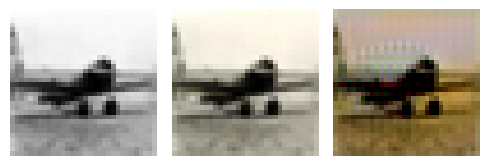

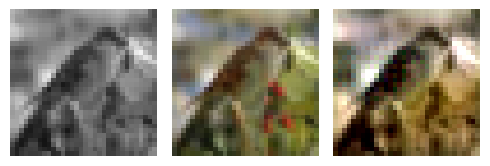

EPOCH: 33.760  trn_loss: 0.005  (2505.95s - 4916.84s remaining)

EPOCH: 33.765  trn_loss: 0.005  (2506.27s - 4916.36s remaining)

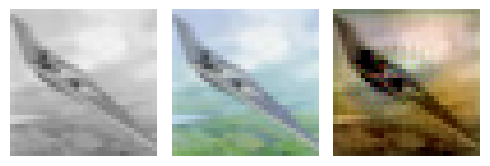

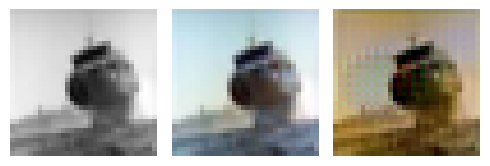

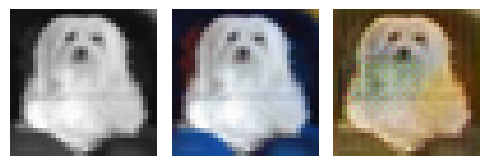

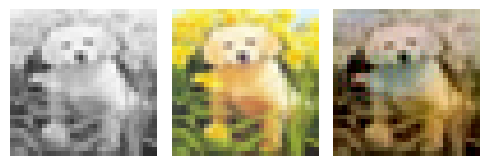

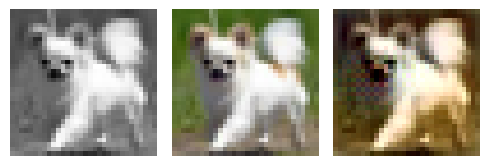

EPOCH: 34.000  val_loss: 0.003  (2530.09s - 4911.35s remaining)

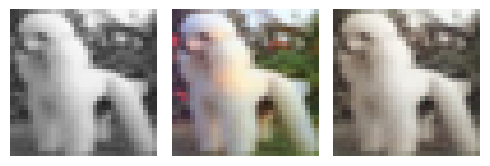

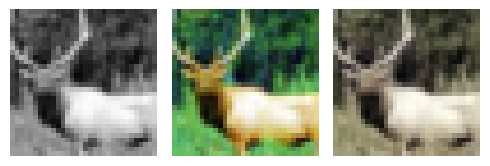

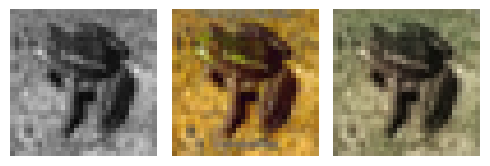

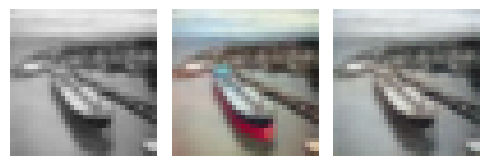

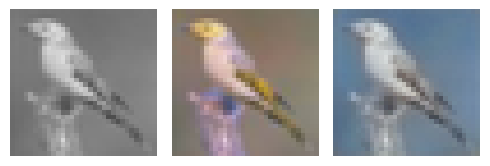

EPOCH: 34.250  trn_loss: 0.004  (2547.51s - 4890.47s remaining)

EPOCH: 34.255  trn_loss: 0.004  (2547.83s - 4889.98s remaining)

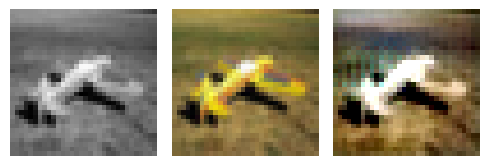

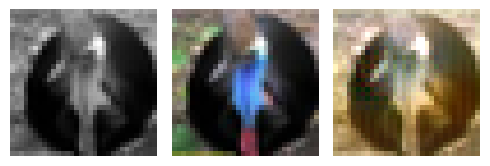

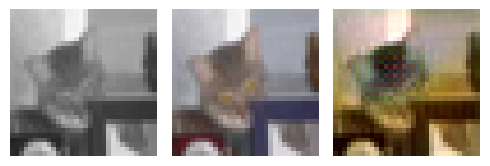

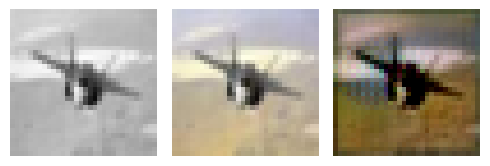

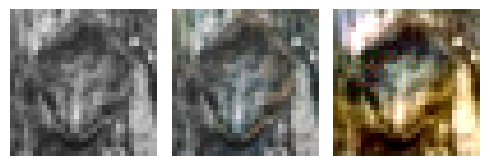

EPOCH: 34.505  trn_loss: 0.005  (2565.12s - 4868.91s remaining)

EPOCH: 34.510  trn_loss: 0.005  (2565.44s - 4868.41s remaining)

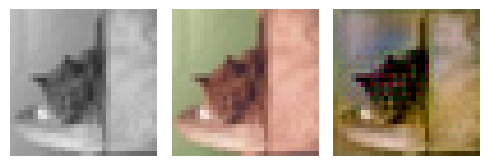

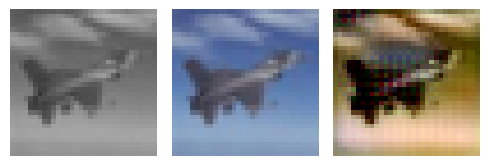

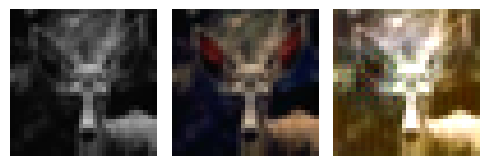

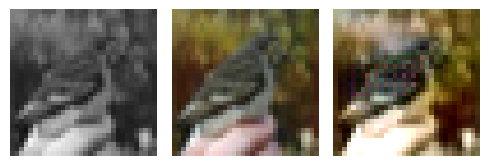

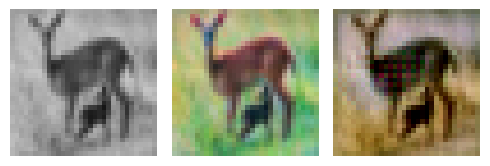

EPOCH: 34.760  trn_loss: 0.005  (2582.90s - 4847.72s remaining)

EPOCH: 34.765  trn_loss: 0.004  (2583.28s - 4847.35s remaining)

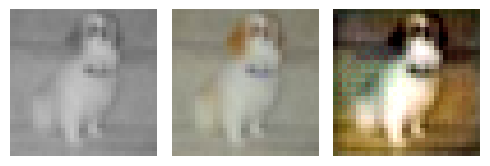

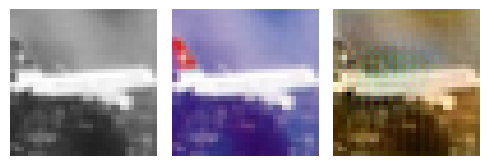

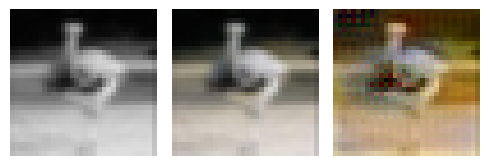

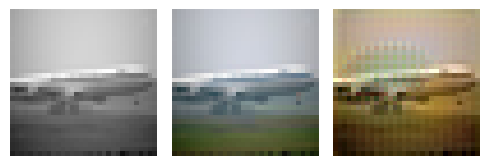

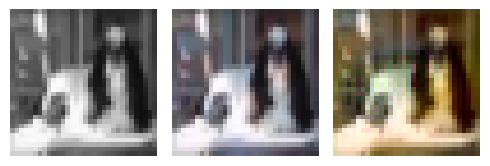

EPOCH: 34.950  val_loss: 0.005  (2606.40s - 4851.11s remaining)

EPOCH: 35.000  trn_loss: 0.005  val_loss: 0.005  (2606.61s - 4840.85s remaining)


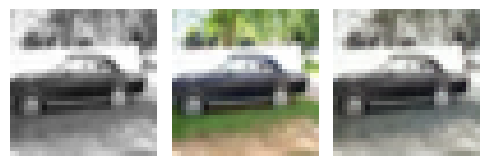

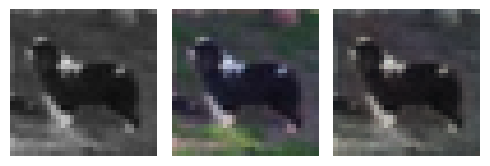

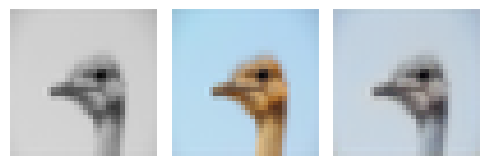

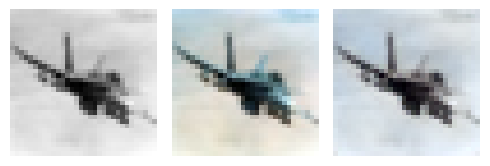

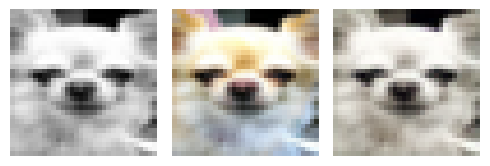

EPOCH: 35.255  trn_loss: 0.005  (2624.37s - 4819.58s remaining)

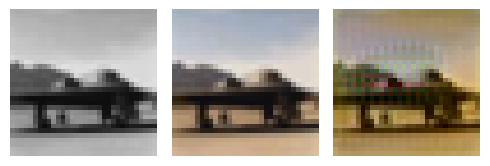

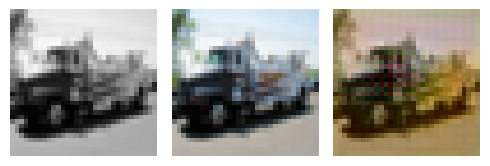

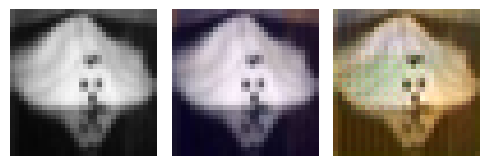

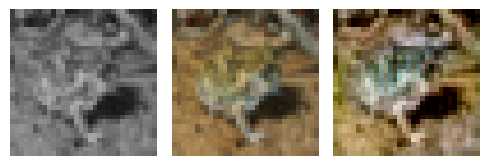

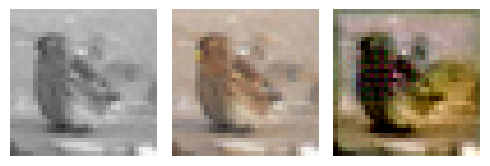

EPOCH: 35.505  trn_loss: 0.005  (2642.27s - 4799.67s remaining)

EPOCH: 35.510  trn_loss: 0.005  (2642.60s - 4799.20s remaining)

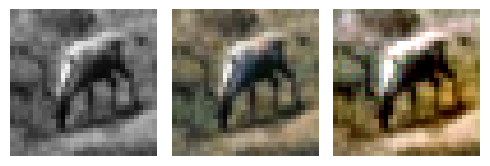

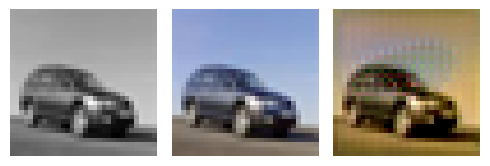

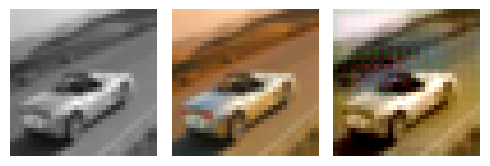

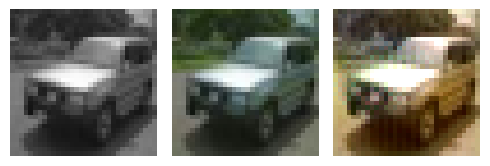

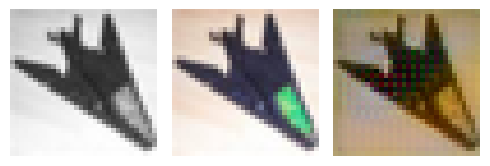

EPOCH: 35.760  trn_loss: 0.004  (2659.83s - 4778.13s remaining)

EPOCH: 35.765  trn_loss: 0.004  (2660.16s - 4777.65s remaining)

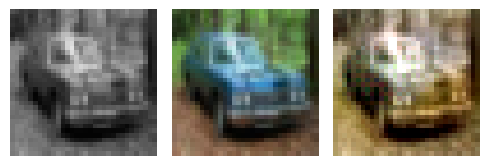

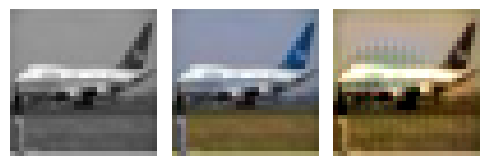

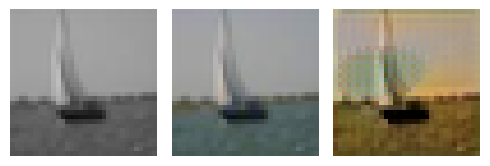

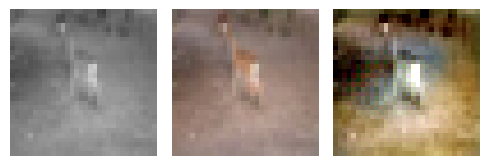

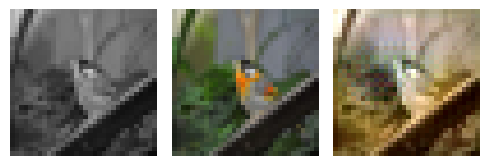

EPOCH: 36.000  val_loss: 0.003  (2684.21s - 4771.92s remaining)

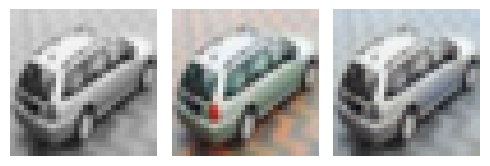

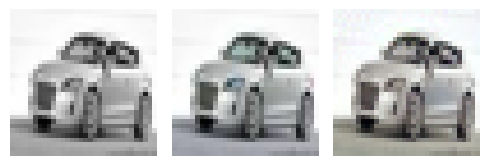

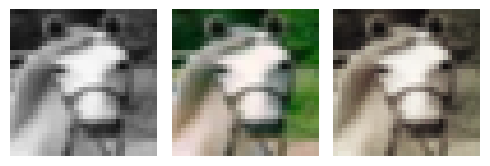

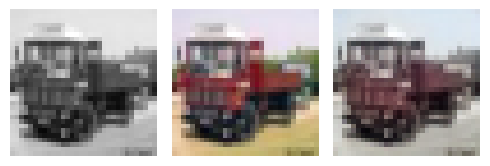

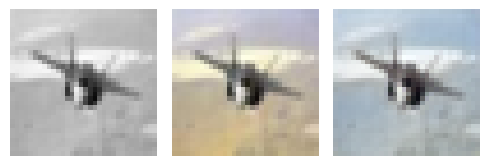

EPOCH: 36.250  trn_loss: 0.004  (2701.57s - 4751.03s remaining)

EPOCH: 36.255  trn_loss: 0.004  (2701.89s - 4750.55s remaining)

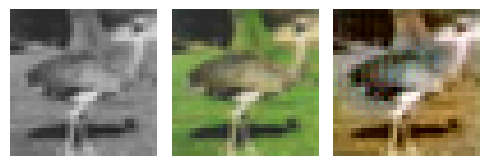

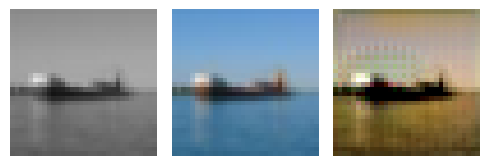

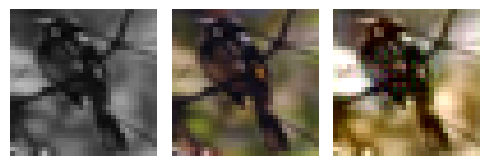

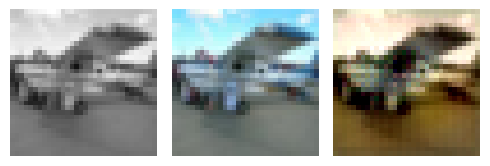

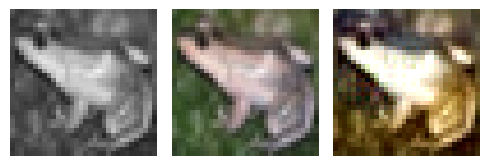

EPOCH: 36.505  trn_loss: 0.004  (2719.45s - 4730.05s remaining)

EPOCH: 36.510  trn_loss: 0.004  (2719.77s - 4729.57s remaining)

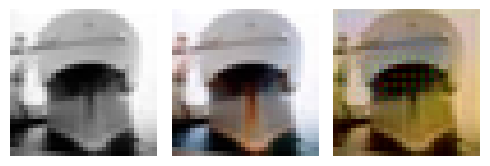

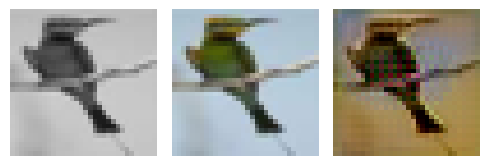

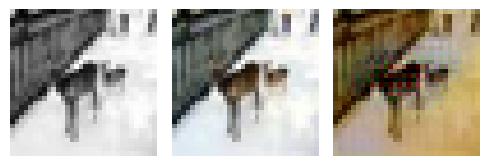

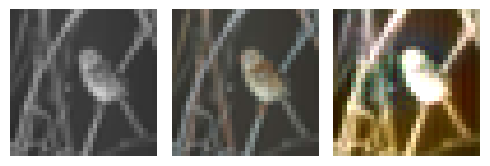

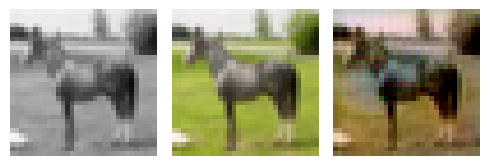

EPOCH: 36.760  trn_loss: 0.005  (2737.13s - 4708.78s remaining)

EPOCH: 36.765  trn_loss: 0.005  (2737.51s - 4708.40s remaining)

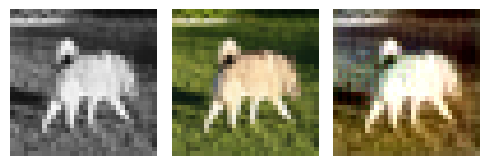

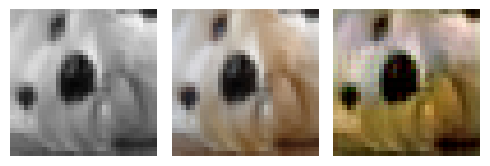

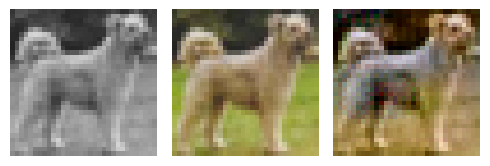

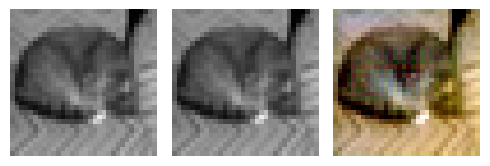

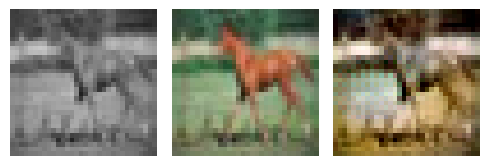

EPOCH: 36.950  val_loss: 0.005  (2761.55s - 4712.20s remaining)

EPOCH: 37.000  val_loss: 0.003  (2761.77s - 4702.48s remaining)

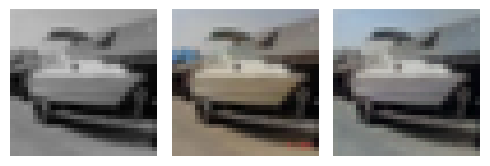

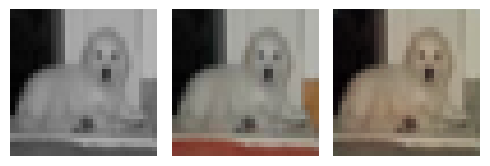

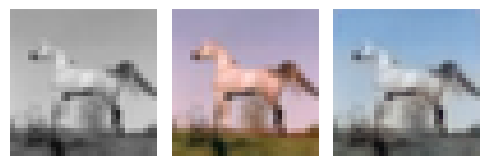

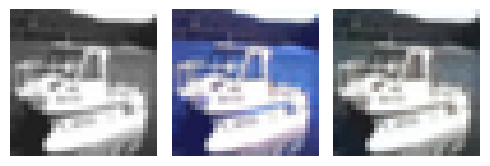

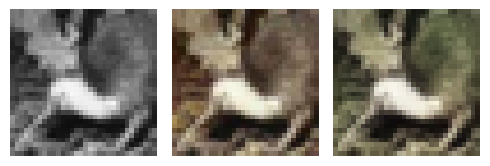

EPOCH: 37.250  trn_loss: 0.005  (2779.03s - 4681.46s remaining)

EPOCH: 37.255  trn_loss: 0.004  (2779.36s - 4680.98s remaining)

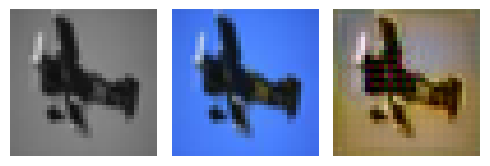

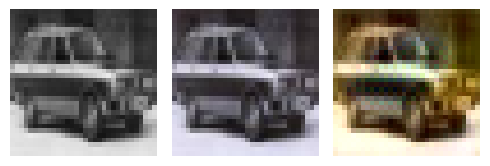

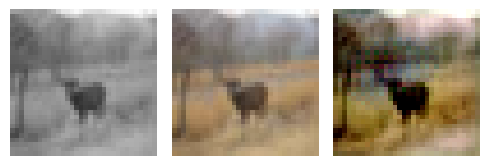

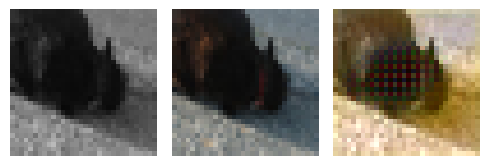

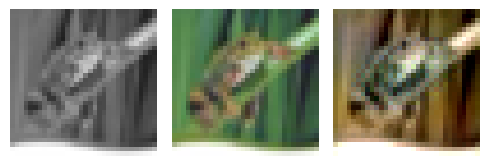

EPOCH: 37.505  trn_loss: 0.005  (2797.09s - 4660.80s remaining)

EPOCH: 37.510  trn_loss: 0.005  (2797.44s - 4660.37s remaining)

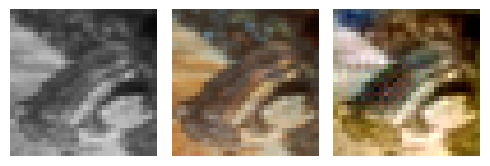

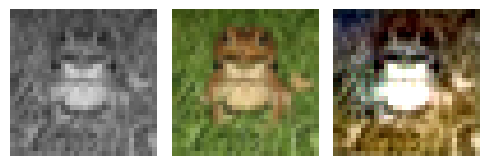

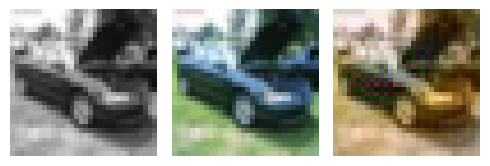

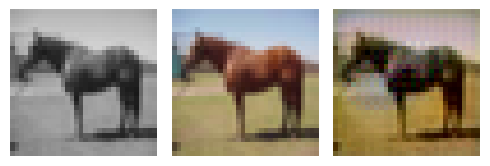

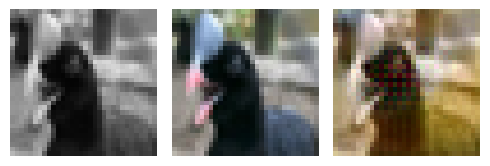

EPOCH: 37.760  trn_loss: 0.004  (2815.06s - 4640.03s remaining)

EPOCH: 37.765  trn_loss: 0.004  (2815.39s - 4639.57s remaining)

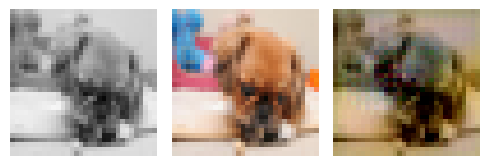

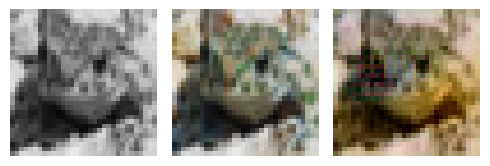

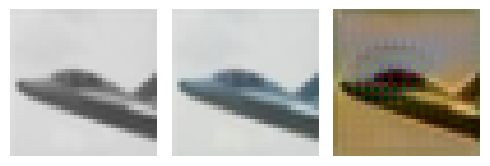

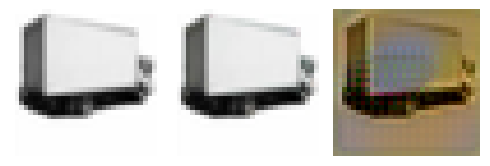

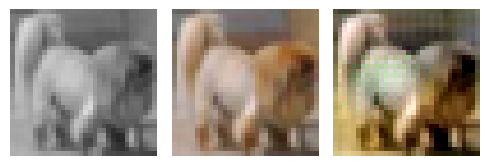

EPOCH: 38.000  val_loss: 0.003  (2838.63s - 4631.45s remaining)

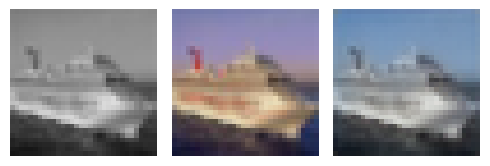

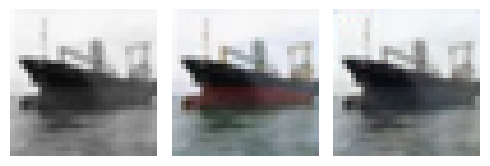

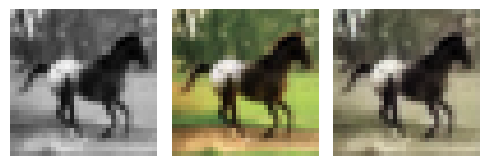

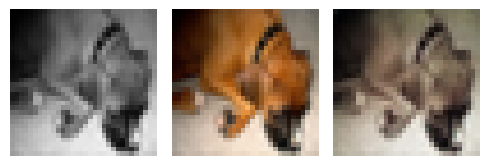

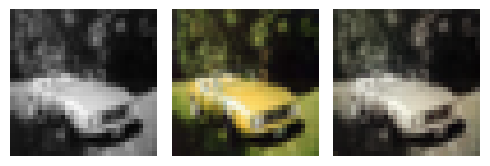

EPOCH: 38.250  trn_loss: 0.005  (2856.21s - 4611.01s remaining)

EPOCH: 38.255  trn_loss: 0.005  (2856.58s - 4610.61s remaining)

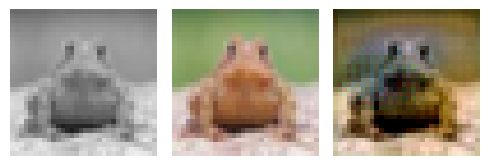

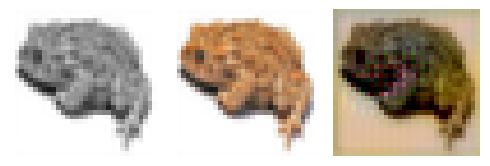

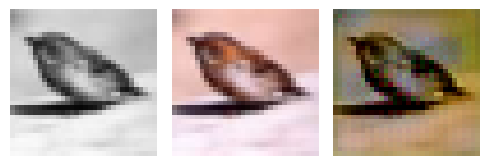

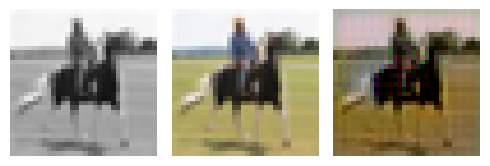

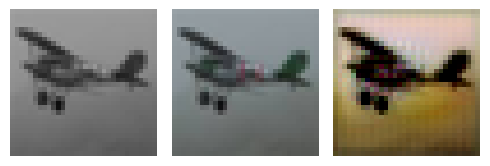

EPOCH: 38.505  trn_loss: 0.004  (2874.34s - 4590.49s remaining)

EPOCH: 38.510  trn_loss: 0.004  (2874.67s - 4590.03s remaining)

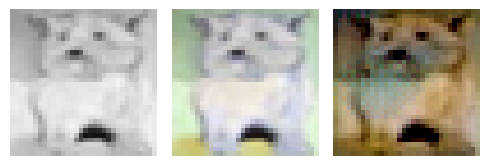

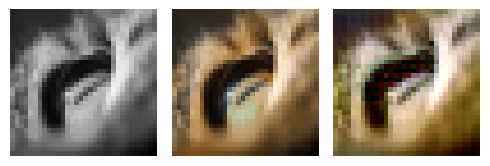

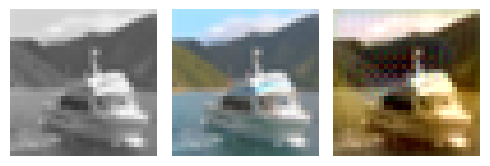

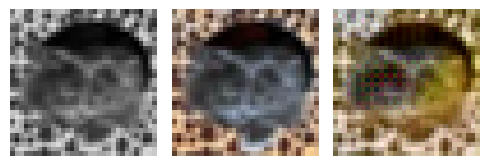

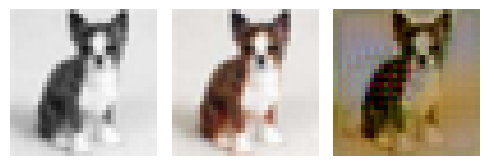

EPOCH: 38.760  trn_loss: 0.005  (2892.20s - 4569.58s remaining)

EPOCH: 38.765  trn_loss: 0.004  (2892.54s - 4569.13s remaining)

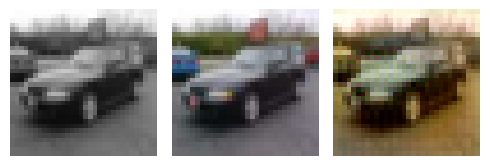

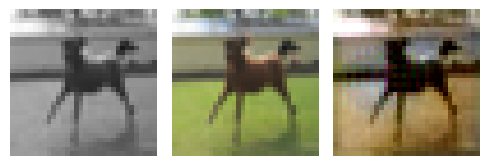

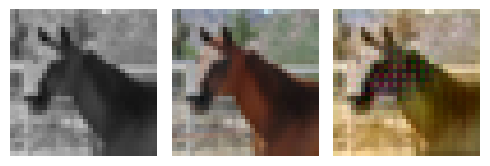

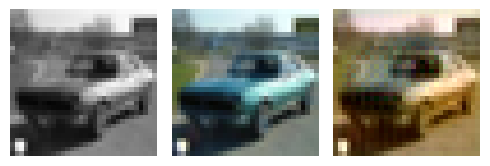

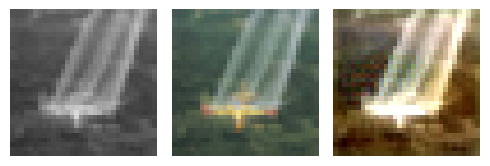

EPOCH: 39.000  val_loss: 0.003  (2916.74s - 4562.09s remaining)

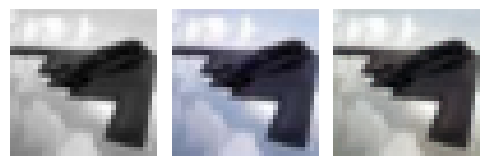

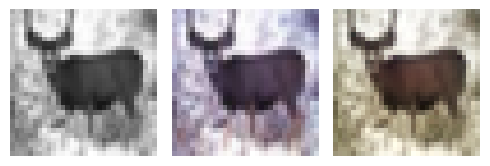

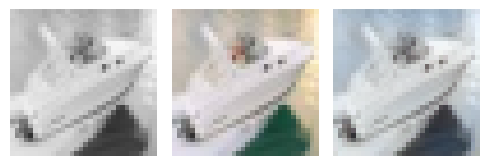

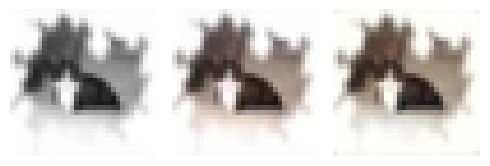

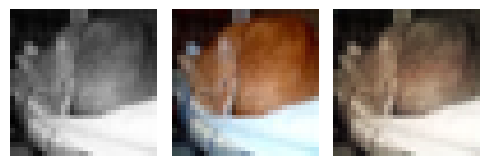

EPOCH: 39.250  trn_loss: 0.005  (2933.97s - 4541.11s remaining)

EPOCH: 39.255  trn_loss: 0.004  (2934.31s - 4540.67s remaining)

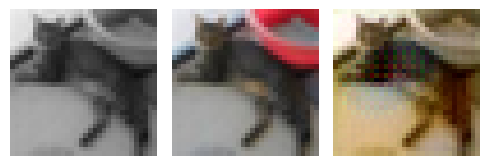

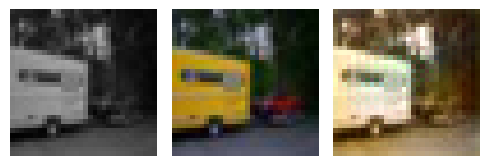

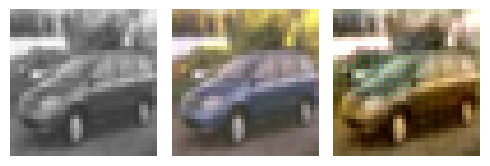

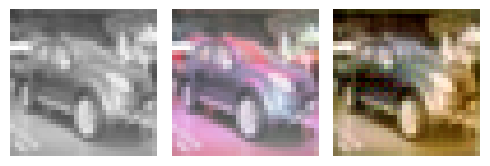

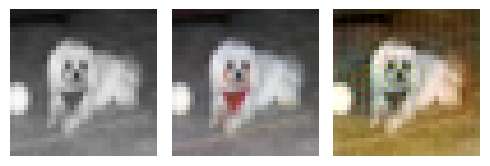

EPOCH: 39.505  trn_loss: 0.005  (2951.81s - 4520.16s remaining)

EPOCH: 39.510  trn_loss: 0.005  (2952.14s - 4519.70s remaining)

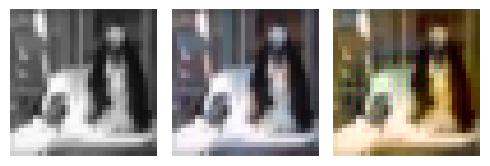

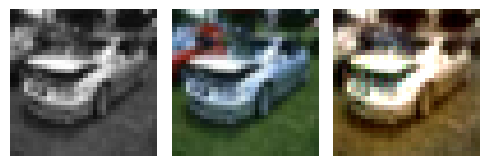

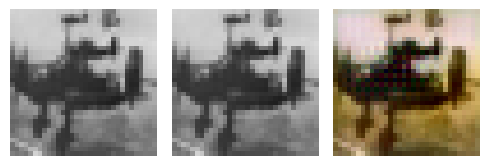

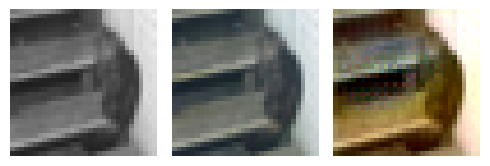

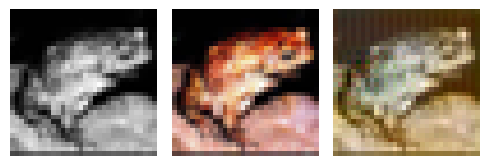

EPOCH: 39.760  trn_loss: 0.004  (2969.65s - 4499.25s remaining)

EPOCH: 39.765  trn_loss: 0.004  (2970.01s - 4498.84s remaining)

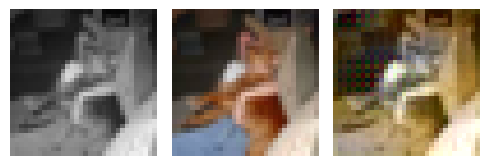

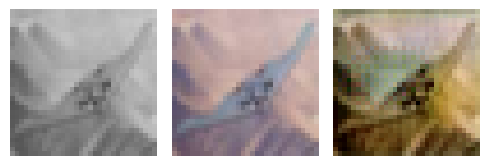

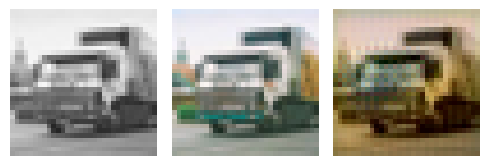

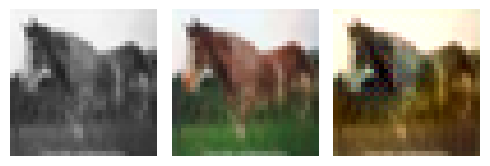

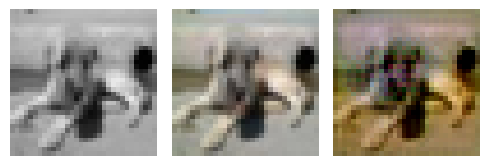

EPOCH: 40.000  trn_loss: 0.005  val_loss: 0.005  (2993.51s - 4490.27s remaining)


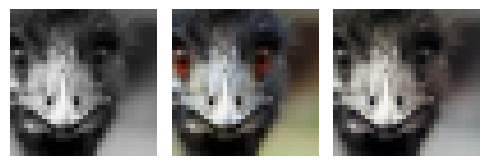

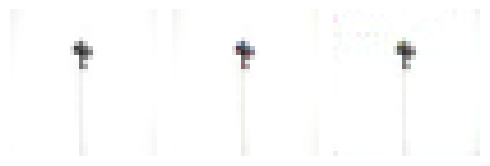

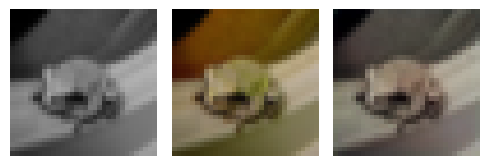

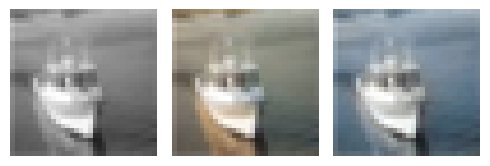

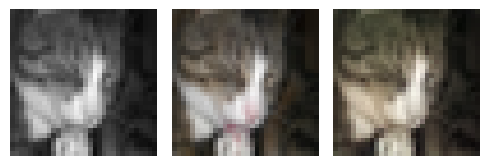

EPOCH: 40.250  trn_loss: 0.005  (3010.80s - 4469.45s remaining)

EPOCH: 40.255  trn_loss: 0.005  (3011.13s - 4468.99s remaining)

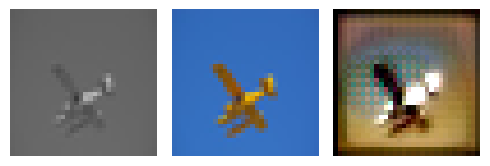

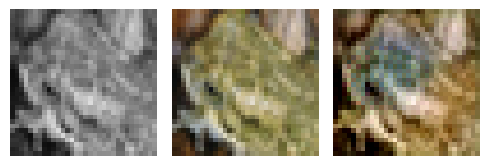

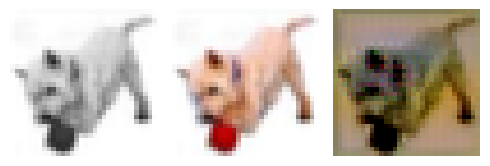

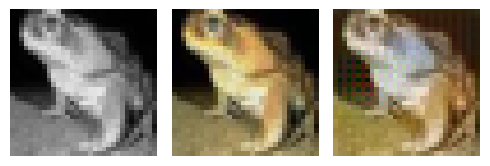

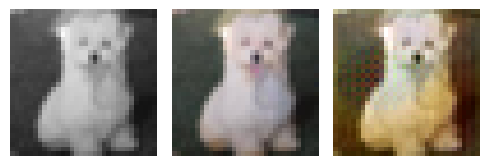

EPOCH: 40.505  trn_loss: 0.005  (3028.86s - 4448.86s remaining)

EPOCH: 40.510  trn_loss: 0.004  (3029.22s - 4448.46s remaining)

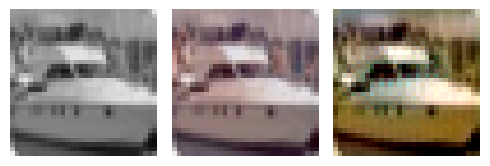

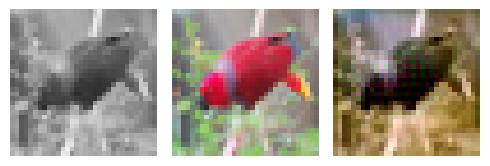

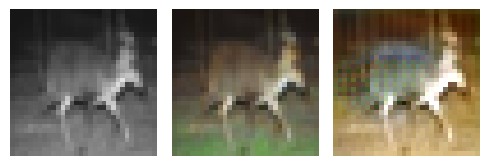

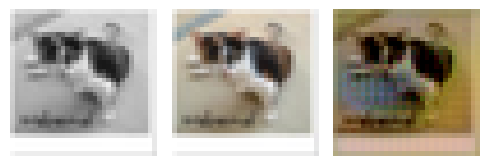

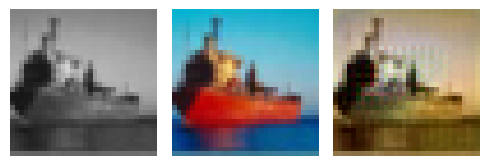

EPOCH: 40.760  trn_loss: 0.005  (3047.02s - 4428.45s remaining)

EPOCH: 40.765  trn_loss: 0.004  (3047.34s - 4427.99s remaining)

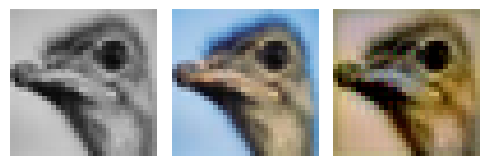

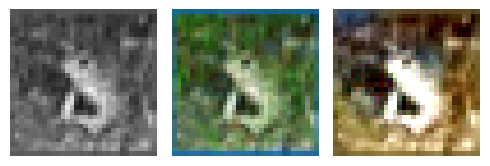

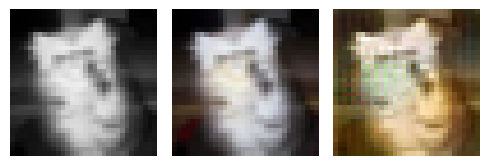

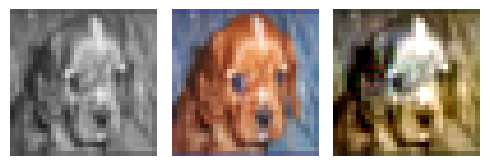

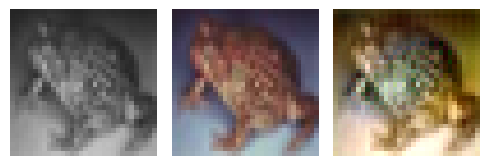

EPOCH: 41.000  val_loss: 0.003  (3071.02s - 4419.27s remaining)

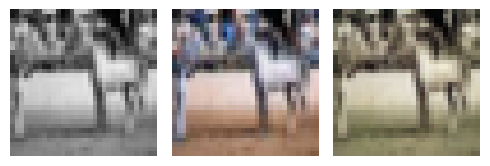

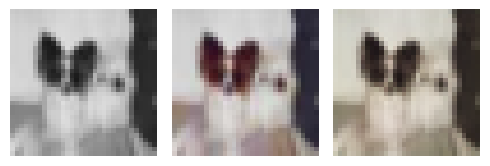

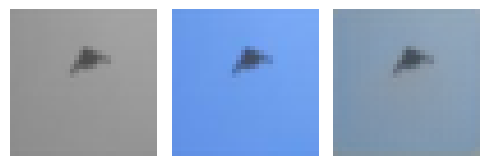

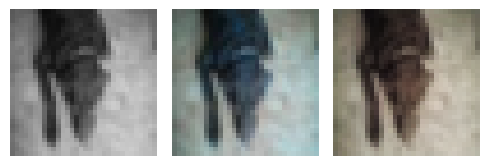

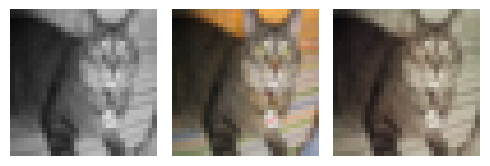

EPOCH: 41.250  trn_loss: 0.004  (3088.58s - 4398.89s remaining)

EPOCH: 41.255  trn_loss: 0.005  (3088.93s - 4398.45s remaining)

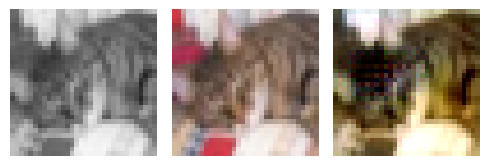

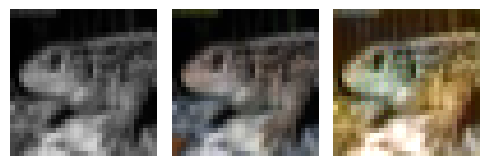

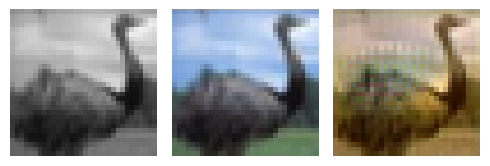

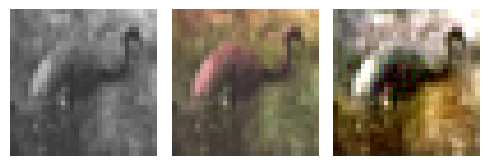

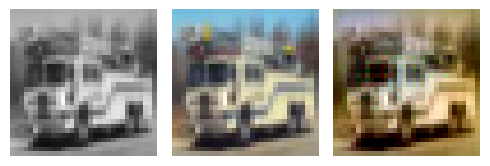

EPOCH: 41.505  trn_loss: 0.004  (3106.40s - 4377.98s remaining)

EPOCH: 41.510  trn_loss: 0.005  (3106.73s - 4377.52s remaining)

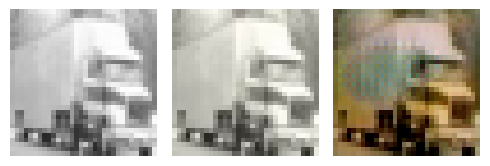

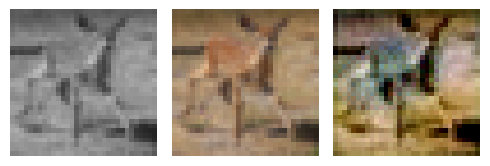

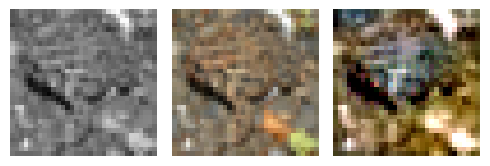

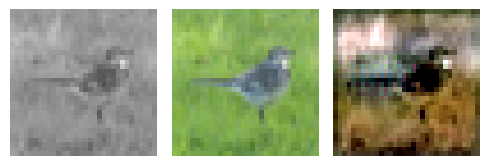

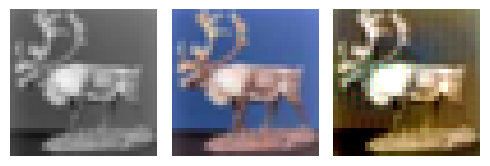

EPOCH: 41.760  trn_loss: 0.005  (3124.50s - 4357.51s remaining)

EPOCH: 41.765  trn_loss: 0.005  (3124.84s - 4357.06s remaining)

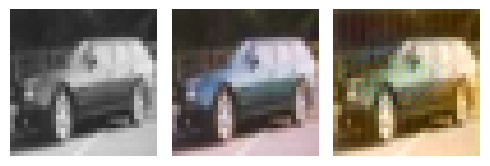

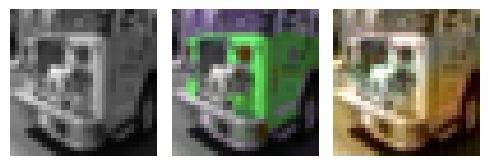

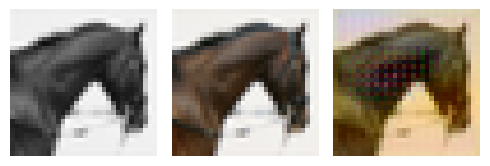

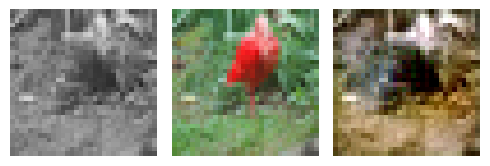

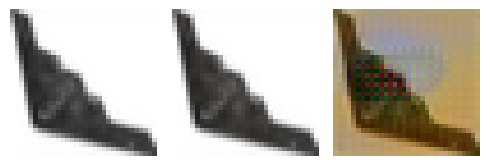

EPOCH: 42.000  val_loss: 0.003  (3149.29s - 4349.02s remaining)

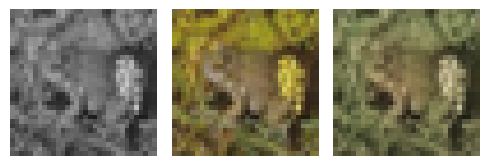

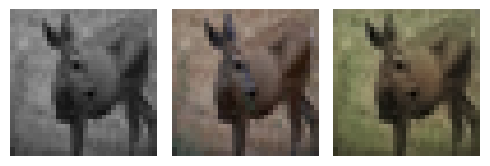

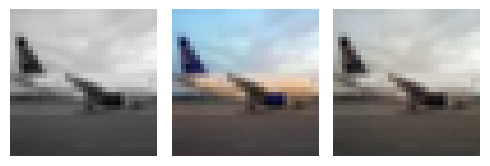

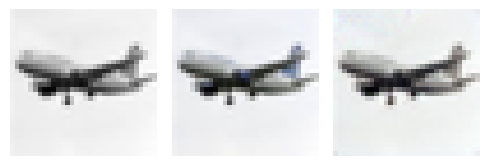

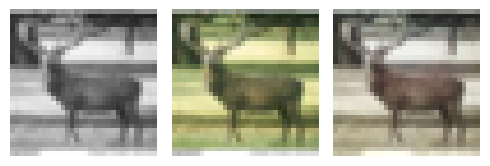

EPOCH: 42.250  trn_loss: 0.004  (3166.70s - 4328.45s remaining)

EPOCH: 42.255  trn_loss: 0.005  (3167.04s - 4328.01s remaining)

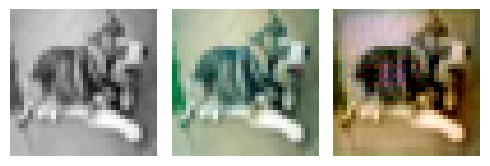

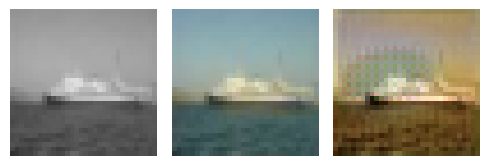

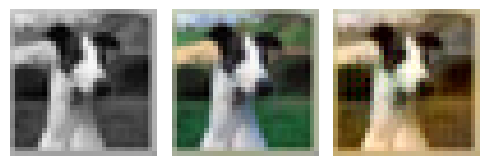

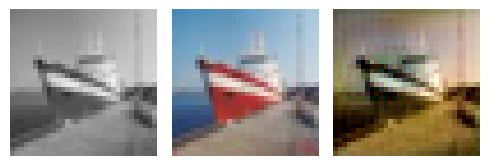

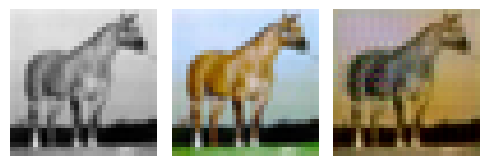

EPOCH: 42.505  trn_loss: 0.004  (3184.57s - 4307.64s remaining)

EPOCH: 42.510  trn_loss: 0.005  (3184.90s - 4307.19s remaining)

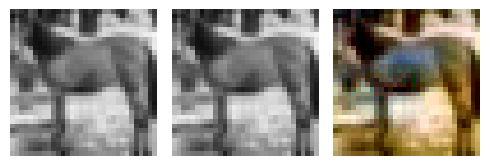

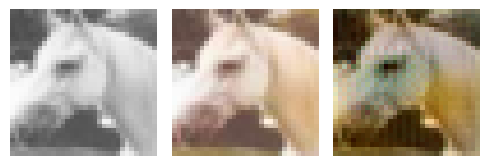

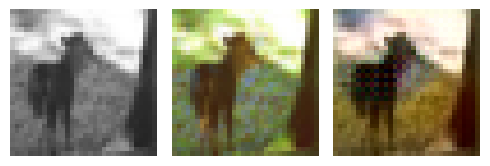

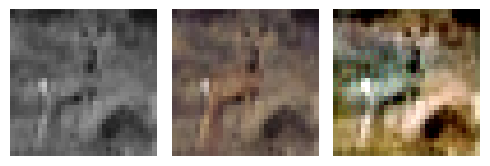

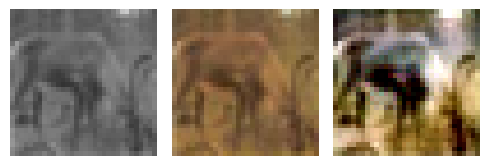

EPOCH: 42.760  trn_loss: 0.004  (3203.14s - 4287.80s remaining)

EPOCH: 42.765  trn_loss: 0.006  (3203.55s - 4287.45s remaining)

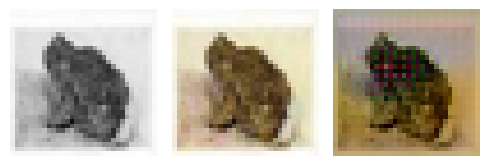

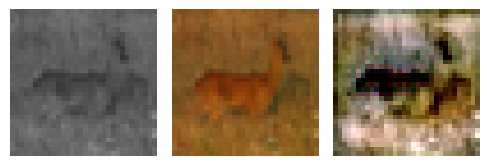

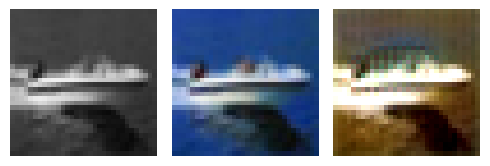

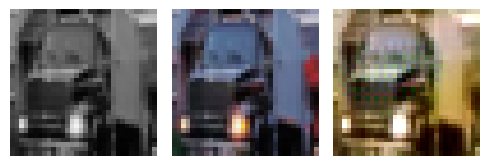

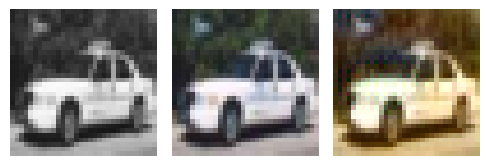

EPOCH: 42.950  val_loss: 0.005  (3226.98s - 4286.36s remaining)

EPOCH: 43.000  val_loss: 0.003  (3227.19s - 4277.90s remaining)

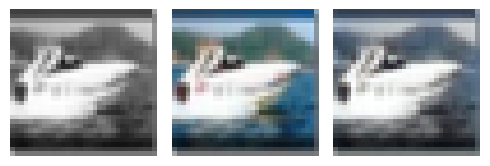

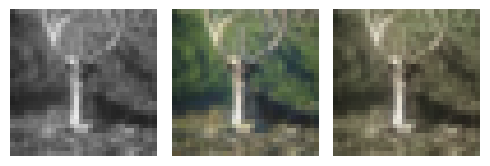

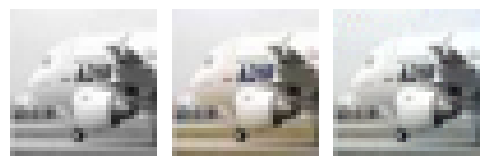

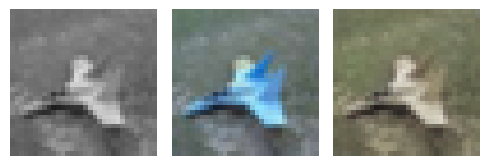

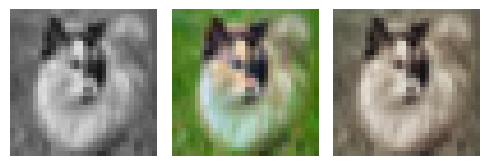

EPOCH: 43.250  trn_loss: 0.004  (3244.87s - 4257.72s remaining)

EPOCH: 43.255  trn_loss: 0.004  (3245.23s - 4257.31s remaining)

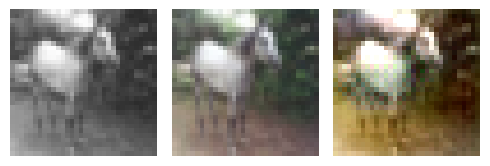

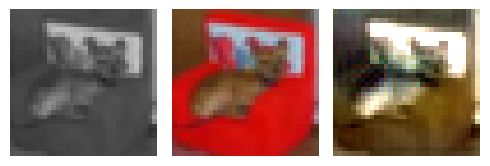

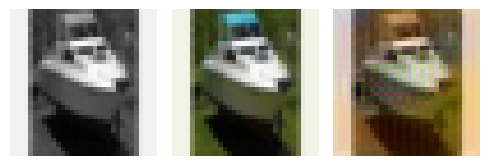

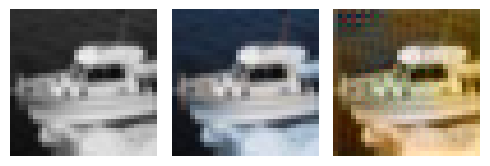

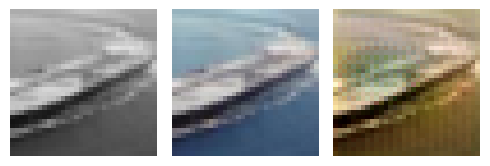

EPOCH: 43.505  trn_loss: 0.005  (3263.02s - 4237.30s remaining)

EPOCH: 43.510  trn_loss: 0.004  (3263.36s - 4236.86s remaining)

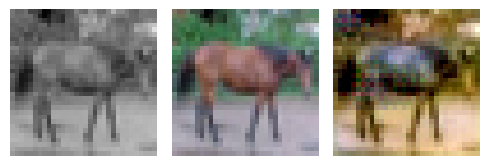

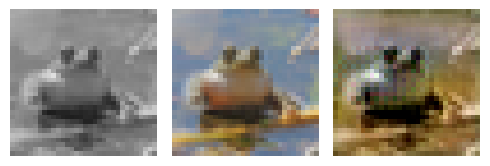

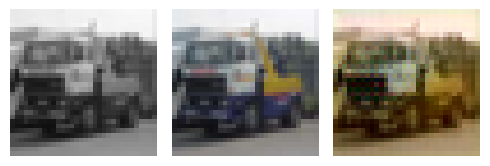

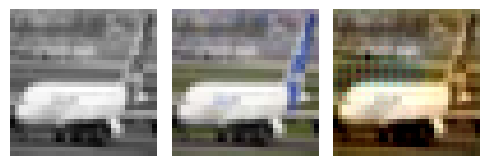

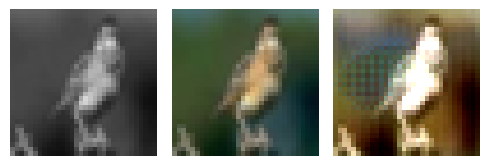

EPOCH: 43.760  trn_loss: 0.005  (3280.99s - 4216.67s remaining)

EPOCH: 43.765  trn_loss: 0.005  (3281.33s - 4216.23s remaining)

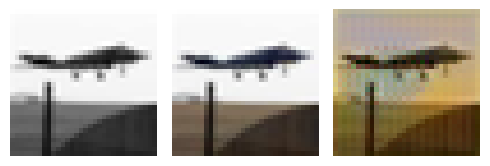

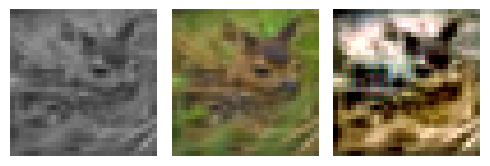

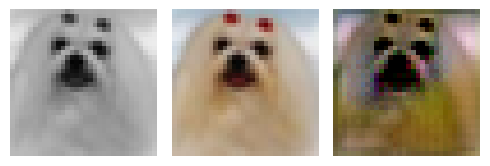

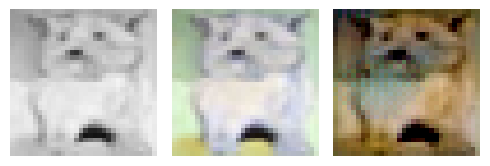

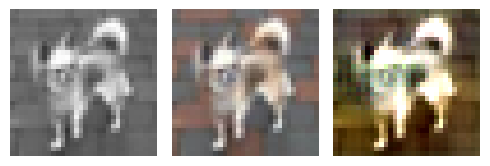

EPOCH: 43.950  val_loss: 0.005  (3305.22s - 4215.19s remaining)

EPOCH: 44.000  val_loss: 0.003  (3305.47s - 4206.96s remaining)

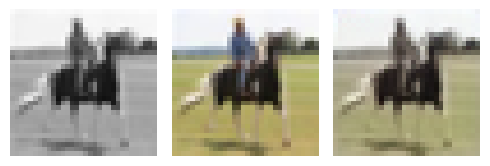

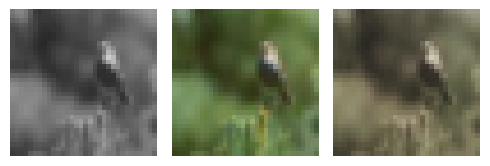

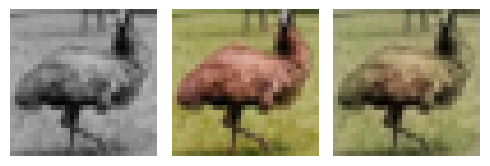

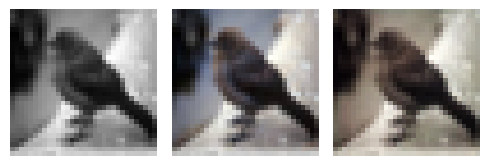

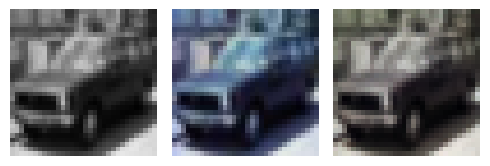

EPOCH: 44.250  trn_loss: 0.004  (3323.04s - 4186.65s remaining)

EPOCH: 44.255  trn_loss: 0.005  (3323.37s - 4186.20s remaining)

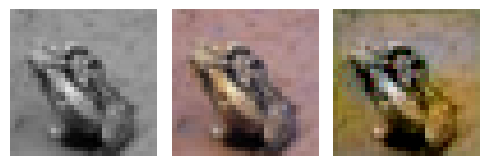

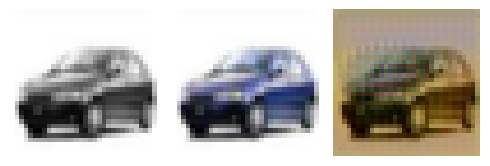

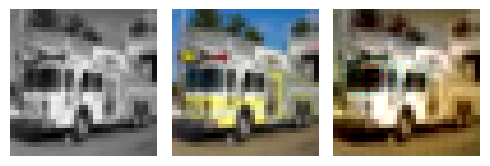

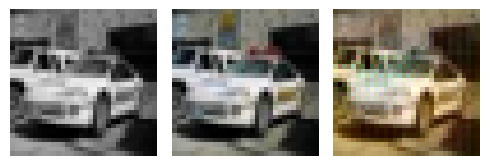

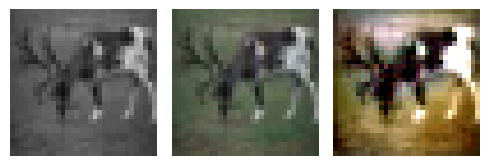

EPOCH: 44.505  trn_loss: 0.004  (3340.98s - 4165.98s remaining)

EPOCH: 44.510  trn_loss: 0.004  (3341.31s - 4165.53s remaining)

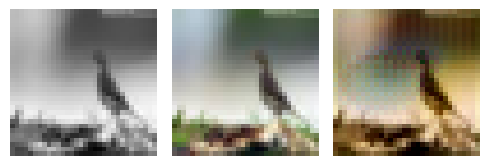

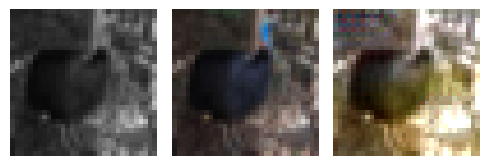

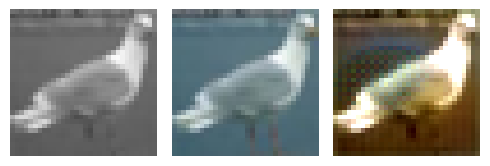

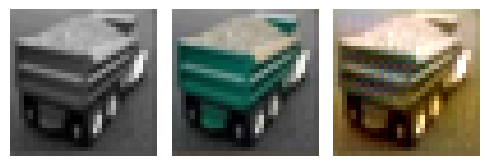

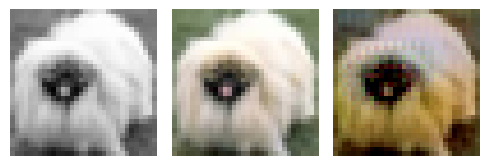

EPOCH: 44.760  trn_loss: 0.004  (3358.96s - 4145.38s remaining)

EPOCH: 44.765  trn_loss: 0.005  (3359.31s - 4144.96s remaining)

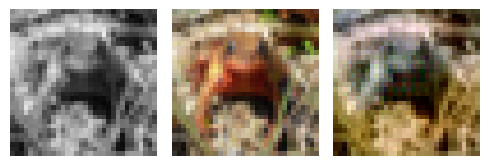

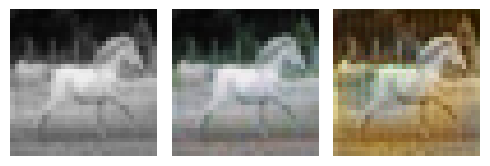

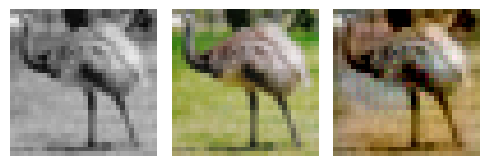

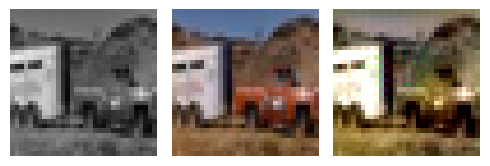

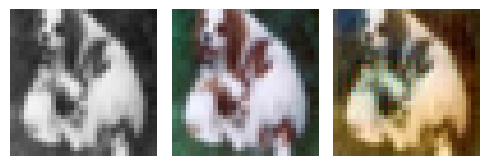

EPOCH: 45.000  trn_loss: 0.005  val_loss: 0.005  (3383.73s - 4135.66s remaining)


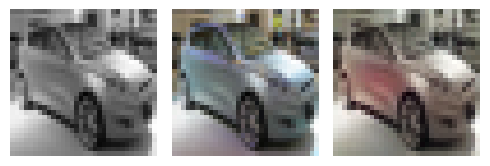

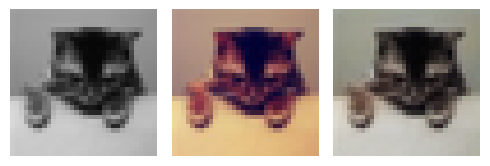

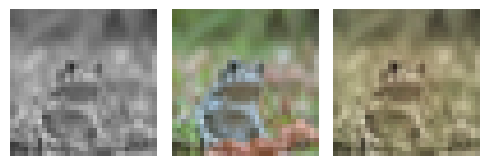

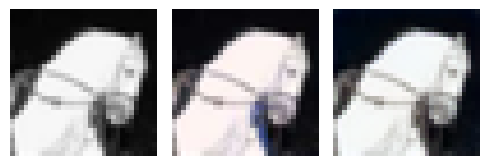

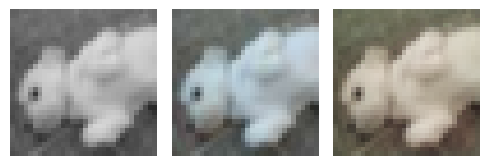

EPOCH: 45.250  trn_loss: 0.004  (3401.23s - 4115.30s remaining)

EPOCH: 45.255  trn_loss: 0.004  (3401.57s - 4114.86s remaining)

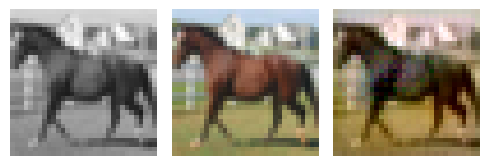

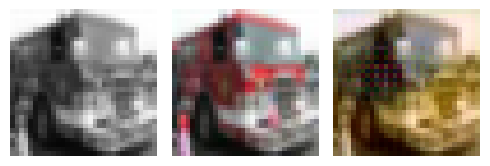

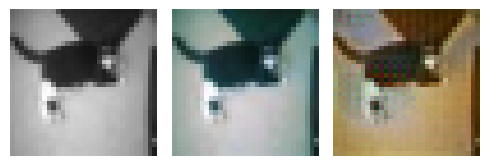

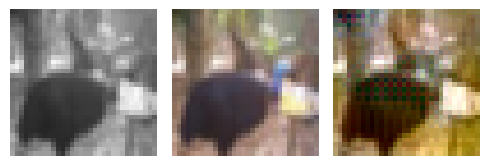

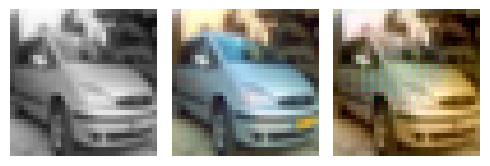

EPOCH: 45.505  trn_loss: 0.005  (3419.25s - 4094.74s remaining)

EPOCH: 45.510  trn_loss: 0.005  (3419.62s - 4094.35s remaining)

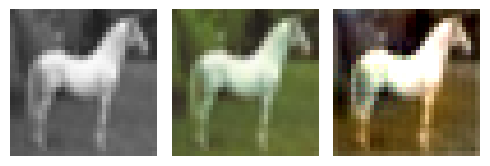

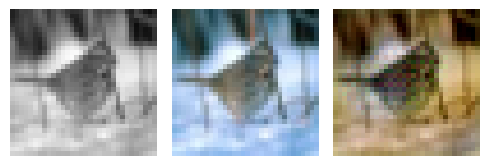

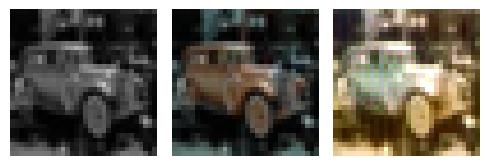

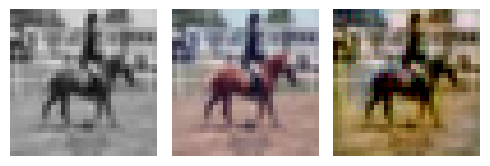

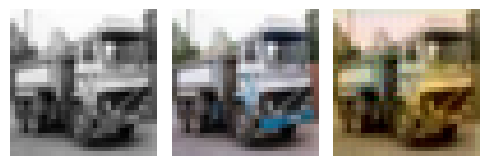

EPOCH: 45.760  trn_loss: 0.005  (3437.38s - 4074.35s remaining)

EPOCH: 45.765  trn_loss: 0.005  (3437.73s - 4073.92s remaining)

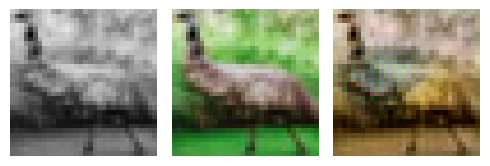

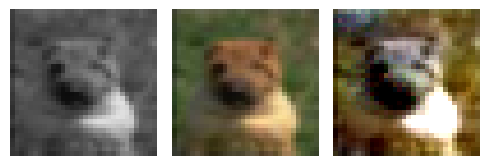

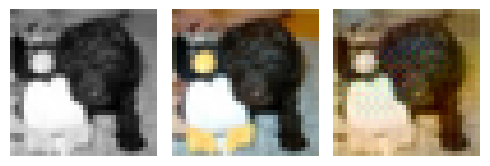

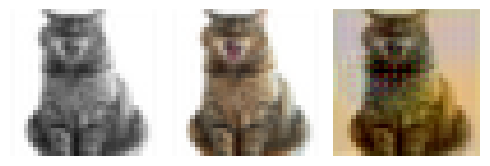

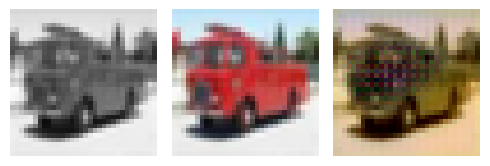

EPOCH: 46.000  val_loss: 0.003  (3461.60s - 4063.62s remaining)

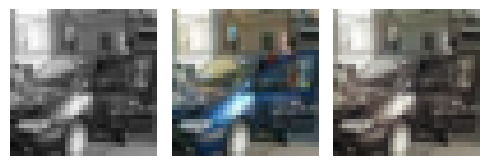

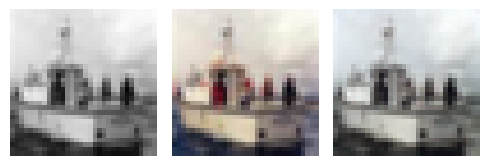

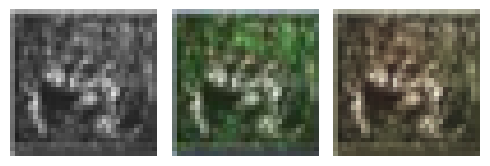

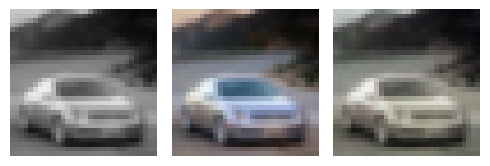

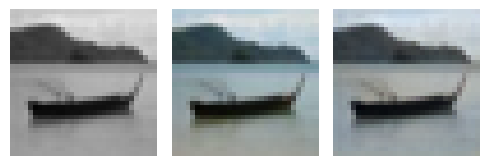

EPOCH: 46.250  trn_loss: 0.005  (3479.59s - 4043.85s remaining)

EPOCH: 46.255  trn_loss: 0.005  (3479.94s - 4043.43s remaining)

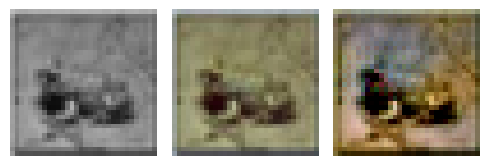

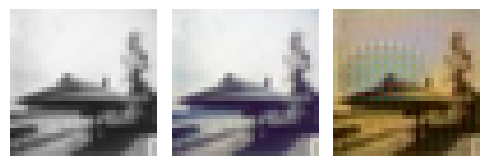

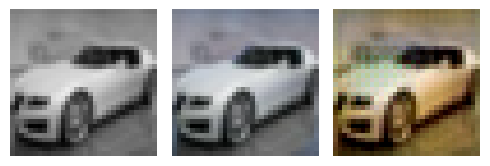

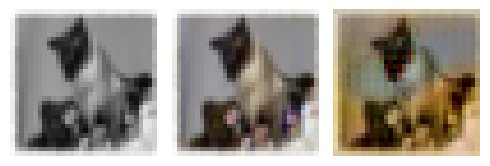

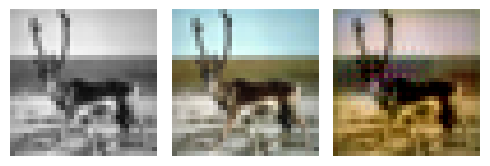

EPOCH: 46.505  trn_loss: 0.005  (3497.73s - 4023.44s remaining)

EPOCH: 46.510  trn_loss: 0.005  (3498.06s - 4023.00s remaining)

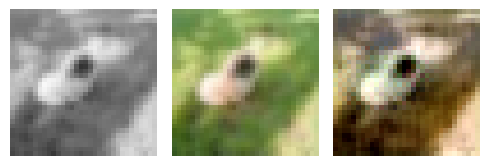

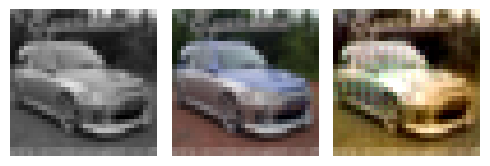

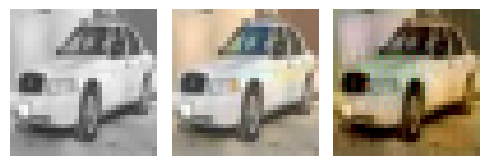

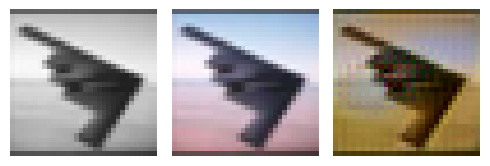

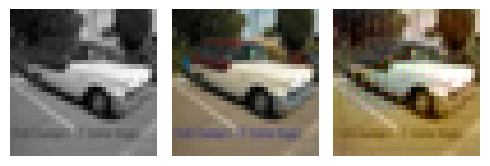

EPOCH: 46.760  trn_loss: 0.004  (3515.52s - 4002.67s remaining)

EPOCH: 46.765  trn_loss: 0.005  (3515.86s - 4002.23s remaining)

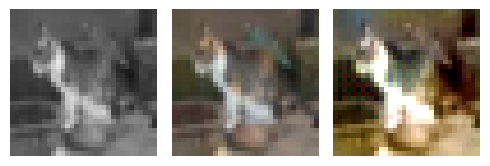

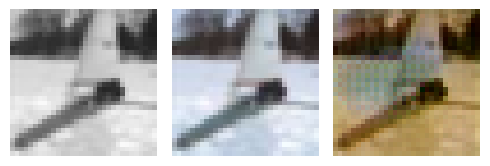

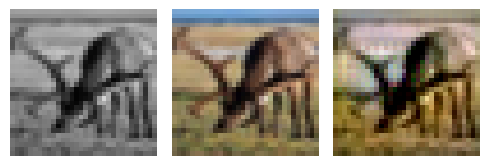

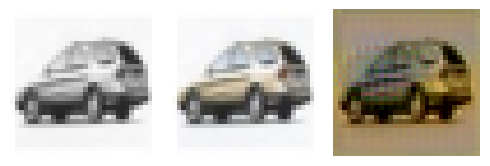

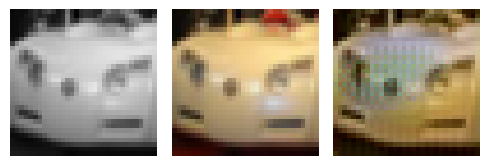

EPOCH: 46.950  val_loss: 0.005  (3540.79s - 4000.83s remaining)

EPOCH: 47.000  val_loss: 0.003  (3541.00s - 3993.05s remaining)

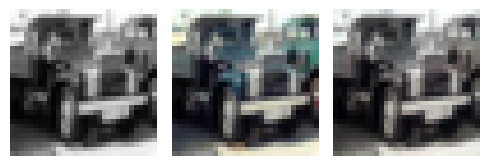

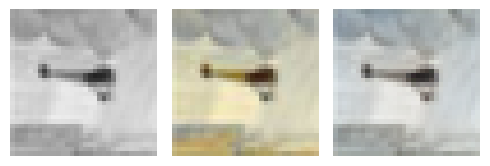

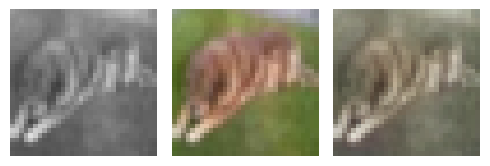

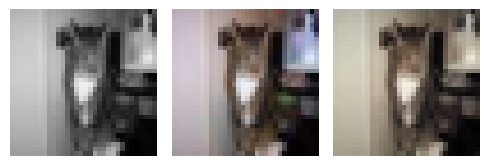

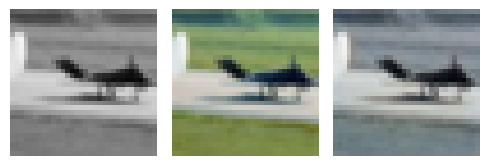

EPOCH: 47.250  trn_loss: 0.004  (3558.47s - 3972.69s remaining)

EPOCH: 47.255  trn_loss: 0.005  (3558.80s - 3972.24s remaining)

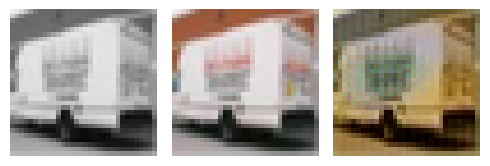

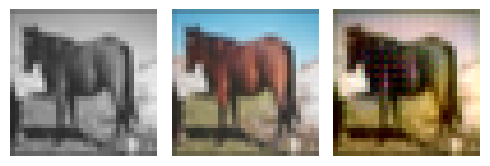

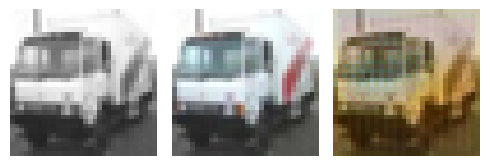

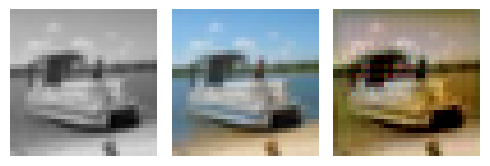

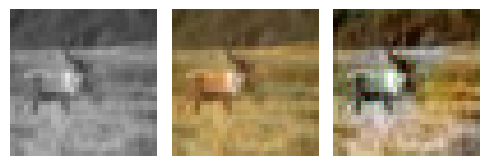

EPOCH: 47.505  trn_loss: 0.005  (3576.38s - 3952.03s remaining)

EPOCH: 47.510  trn_loss: 0.005  (3576.71s - 3951.59s remaining)

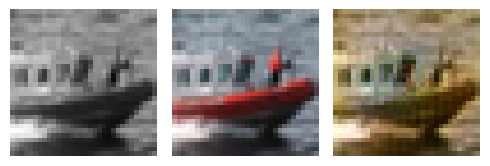

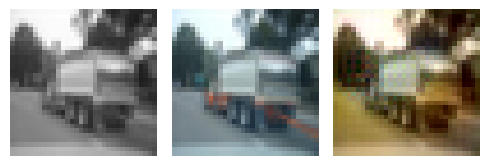

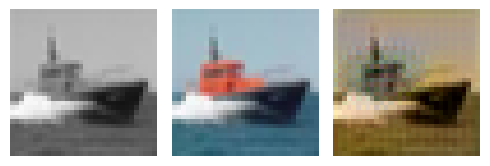

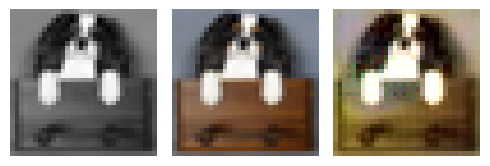

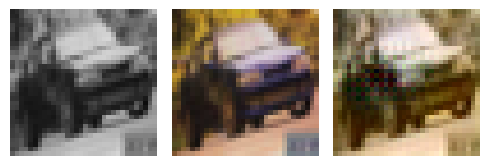

EPOCH: 47.760  trn_loss: 0.005  (3594.40s - 3931.53s remaining)

EPOCH: 47.765  trn_loss: 0.006  (3594.76s - 3931.13s remaining)

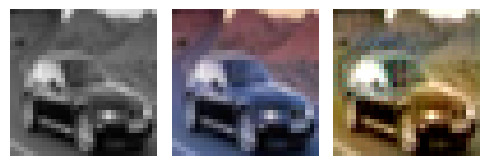

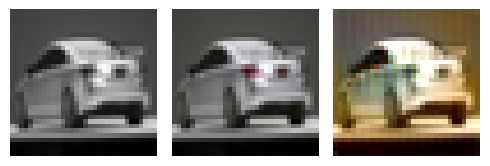

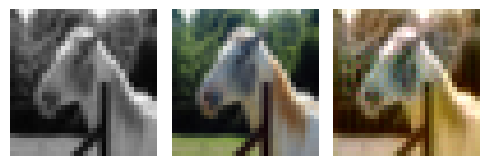

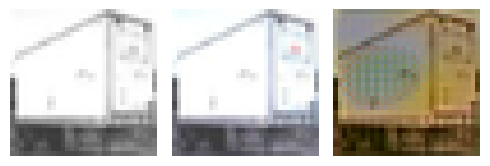

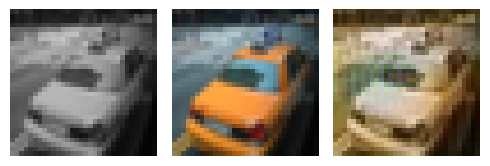

EPOCH: 47.950  val_loss: 0.005  (3619.12s - 3928.58s remaining)

EPOCH: 48.000  val_loss: 0.003  (3619.33s - 3920.94s remaining)

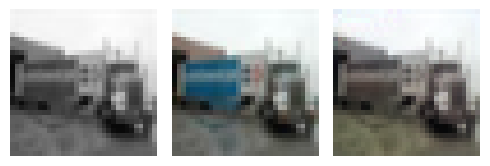

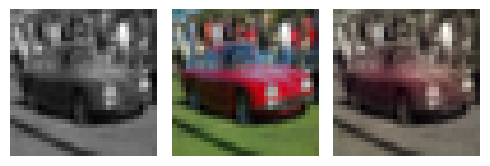

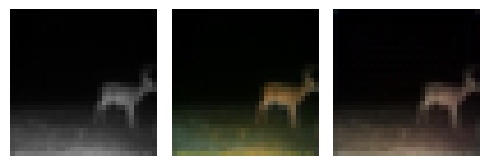

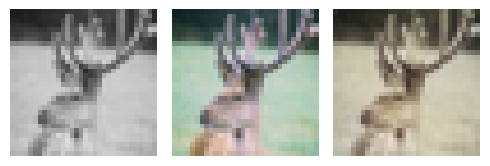

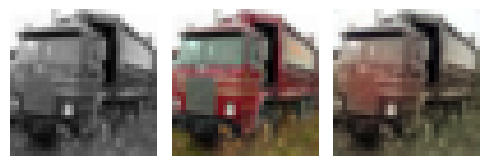

EPOCH: 48.250  trn_loss: 0.005  (3636.82s - 3900.63s remaining)

EPOCH: 48.255  trn_loss: 0.005  (3637.15s - 3900.19s remaining)

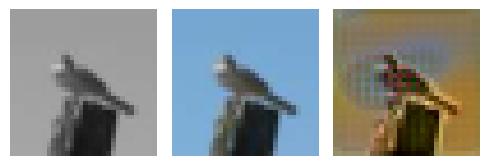

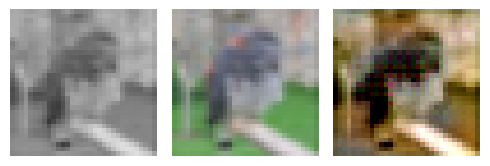

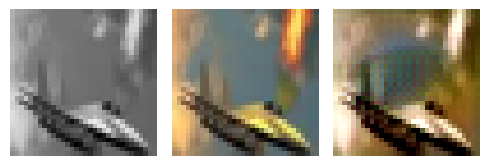

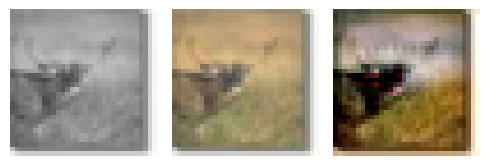

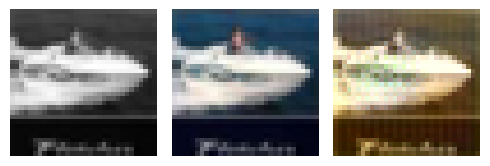

EPOCH: 48.505  trn_loss: 0.004  (3655.14s - 3880.44s remaining)

EPOCH: 48.510  trn_loss: 0.004  (3655.50s - 3880.03s remaining)

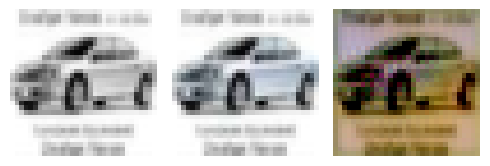

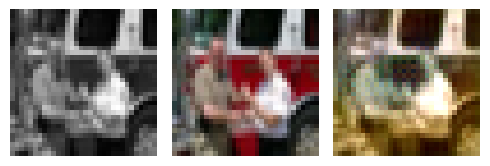

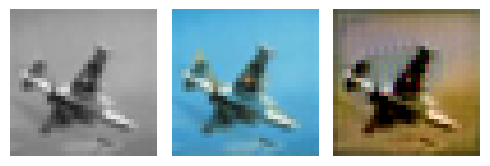

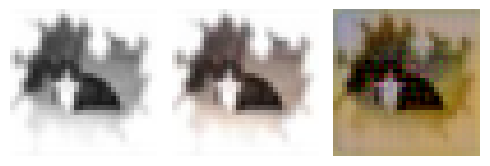

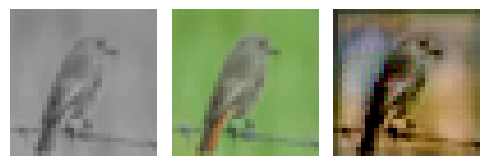

EPOCH: 48.760  trn_loss: 0.004  (3673.48s - 3860.28s remaining)

EPOCH: 48.765  trn_loss: 0.005  (3673.81s - 3859.85s remaining)

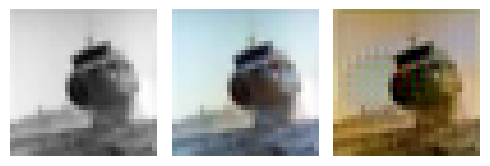

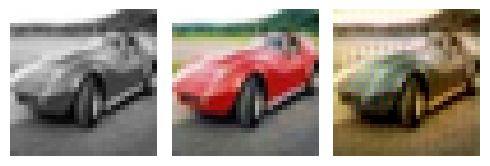

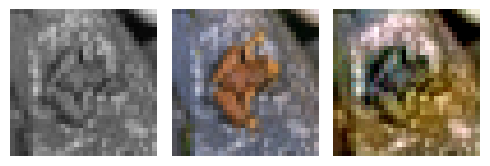

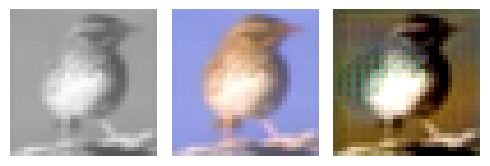

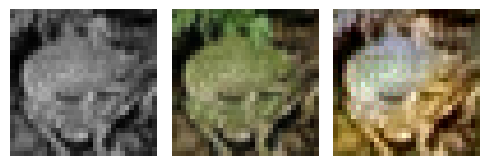

EPOCH: 49.000  val_loss: 0.003  (3697.51s - 3848.42s remaining)

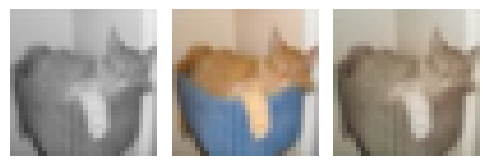

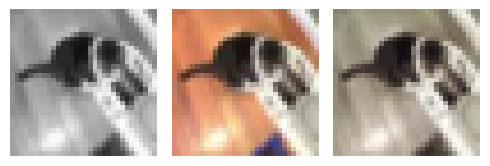

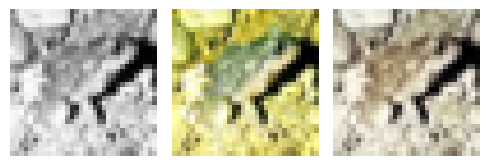

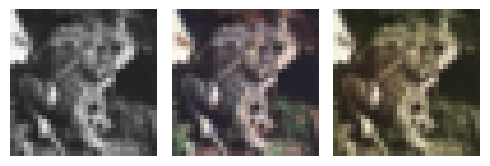

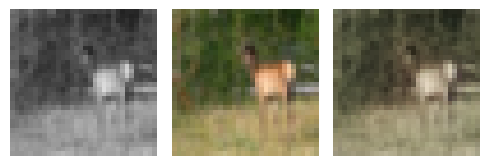

EPOCH: 49.250  trn_loss: 0.004  (3715.61s - 3828.78s remaining)

EPOCH: 49.255  trn_loss: 0.005  (3715.99s - 3828.38s remaining)

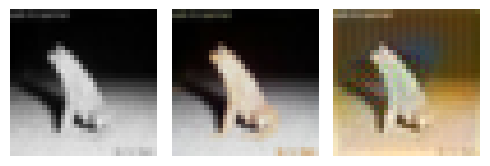

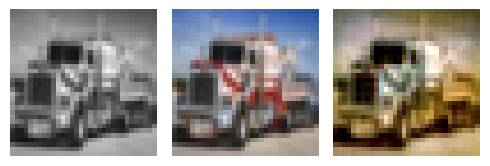

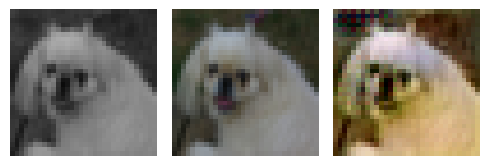

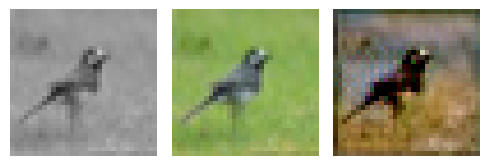

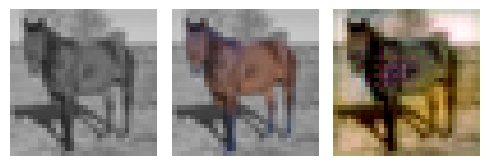

EPOCH: 49.505  trn_loss: 0.005  (3733.89s - 3808.55s remaining)

EPOCH: 49.510  trn_loss: 0.005  (3734.23s - 3808.11s remaining)

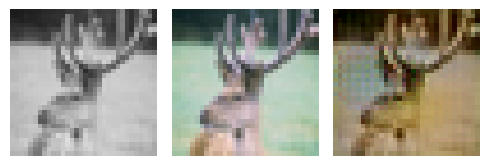

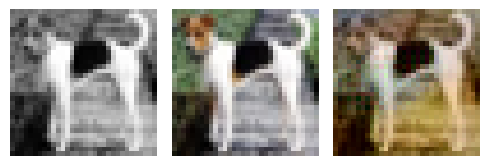

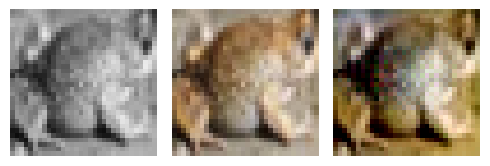

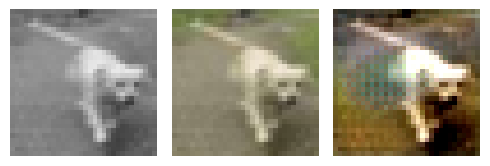

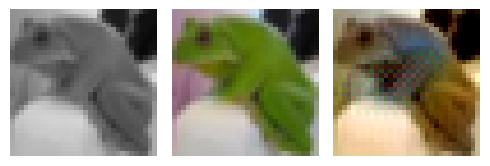

EPOCH: 49.760  trn_loss: 0.004  (3751.91s - 3788.07s remaining)

EPOCH: 49.765  trn_loss: 0.004  (3752.25s - 3787.64s remaining)

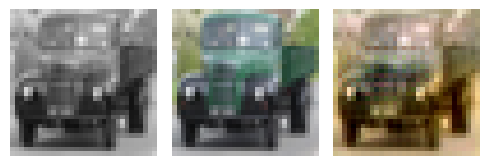

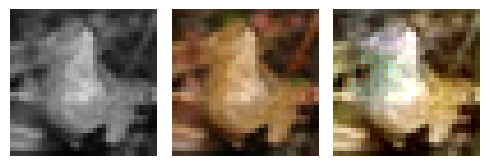

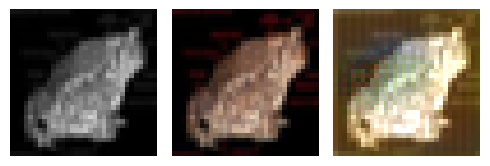

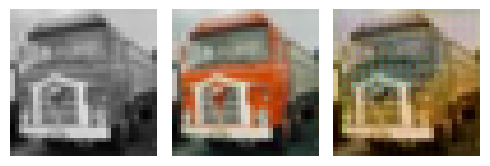

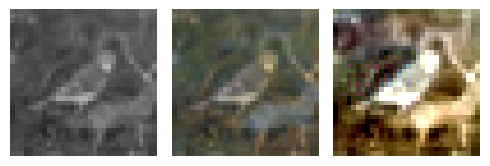

EPOCH: 50.000  trn_loss: 0.005  val_loss: 0.005  (3776.61s - 3776.61s remaining)


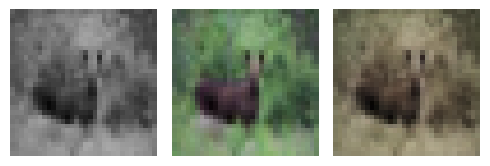

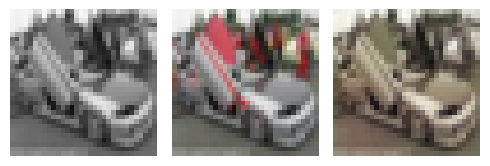

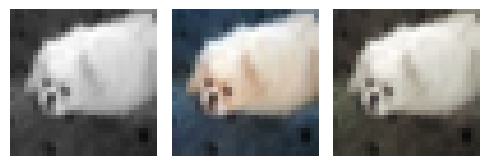

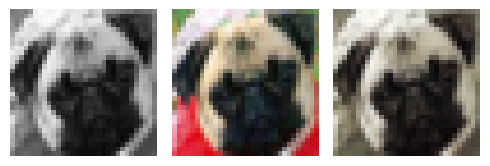

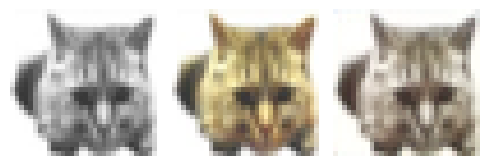

EPOCH: 50.250  trn_loss: 0.005  (3794.71s - 3756.95s remaining)

EPOCH: 50.255  trn_loss: 0.005  (3795.03s - 3756.50s remaining)

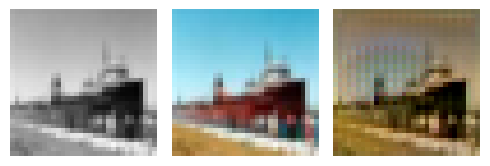

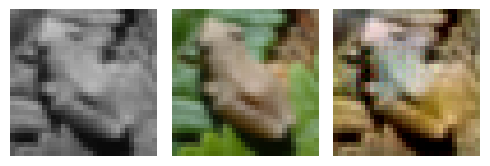

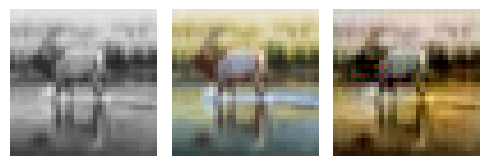

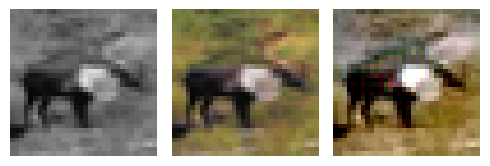

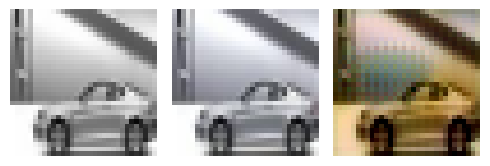

EPOCH: 50.505  trn_loss: 0.004  (3812.84s - 3736.57s remaining)

EPOCH: 50.510  trn_loss: 0.004  (3813.18s - 3736.15s remaining)

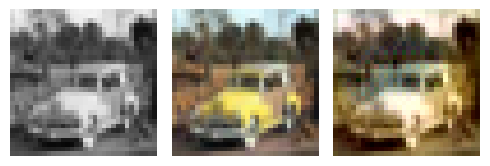

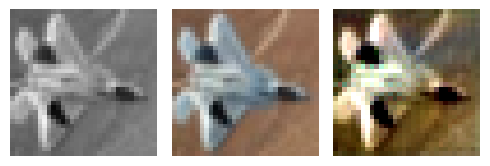

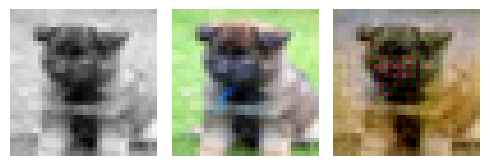

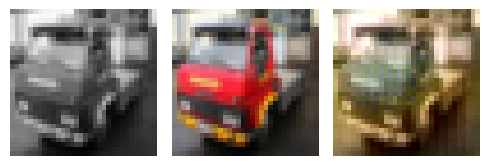

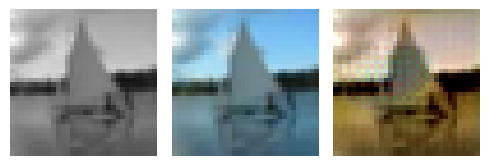

EPOCH: 50.760  trn_loss: 0.005  (3831.05s - 3716.29s remaining)

EPOCH: 50.765  trn_loss: 0.004  (3831.38s - 3715.86s remaining)

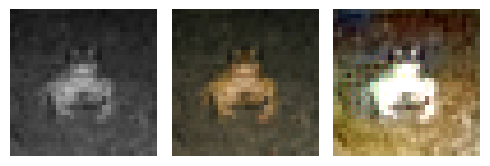

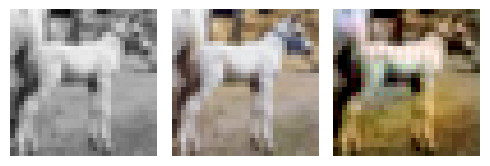

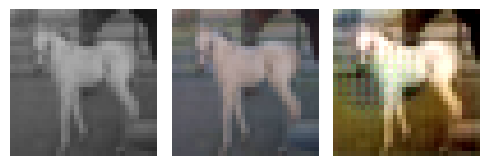

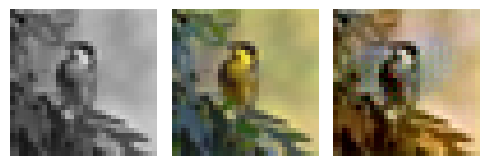

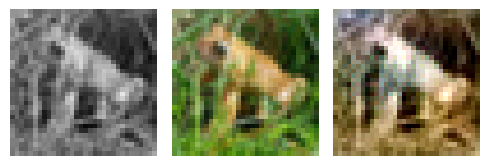

EPOCH: 50.950  val_loss: 0.005  (3855.88s - 3712.09s remaining)

EPOCH: 51.000  val_loss: 0.003  (3856.10s - 3704.88s remaining)

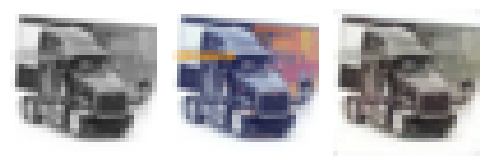

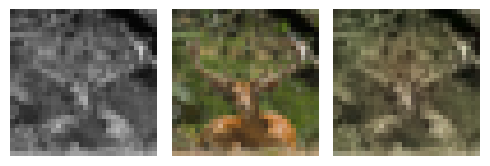

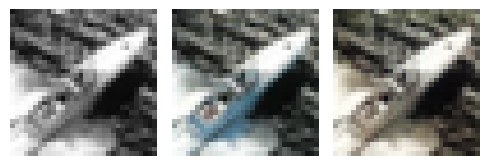

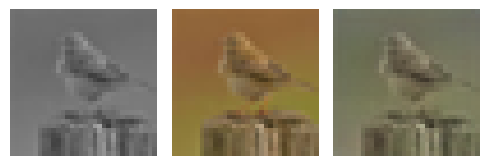

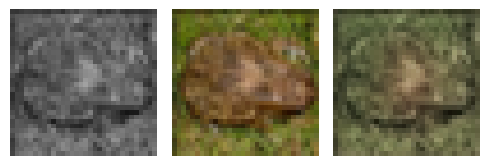

EPOCH: 51.250  trn_loss: 0.005  (3874.04s - 3685.06s remaining)

EPOCH: 51.255  trn_loss: 0.004  (3874.38s - 3684.63s remaining)

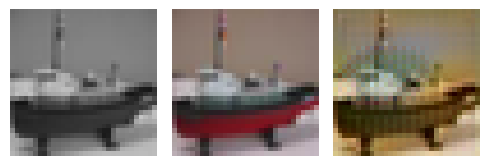

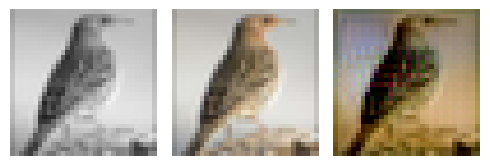

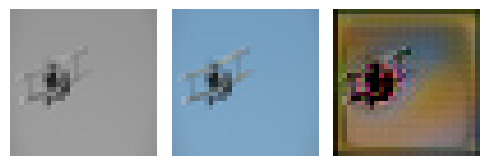

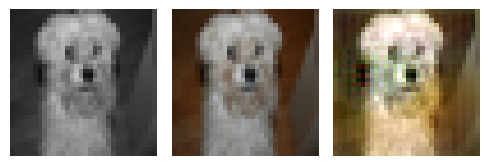

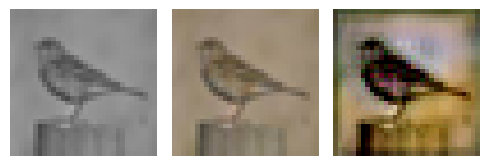

EPOCH: 51.505  trn_loss: 0.005  (3892.27s - 3664.78s remaining)

EPOCH: 51.510  trn_loss: 0.004  (3892.60s - 3664.35s remaining)

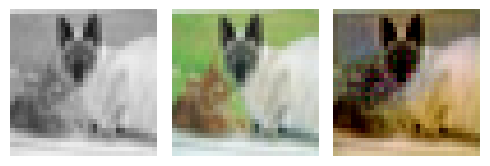

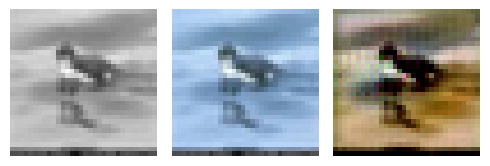

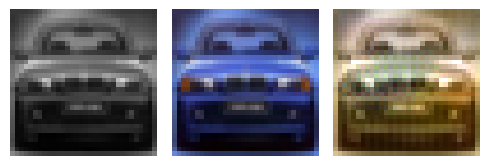

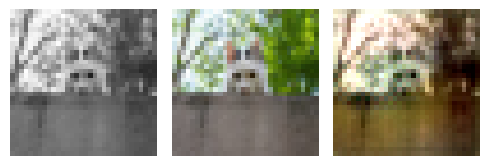

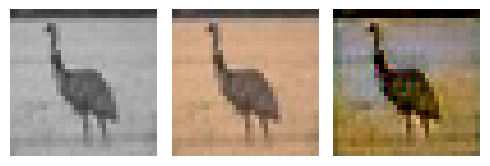

EPOCH: 51.760  trn_loss: 0.004  (3910.61s - 3644.63s remaining)

EPOCH: 51.765  trn_loss: 0.005  (3910.97s - 3644.23s remaining)

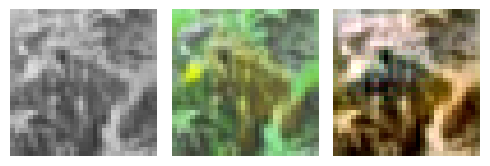

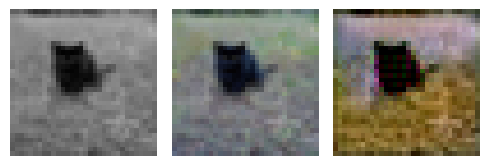

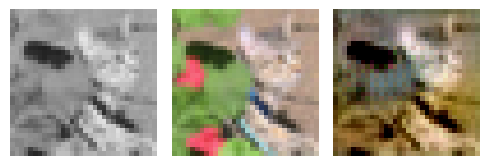

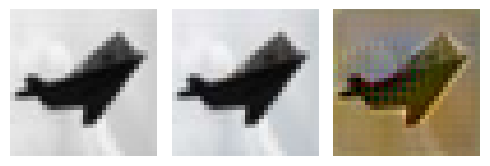

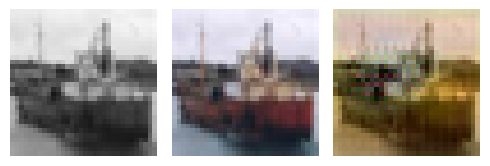

EPOCH: 52.000  val_loss: 0.003  (3935.47s - 3632.74s remaining)

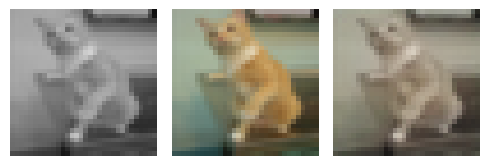

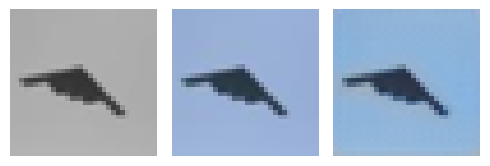

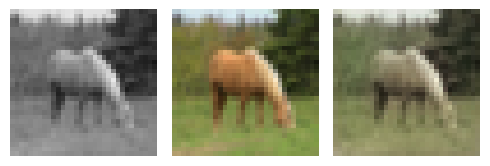

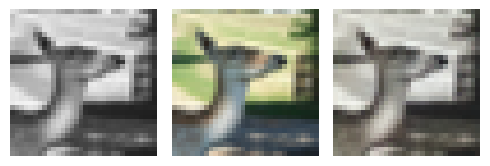

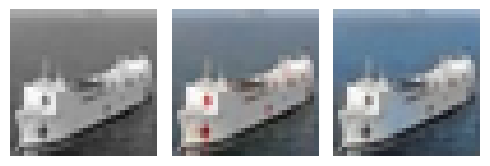

EPOCH: 52.255  trn_loss: 0.004  (3953.60s - 3612.36s remaining)

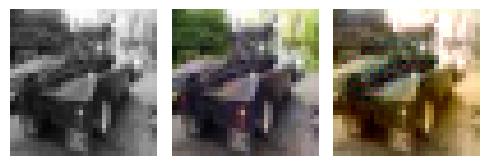

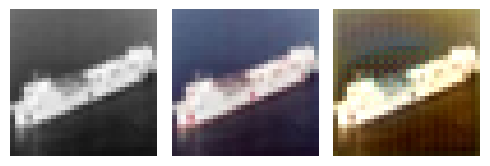

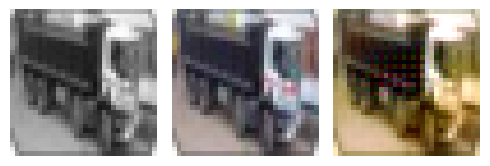

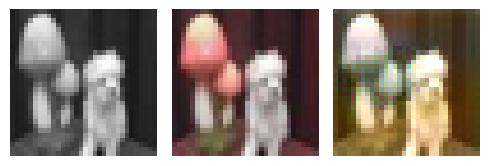

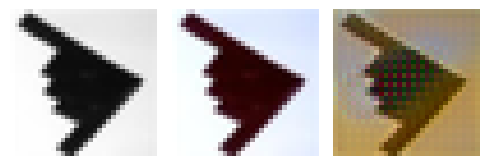

EPOCH: 52.505  trn_loss: 0.005  (3972.20s - 3593.16s remaining)

EPOCH: 52.510  trn_loss: 0.005  (3972.54s - 3592.73s remaining)

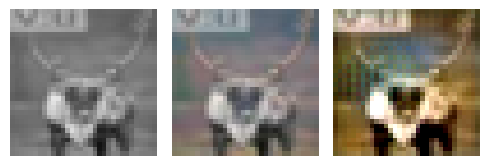

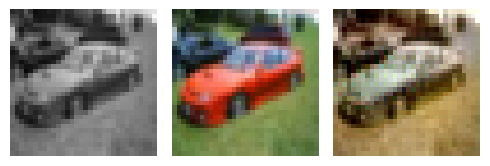

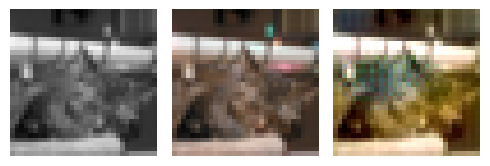

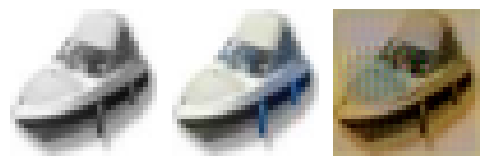

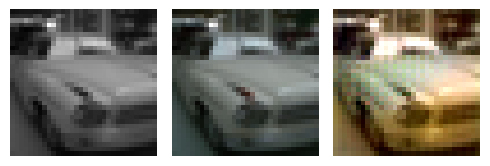

EPOCH: 52.760  trn_loss: 0.005  (3990.62s - 3573.07s remaining)

EPOCH: 52.765  trn_loss: 0.005  (3990.96s - 3572.65s remaining)

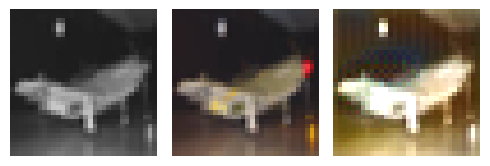

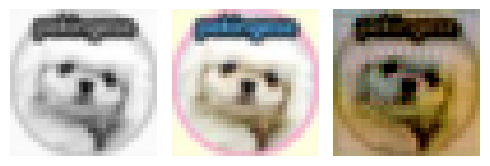

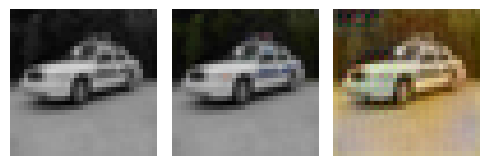

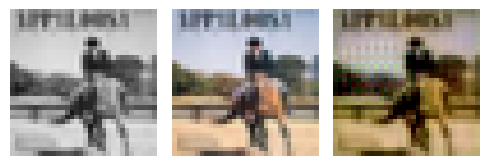

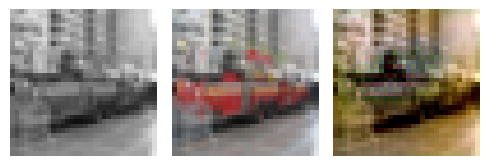

EPOCH: 53.000  val_loss: 0.003  (4015.43s - 3560.85s remaining)

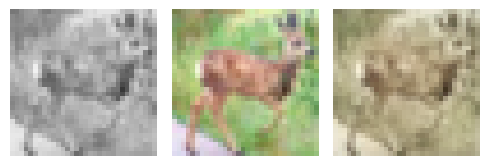

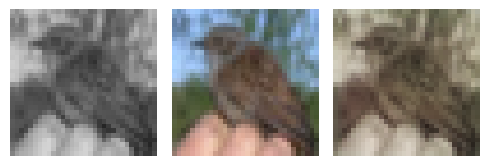

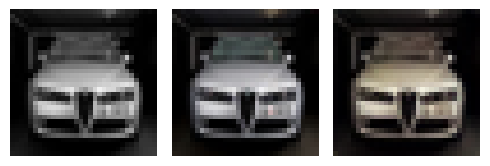

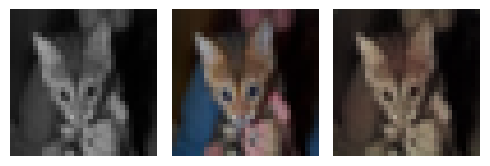

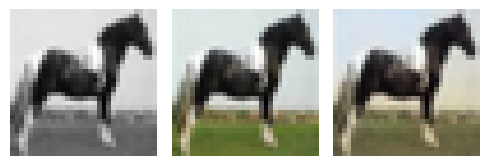

EPOCH: 53.250  trn_loss: 0.005  (4033.19s - 3540.87s remaining)

EPOCH: 53.255  trn_loss: 0.004  (4033.53s - 3540.45s remaining)

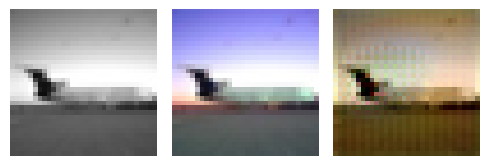

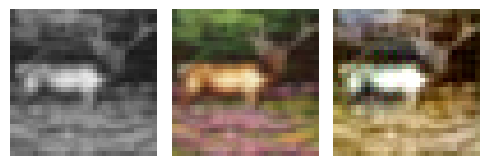

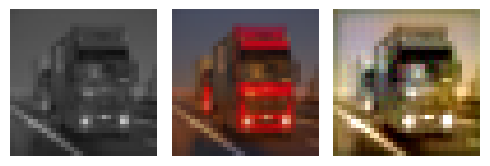

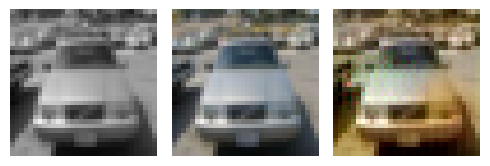

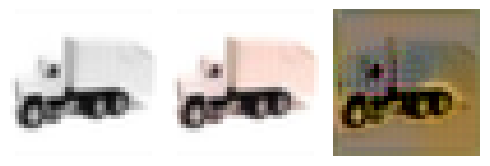

EPOCH: 53.505  trn_loss: 0.004  (4051.71s - 3520.86s remaining)

EPOCH: 53.510  trn_loss: 0.004  (4052.05s - 3520.43s remaining)

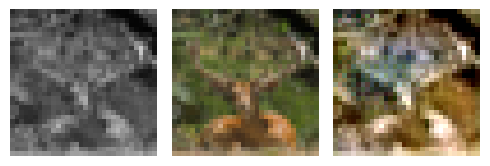

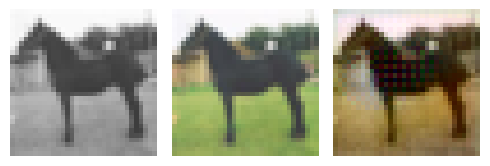

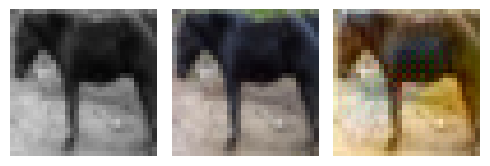

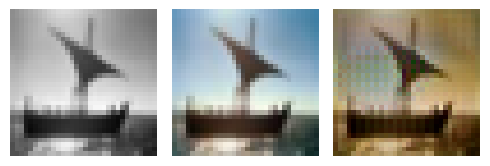

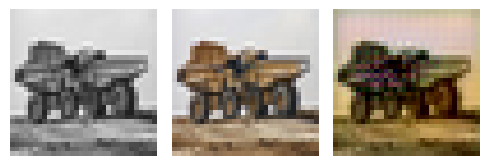

EPOCH: 53.760  trn_loss: 0.004  (4070.00s - 3500.65s remaining)

EPOCH: 53.765  trn_loss: 0.005  (4070.34s - 3500.23s remaining)

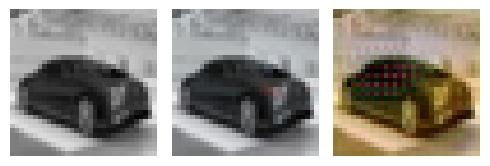

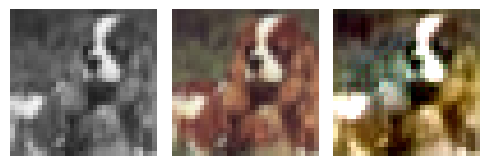

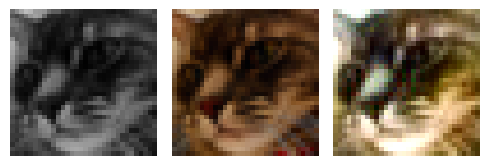

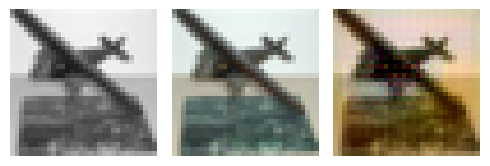

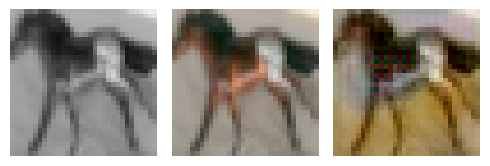

EPOCH: 54.000  val_loss: 0.003  (4094.88s - 3488.23s remaining)

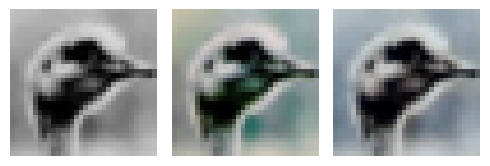

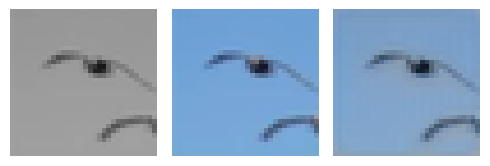

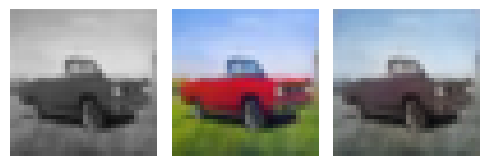

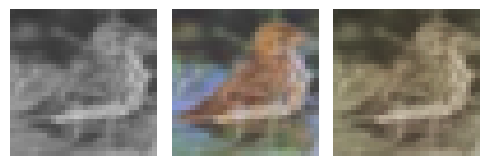

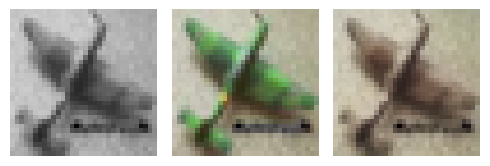

EPOCH: 54.250  trn_loss: 0.005  (4112.92s - 3468.50s remaining)

EPOCH: 54.255  trn_loss: 0.005  (4113.25s - 3468.07s remaining)

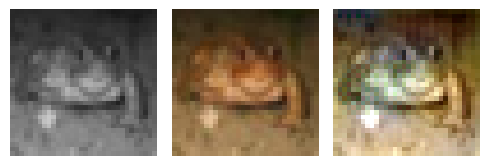

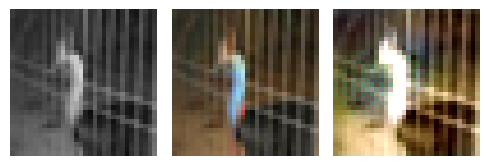

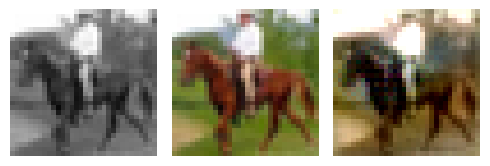

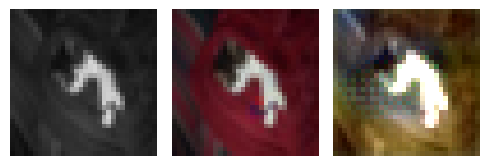

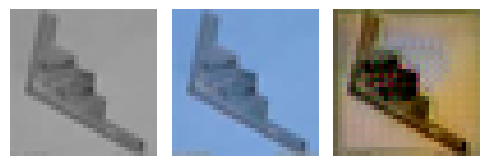

EPOCH: 54.505  trn_loss: 0.004  (4131.56s - 3448.58s remaining)

EPOCH: 54.510  trn_loss: 0.004  (4131.92s - 3448.17s remaining)

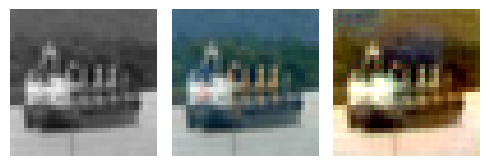

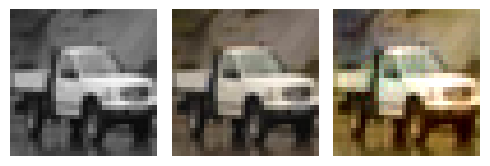

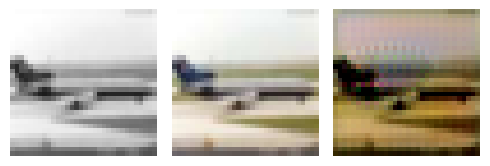

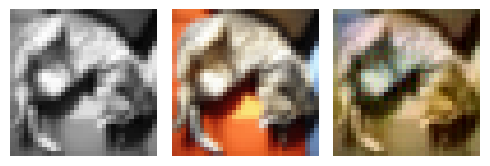

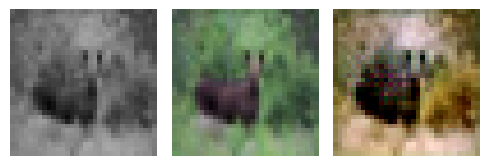

EPOCH: 54.760  trn_loss: 0.005  (4150.13s - 3428.60s remaining)

EPOCH: 54.765  trn_loss: 0.005  (4150.48s - 3428.19s remaining)

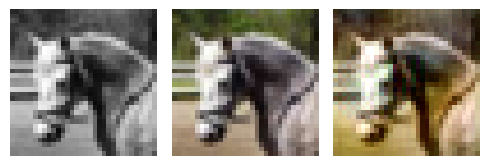

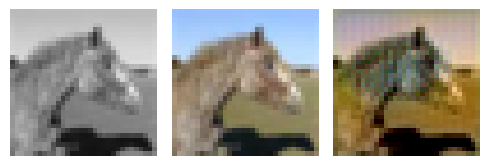

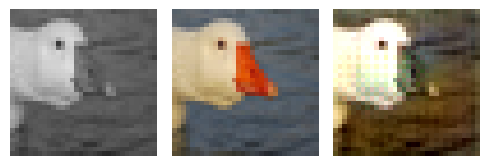

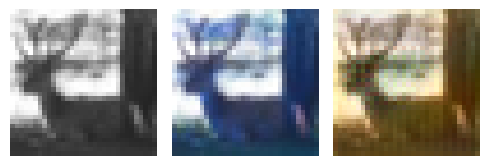

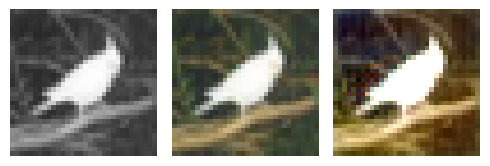

EPOCH: 55.000  trn_loss: 0.005  val_loss: 0.005  (4174.68s - 3415.64s remaining)


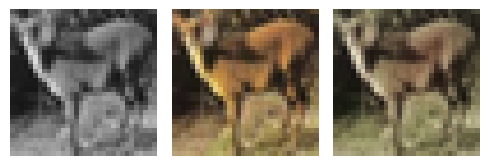

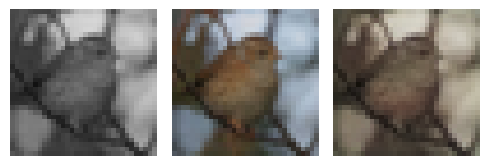

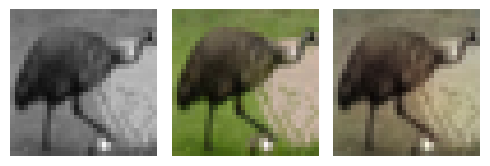

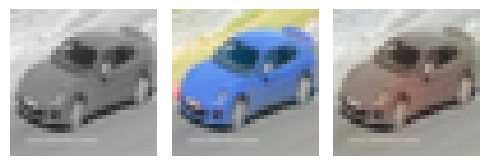

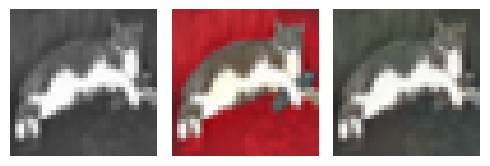

EPOCH: 55.250  trn_loss: 0.004  (4192.60s - 3395.82s remaining)

EPOCH: 55.255  trn_loss: 0.005  (4192.96s - 3395.41s remaining)

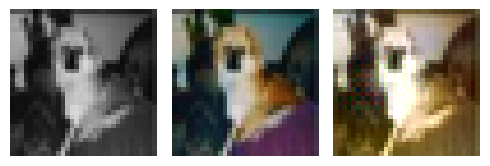

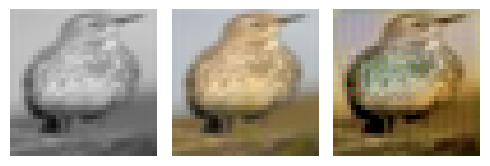

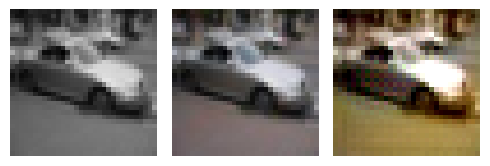

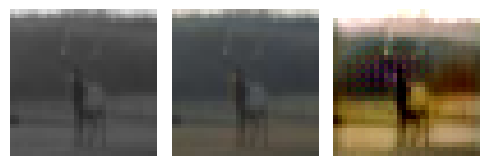

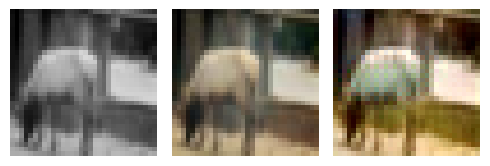

EPOCH: 55.505  trn_loss: 0.004  (4211.50s - 3376.09s remaining)

EPOCH: 55.510  trn_loss: 0.005  (4211.84s - 3375.67s remaining)

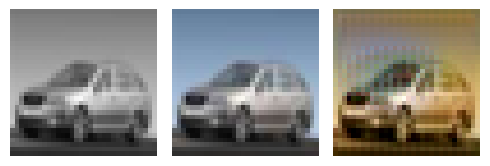

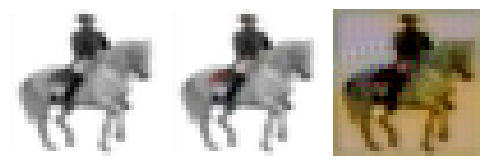

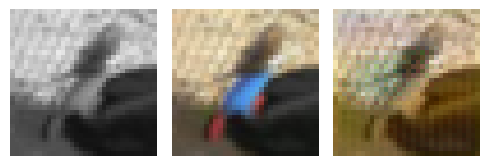

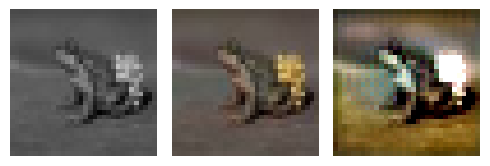

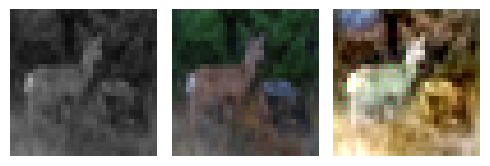

EPOCH: 55.760  trn_loss: 0.005  (4229.76s - 3355.87s remaining)

EPOCH: 55.765  trn_loss: 0.004  (4230.12s - 3355.45s remaining)

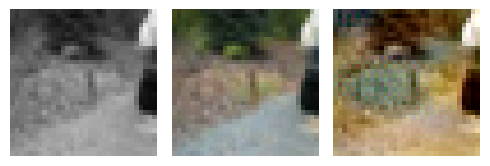

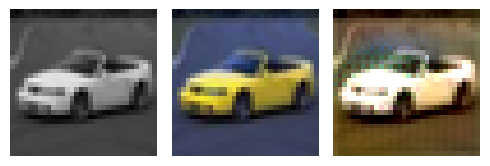

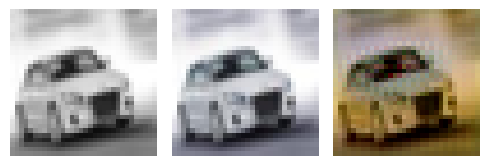

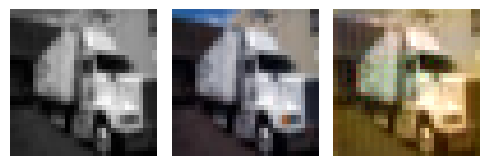

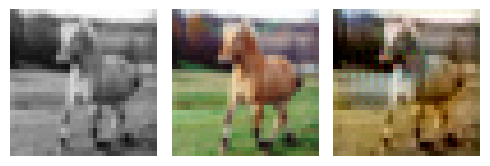

EPOCH: 56.000  val_loss: 0.003  (4254.49s - 3342.82s remaining)

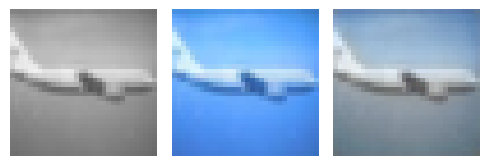

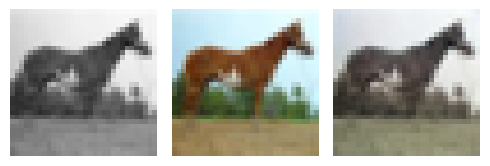

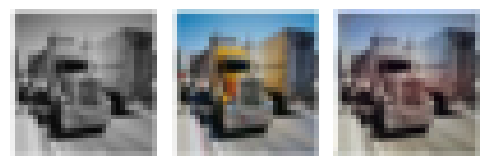

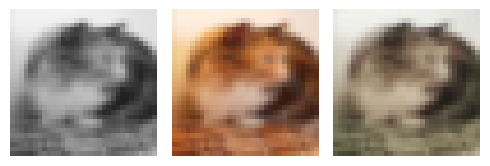

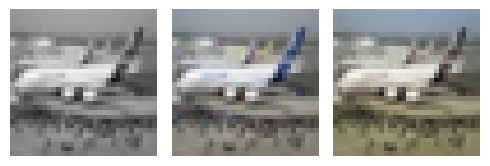

EPOCH: 56.250  trn_loss: 0.005  (4272.60s - 3323.13s remaining)

EPOCH: 56.255  trn_loss: 0.005  (4272.93s - 3322.70s remaining)

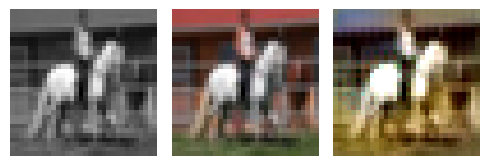

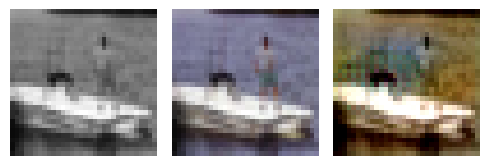

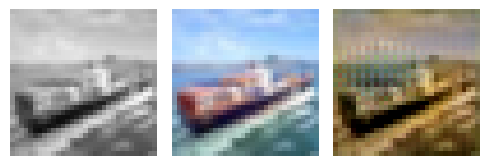

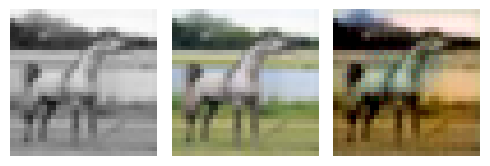

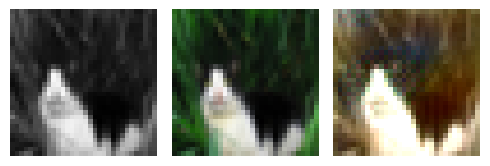

EPOCH: 56.505  trn_loss: 0.004  (4291.27s - 3303.22s remaining)

EPOCH: 56.510  trn_loss: 0.005  (4291.62s - 3302.80s remaining)

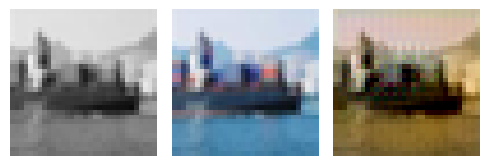

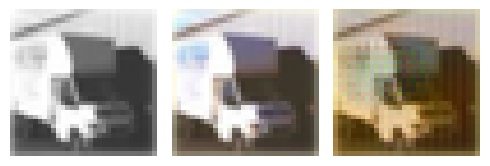

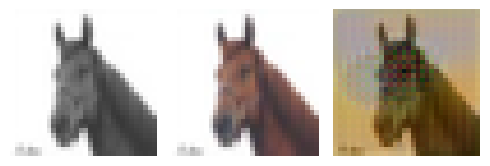

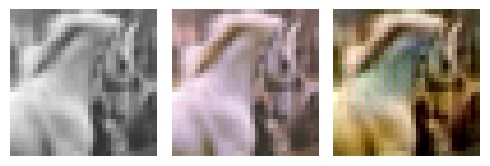

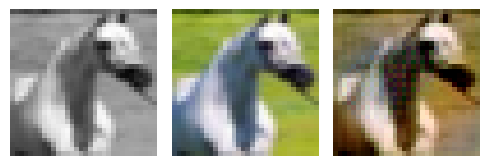

EPOCH: 56.760  trn_loss: 0.004  (4309.78s - 3283.18s remaining)

EPOCH: 56.765  trn_loss: 0.004  (4310.12s - 3282.75s remaining)

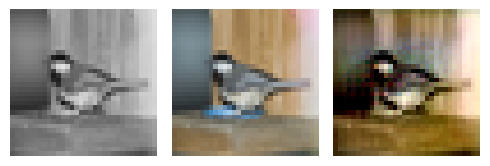

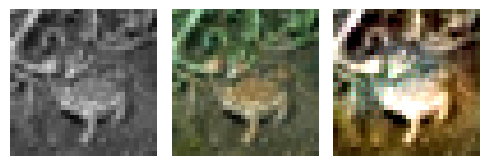

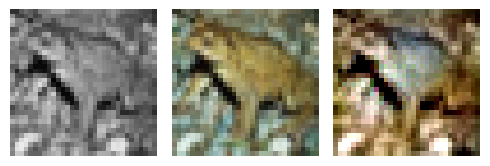

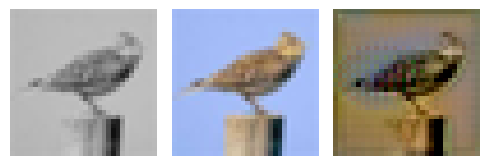

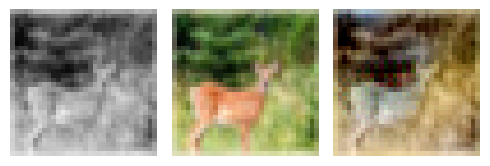

EPOCH: 56.975  val_loss: 0.005  (4334.81s - 3273.45s remaining)

EPOCH: 57.000  val_loss: 0.003  (4334.83s - 3270.13s remaining)

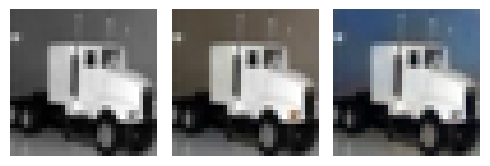

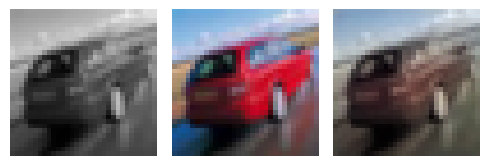

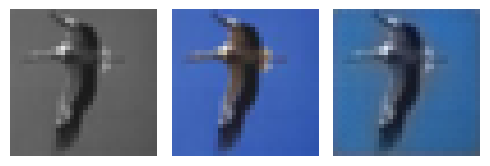

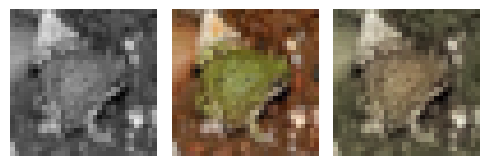

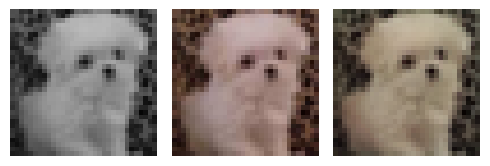

EPOCH: 57.250  trn_loss: 0.004  (4352.84s - 3250.37s remaining)

EPOCH: 57.255  trn_loss: 0.003  (4353.18s - 3249.95s remaining)

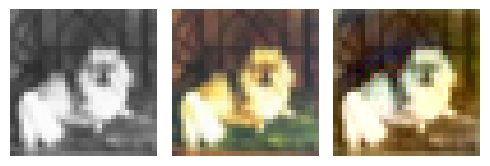

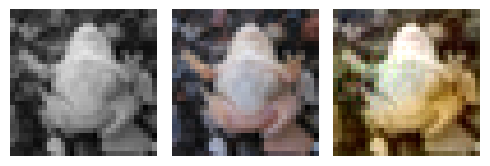

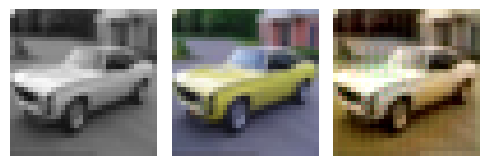

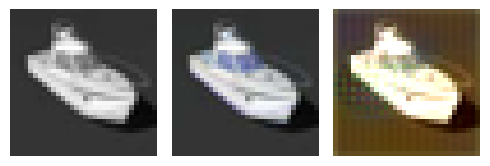

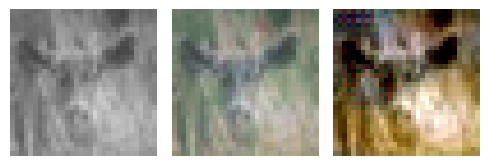

EPOCH: 57.510  trn_loss: 0.004  (4371.22s - 3229.55s remaining)

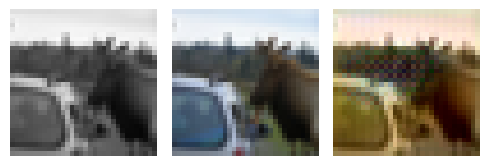

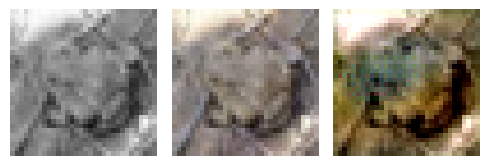

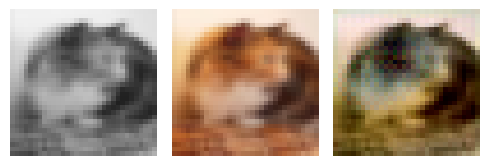

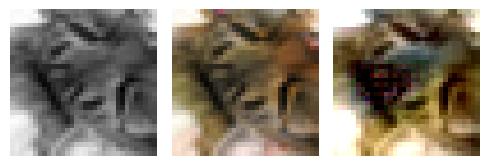

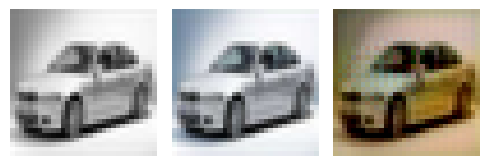

EPOCH: 57.760  trn_loss: 0.004  (4389.57s - 3210.08s remaining)

EPOCH: 57.765  trn_loss: 0.004  (4389.91s - 3209.65s remaining)

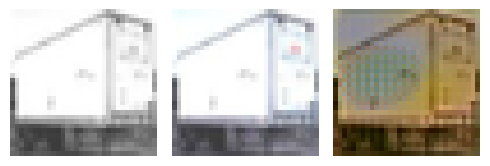

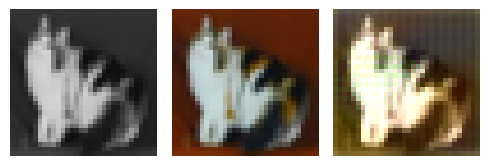

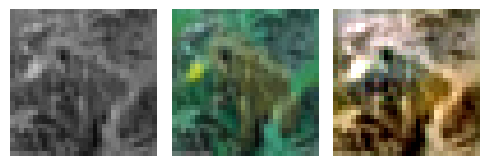

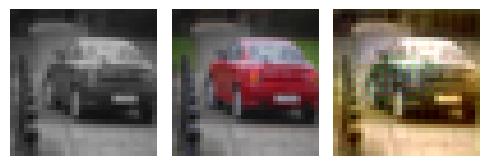

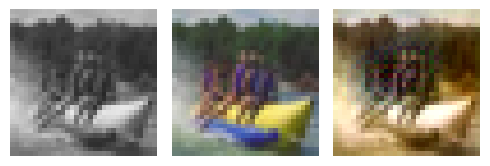

EPOCH: 57.950  val_loss: 0.005  (4414.55s - 3203.31s remaining)

EPOCH: 58.000  val_loss: 0.003  (4414.77s - 3196.91s remaining)

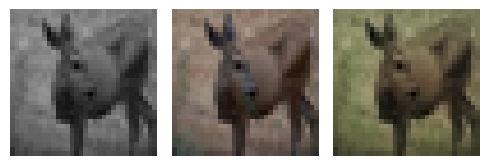

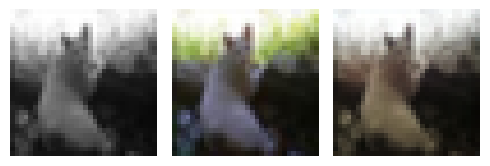

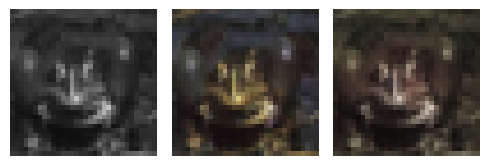

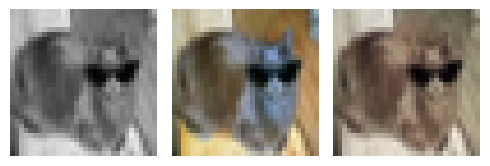

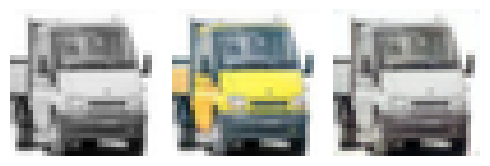

EPOCH: 58.250  trn_loss: 0.004  (4432.75s - 3177.12s remaining)

EPOCH: 58.255  trn_loss: 0.005  (4433.10s - 3176.70s remaining)

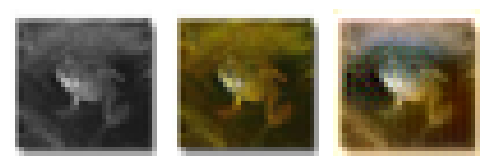

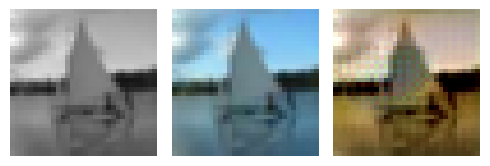

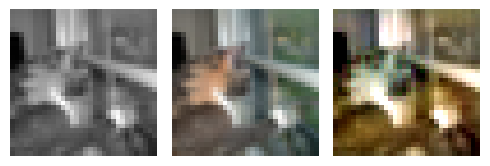

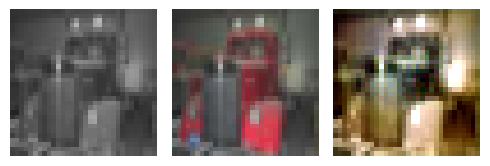

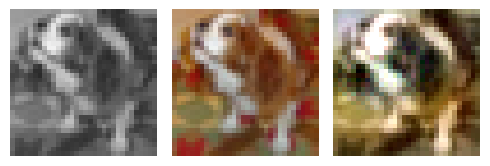

EPOCH: 58.505  trn_loss: 0.005  (4451.26s - 3157.07s remaining)

EPOCH: 58.510  trn_loss: 0.005  (4451.63s - 3156.67s remaining)

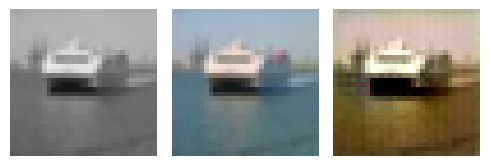

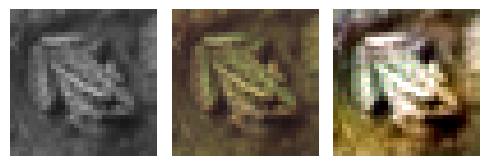

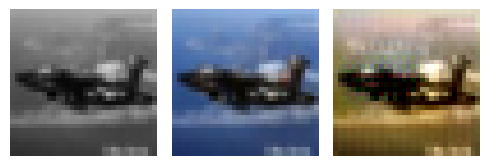

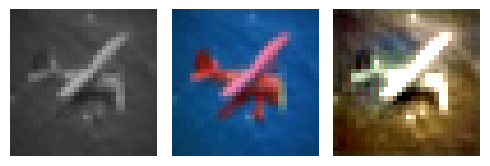

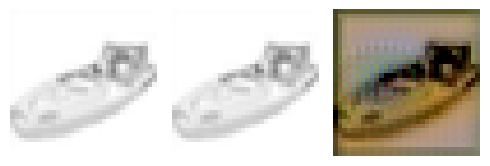

EPOCH: 58.760  trn_loss: 0.005  (4470.13s - 3137.28s remaining)

EPOCH: 58.765  trn_loss: 0.005  (4470.47s - 3136.86s remaining)

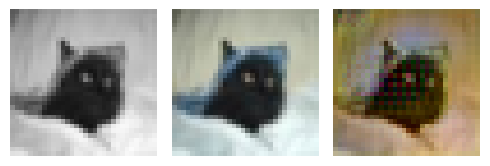

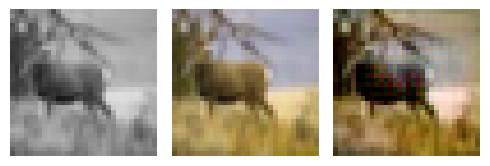

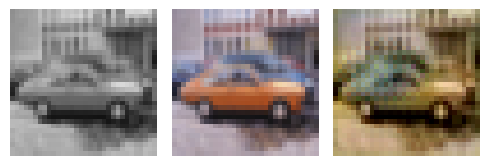

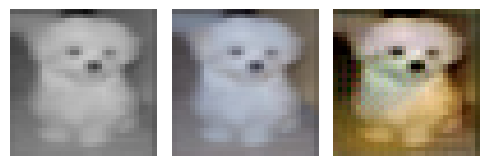

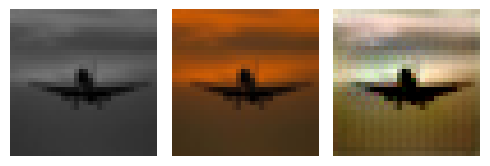

EPOCH: 59.000  val_loss: 0.003  (4495.00s - 3123.64s remaining)

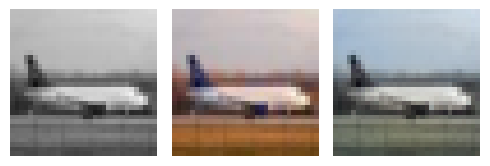

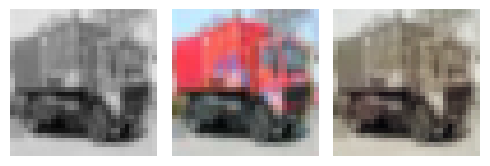

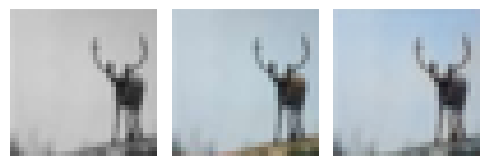

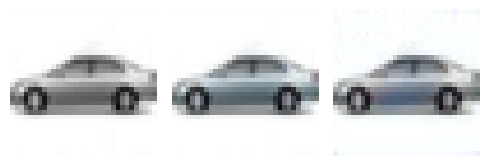

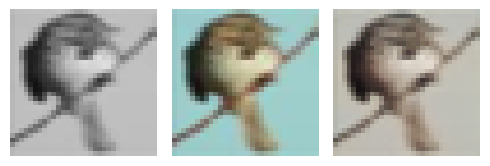

EPOCH: 59.250  trn_loss: 0.005  (4513.13s - 3103.97s remaining)

EPOCH: 59.255  trn_loss: 0.004  (4513.51s - 3103.57s remaining)

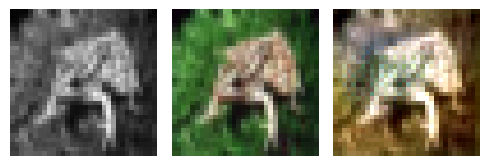

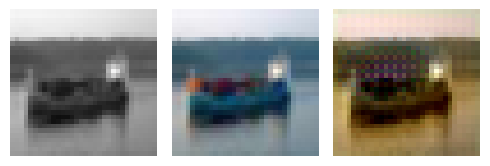

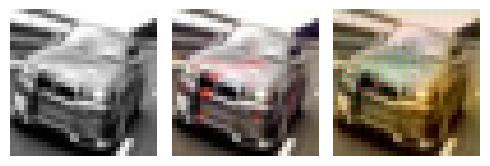

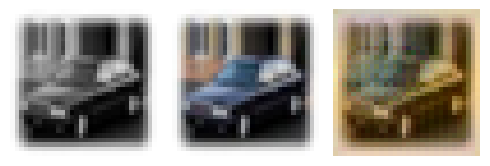

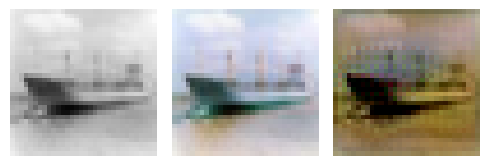

EPOCH: 59.505  trn_loss: 0.004  (4531.76s - 3083.99s remaining)

EPOCH: 59.510  trn_loss: 0.004  (4532.11s - 3083.57s remaining)

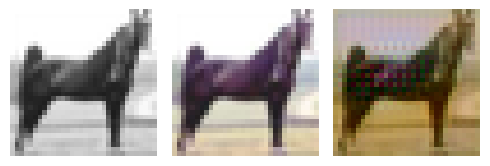

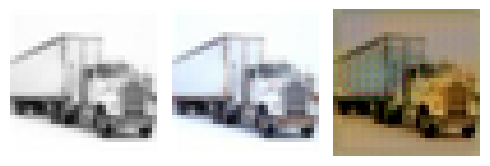

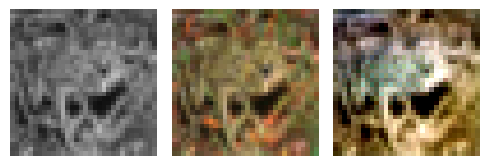

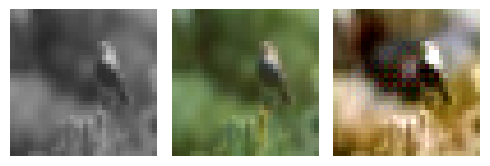

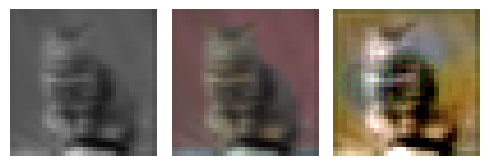

EPOCH: 59.760  trn_loss: 0.005  (4550.67s - 3064.22s remaining)

EPOCH: 59.765  trn_loss: 0.004  (4551.01s - 3063.79s remaining)

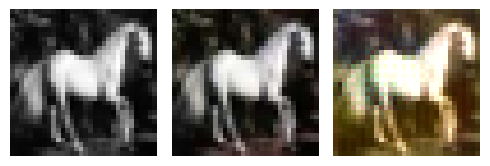

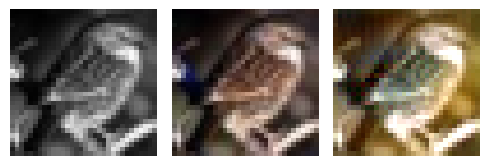

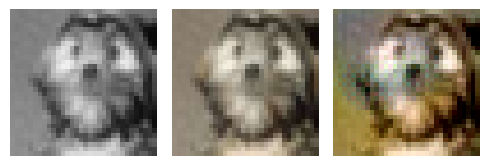

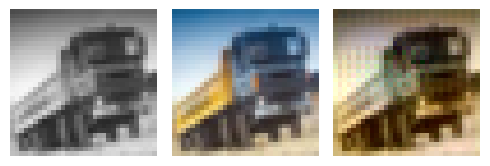

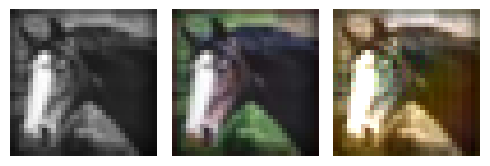

EPOCH: 59.950  val_loss: 0.005  (4575.50s - 3056.69s remaining)

EPOCH: 60.000  trn_loss: 0.005  val_loss: 0.005  (4575.74s - 3050.49s remaining)


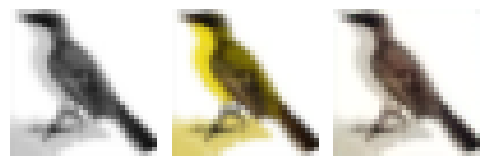

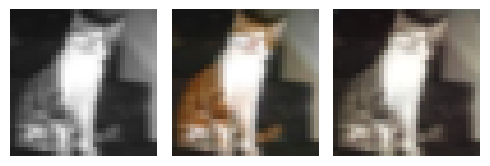

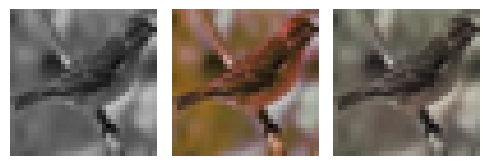

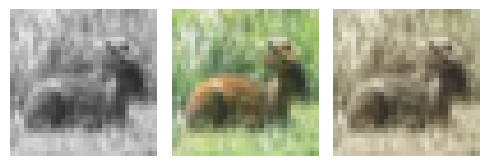

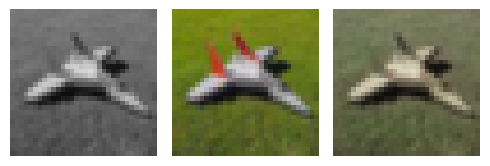

EPOCH: 60.250  trn_loss: 0.004  (4593.93s - 3030.85s remaining)

EPOCH: 60.255  trn_loss: 0.004  (4594.29s - 3030.44s remaining)

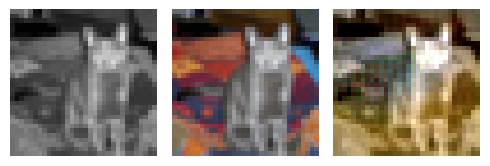

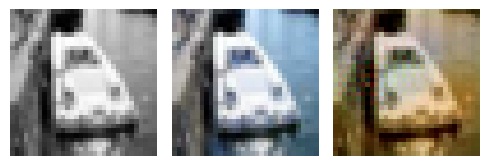

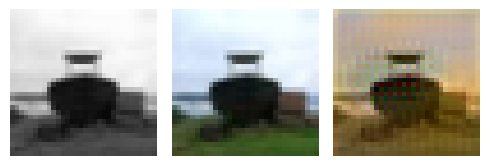

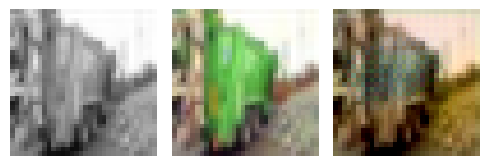

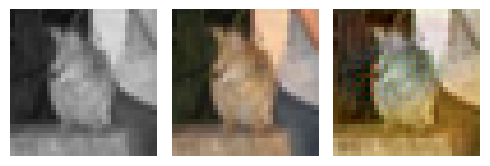

EPOCH: 60.505  trn_loss: 0.005  (4612.17s - 3010.61s remaining)

EPOCH: 60.510  trn_loss: 0.005  (4612.51s - 3010.19s remaining)

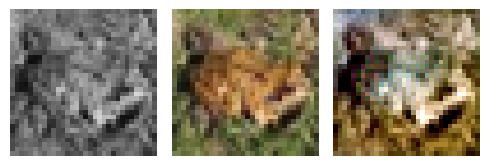

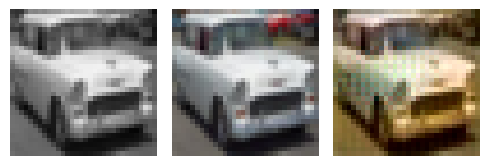

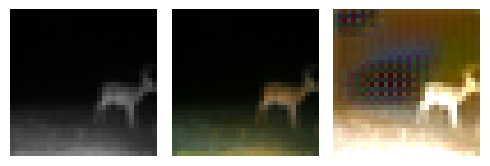

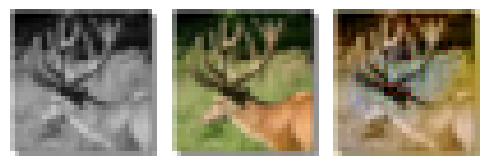

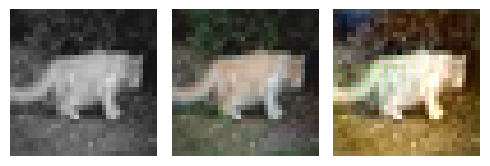

EPOCH: 60.760  trn_loss: 0.004  (4630.58s - 2990.50s remaining)

EPOCH: 60.765  trn_loss: 0.004  (4630.92s - 2990.08s remaining)

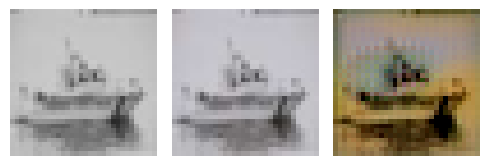

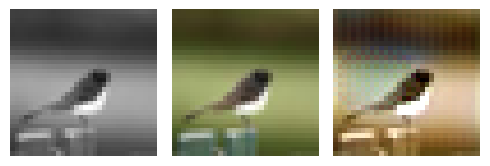

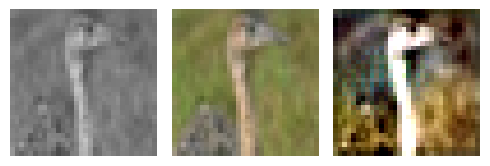

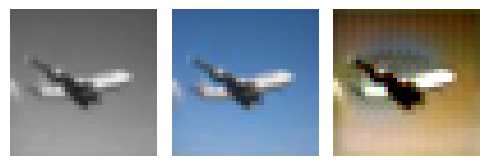

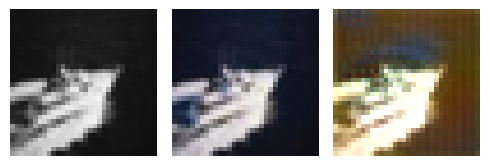

EPOCH: 60.950  val_loss: 0.005  (4656.10s - 2983.11s remaining)

EPOCH: 61.000  val_loss: 0.003  (4656.32s - 2976.99s remaining)

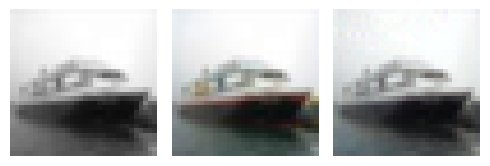

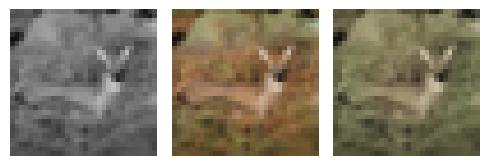

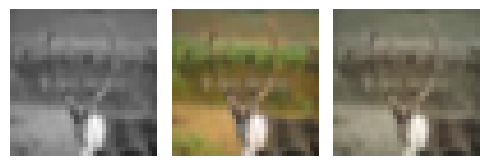

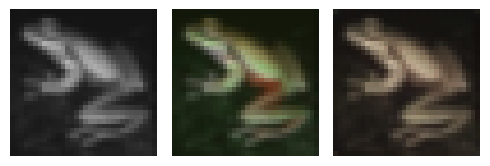

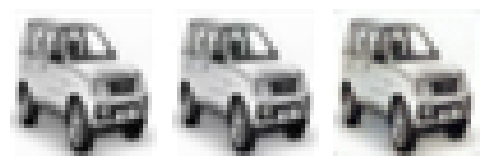

EPOCH: 61.250  trn_loss: 0.004  (4674.28s - 2957.20s remaining)

EPOCH: 61.255  trn_loss: 0.004  (4674.64s - 2956.79s remaining)

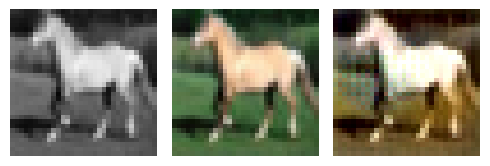

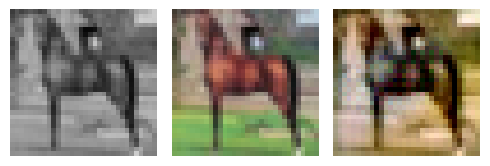

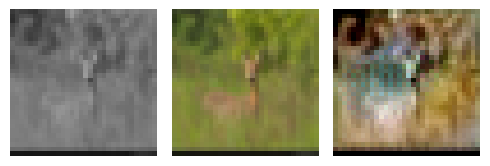

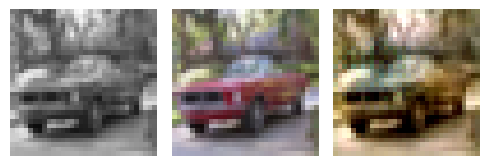

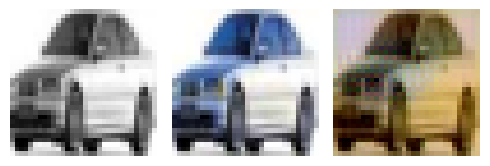

EPOCH: 61.505  trn_loss: 0.005  (4692.72s - 2937.09s remaining)

EPOCH: 61.510  trn_loss: 0.004  (4693.09s - 2936.69s remaining)

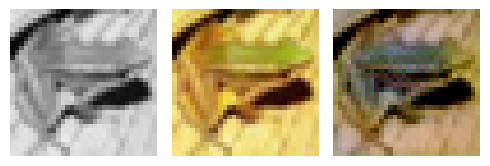

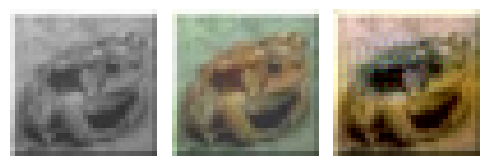

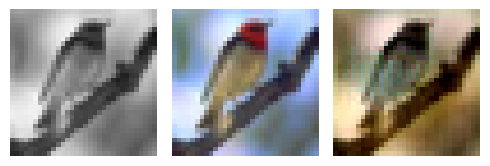

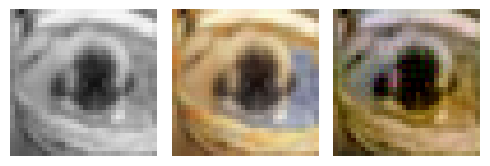

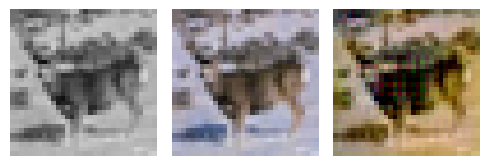

EPOCH: 61.760  trn_loss: 0.005  (4710.86s - 2916.80s remaining)

EPOCH: 61.765  trn_loss: 0.005  (4711.24s - 2916.40s remaining)

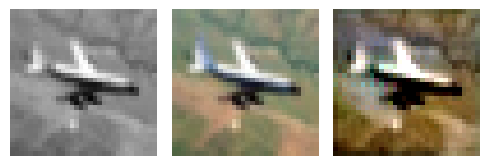

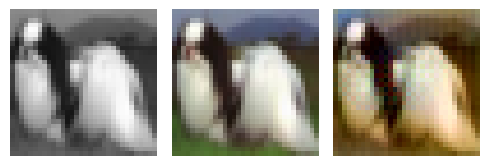

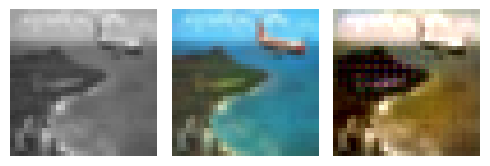

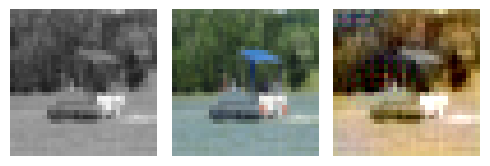

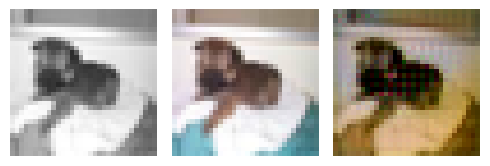

EPOCH: 62.000  val_loss: 0.003  (4736.38s - 2902.94s remaining)

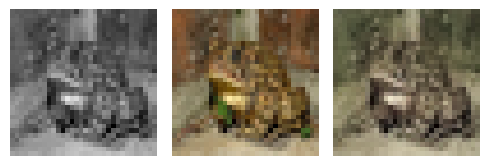

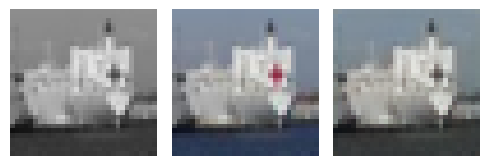

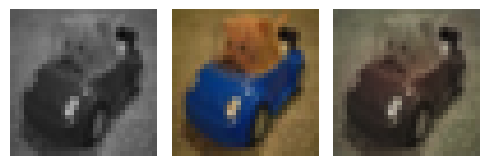

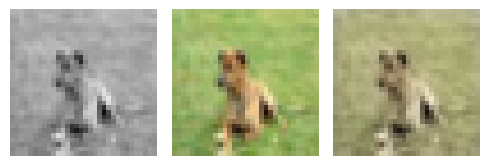

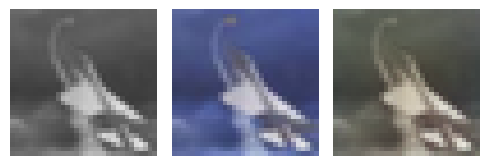

EPOCH: 62.250  trn_loss: 0.005  (4754.55s - 2883.28s remaining)

EPOCH: 62.255  trn_loss: 0.005  (4754.91s - 2882.87s remaining)

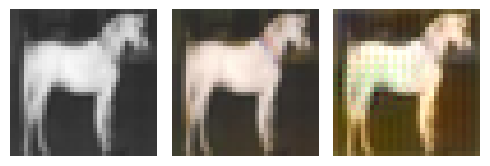

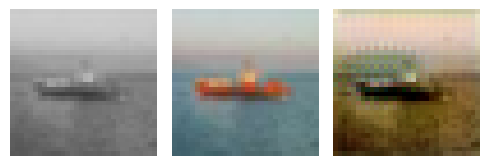

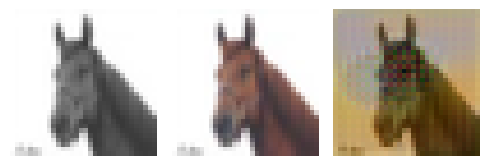

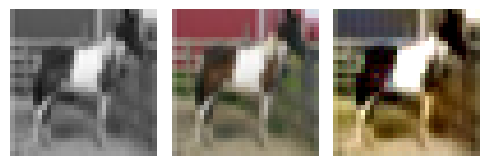

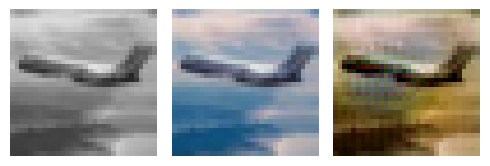

EPOCH: 62.505  trn_loss: 0.006  (4773.05s - 2863.21s remaining)

EPOCH: 62.510  trn_loss: 0.005  (4773.43s - 2862.81s remaining)

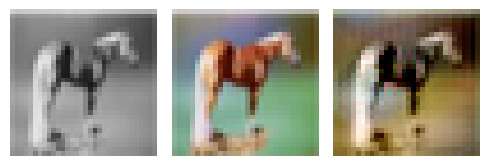

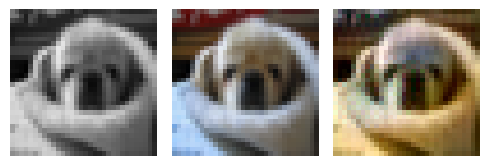

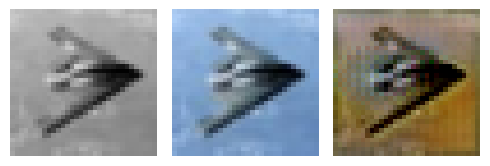

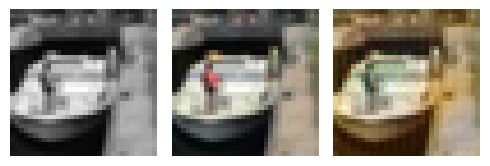

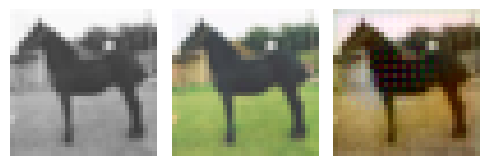

EPOCH: 62.760  trn_loss: 0.004  (4791.60s - 2843.18s remaining)

EPOCH: 62.765  trn_loss: 0.004  (4791.95s - 2842.76s remaining)

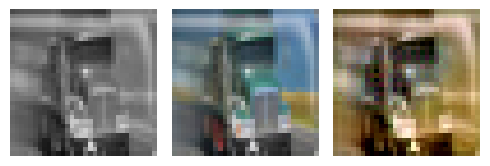

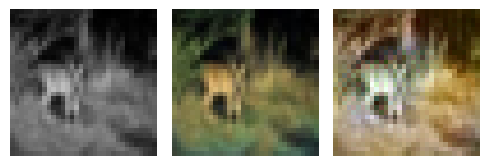

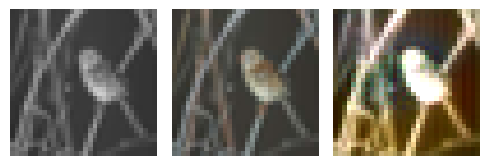

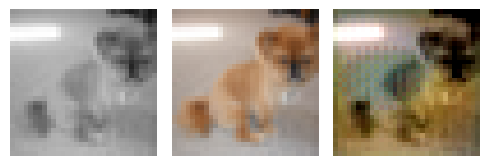

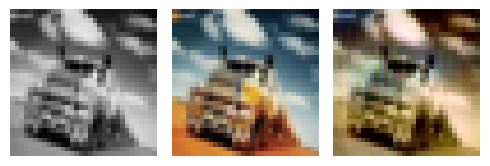

EPOCH: 62.950  val_loss: 0.005  (4816.52s - 2834.82s remaining)

EPOCH: 63.000  val_loss: 0.003  (4816.74s - 2828.88s remaining)

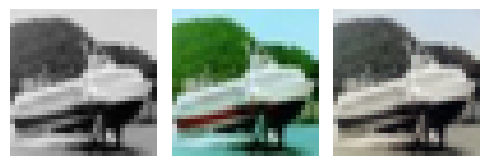

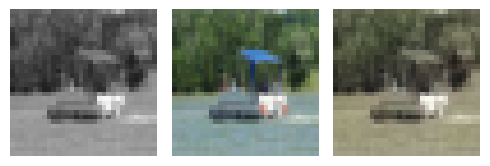

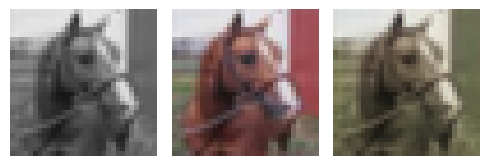

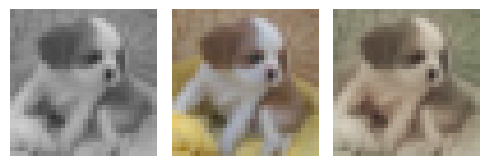

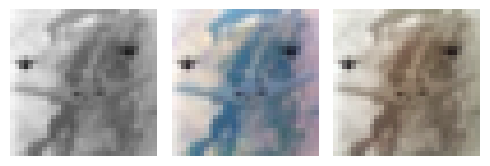

EPOCH: 63.250  trn_loss: 0.004  (4835.07s - 2809.31s remaining)

EPOCH: 63.255  trn_loss: 0.004  (4835.45s - 2808.91s remaining)

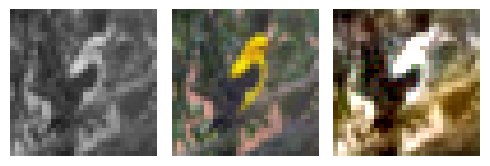

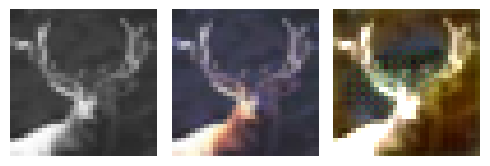

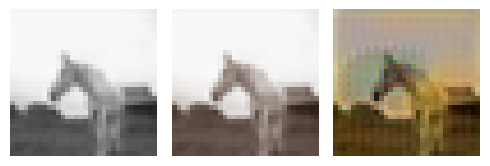

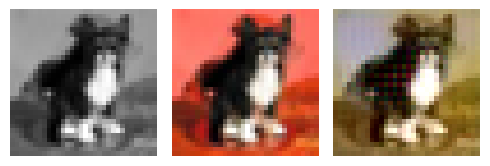

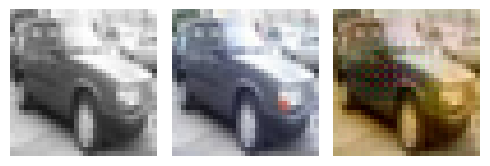

EPOCH: 63.505  trn_loss: 0.005  (4853.58s - 2789.24s remaining)

EPOCH: 63.510  trn_loss: 0.005  (4853.92s - 2788.82s remaining)

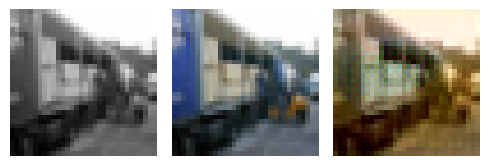

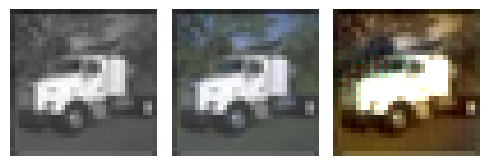

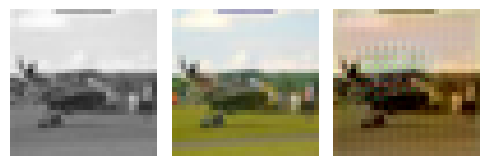

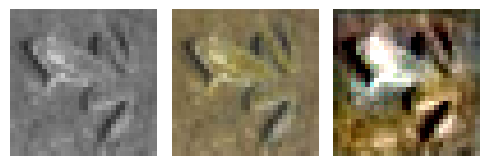

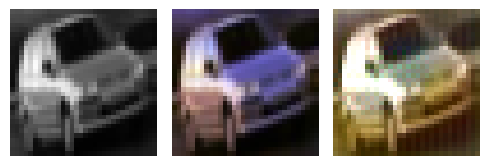

EPOCH: 63.760  trn_loss: 0.005  (4871.97s - 2769.11s remaining)

EPOCH: 63.765  trn_loss: 0.005  (4872.31s - 2768.69s remaining)

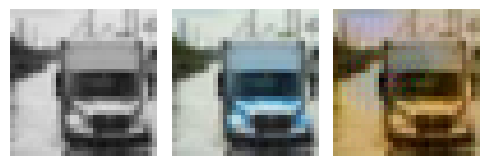

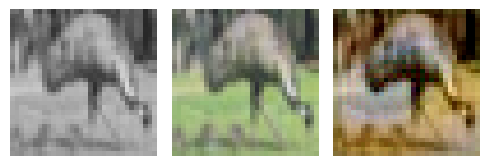

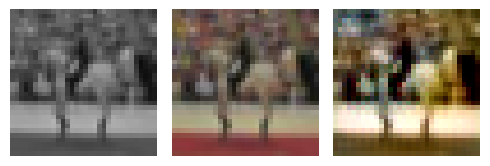

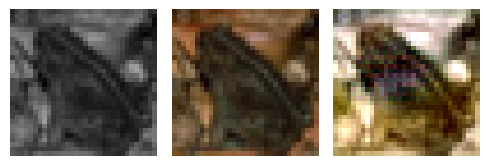

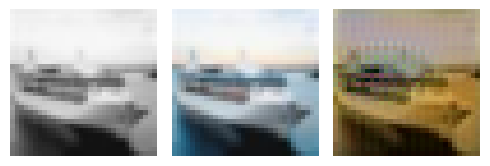

EPOCH: 63.950  val_loss: 0.005  (4897.14s - 2760.62s remaining)

EPOCH: 64.000  val_loss: 0.003  (4897.38s - 2754.78s remaining)

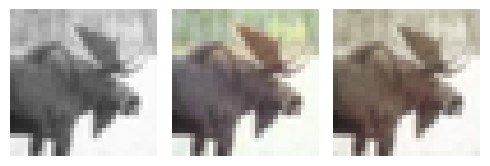

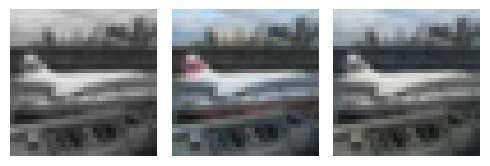

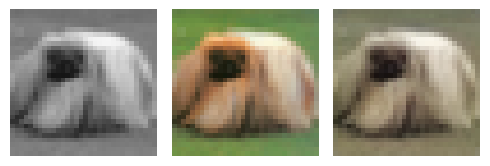

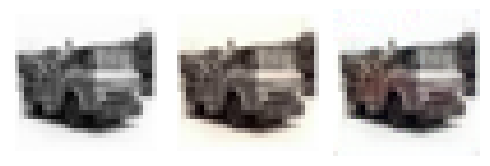

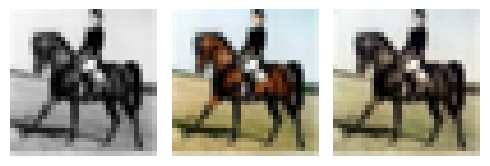

EPOCH: 64.250  trn_loss: 0.005  (4915.68s - 2735.18s remaining)

EPOCH: 64.255  trn_loss: 0.004  (4916.03s - 2734.77s remaining)

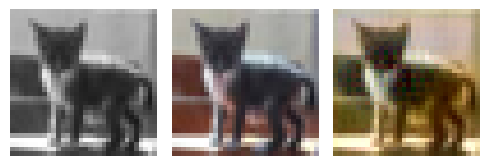

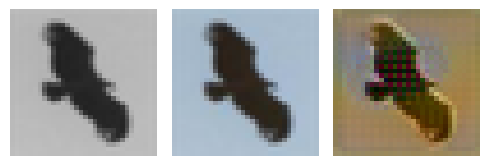

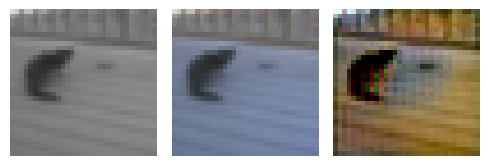

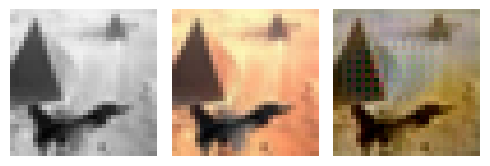

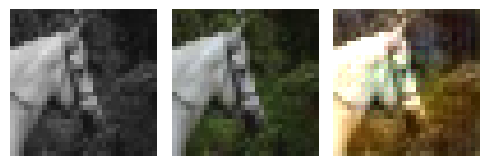

EPOCH: 64.505  trn_loss: 0.005  (4934.32s - 2715.18s remaining)

EPOCH: 64.510  trn_loss: 0.005  (4934.68s - 2714.78s remaining)

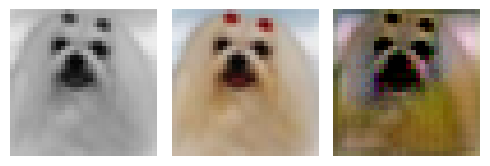

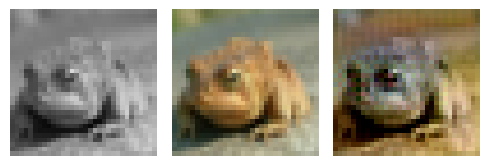

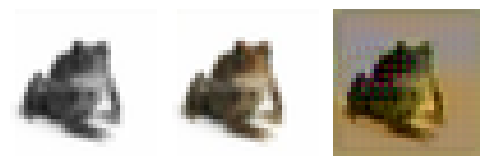

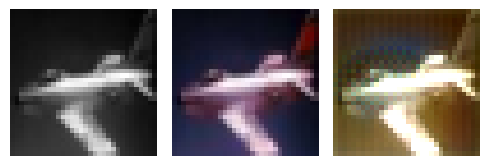

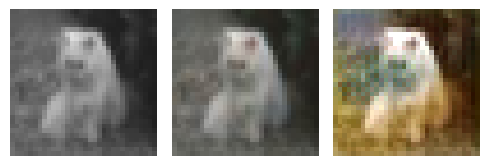

EPOCH: 64.760  trn_loss: 0.004  (4952.77s - 2695.09s remaining)

EPOCH: 64.765  trn_loss: 0.004  (4953.12s - 2694.68s remaining)

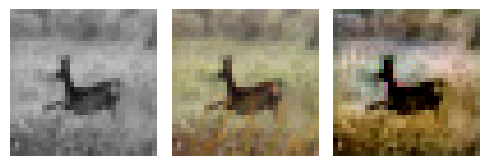

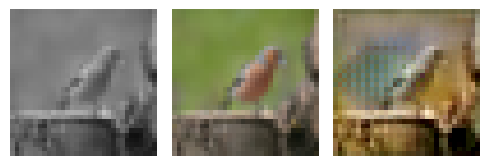

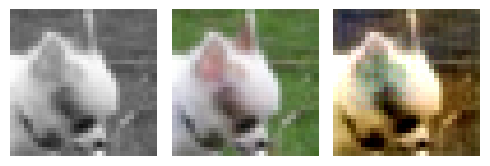

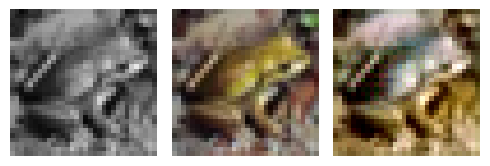

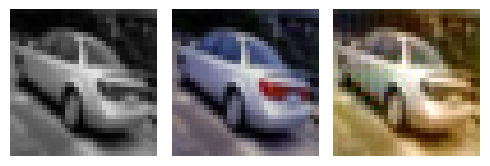

EPOCH: 65.000  trn_loss: 0.005  val_loss: 0.005  (4978.19s - 2680.56s remaining)


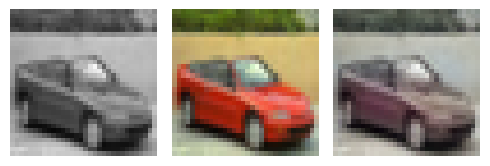

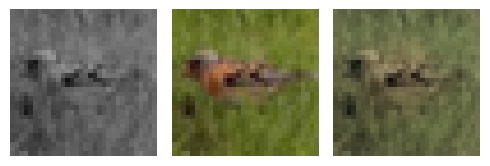

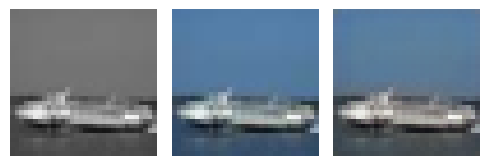

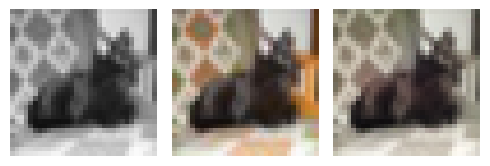

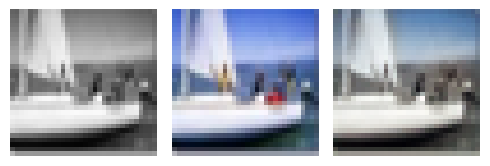

EPOCH: 65.250  trn_loss: 0.004  (4996.67s - 2661.06s remaining)

EPOCH: 65.255  trn_loss: 0.004  (4997.01s - 2660.65s remaining)

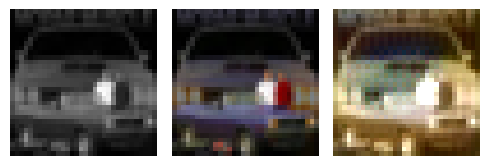

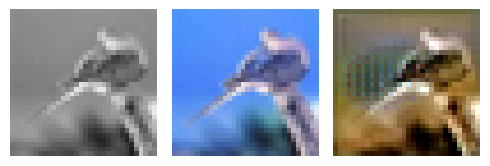

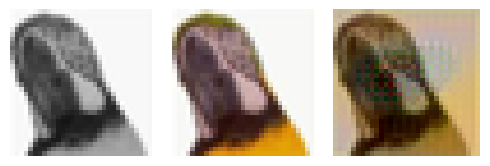

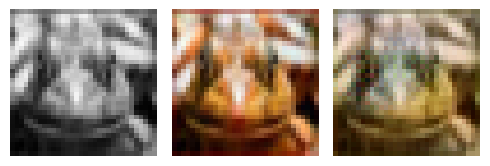

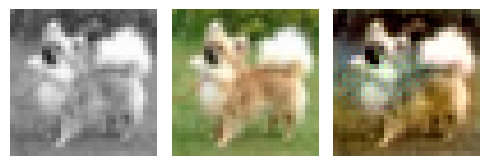

EPOCH: 65.505  trn_loss: 0.004  (5015.20s - 2641.00s remaining)

EPOCH: 65.510  trn_loss: 0.005  (5015.56s - 2640.59s remaining)

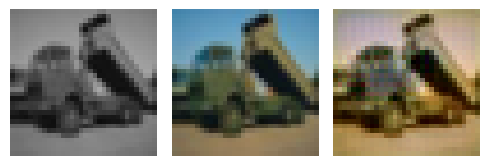

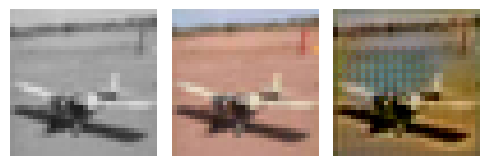

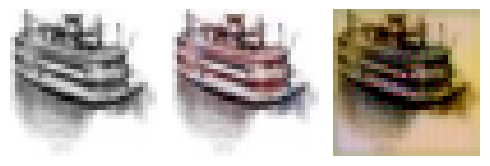

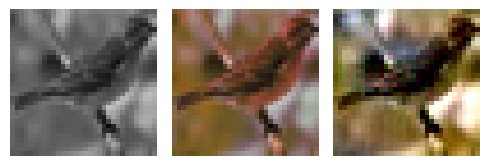

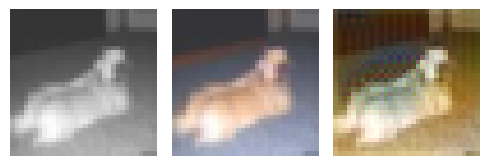

EPOCH: 65.760  trn_loss: 0.005  (5033.86s - 2621.01s remaining)

EPOCH: 65.765  trn_loss: 0.005  (5034.25s - 2620.62s remaining)

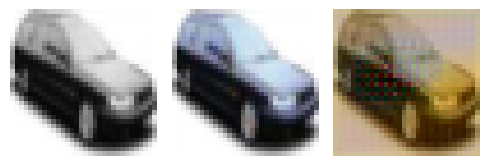

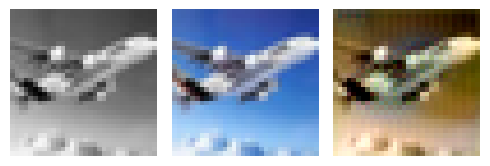

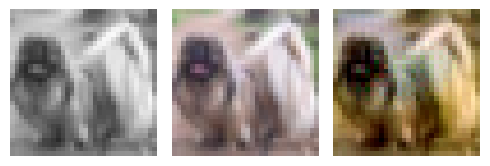

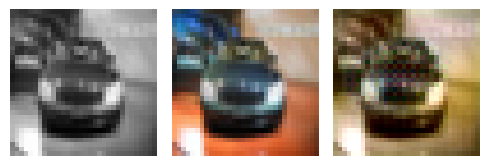

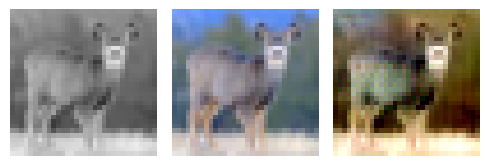

EPOCH: 65.950  val_loss: 0.005  (5059.10s - 2612.01s remaining)

EPOCH: 66.000  val_loss: 0.003  (5059.34s - 2606.33s remaining)

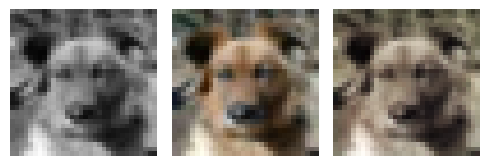

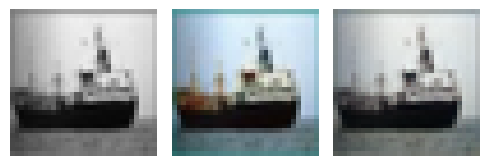

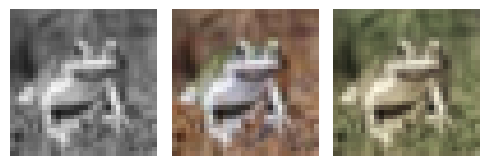

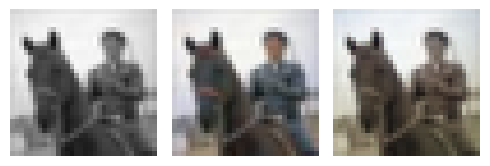

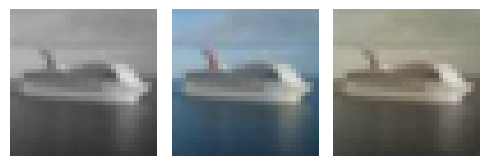

EPOCH: 66.250  trn_loss: 0.004  (5077.98s - 2586.89s remaining)

EPOCH: 66.255  trn_loss: 0.005  (5078.36s - 2586.50s remaining)

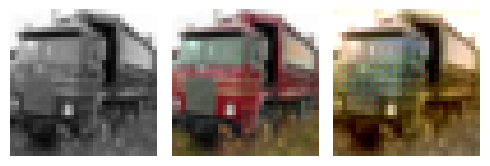

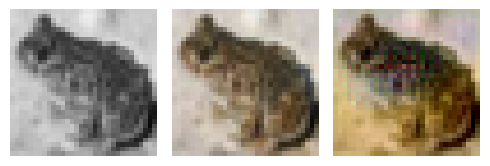

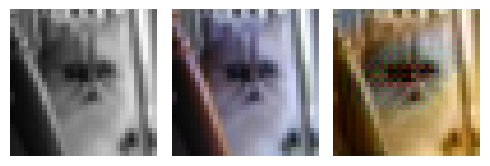

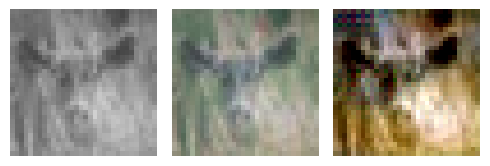

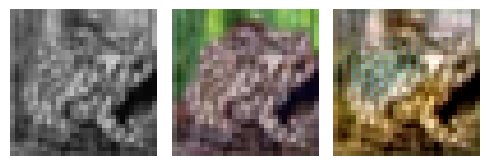

EPOCH: 66.505  trn_loss: 0.004  (5096.44s - 2566.79s remaining)

EPOCH: 66.510  trn_loss: 0.005  (5096.80s - 2566.39s remaining)

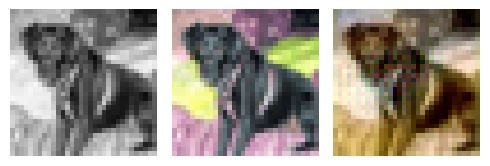

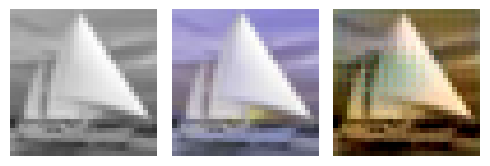

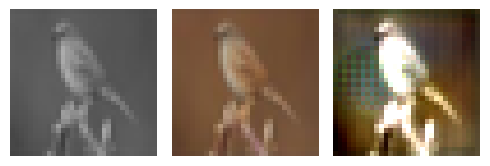

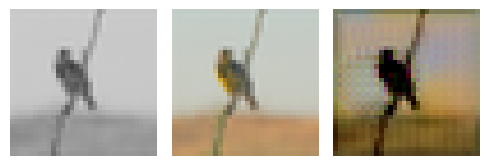

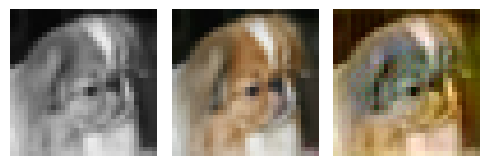

EPOCH: 66.760  trn_loss: 0.005  (5114.98s - 2546.74s remaining)

EPOCH: 66.765  trn_loss: 0.005  (5115.32s - 2546.33s remaining)

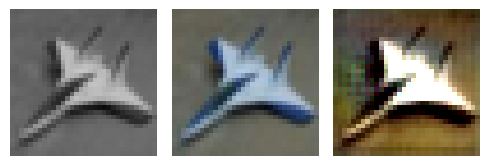

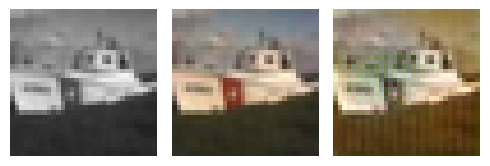

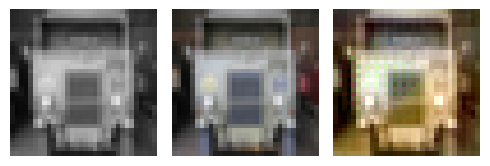

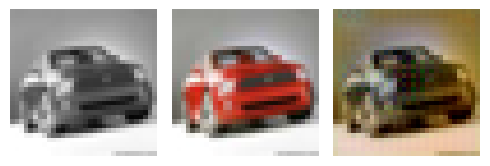

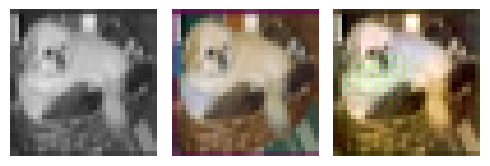

EPOCH: 67.000  val_loss: 0.003  (5140.08s - 2531.68s remaining)

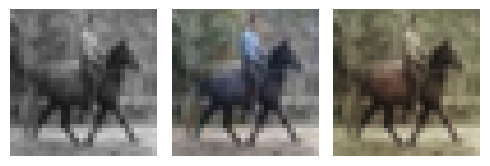

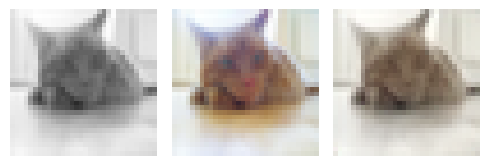

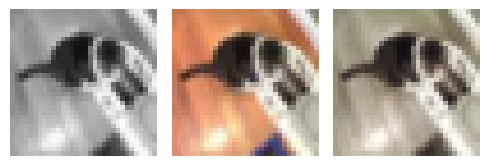

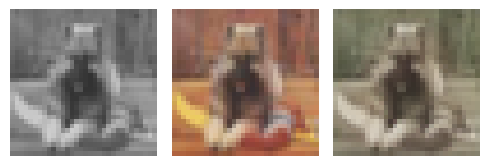

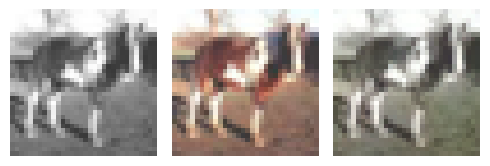

EPOCH: 67.250  trn_loss: 0.005  (5158.36s - 2512.06s remaining)

EPOCH: 67.255  trn_loss: 0.004  (5158.71s - 2511.65s remaining)

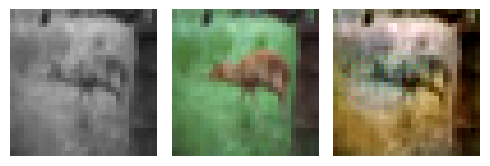

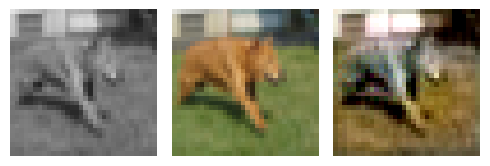

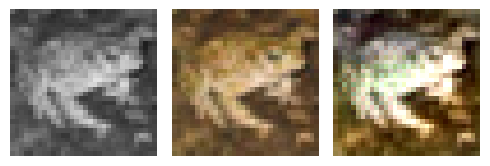

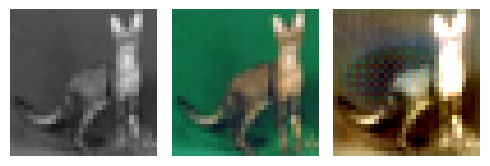

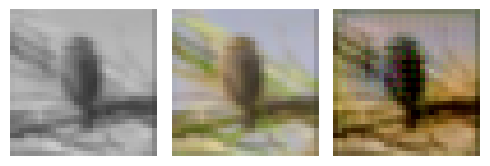

EPOCH: 67.505  trn_loss: 0.004  (5176.77s - 2491.94s remaining)

EPOCH: 67.510  trn_loss: 0.005  (5177.12s - 2491.53s remaining)

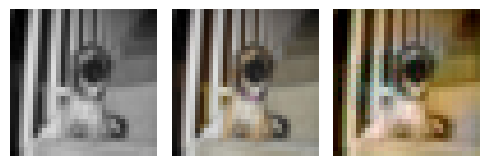

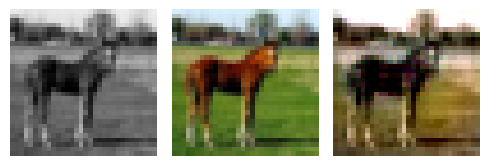

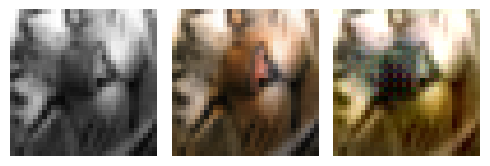

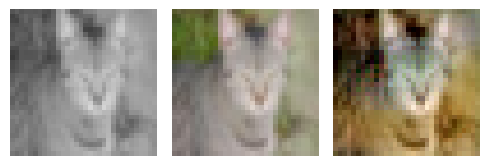

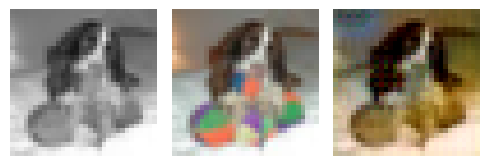

EPOCH: 67.760  trn_loss: 0.004  (5195.21s - 2471.84s remaining)

EPOCH: 67.765  trn_loss: 0.004  (5195.57s - 2471.44s remaining)

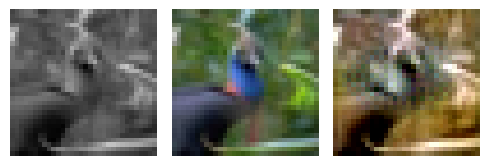

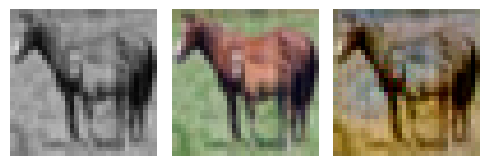

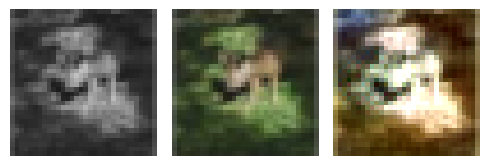

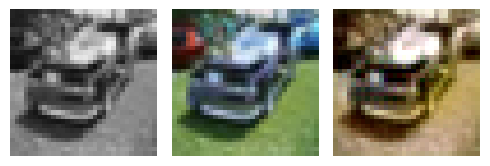

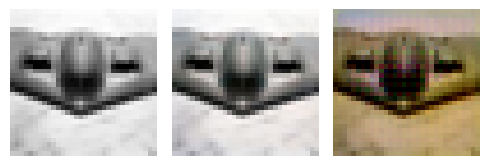

EPOCH: 67.950  val_loss: 0.005  (5220.05s - 2462.14s remaining)

EPOCH: 68.000  val_loss: 0.003  (5220.27s - 2456.60s remaining)

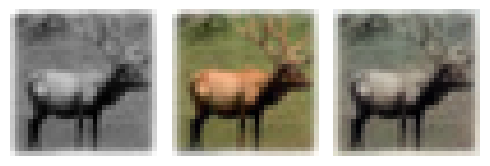

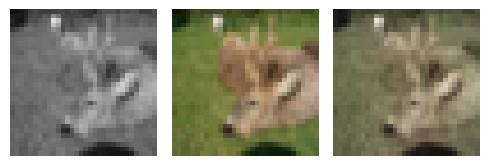

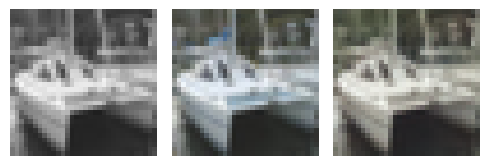

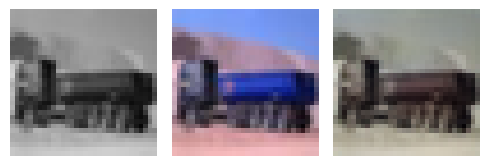

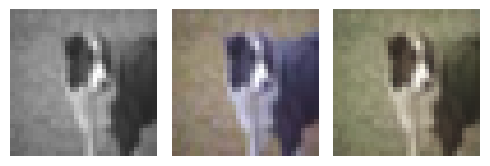

EPOCH: 68.255  trn_loss: 0.004  (5238.91s - 2436.57s remaining)

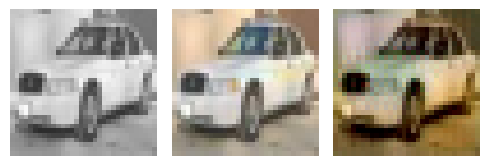

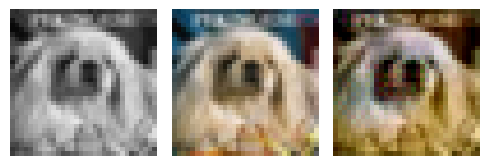

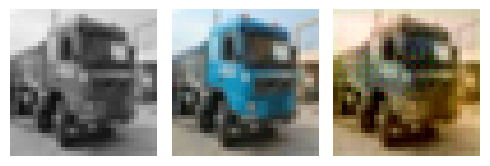

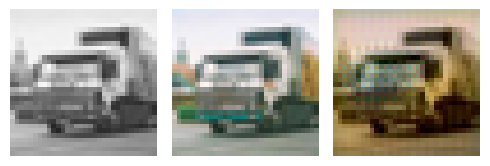

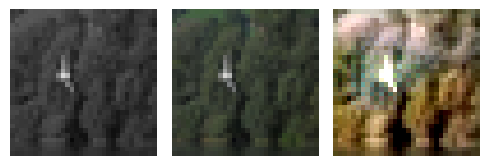

EPOCH: 68.505  trn_loss: 0.004  (5257.32s - 2417.03s remaining)

EPOCH: 68.510  trn_loss: 0.005  (5257.68s - 2416.62s remaining)

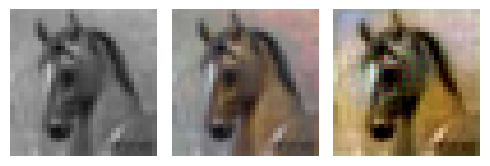

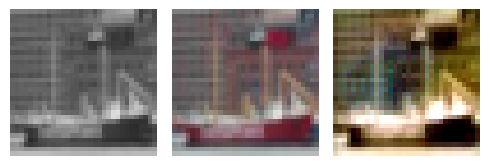

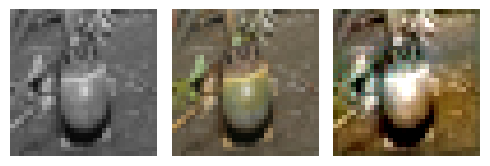

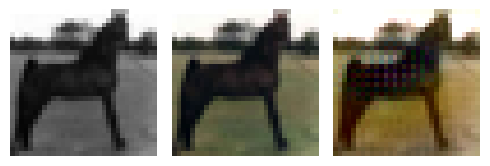

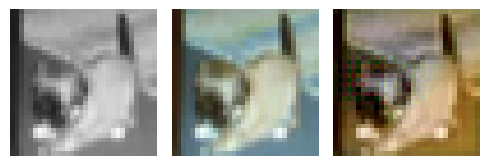

EPOCH: 68.760  trn_loss: 0.004  (5275.86s - 2396.98s remaining)

EPOCH: 68.765  trn_loss: 0.005  (5276.23s - 2396.58s remaining)

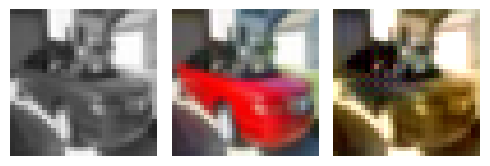

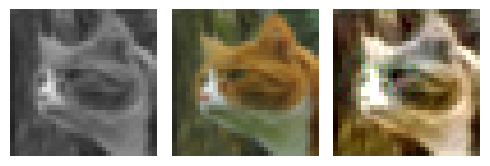

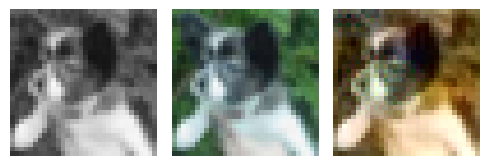

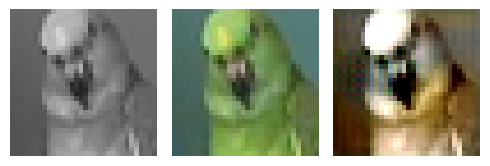

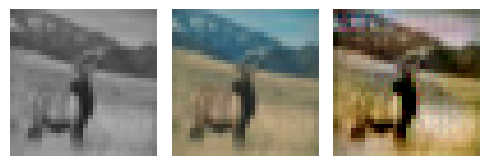

EPOCH: 68.975  val_loss: 0.005  (5301.05s - 2384.42s remaining)

EPOCH: 69.000  val_loss: 0.003  (5301.07s - 2381.64s remaining)

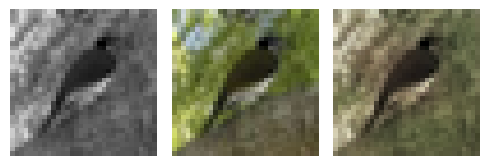

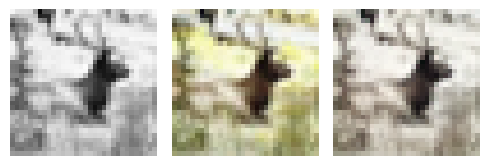

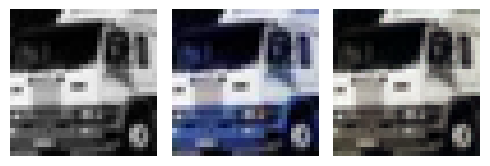

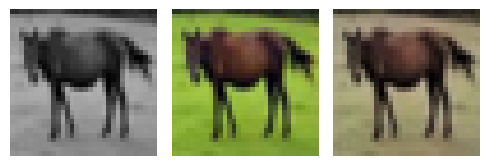

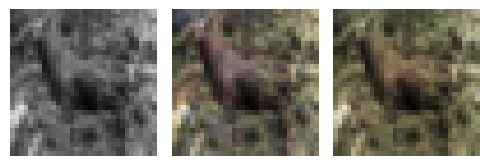

EPOCH: 69.250  trn_loss: 0.005  (5319.10s - 2361.91s remaining)

EPOCH: 69.255  trn_loss: 0.004  (5319.47s - 2361.51s remaining)

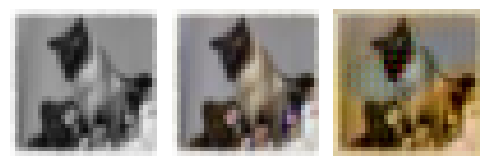

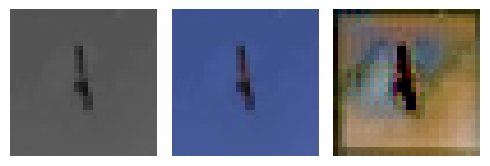

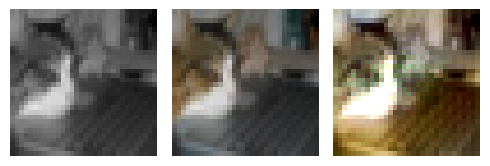

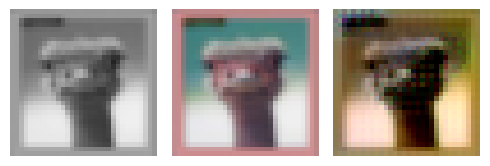

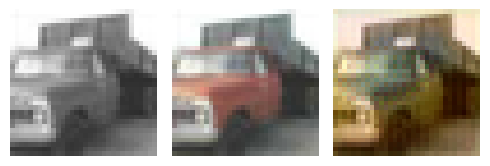

EPOCH: 69.505  trn_loss: 0.004  (5338.02s - 2342.02s remaining)

EPOCH: 69.510  trn_loss: 0.004  (5338.38s - 2341.62s remaining)

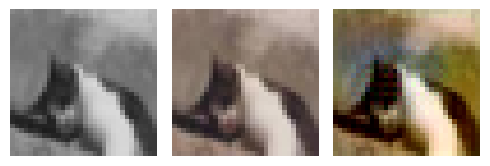

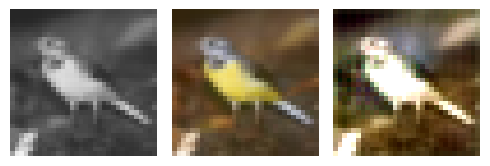

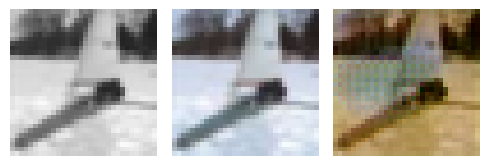

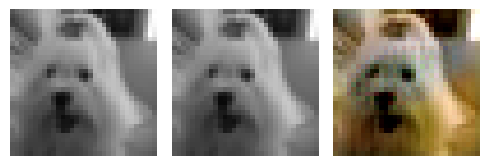

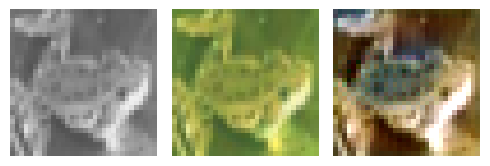

EPOCH: 69.760  trn_loss: 0.005  (5356.49s - 2321.94s remaining)

EPOCH: 69.765  trn_loss: 0.005  (5356.86s - 2321.54s remaining)

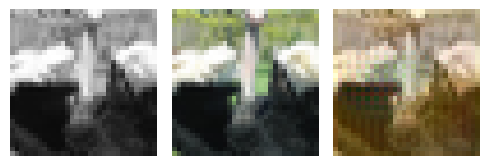

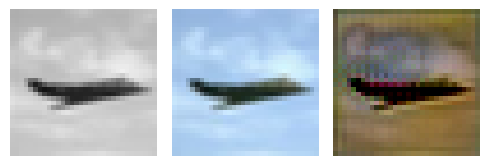

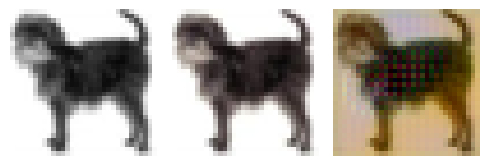

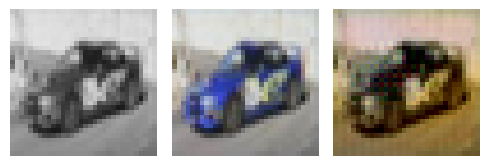

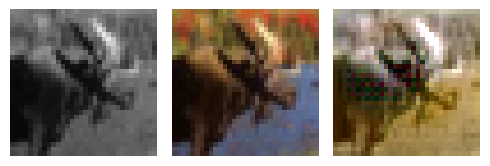

EPOCH: 69.975  val_loss: 0.005  (5381.59s - 2309.14s remaining)

EPOCH: 70.000  trn_loss: 0.005  val_loss: 0.005  (5381.62s - 2306.41s remaining)


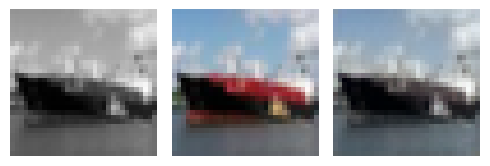

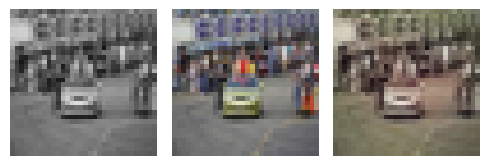

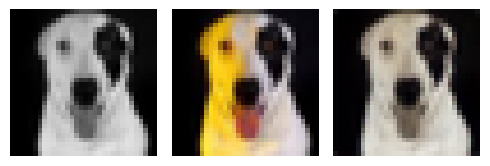

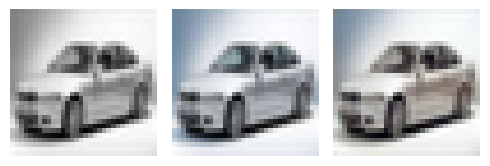

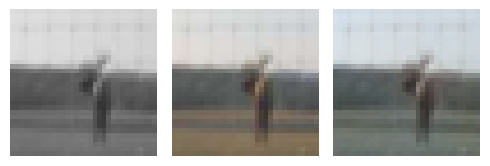

EPOCH: 70.250  trn_loss: 0.005  (5399.84s - 2286.76s remaining)

EPOCH: 70.255  trn_loss: 0.004  (5400.21s - 2286.36s remaining)

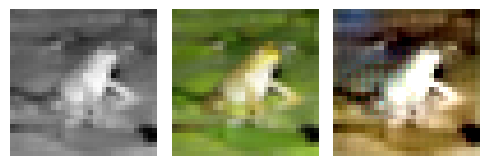

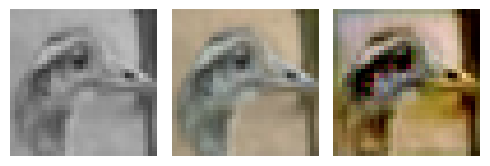

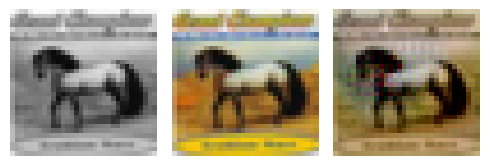

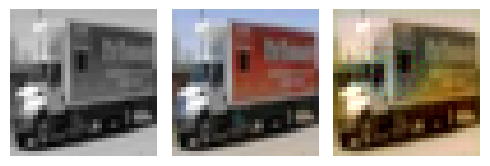

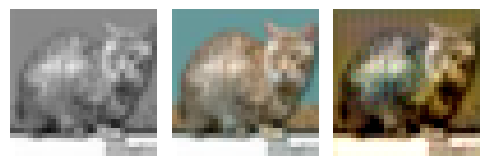

EPOCH: 70.505  trn_loss: 0.005  (5418.79s - 2266.88s remaining)

EPOCH: 70.510  trn_loss: 0.004  (5419.13s - 2266.47s remaining)

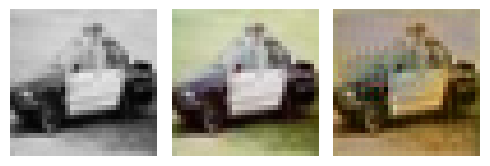

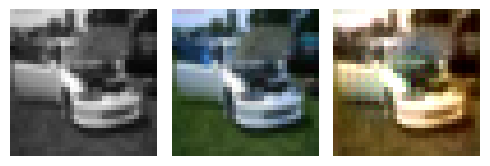

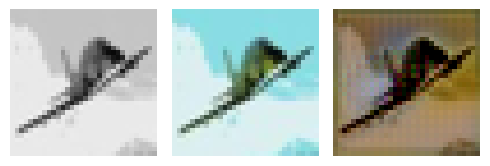

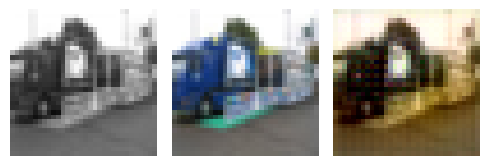

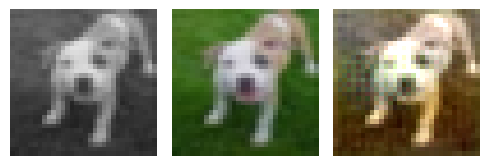

EPOCH: 70.760  trn_loss: 0.005  (5437.67s - 2246.97s remaining)

EPOCH: 70.765  trn_loss: 0.005  (5438.02s - 2246.56s remaining)

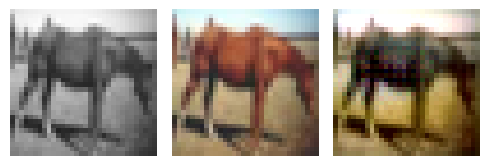

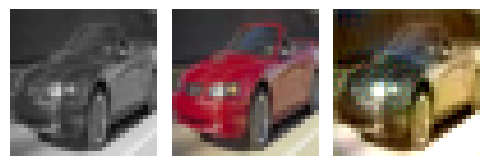

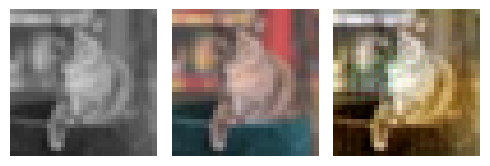

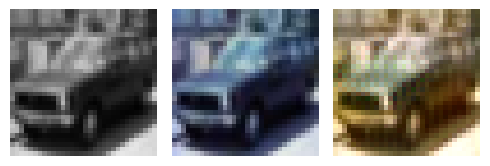

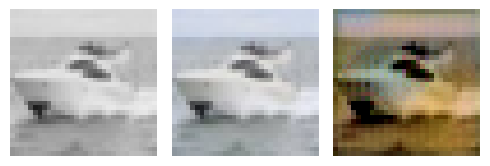

EPOCH: 71.000  val_loss: 0.003  (5462.92s - 2231.33s remaining)

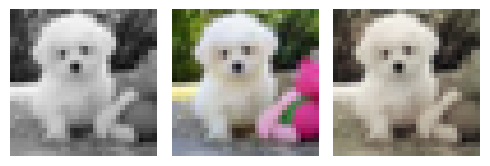

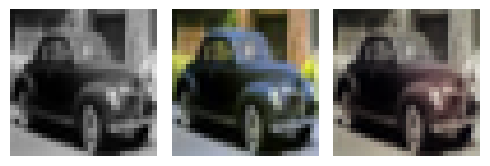

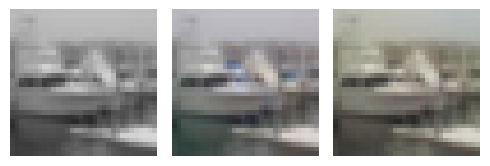

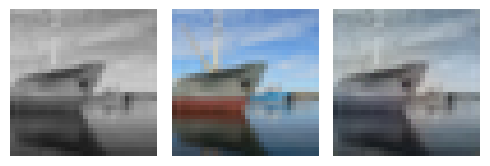

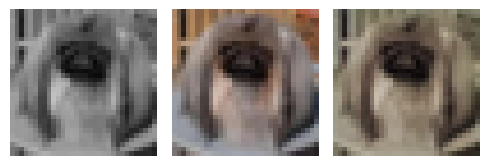

EPOCH: 71.250  trn_loss: 0.004  (5481.18s - 2211.71s remaining)

EPOCH: 71.255  trn_loss: 0.005  (5481.53s - 2211.29s remaining)

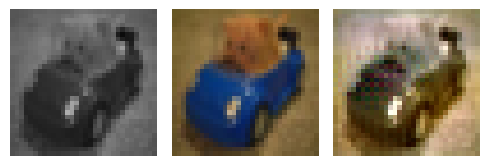

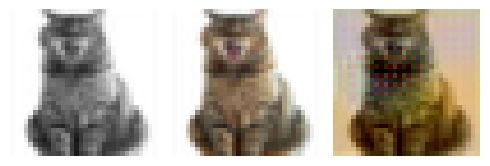

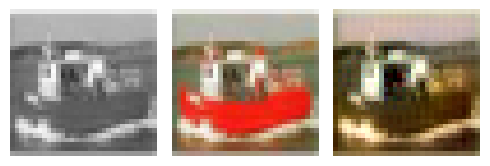

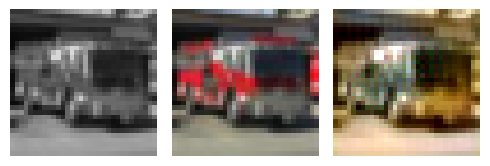

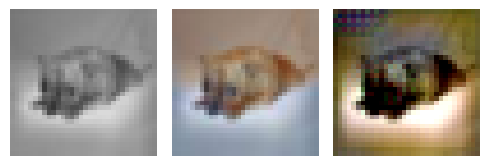

EPOCH: 71.505  trn_loss: 0.004  (5499.97s - 2191.75s remaining)

EPOCH: 71.510  trn_loss: 0.004  (5500.32s - 2191.34s remaining)

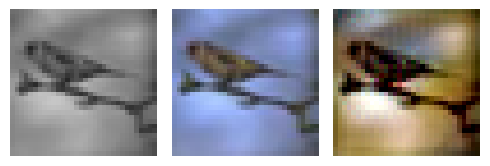

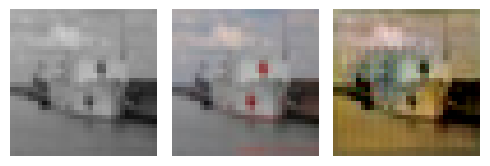

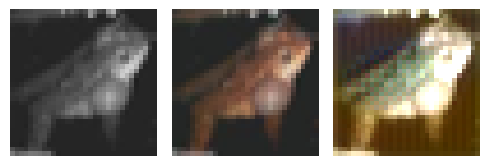

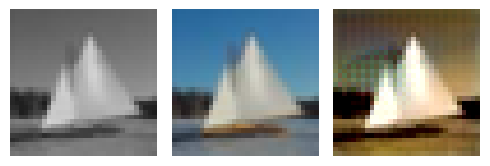

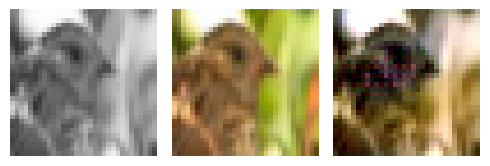

EPOCH: 71.760  trn_loss: 0.004  (5518.56s - 2171.72s remaining)

EPOCH: 71.765  trn_loss: 0.004  (5518.93s - 2171.32s remaining)

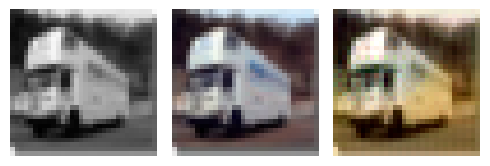

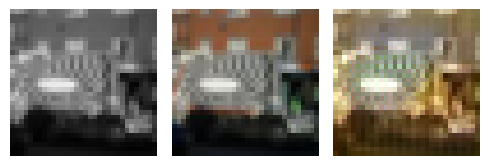

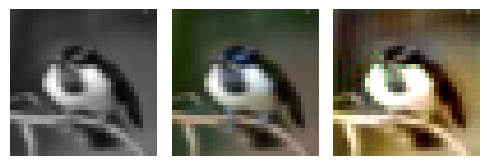

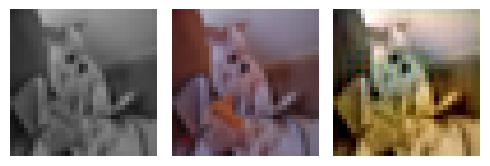

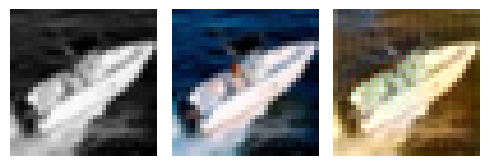

EPOCH: 72.000  val_loss: 0.003  (5543.77s - 2155.91s remaining)

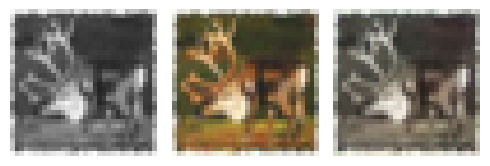

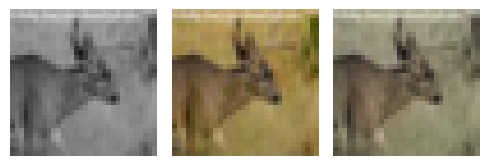

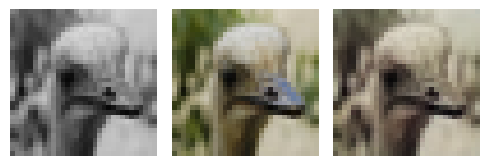

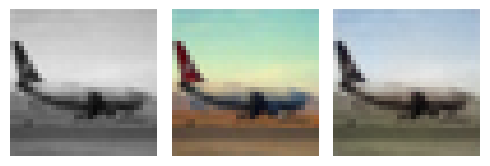

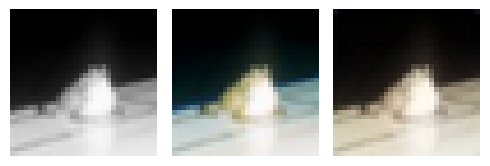

EPOCH: 72.250  trn_loss: 0.005  (5561.96s - 2136.25s remaining)

EPOCH: 72.255  trn_loss: 0.004  (5562.32s - 2135.85s remaining)

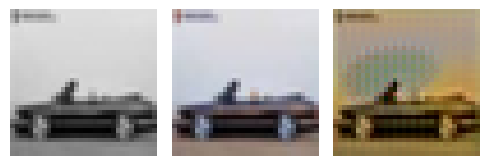

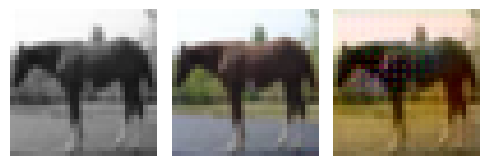

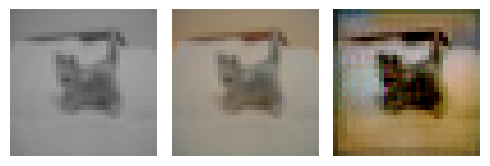

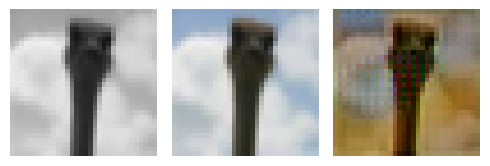

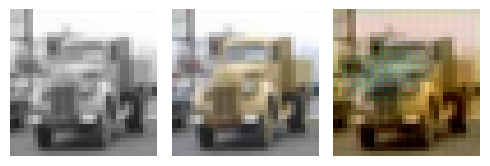

EPOCH: 72.505  trn_loss: 0.004  (5580.94s - 2116.37s remaining)

EPOCH: 72.510  trn_loss: 0.004  (5581.29s - 2115.96s remaining)

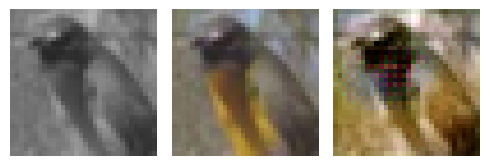

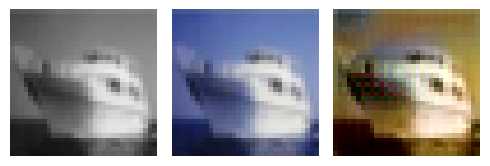

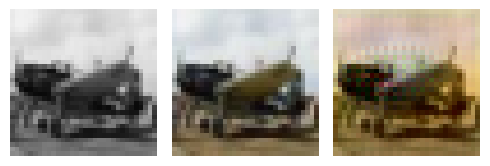

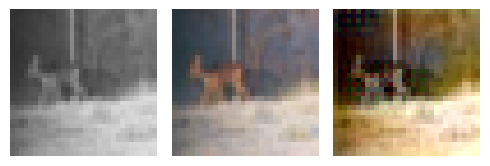

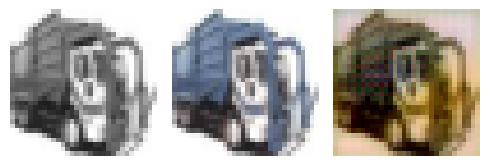

EPOCH: 72.760  trn_loss: 0.005  (5599.60s - 2096.37s remaining)

EPOCH: 72.765  trn_loss: 0.005  (5599.95s - 2095.96s remaining)

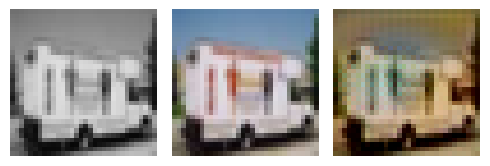

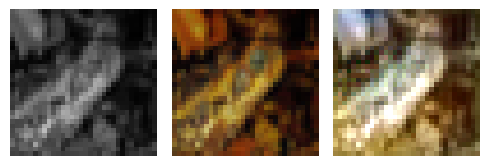

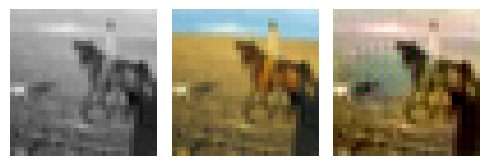

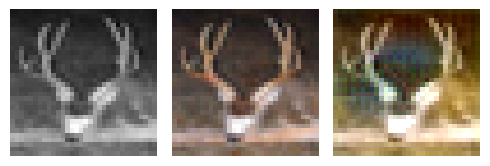

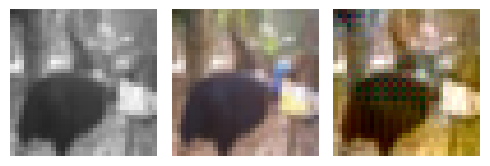

EPOCH: 73.000  val_loss: 0.003  (5624.78s - 2080.40s remaining)

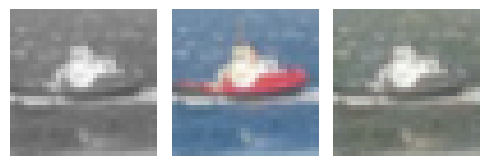

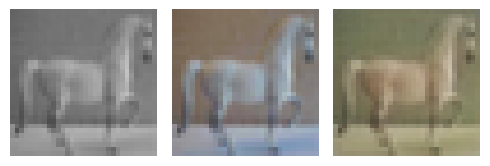

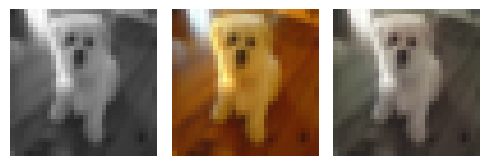

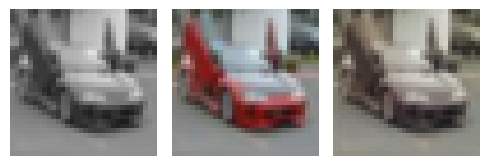

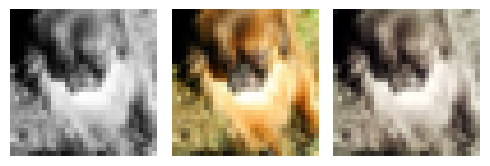

EPOCH: 73.250  trn_loss: 0.005  (5642.92s - 2060.73s remaining)

EPOCH: 73.255  trn_loss: 0.004  (5643.30s - 2060.33s remaining)

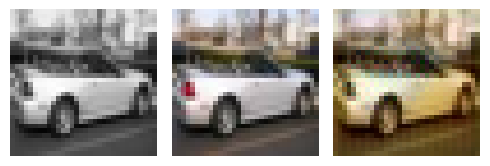

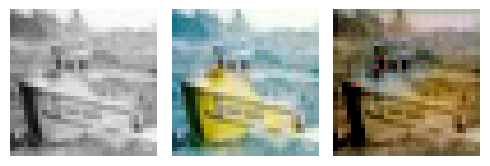

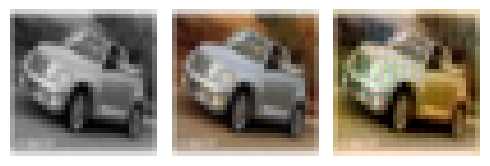

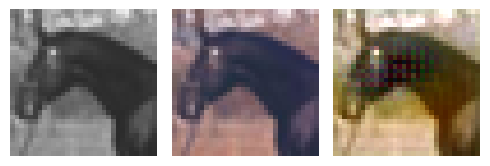

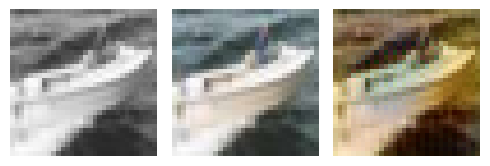

EPOCH: 73.505  trn_loss: 0.004  (5661.63s - 2040.73s remaining)

EPOCH: 73.510  trn_loss: 0.005  (5661.99s - 2040.33s remaining)

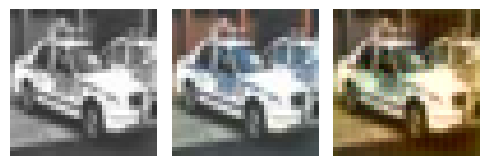

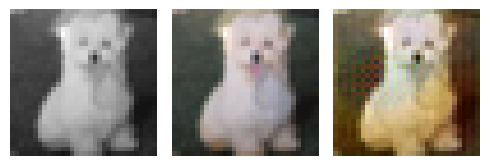

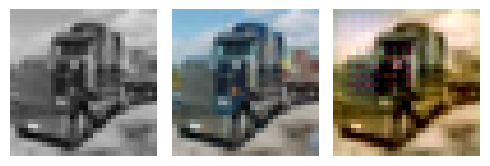

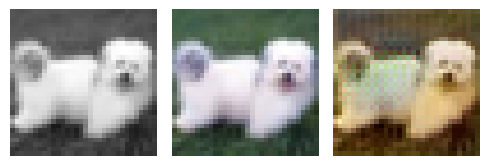

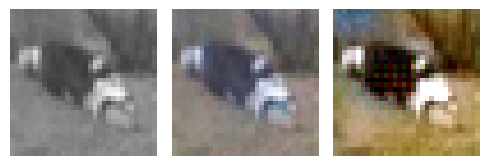

EPOCH: 73.760  trn_loss: 0.004  (5680.41s - 2020.77s remaining)

EPOCH: 73.765  trn_loss: 0.005  (5680.76s - 2020.37s remaining)

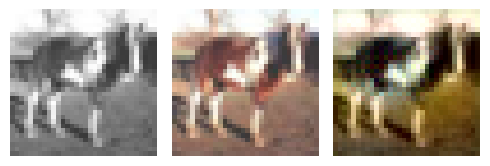

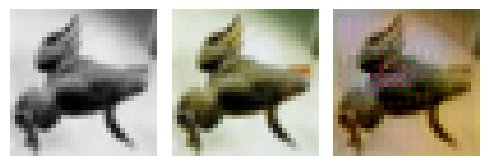

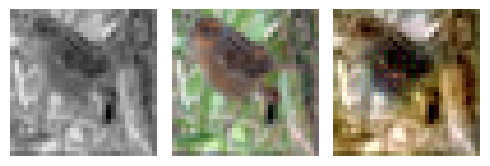

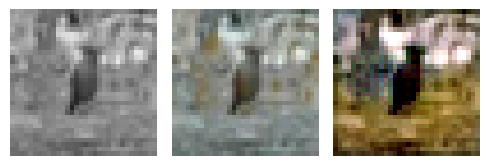

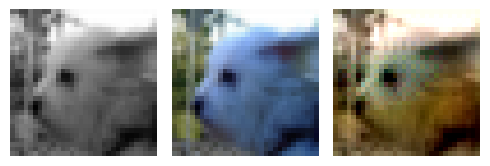

EPOCH: 74.000  val_loss: 0.003  (5705.49s - 2004.63s remaining)

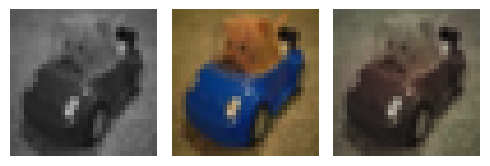

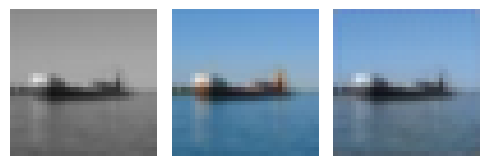

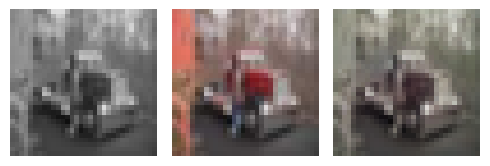

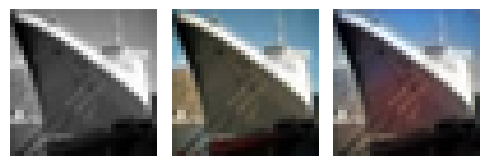

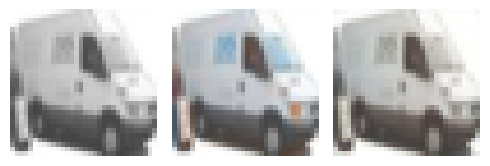

EPOCH: 74.250  trn_loss: 0.005  (5723.76s - 1985.01s remaining)

EPOCH: 74.255  trn_loss: 0.004  (5724.10s - 1984.60s remaining)

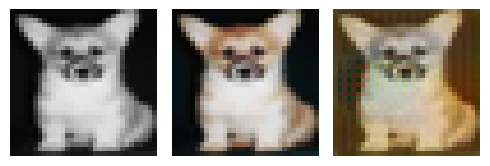

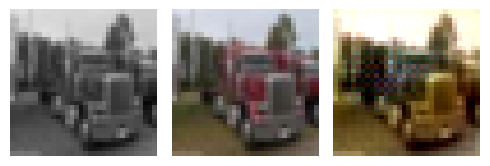

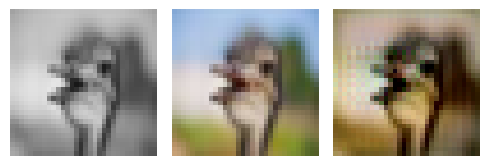

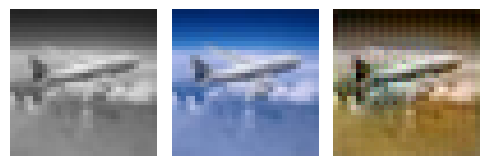

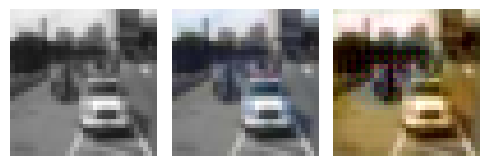

EPOCH: 74.505  trn_loss: 0.005  (5742.24s - 1964.94s remaining)

EPOCH: 74.510  trn_loss: 0.005  (5742.59s - 1964.53s remaining)

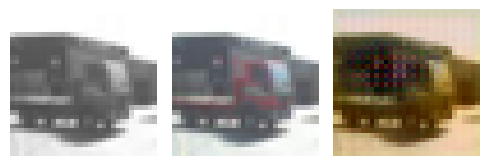

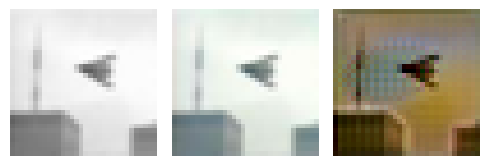

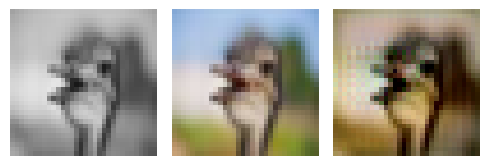

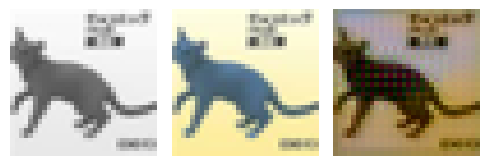

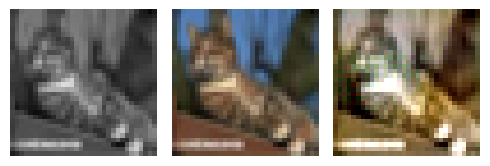

EPOCH: 74.760  trn_loss: 0.005  (5761.10s - 1945.01s remaining)

EPOCH: 74.765  trn_loss: 0.004  (5761.45s - 1944.60s remaining)

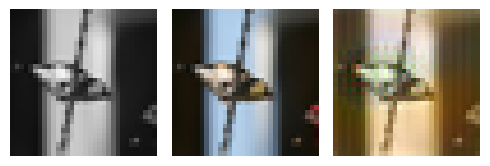

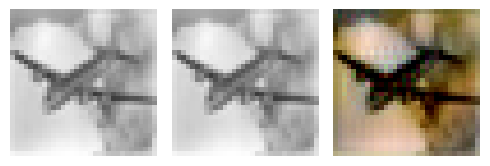

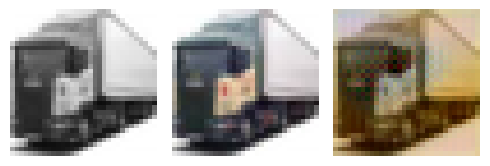

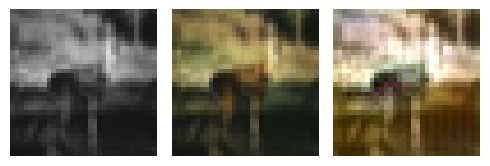

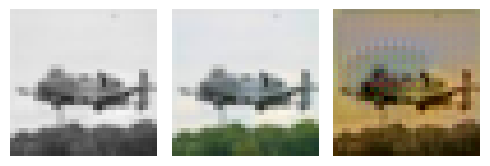

EPOCH: 75.000  trn_loss: 0.005  val_loss: 0.005  (5786.56s - 1928.85s remaining)


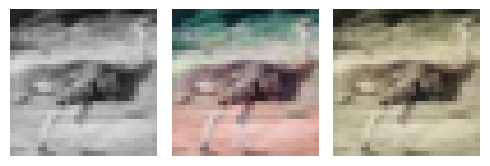

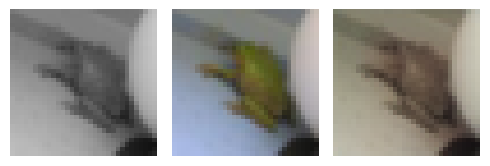

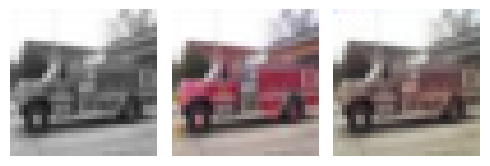

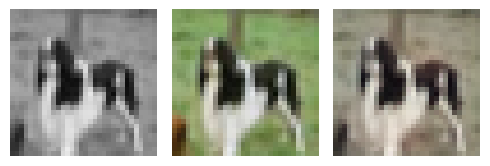

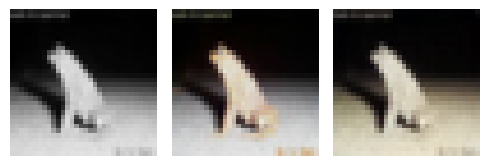

EPOCH: 75.250  trn_loss: 0.005  (5804.80s - 1909.22s remaining)

EPOCH: 75.255  trn_loss: 0.004  (5805.16s - 1908.81s remaining)

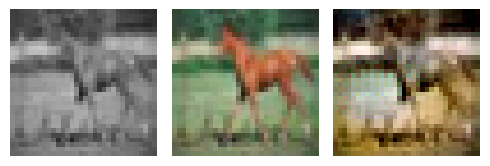

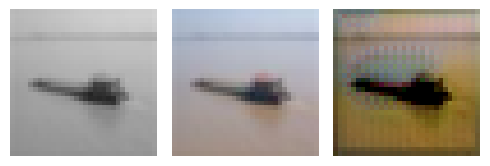

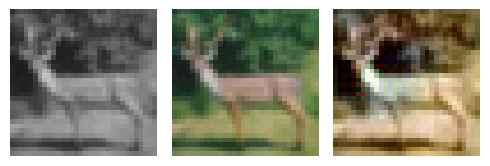

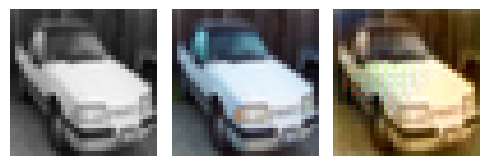

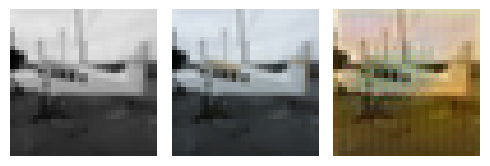

EPOCH: 75.505  trn_loss: 0.005  (5823.41s - 1889.19s remaining)

EPOCH: 75.510  trn_loss: 0.005  (5823.76s - 1888.79s remaining)

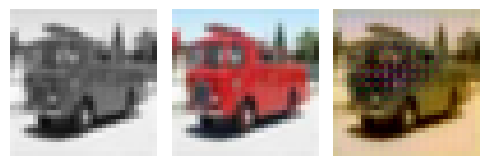

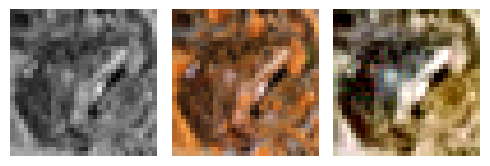

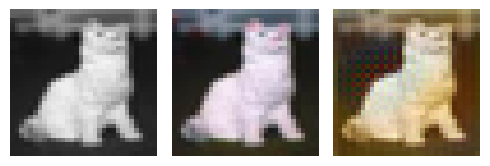

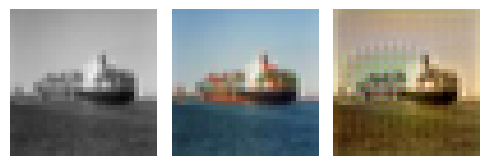

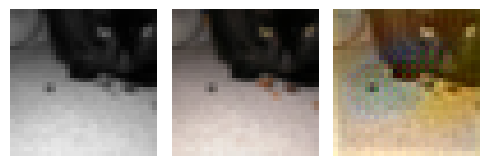

EPOCH: 75.760  trn_loss: 0.005  (5842.34s - 1869.28s remaining)

EPOCH: 75.765  trn_loss: 0.004  (5842.71s - 1868.88s remaining)

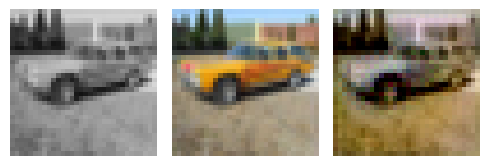

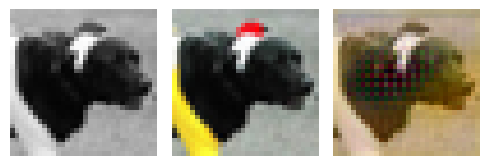

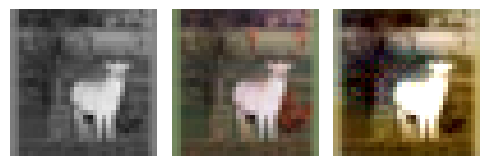

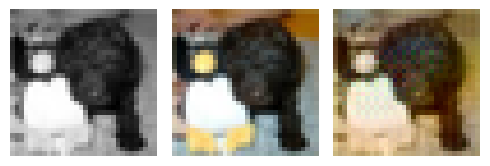

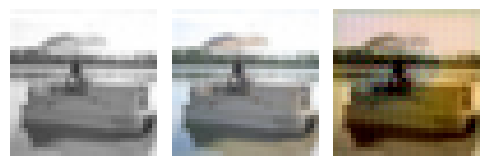

EPOCH: 75.975  val_loss: 0.005  (5867.28s - 1855.37s remaining)

EPOCH: 76.000  val_loss: 0.003  (5867.30s - 1852.83s remaining)

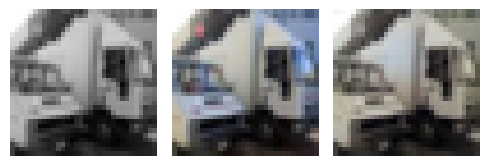

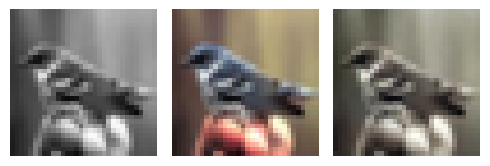

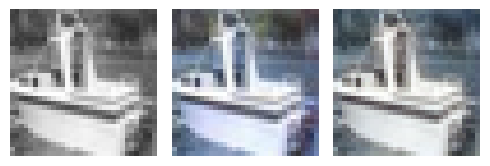

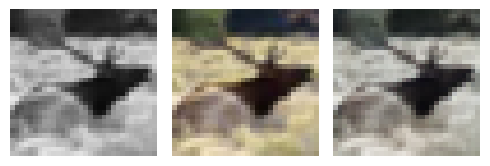

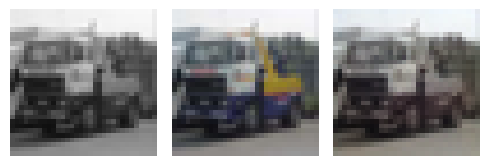

EPOCH: 76.250  trn_loss: 0.004  (5885.39s - 1833.15s remaining)

EPOCH: 76.255  trn_loss: 0.004  (5885.73s - 1832.75s remaining)

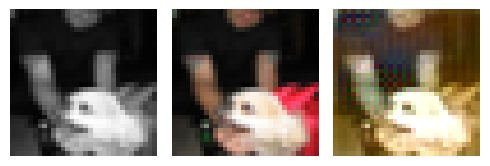

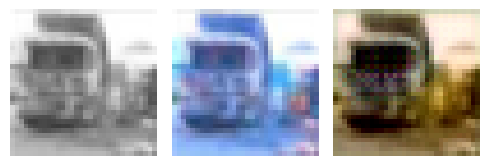

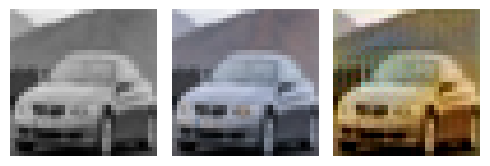

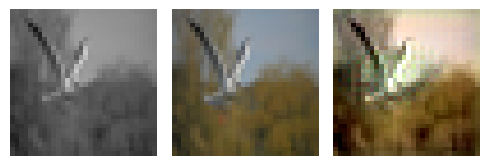

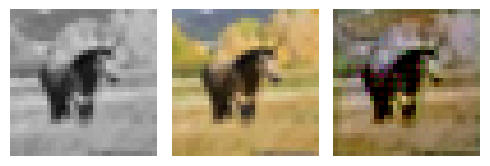

EPOCH: 76.505  trn_loss: 0.004  (5903.88s - 1813.09s remaining)

EPOCH: 76.510  trn_loss: 0.004  (5904.25s - 1812.70s remaining)

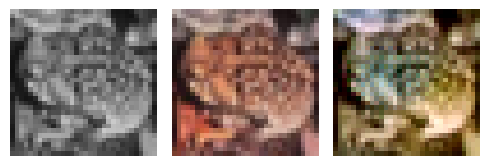

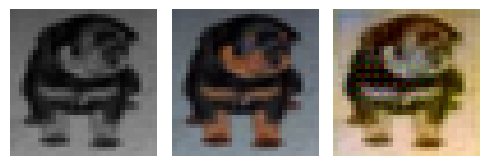

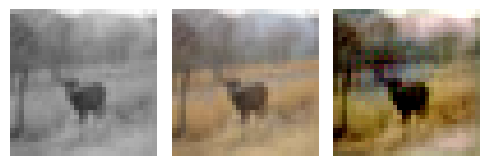

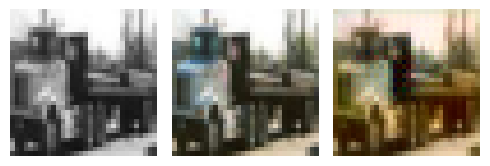

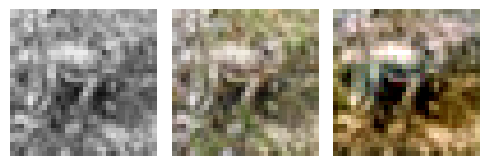

EPOCH: 76.760  trn_loss: 0.004  (5922.82s - 1793.18s remaining)

EPOCH: 76.765  trn_loss: 0.004  (5923.16s - 1792.77s remaining)

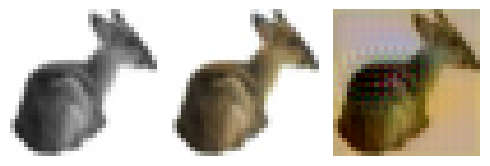

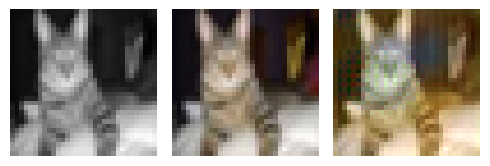

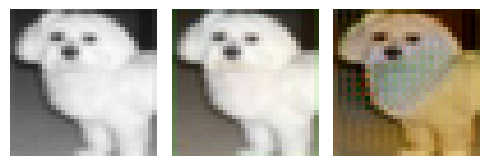

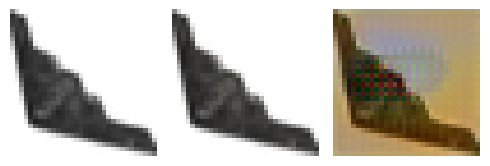

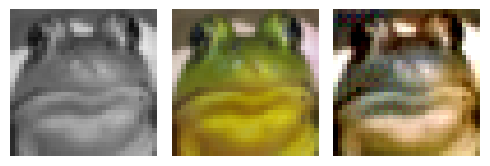

EPOCH: 77.000  val_loss: 0.003  (5947.94s - 1776.66s remaining)

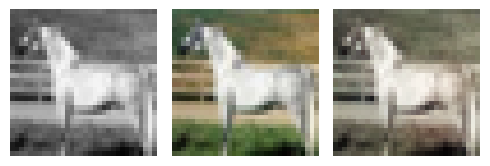

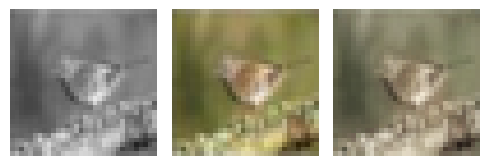

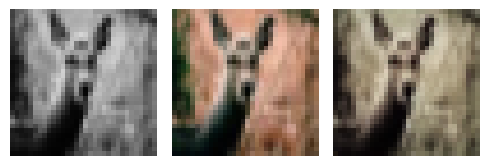

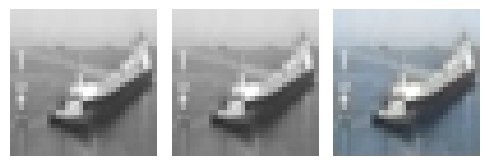

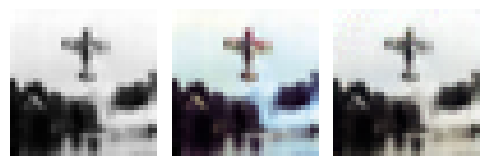

EPOCH: 77.250  trn_loss: 0.004  (5966.13s - 1757.02s remaining)

EPOCH: 77.255  trn_loss: 0.005  (5966.51s - 1756.62s remaining)

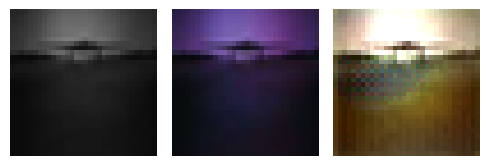

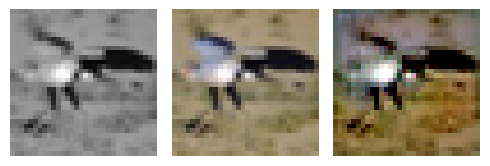

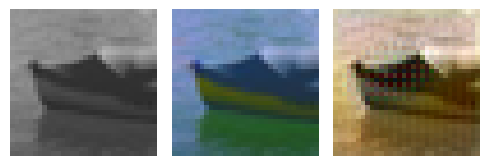

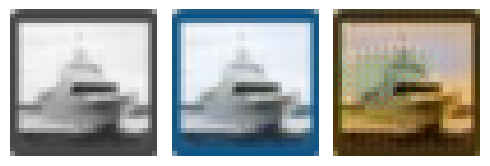

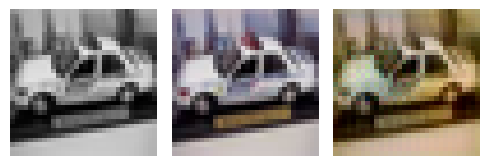

EPOCH: 77.505  trn_loss: 0.004  (5984.70s - 1736.99s remaining)

EPOCH: 77.510  trn_loss: 0.005  (5985.05s - 1736.58s remaining)

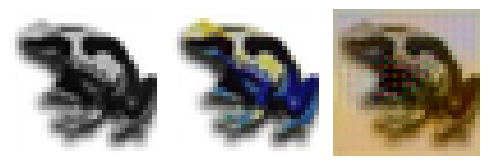

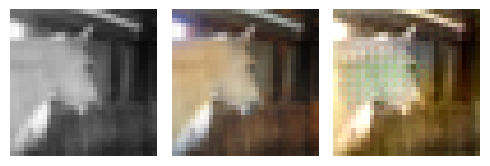

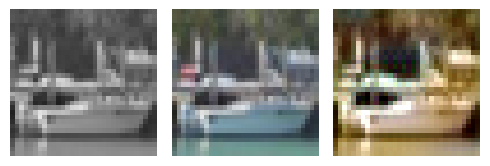

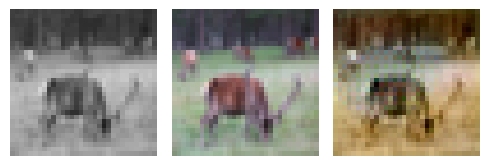

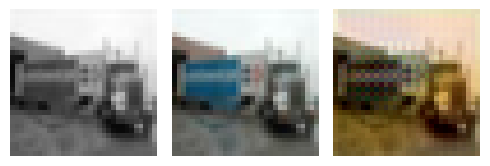

EPOCH: 77.760  trn_loss: 0.004  (6003.52s - 1717.04s remaining)

EPOCH: 77.765  trn_loss: 0.005  (6003.87s - 1716.63s remaining)

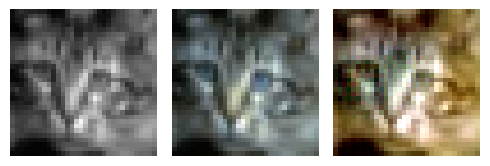

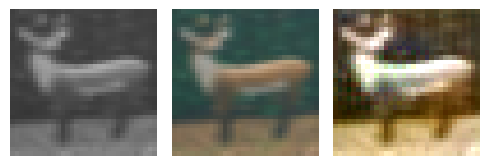

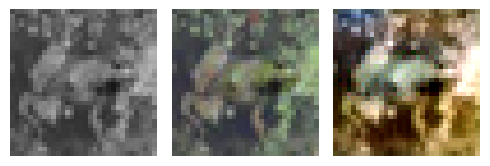

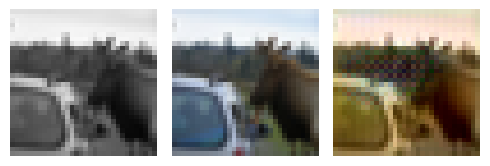

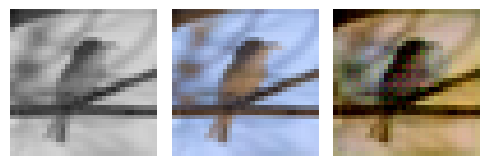

EPOCH: 77.950  val_loss: 0.005  (6028.41s - 1705.28s remaining)

EPOCH: 78.000  val_loss: 0.003  (6028.64s - 1700.38s remaining)

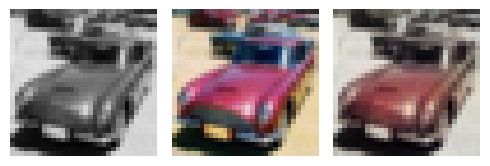

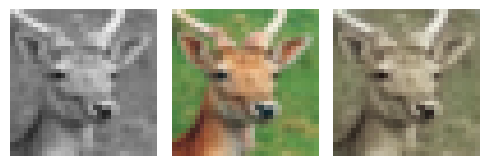

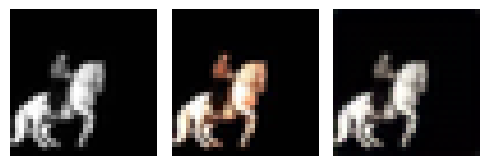

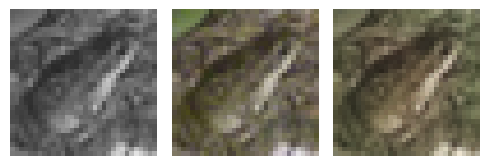

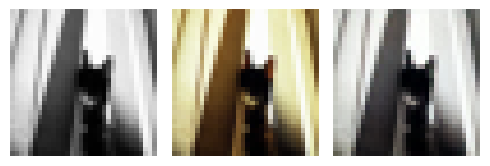

EPOCH: 78.250  trn_loss: 0.005  (6046.84s - 1680.75s remaining)

EPOCH: 78.255  trn_loss: 0.005  (6047.20s - 1680.35s remaining)

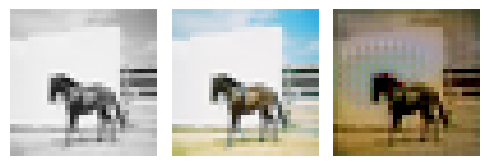

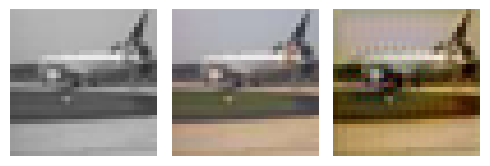

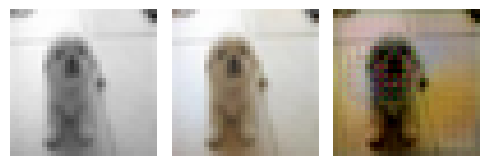

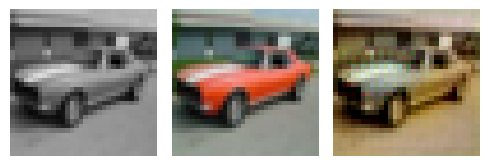

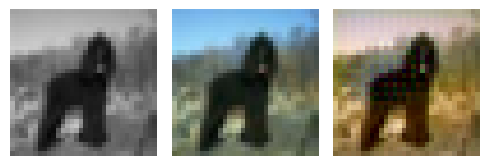

EPOCH: 78.505  trn_loss: 0.005  (6065.40s - 1660.72s remaining)

EPOCH: 78.510  trn_loss: 0.004  (6065.74s - 1660.31s remaining)

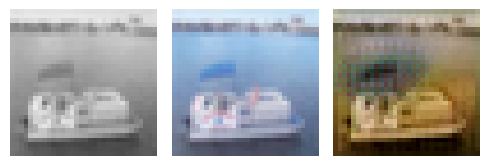

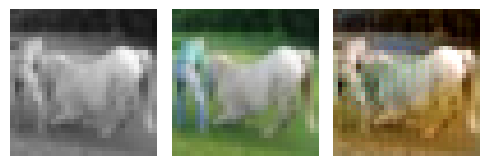

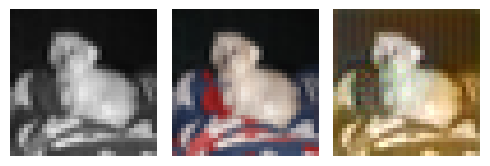

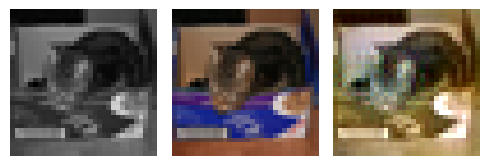

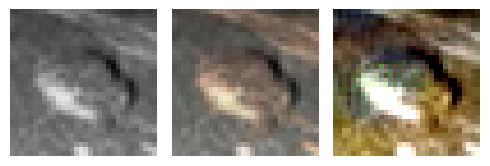

EPOCH: 78.760  trn_loss: 0.005  (6083.91s - 1640.69s remaining)

EPOCH: 78.765  trn_loss: 0.004  (6084.26s - 1640.28s remaining)

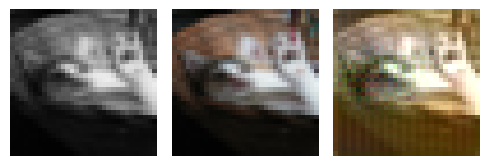

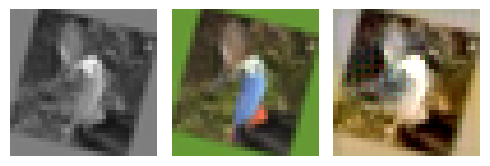

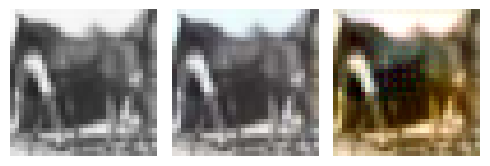

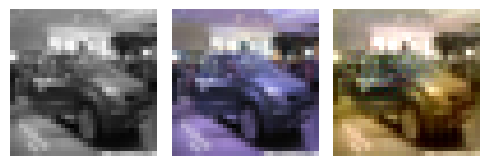

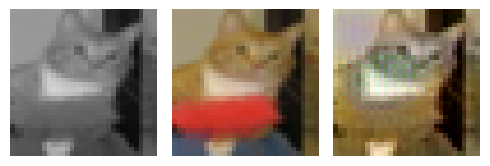

EPOCH: 79.000  val_loss: 0.003  (6109.55s - 1624.06s remaining)

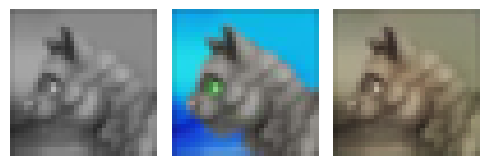

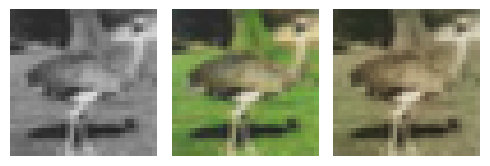

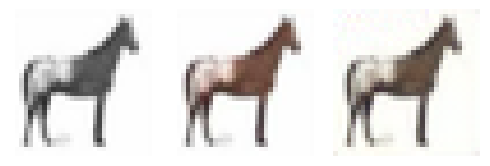

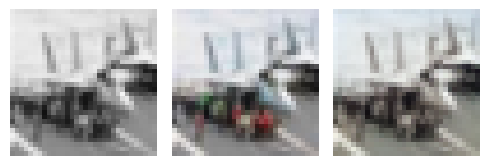

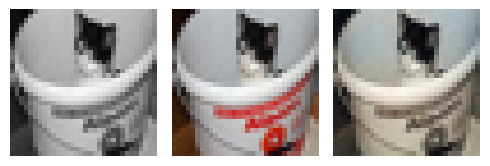

EPOCH: 79.250  trn_loss: 0.005  (6127.51s - 1604.36s remaining)

EPOCH: 79.255  trn_loss: 0.004  (6127.86s - 1603.96s remaining)

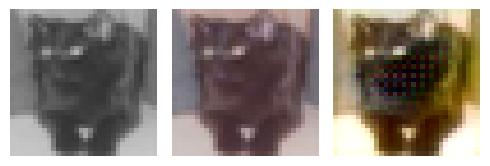

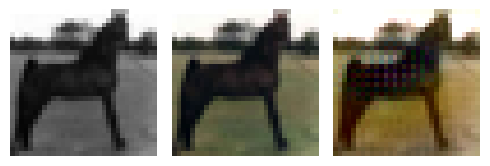

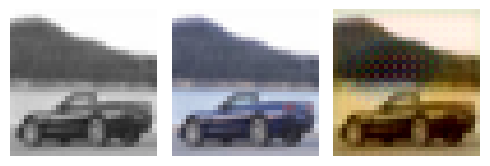

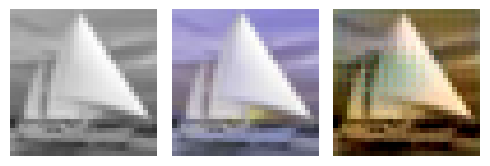

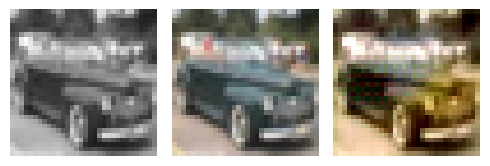

EPOCH: 79.505  trn_loss: 0.005  (6146.06s - 1584.34s remaining)

EPOCH: 79.510  trn_loss: 0.004  (6146.42s - 1583.93s remaining)

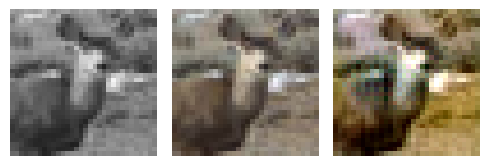

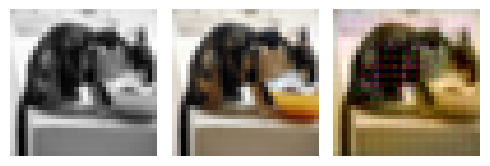

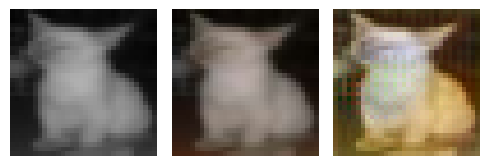

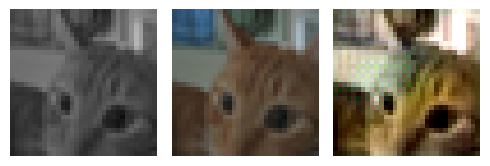

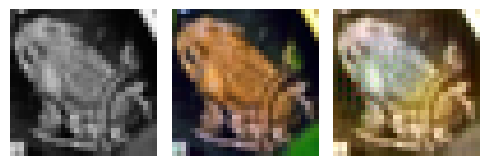

EPOCH: 79.760  trn_loss: 0.004  (6164.59s - 1564.31s remaining)

EPOCH: 79.765  trn_loss: 0.005  (6164.93s - 1563.91s remaining)

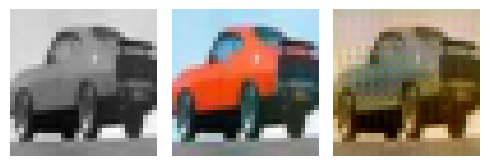

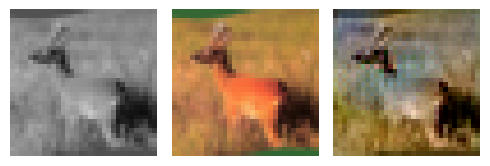

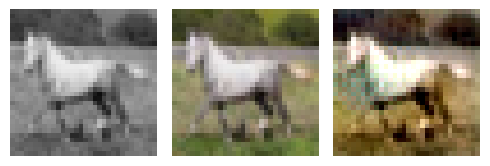

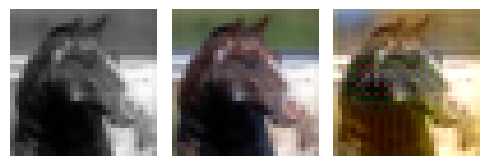

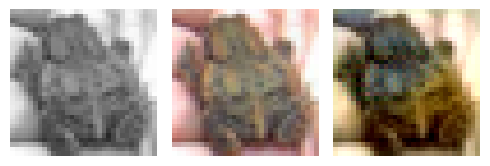

EPOCH: 80.000  trn_loss: 0.005  val_loss: 0.005  (6190.34s - 1547.59s remaining)


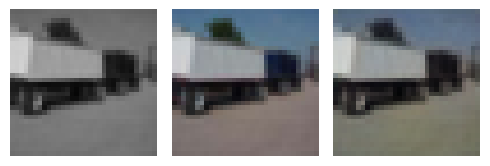

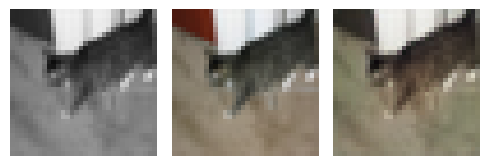

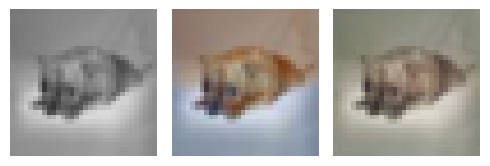

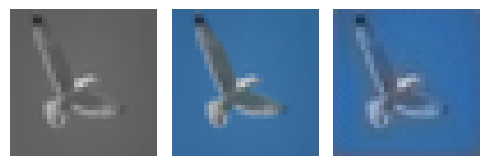

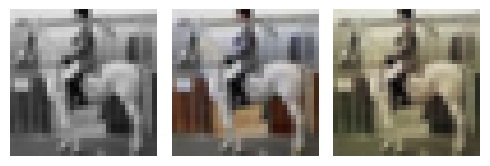

EPOCH: 80.250  trn_loss: 0.004  (6208.53s - 1527.95s remaining)

EPOCH: 80.255  trn_loss: 0.005  (6208.87s - 1527.55s remaining)

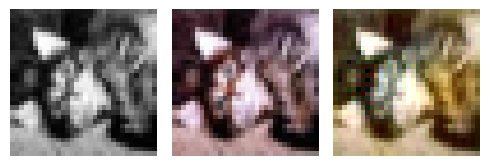

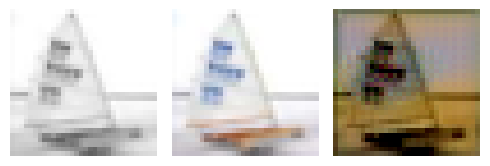

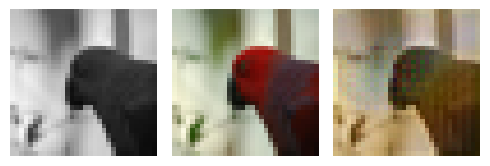

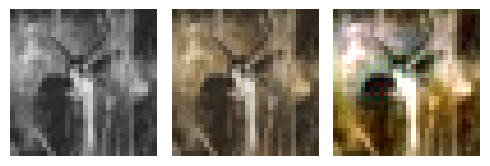

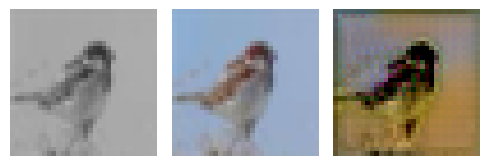

EPOCH: 80.505  trn_loss: 0.004  (6227.03s - 1507.92s remaining)

EPOCH: 80.510  trn_loss: 0.004  (6227.38s - 1507.51s remaining)

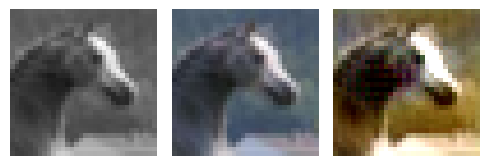

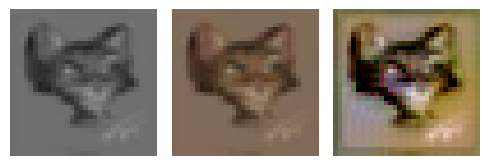

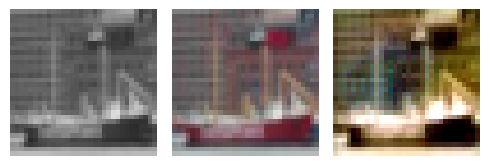

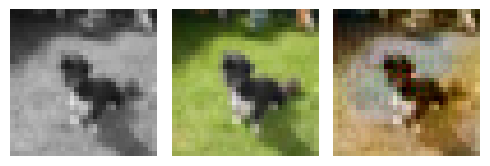

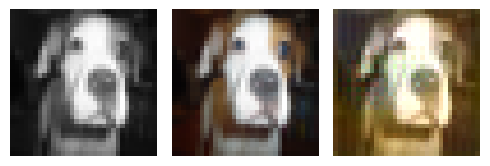

EPOCH: 80.760  trn_loss: 0.005  (6245.62s - 1487.92s remaining)

EPOCH: 80.765  trn_loss: 0.004  (6246.00s - 1487.52s remaining)

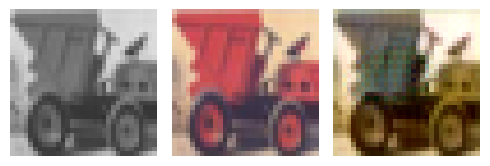

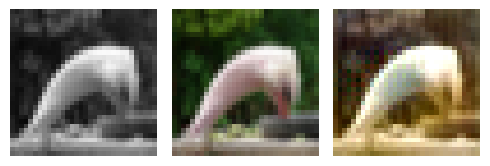

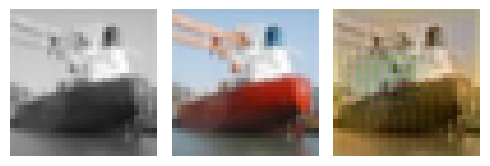

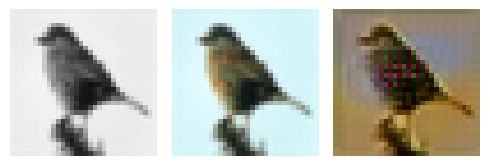

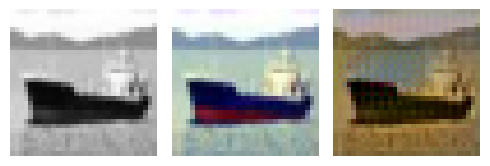

EPOCH: 80.950  val_loss: 0.005  (6270.79s - 1475.71s remaining)

EPOCH: 81.000  val_loss: 0.003  (6271.02s - 1470.98s remaining)

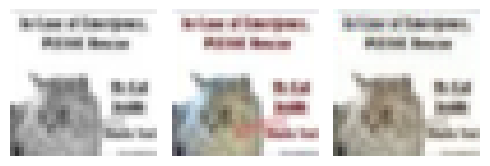

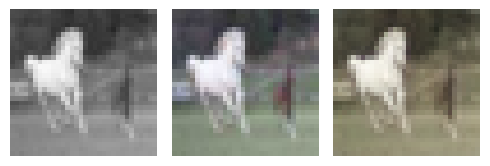

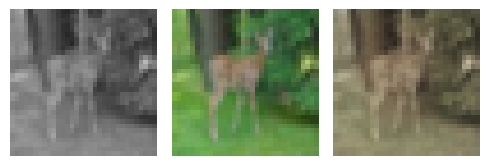

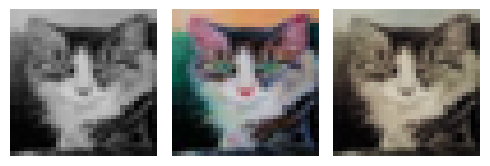

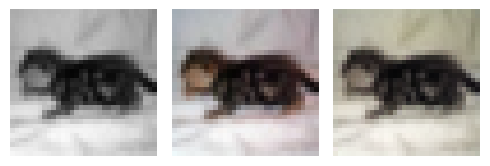

EPOCH: 81.250  trn_loss: 0.005  (6289.23s - 1451.36s remaining)

EPOCH: 81.255  trn_loss: 0.005  (6289.60s - 1450.96s remaining)

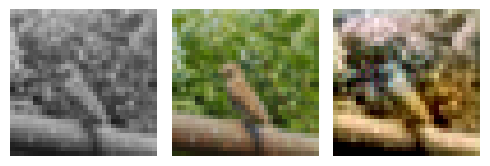

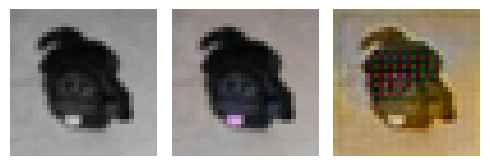

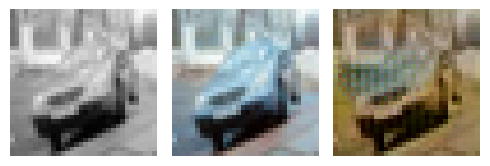

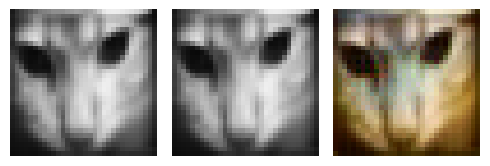

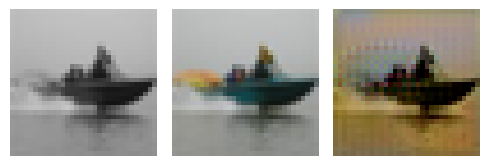

EPOCH: 81.505  trn_loss: 0.005  (6307.87s - 1431.36s remaining)

EPOCH: 81.510  trn_loss: 0.005  (6308.21s - 1430.96s remaining)

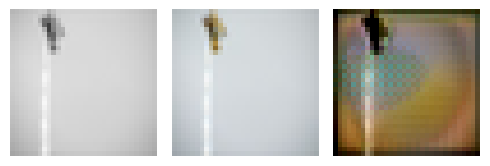

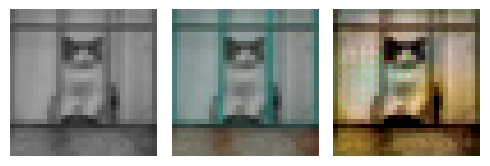

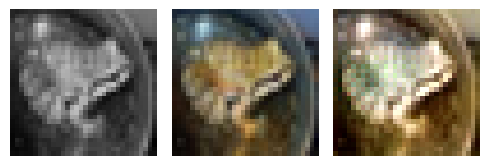

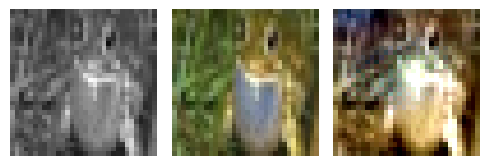

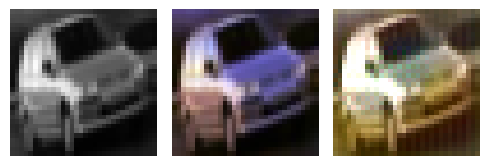

EPOCH: 81.760  trn_loss: 0.005  (6326.53s - 1411.38s remaining)

EPOCH: 81.765  trn_loss: 0.004  (6326.89s - 1410.98s remaining)

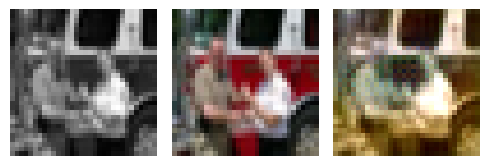

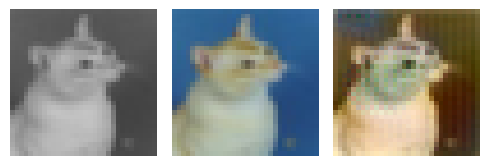

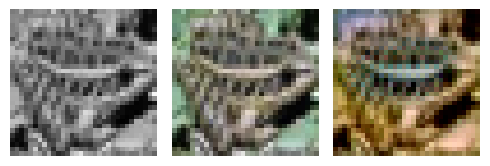

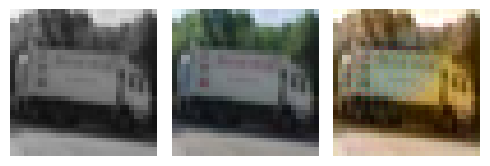

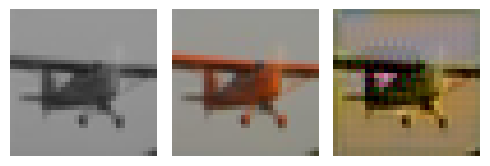

EPOCH: 82.000  val_loss: 0.003  (6351.60s - 1394.25s remaining)

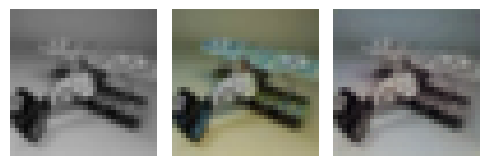

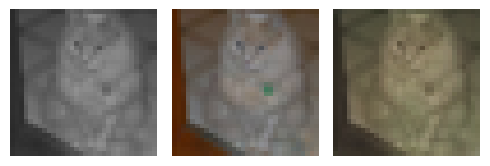

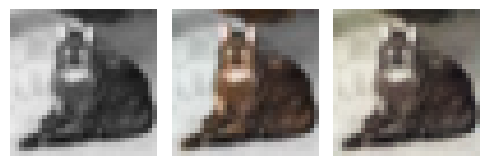

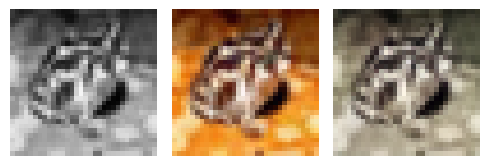

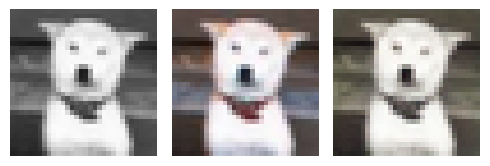

EPOCH: 82.250  trn_loss: 0.004  (6370.15s - 1374.71s remaining)

EPOCH: 82.255  trn_loss: 0.004  (6370.51s - 1374.31s remaining)

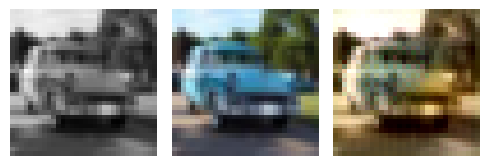

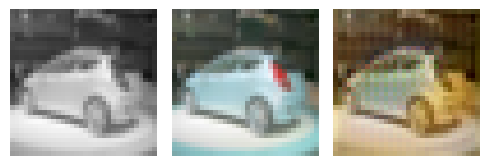

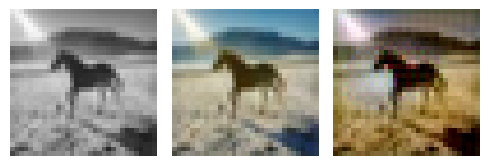

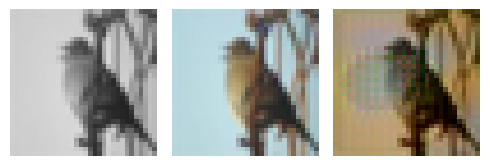

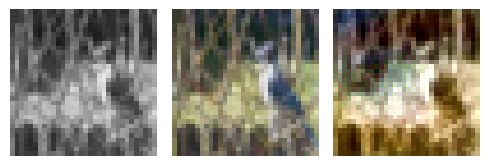

EPOCH: 82.505  trn_loss: 0.004  (6388.62s - 1354.68s remaining)

EPOCH: 82.510  trn_loss: 0.005  (6388.97s - 1354.28s remaining)

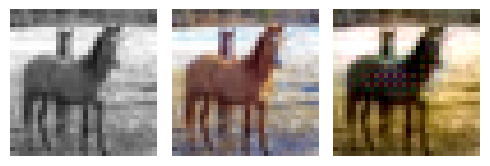

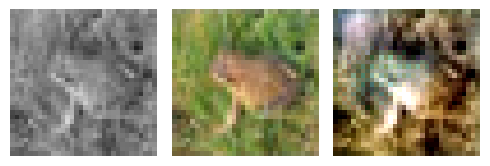

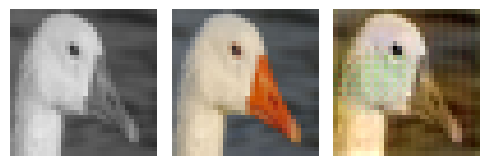

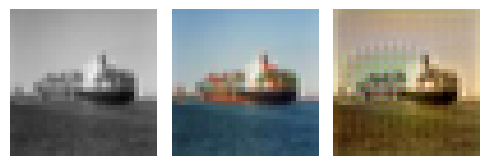

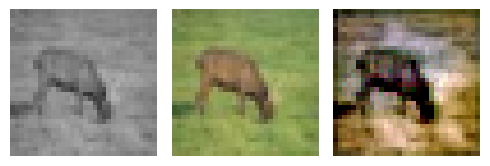

EPOCH: 82.760  trn_loss: 0.005  (6407.27s - 1334.70s remaining)

EPOCH: 82.765  trn_loss: 0.004  (6407.64s - 1334.30s remaining)

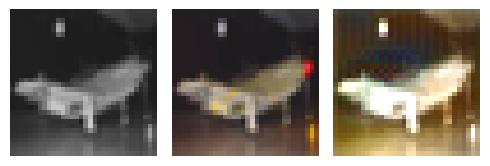

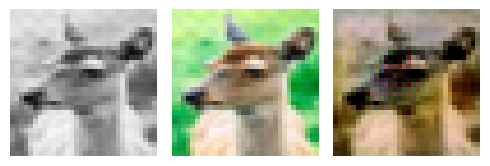

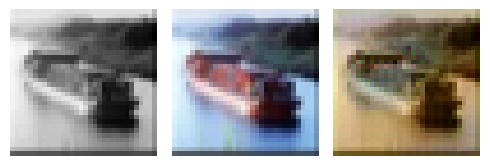

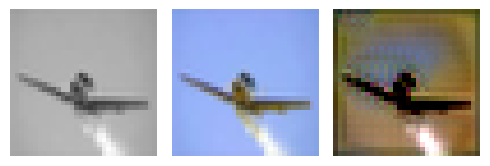

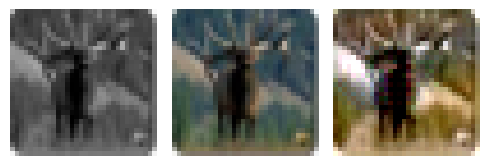

EPOCH: 83.000  val_loss: 0.003  (6432.55s - 1317.51s remaining)

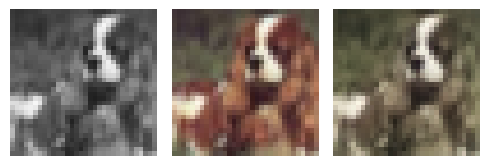

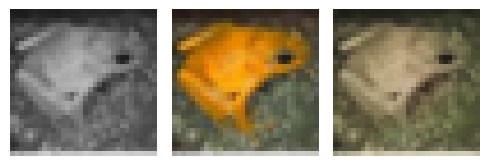

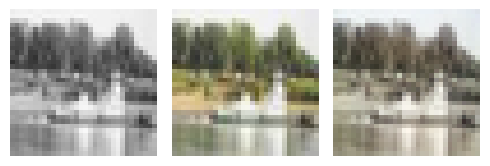

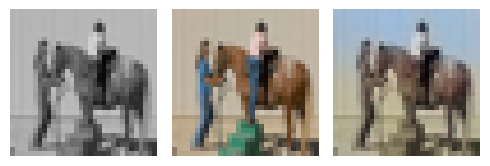

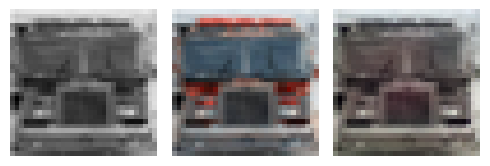

EPOCH: 83.250  trn_loss: 0.004  (6451.06s - 1297.96s remaining)

EPOCH: 83.255  trn_loss: 0.005  (6451.41s - 1297.56s remaining)

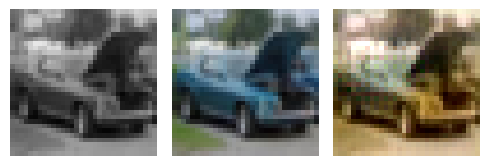

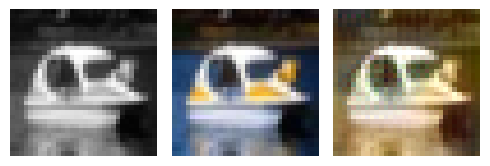

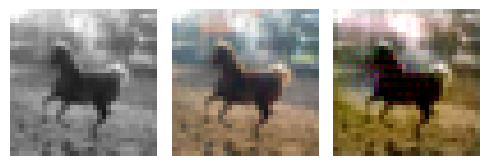

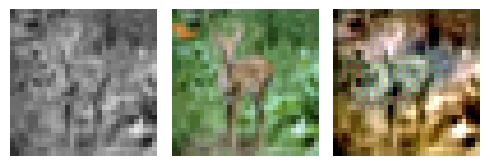

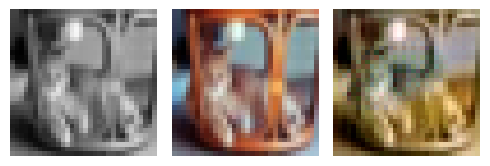

EPOCH: 83.505  trn_loss: 0.004  (6469.52s - 1277.93s remaining)

EPOCH: 83.510  trn_loss: 0.005  (6469.86s - 1277.53s remaining)

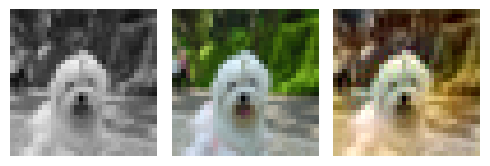

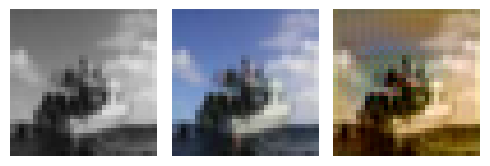

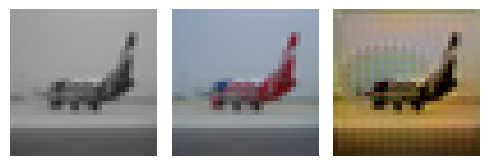

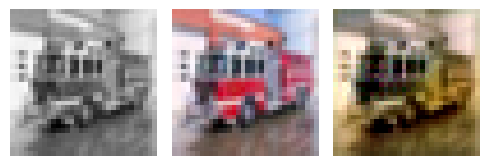

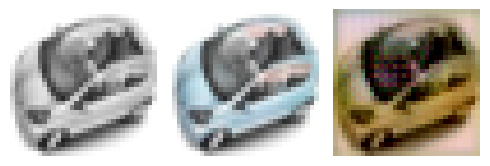

EPOCH: 83.760  trn_loss: 0.005  (6488.18s - 1257.96s remaining)

EPOCH: 83.765  trn_loss: 0.005  (6488.59s - 1257.56s remaining)

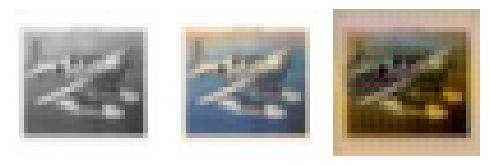

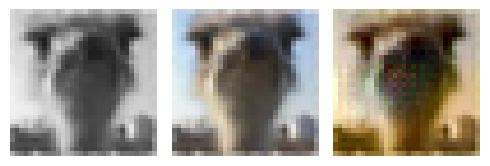

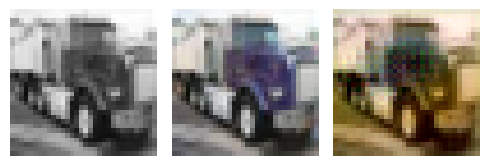

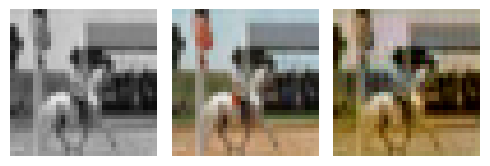

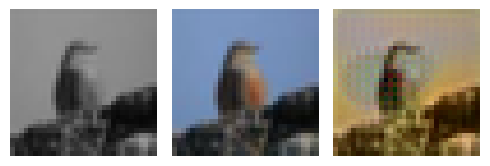

EPOCH: 84.000  val_loss: 0.003  (6513.08s - 1240.59s remaining)

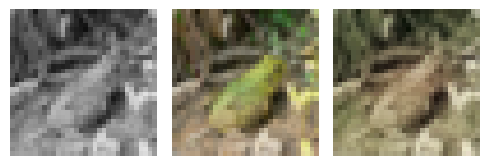

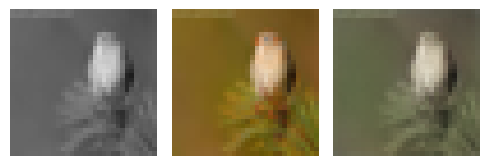

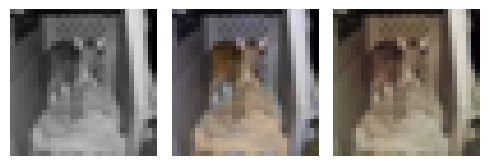

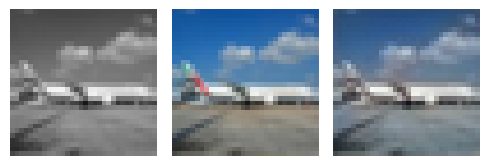

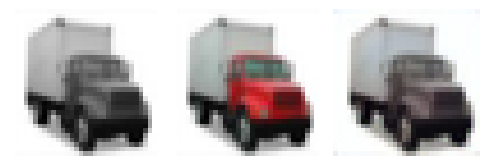

EPOCH: 84.250  trn_loss: 0.004  (6531.59s - 1221.04s remaining)

EPOCH: 84.255  trn_loss: 0.005  (6531.96s - 1220.64s remaining)

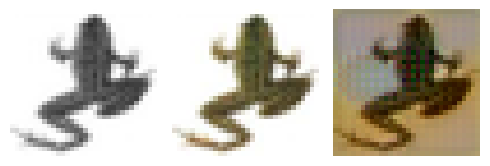

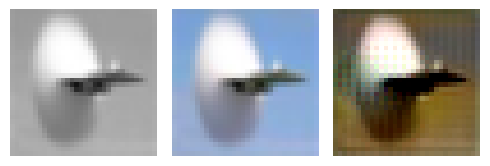

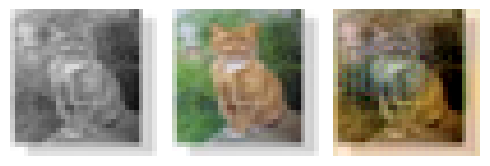

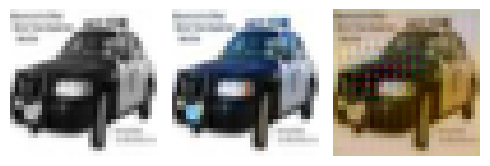

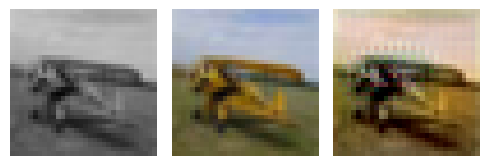

EPOCH: 84.505  trn_loss: 0.005  (6550.47s - 1201.10s remaining)

EPOCH: 84.510  trn_loss: 0.005  (6550.81s - 1200.69s remaining)

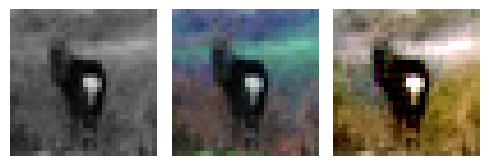

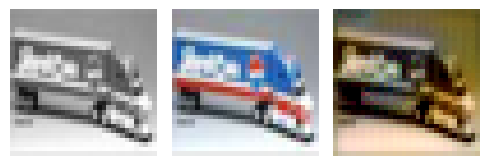

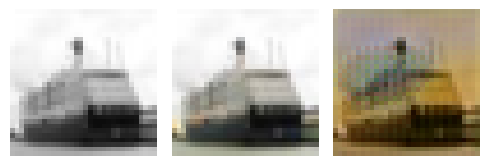

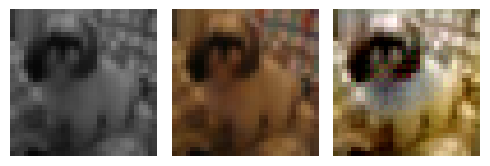

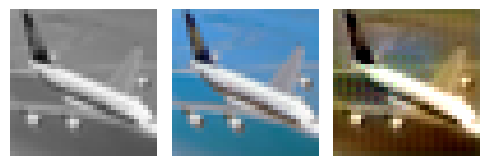

EPOCH: 84.760  trn_loss: 0.005  (6568.94s - 1181.09s remaining)

EPOCH: 84.765  trn_loss: 0.005  (6569.29s - 1180.68s remaining)

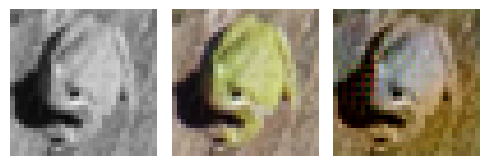

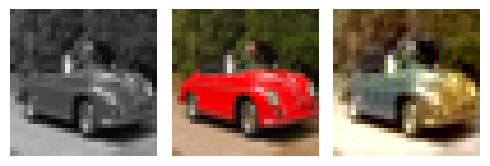

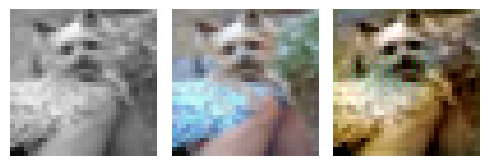

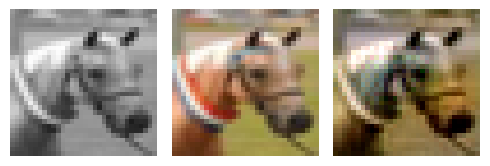

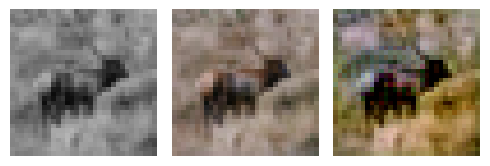

EPOCH: 85.000  trn_loss: 0.005  val_loss: 0.005  (6594.28s - 1163.70s remaining)


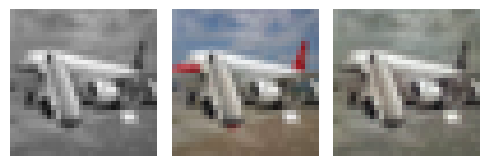

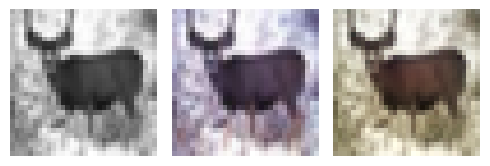

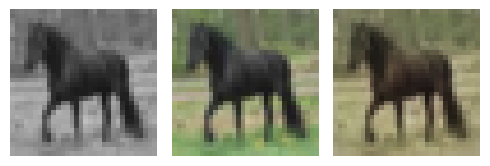

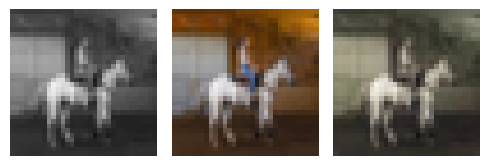

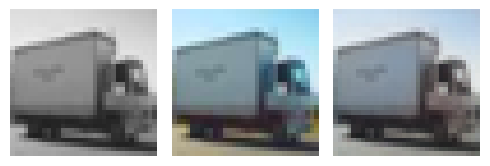

EPOCH: 85.250  trn_loss: 0.005  (6612.72s - 1144.14s remaining)

EPOCH: 85.255  trn_loss: 0.004  (6613.07s - 1143.73s remaining)

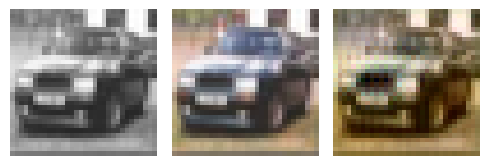

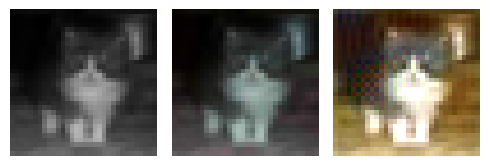

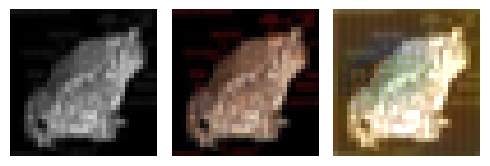

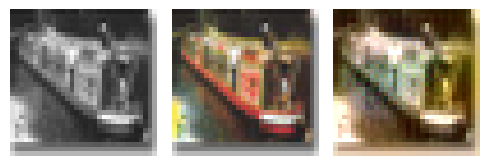

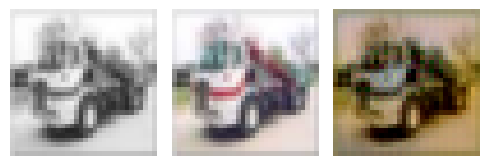

EPOCH: 85.505  trn_loss: 0.005  (6631.20s - 1124.13s remaining)

EPOCH: 85.510  trn_loss: 0.004  (6631.57s - 1123.73s remaining)

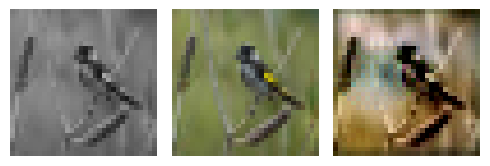

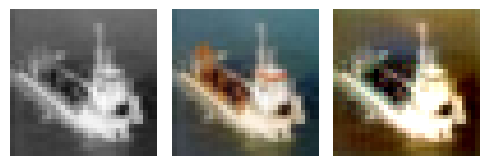

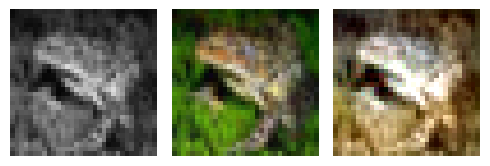

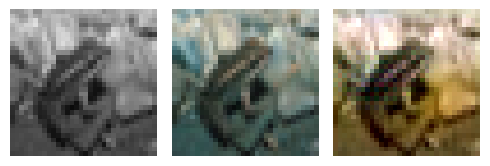

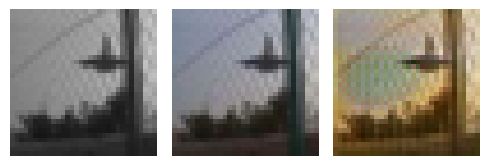

EPOCH: 85.760  trn_loss: 0.005  (6649.74s - 1104.14s remaining)

EPOCH: 85.765  trn_loss: 0.005  (6650.09s - 1103.73s remaining)

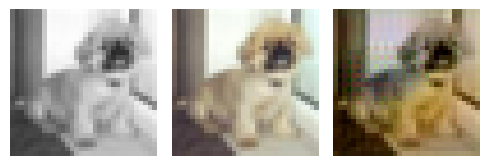

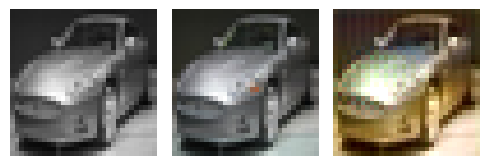

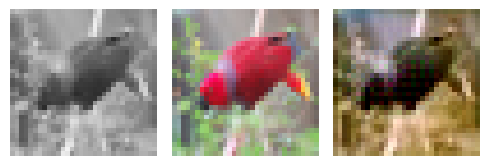

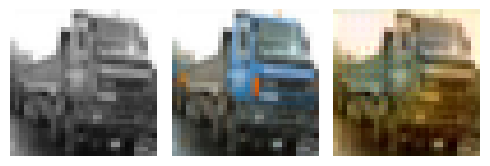

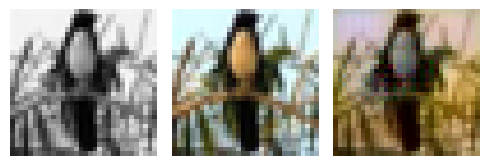

EPOCH: 86.000  val_loss: 0.003  (6675.09s - 1086.64s remaining)

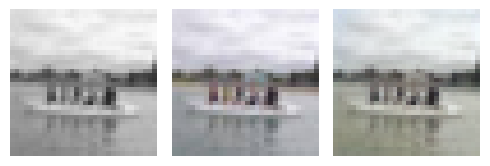

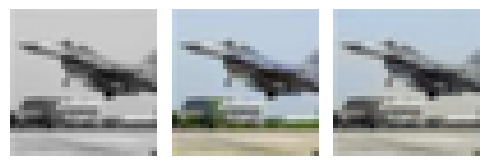

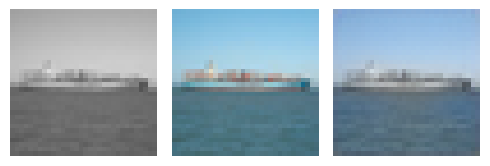

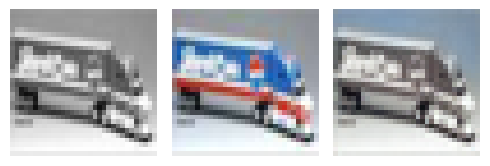

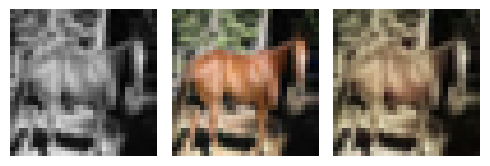

EPOCH: 86.250  trn_loss: 0.005  (6693.12s - 1067.02s remaining)

EPOCH: 86.255  trn_loss: 0.005  (6693.49s - 1066.62s remaining)

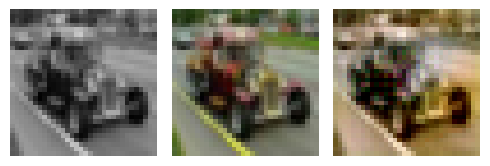

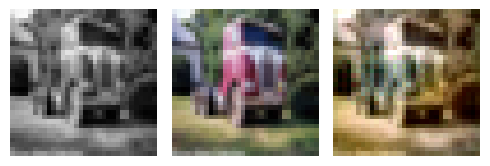

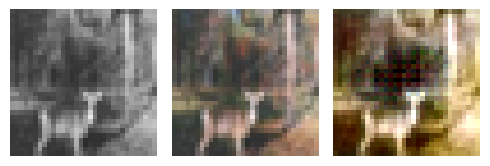

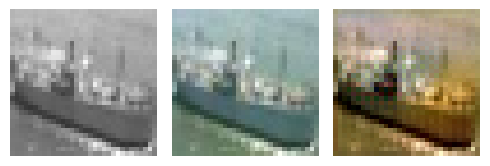

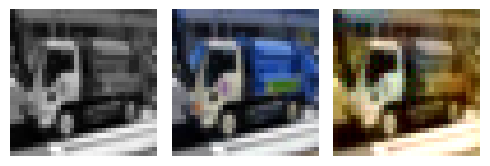

EPOCH: 86.505  trn_loss: 0.004  (6711.70s - 1047.03s remaining)

EPOCH: 86.510  trn_loss: 0.005  (6712.04s - 1046.63s remaining)

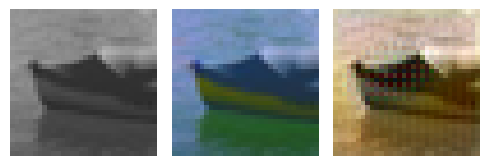

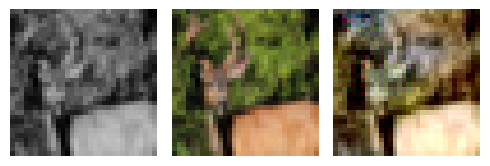

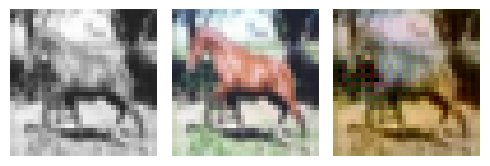

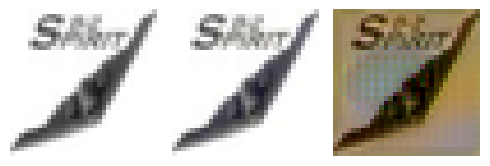

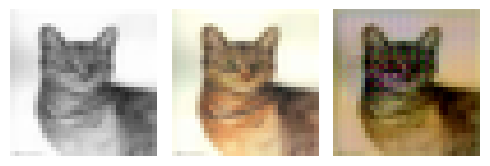

EPOCH: 86.760  trn_loss: 0.005  (6730.27s - 1027.05s remaining)

EPOCH: 86.765  trn_loss: 0.005  (6730.66s - 1026.66s remaining)

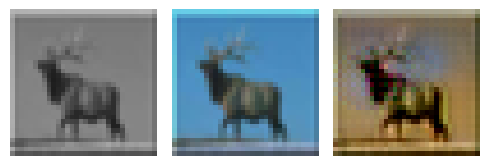

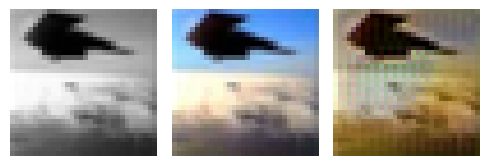

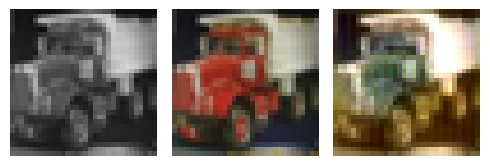

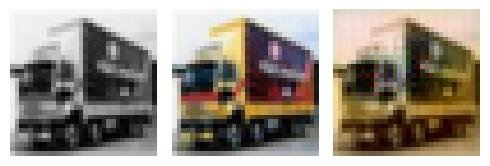

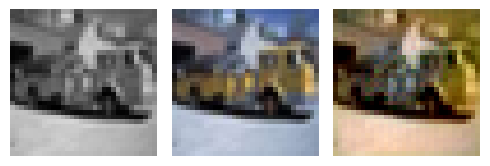

EPOCH: 86.975  val_loss: 0.005  (6755.56s - 1011.68s remaining)

EPOCH: 87.000  val_loss: 0.003  (6755.58s - 1009.46s remaining)

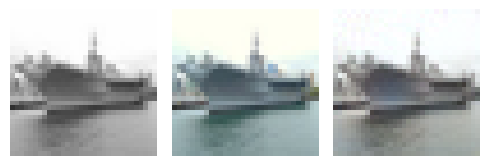

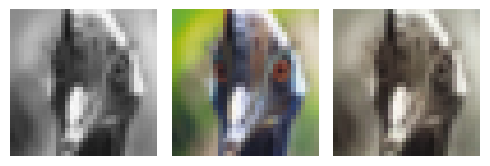

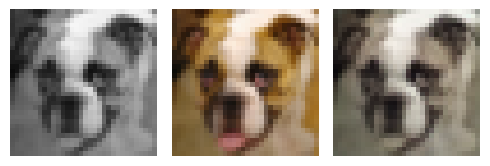

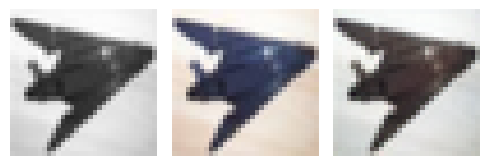

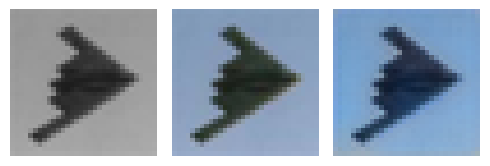

EPOCH: 87.250  trn_loss: 0.004  (6773.63s - 989.84s remaining)

EPOCH: 87.255  trn_loss: 0.005  (6773.98s - 989.44s remaining)

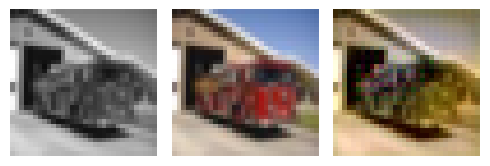

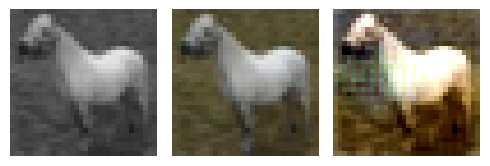

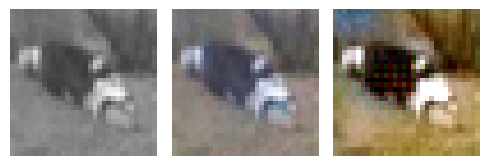

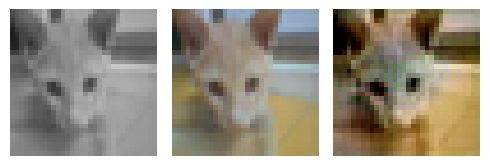

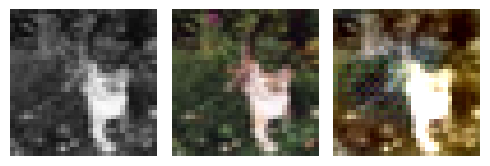

EPOCH: 87.505  trn_loss: 0.005  (6792.73s - 969.94s remaining)

EPOCH: 87.510  trn_loss: 0.005  (6793.10s - 969.54s remaining)

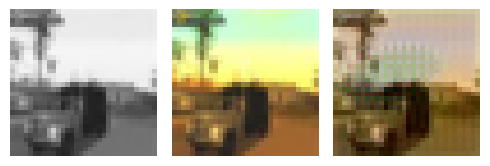

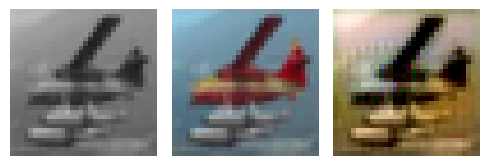

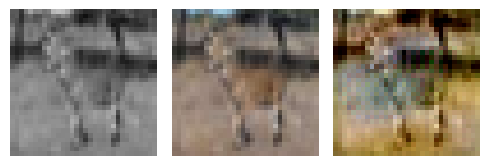

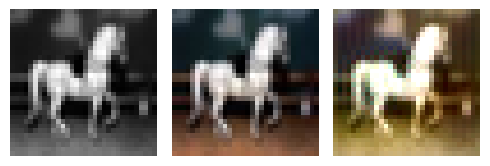

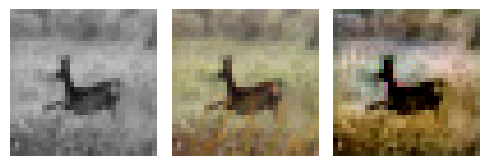

EPOCH: 87.760  trn_loss: 0.004  (6811.36s - 949.97s remaining)

EPOCH: 87.765  trn_loss: 0.005  (6811.70s - 949.57s remaining)

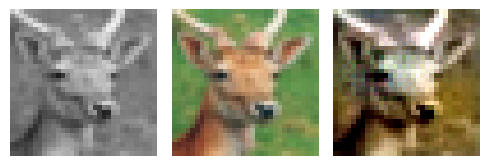

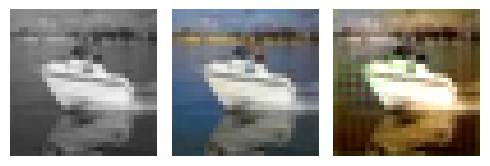

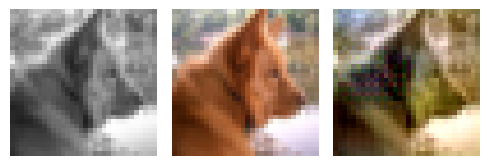

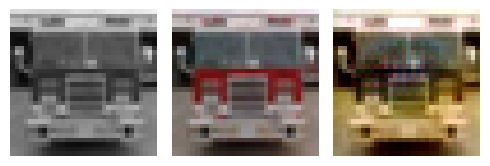

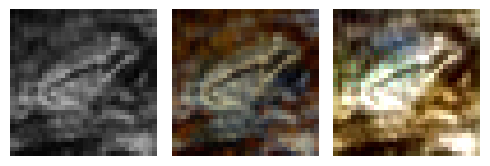

EPOCH: 88.000  val_loss: 0.003  (6836.40s - 932.24s remaining)

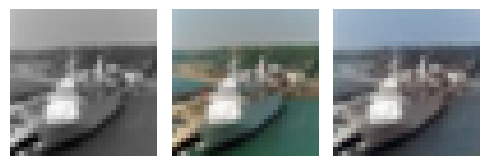

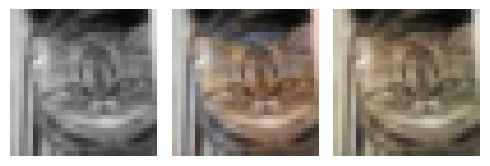

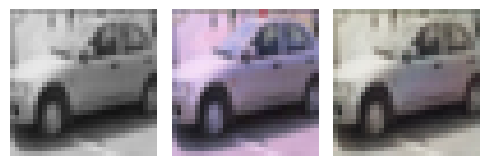

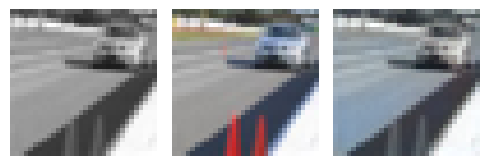

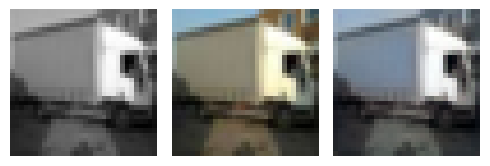

EPOCH: 88.250  trn_loss: 0.005  (6854.68s - 912.66s remaining)

EPOCH: 88.255  trn_loss: 0.005  (6855.04s - 912.26s remaining)

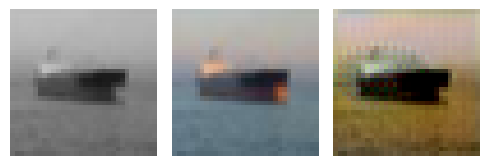

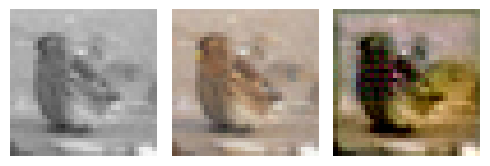

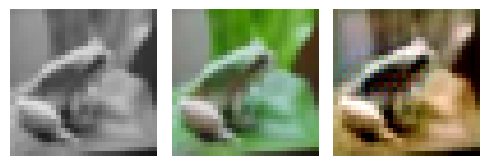

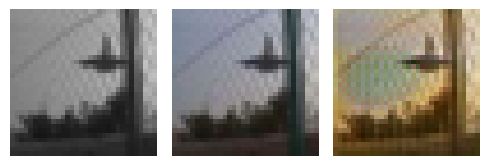

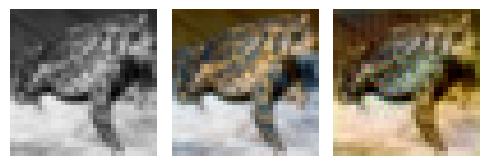

EPOCH: 88.510  trn_loss: 0.004  (6873.57s - 892.28s remaining)

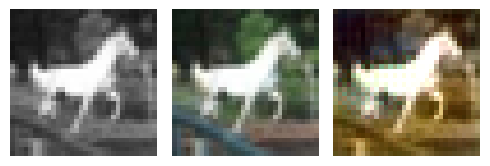

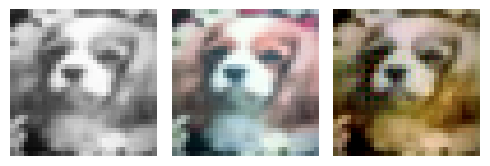

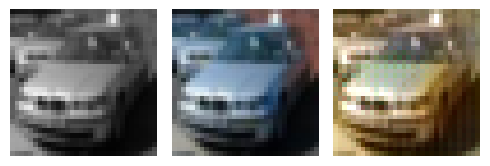

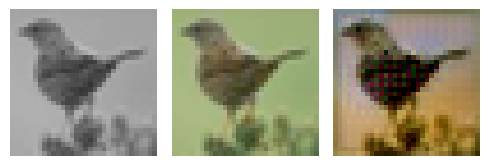

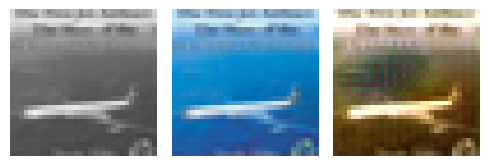

EPOCH: 88.760  trn_loss: 0.004  (6892.55s - 872.81s remaining)

EPOCH: 88.765  trn_loss: 0.005  (6892.90s - 872.41s remaining)

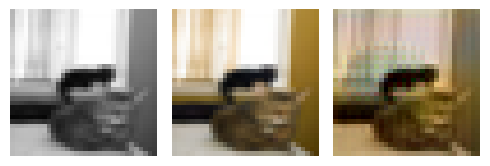

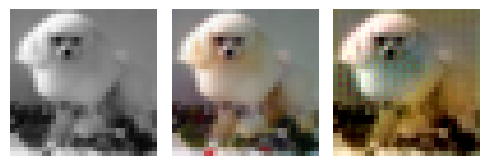

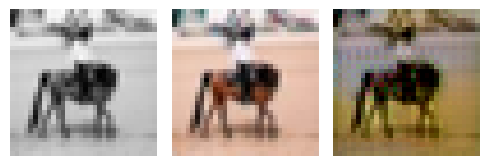

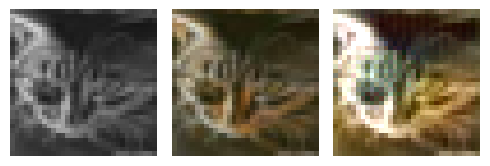

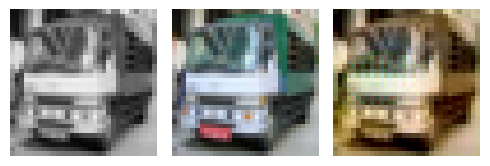

EPOCH: 89.000  val_loss: 0.003  (6917.91s - 855.02s remaining)

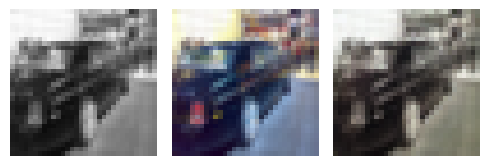

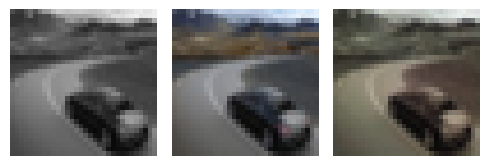

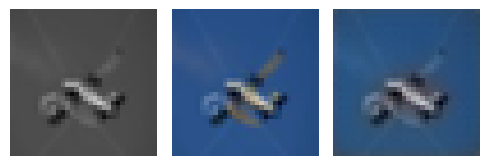

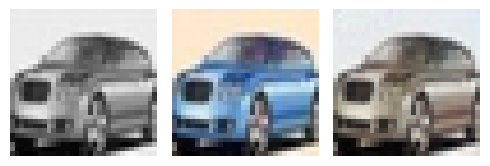

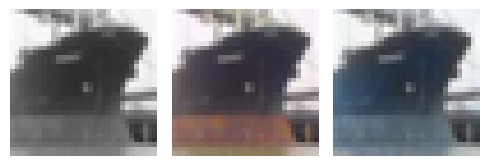

EPOCH: 89.250  trn_loss: 0.005  (6936.41s - 835.48s remaining)

EPOCH: 89.255  trn_loss: 0.005  (6936.76s - 835.08s remaining)

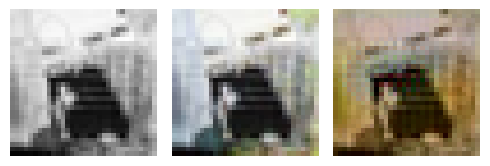

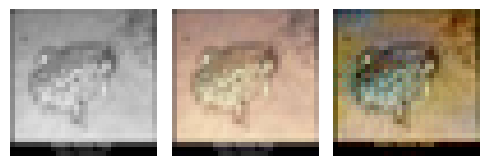

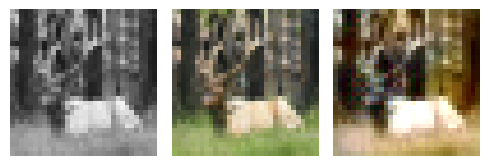

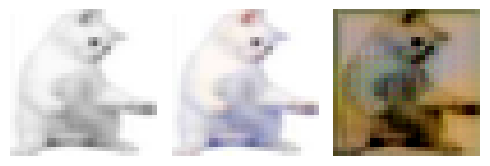

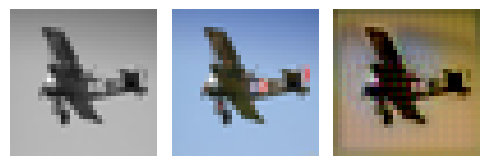

EPOCH: 89.505  trn_loss: 0.005  (6954.97s - 815.50s remaining)

EPOCH: 89.510  trn_loss: 0.004  (6955.31s - 815.10s remaining)

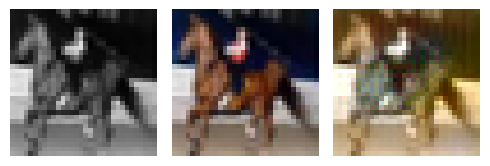

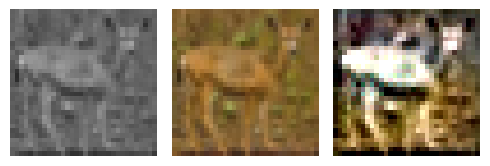

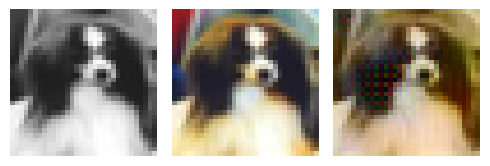

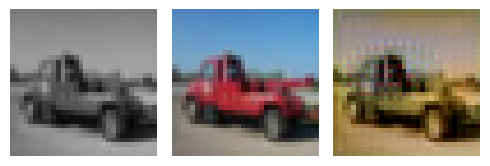

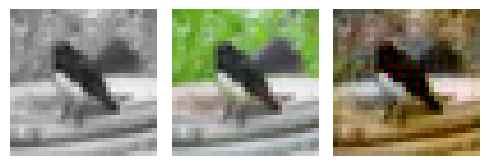

EPOCH: 89.760  trn_loss: 0.004  (6973.91s - 795.58s remaining)

EPOCH: 89.765  trn_loss: 0.004  (6974.27s - 795.18s remaining)

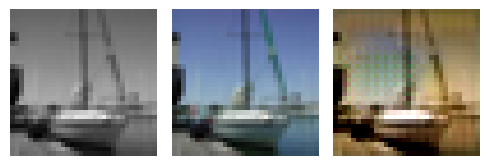

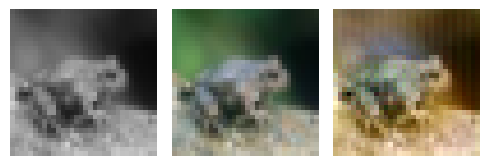

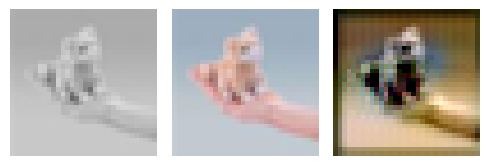

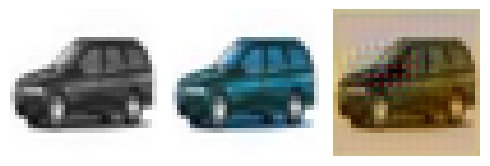

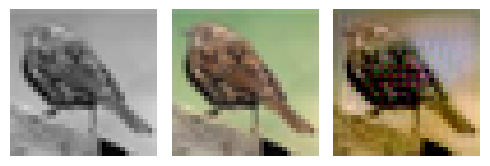

EPOCH: 90.000  trn_loss: 0.005  val_loss: 0.005  (6999.15s - 777.68s remaining)


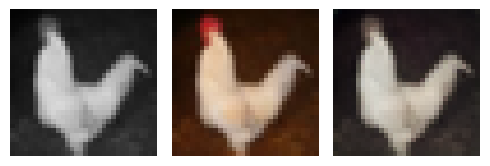

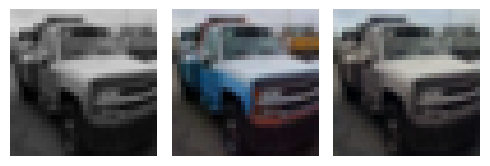

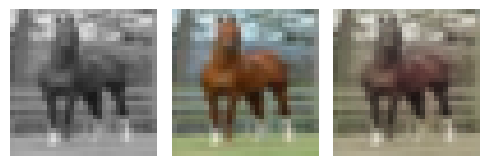

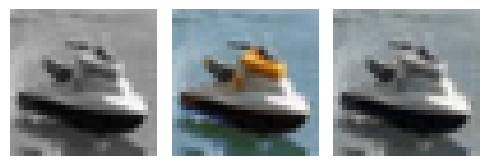

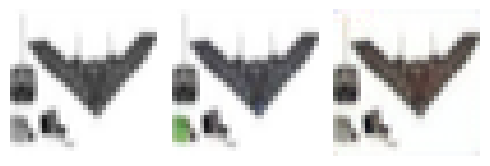

EPOCH: 90.250  trn_loss: 0.005  (7017.31s - 758.10s remaining)

EPOCH: 90.255  trn_loss: 0.004  (7017.67s - 757.70s remaining)

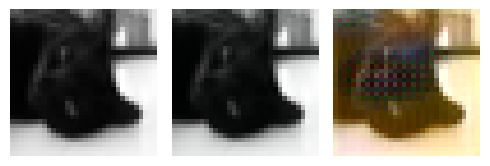

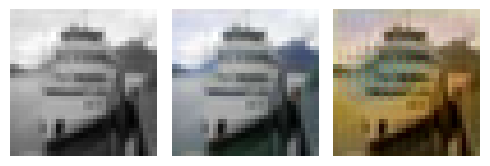

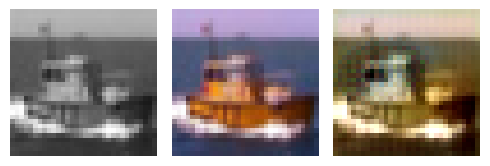

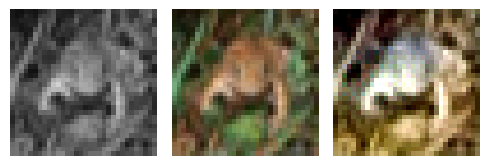

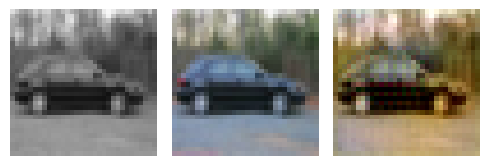

EPOCH: 90.505  trn_loss: 0.005  (7035.81s - 738.13s remaining)

EPOCH: 90.510  trn_loss: 0.005  (7036.17s - 737.73s remaining)

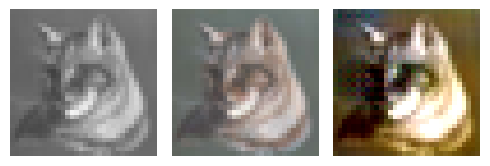

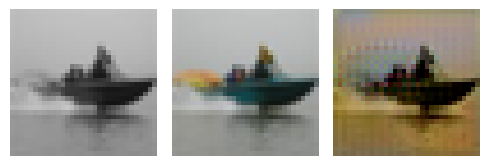

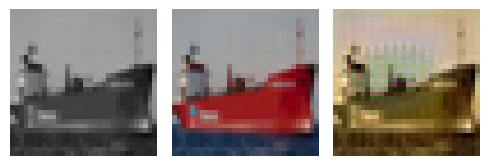

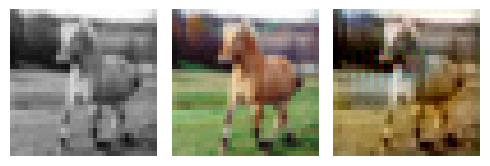

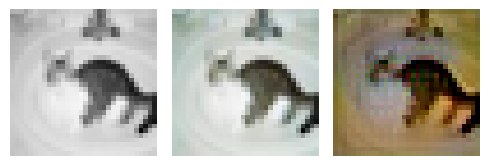

EPOCH: 90.765  trn_loss: 0.004  (7055.13s - 717.81s remaining)

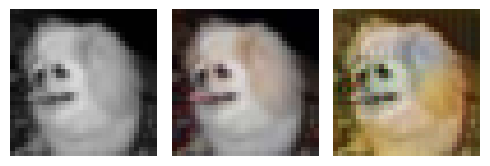

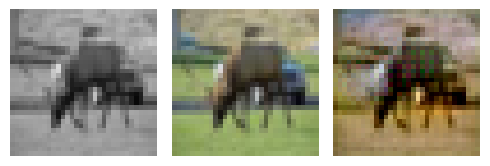

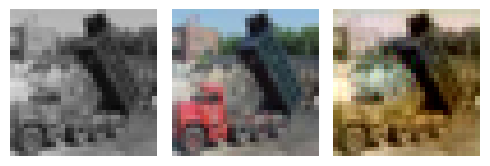

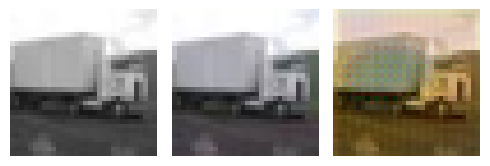

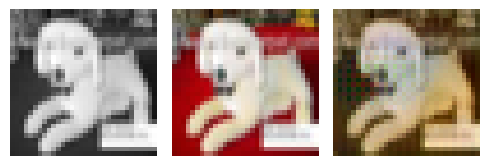

EPOCH: 91.000  val_loss: 0.003  (7080.04s - 700.22s remaining)

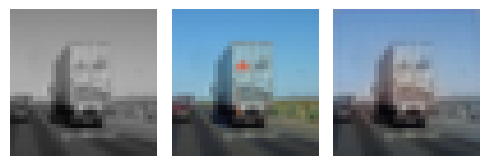

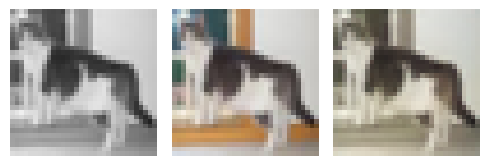

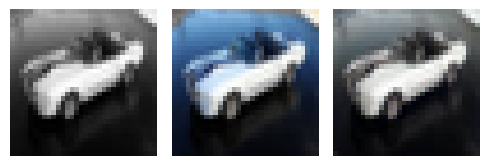

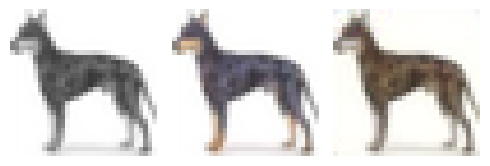

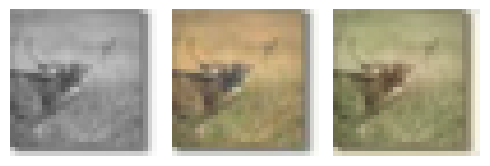

EPOCH: 91.250  trn_loss: 0.004  (7098.18s - 680.65s remaining)

EPOCH: 91.255  trn_loss: 0.005  (7098.52s - 680.25s remaining)

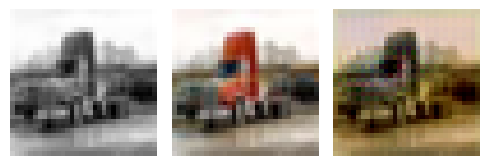

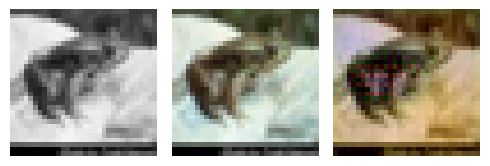

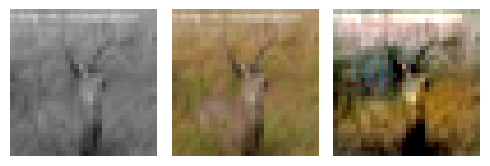

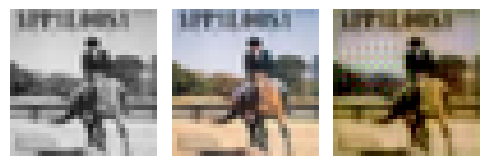

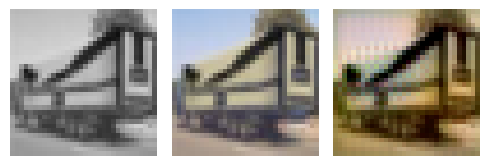

EPOCH: 91.505  trn_loss: 0.004  (7116.85s - 660.69s remaining)

EPOCH: 91.510  trn_loss: 0.005  (7117.22s - 660.29s remaining)

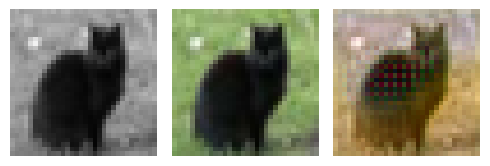

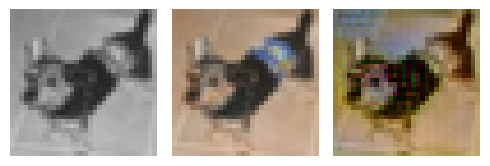

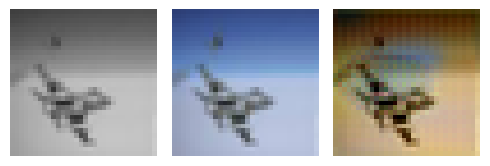

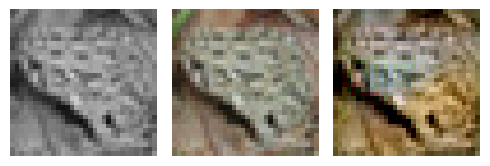

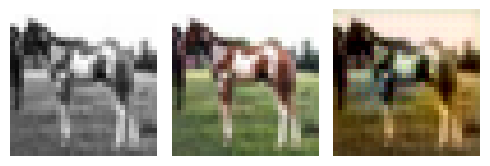

EPOCH: 91.760  trn_loss: 0.004  (7135.49s - 640.75s remaining)

EPOCH: 91.765  trn_loss: 0.004  (7135.84s - 640.35s remaining)

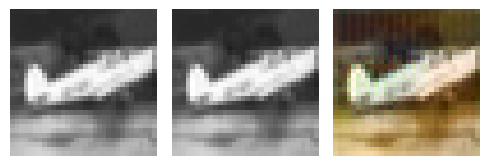

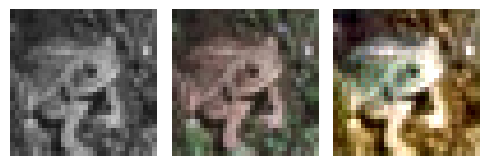

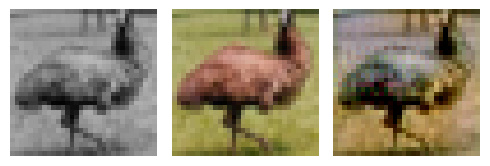

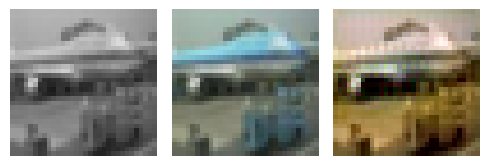

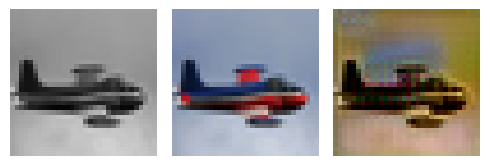

EPOCH: 92.000  val_loss: 0.003  (7160.95s - 622.69s remaining)

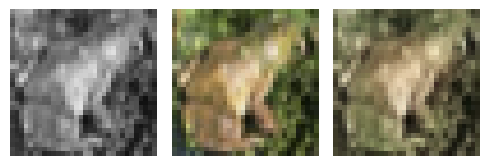

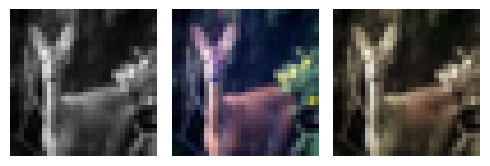

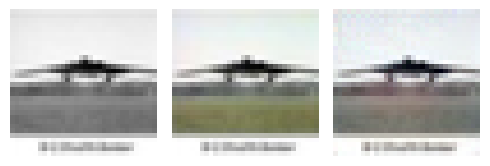

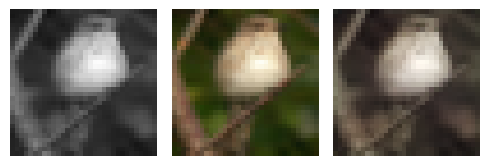

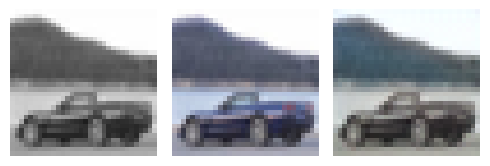

EPOCH: 92.250  trn_loss: 0.004  (7179.09s - 603.12s remaining)

EPOCH: 92.255  trn_loss: 0.005  (7179.46s - 602.72s remaining)

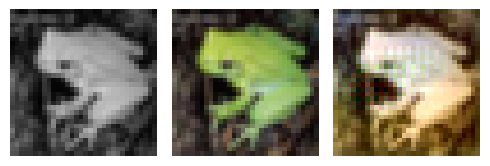

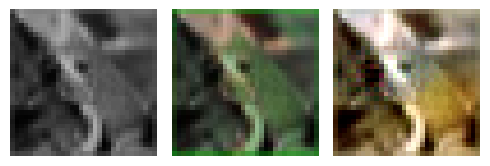

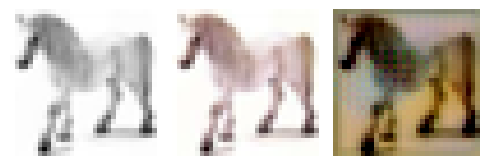

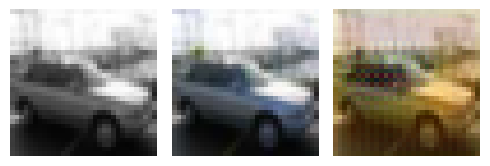

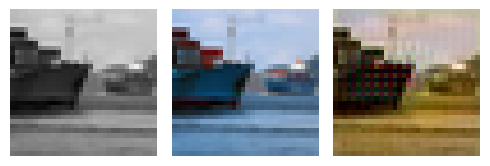

EPOCH: 92.505  trn_loss: 0.004  (7197.64s - 583.16s remaining)

EPOCH: 92.510  trn_loss: 0.005  (7197.98s - 582.76s remaining)

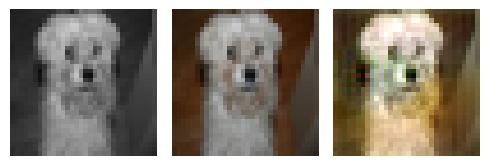

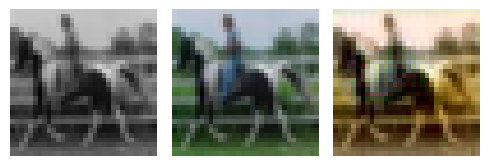

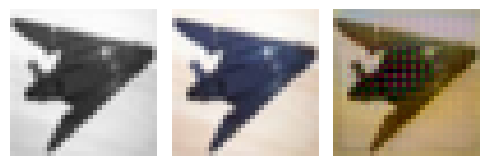

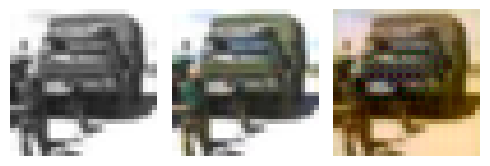

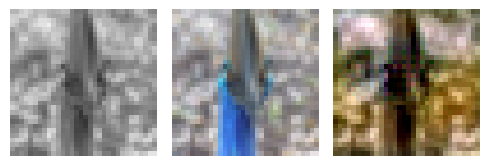

EPOCH: 92.760  trn_loss: 0.004  (7216.05s - 563.20s remaining)

EPOCH: 92.765  trn_loss: 0.005  (7216.41s - 562.80s remaining)

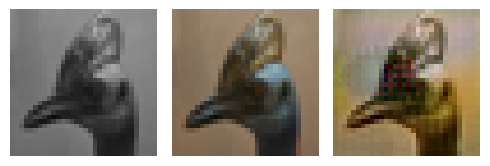

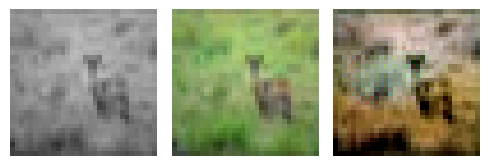

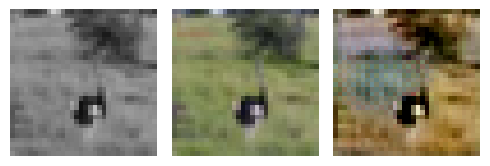

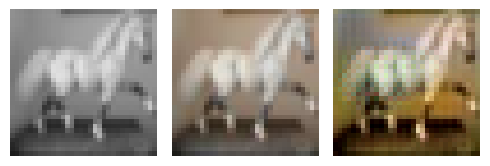

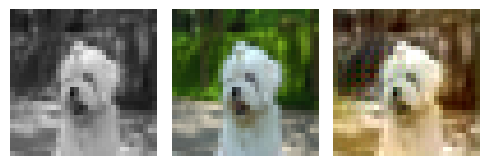

EPOCH: 93.000  val_loss: 0.003  (7241.76s - 545.08s remaining)

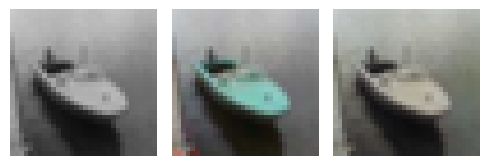

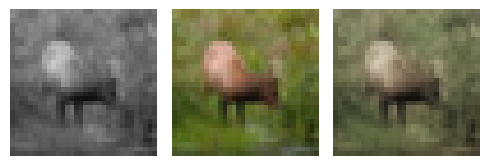

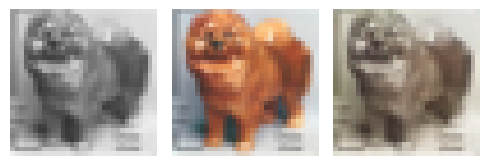

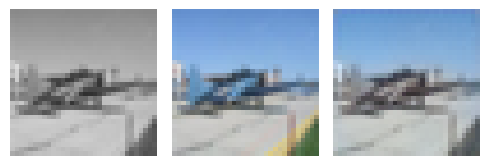

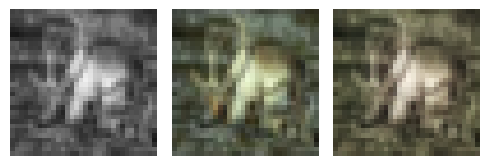

EPOCH: 93.250  trn_loss: 0.005  (7259.94s - 525.52s remaining)

EPOCH: 93.255  trn_loss: 0.004  (7260.28s - 525.12s remaining)

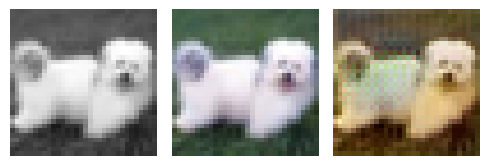

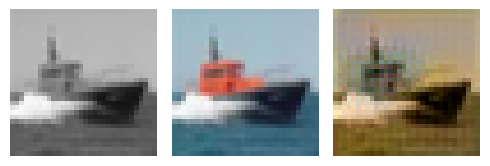

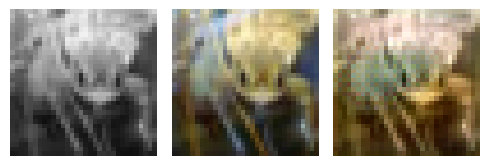

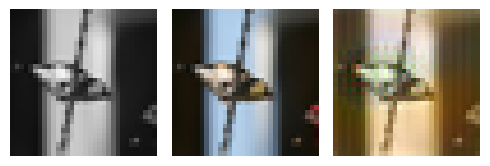

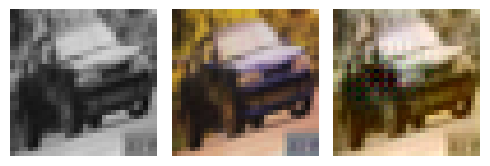

EPOCH: 93.505  trn_loss: 0.004  (7278.49s - 505.57s remaining)

EPOCH: 93.510  trn_loss: 0.004  (7278.84s - 505.17s remaining)

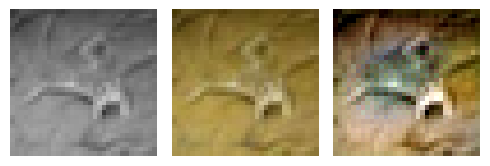

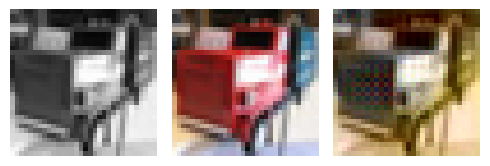

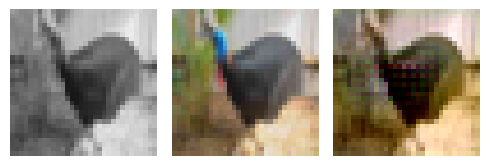

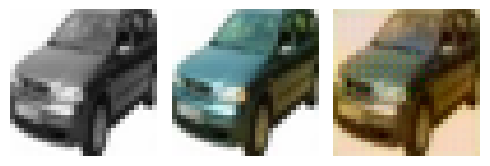

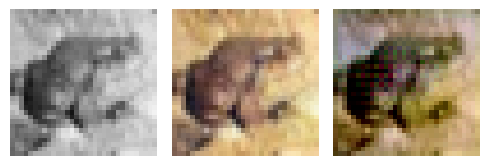

EPOCH: 93.760  trn_loss: 0.004  (7297.07s - 485.62s remaining)

EPOCH: 93.765  trn_loss: 0.004  (7297.42s - 485.22s remaining)

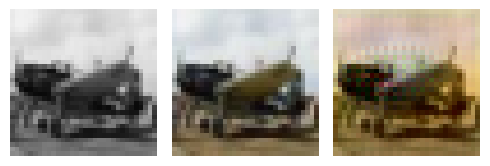

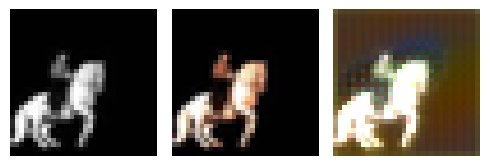

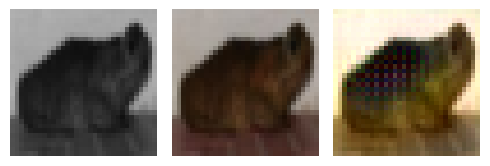

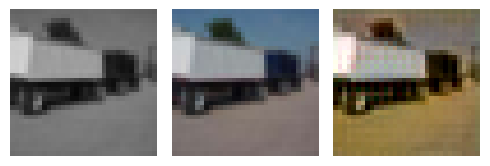

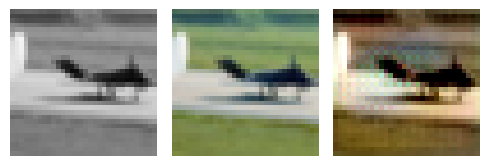

EPOCH: 93.950  val_loss: 0.005  (7322.51s - 471.54s remaining)

EPOCH: 94.000  val_loss: 0.003  (7322.73s - 467.41s remaining)

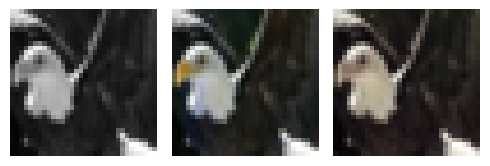

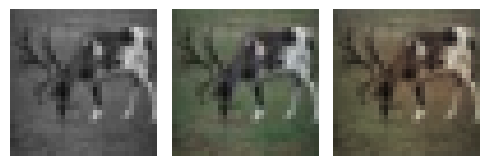

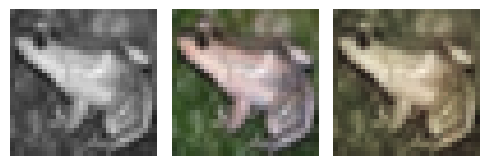

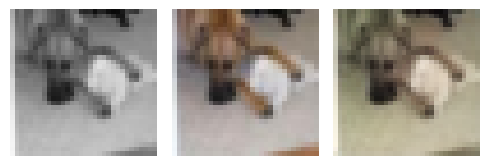

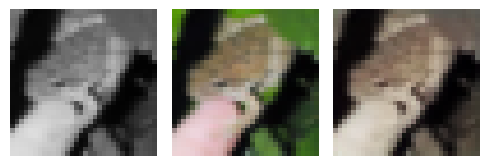

EPOCH: 94.250  trn_loss: 0.005  (7340.95s - 447.86s remaining)

EPOCH: 94.255  trn_loss: 0.005  (7341.30s - 447.46s remaining)

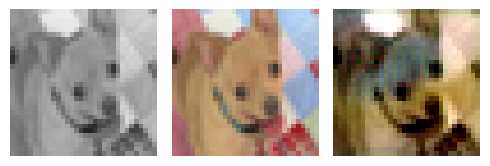

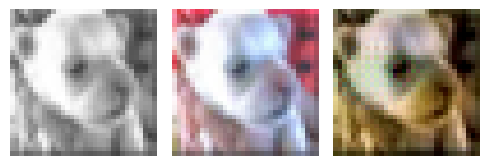

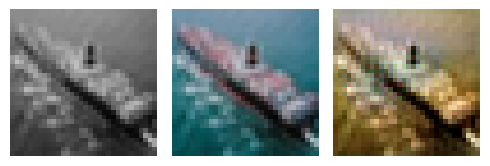

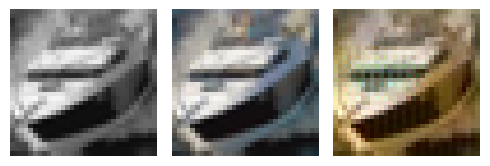

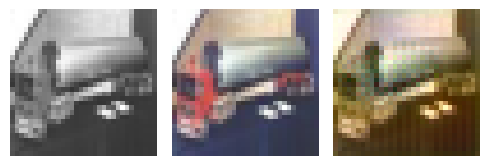

EPOCH: 94.505  trn_loss: 0.005  (7359.38s - 427.90s remaining)

EPOCH: 94.510  trn_loss: 0.005  (7359.73s - 427.50s remaining)

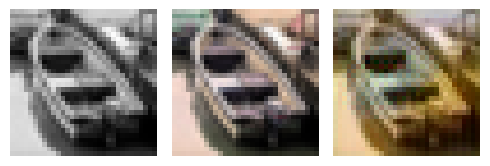

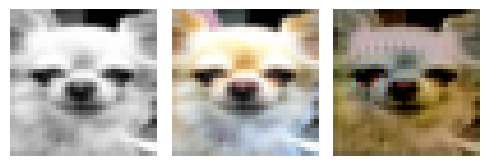

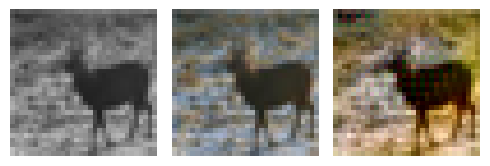

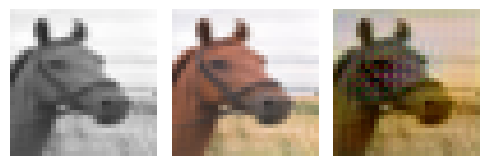

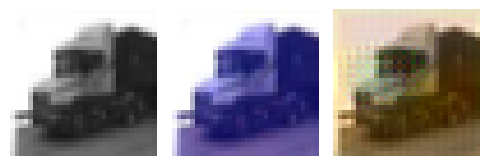

EPOCH: 94.760  trn_loss: 0.004  (7378.06s - 407.97s remaining)

EPOCH: 94.765  trn_loss: 0.005  (7378.41s - 407.57s remaining)

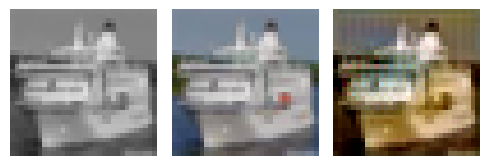

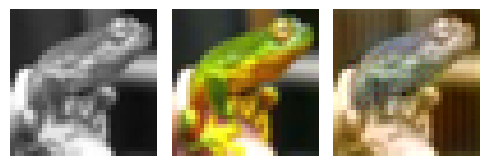

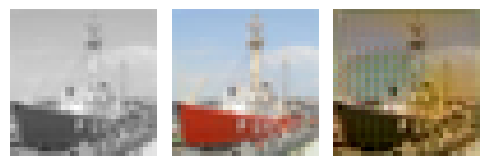

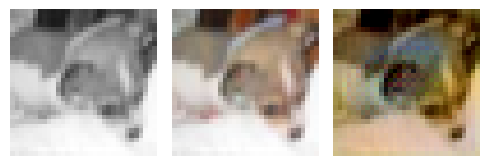

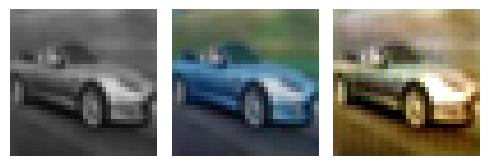

EPOCH: 95.000  trn_loss: 0.005  val_loss: 0.005  (7403.14s - 389.64s remaining)


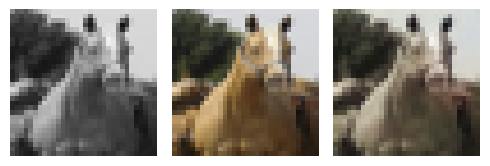

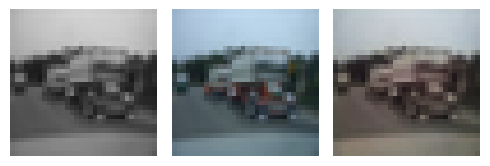

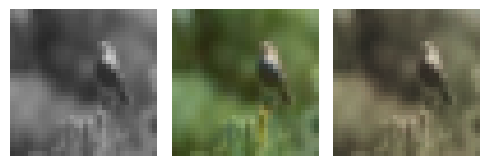

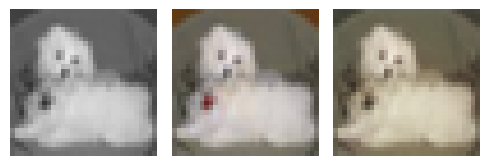

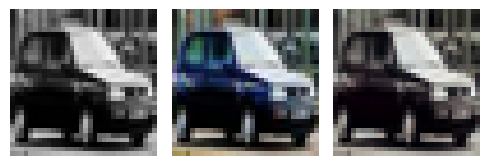

EPOCH: 95.250  trn_loss: 0.005  (7421.72s - 370.11s remaining)

EPOCH: 95.255  trn_loss: 0.004  (7422.08s - 369.71s remaining)

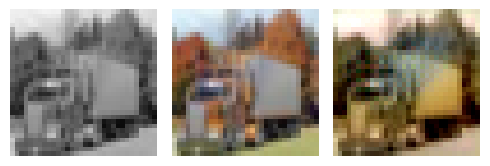

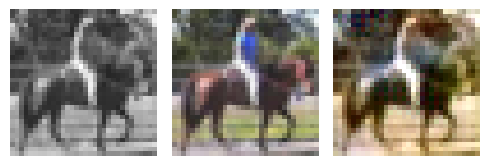

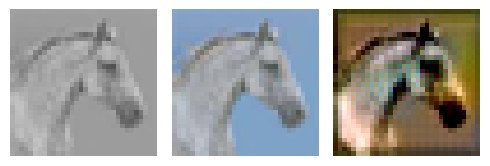

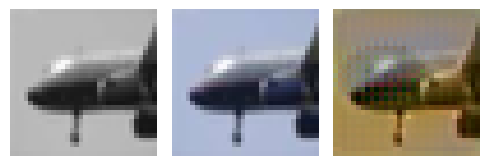

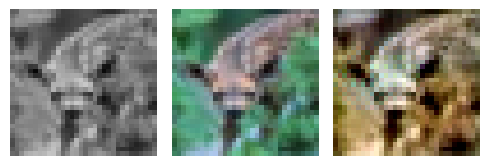

EPOCH: 95.505  trn_loss: 0.005  (7440.22s - 350.17s remaining)

EPOCH: 95.510  trn_loss: 0.005  (7440.56s - 349.77s remaining)

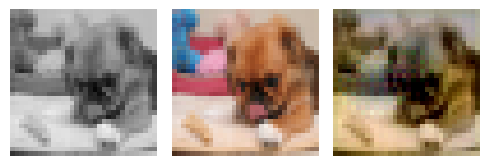

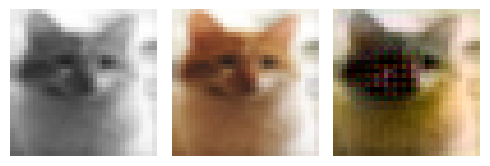

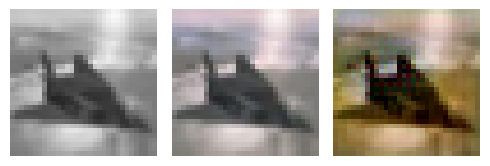

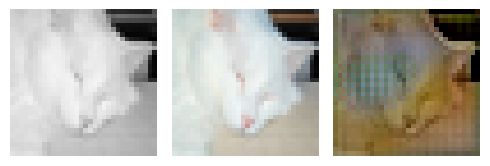

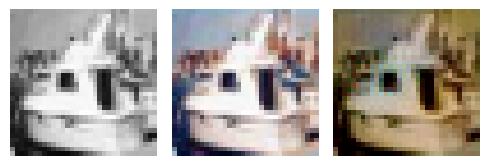

EPOCH: 95.760  trn_loss: 0.004  (7458.98s - 330.25s remaining)

EPOCH: 95.765  trn_loss: 0.005  (7459.34s - 329.85s remaining)

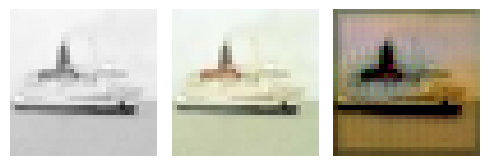

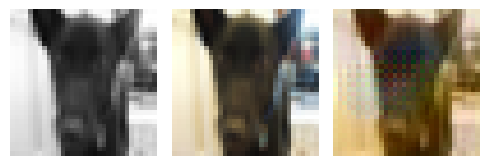

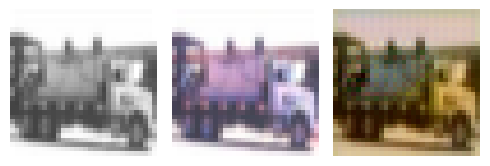

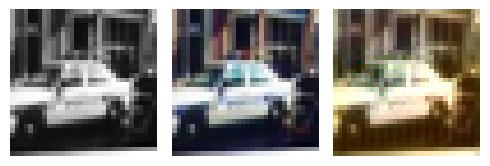

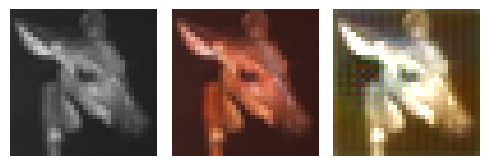

EPOCH: 96.000  val_loss: 0.003  (7484.24s - 311.84s remaining)

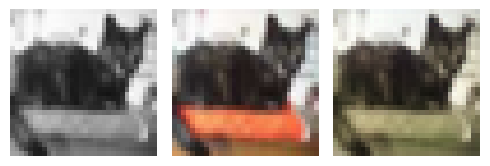

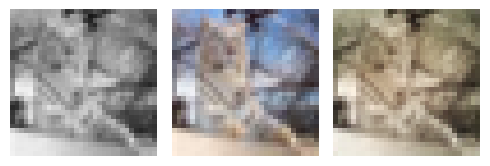

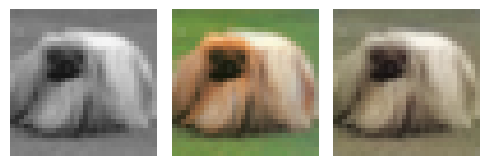

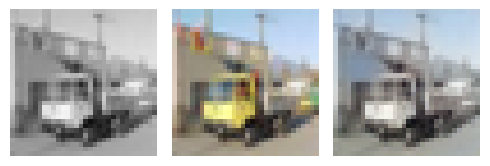

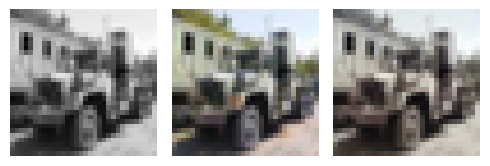

EPOCH: 96.250  trn_loss: 0.004  (7502.81s - 292.32s remaining)

EPOCH: 96.255  trn_loss: 0.004  (7503.17s - 291.92s remaining)

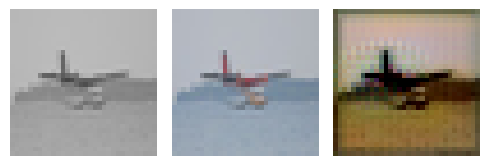

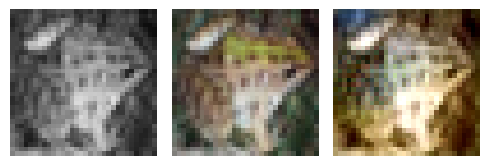

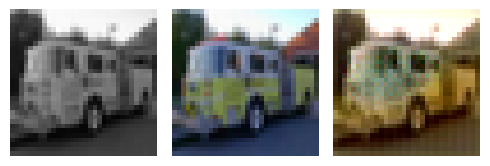

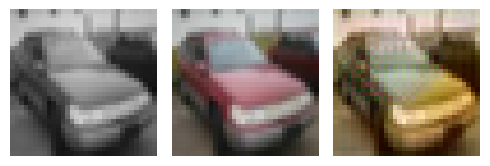

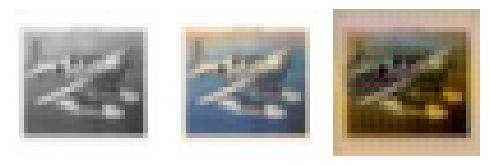

EPOCH: 96.505  trn_loss: 0.004  (7521.42s - 272.39s remaining)

EPOCH: 96.510  trn_loss: 0.005  (7521.77s - 271.99s remaining)

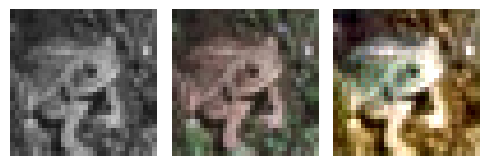

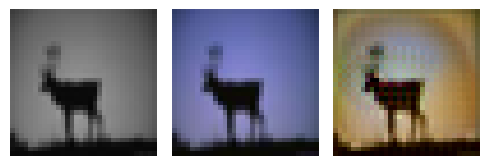

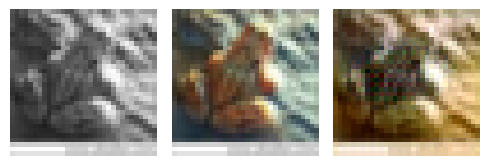

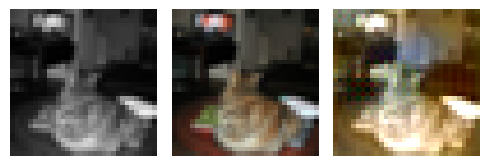

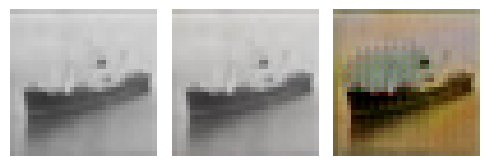

EPOCH: 96.760  trn_loss: 0.004  (7539.55s - 252.44s remaining)

EPOCH: 96.765  trn_loss: 0.005  (7539.90s - 252.05s remaining)

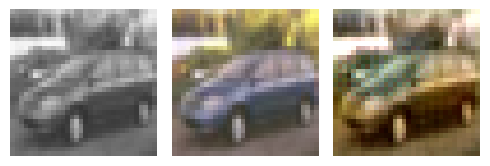

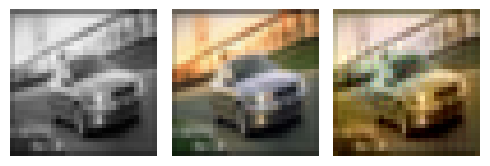

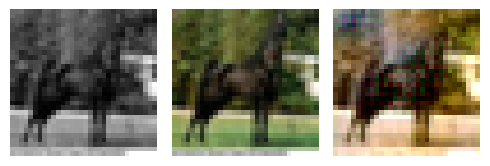

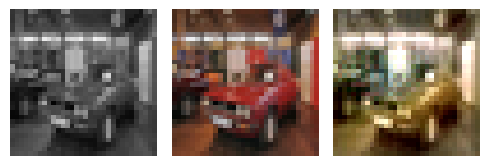

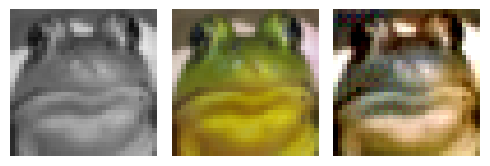

EPOCH: 97.000  val_loss: 0.003  (7564.74s - 233.96s remaining)

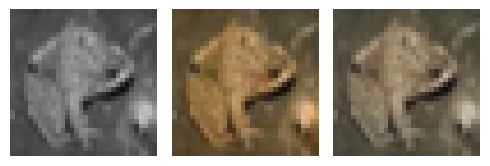

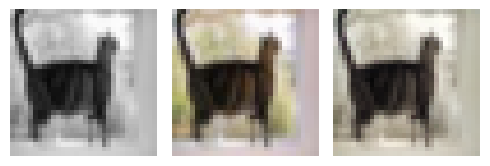

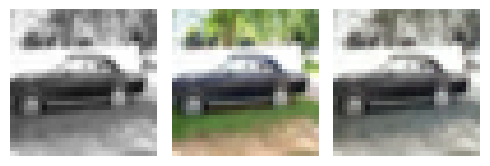

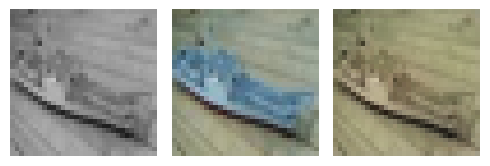

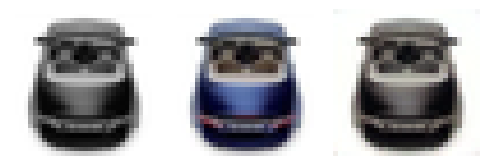

EPOCH: 97.250  trn_loss: 0.005  (7583.37s - 214.44s remaining)

EPOCH: 97.255  trn_loss: 0.004  (7583.72s - 214.04s remaining)

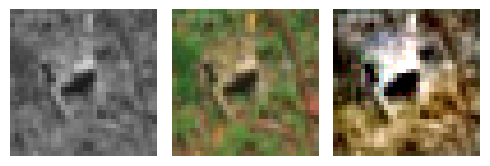

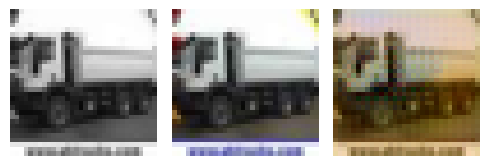

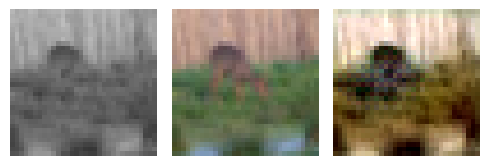

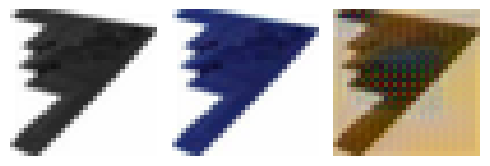

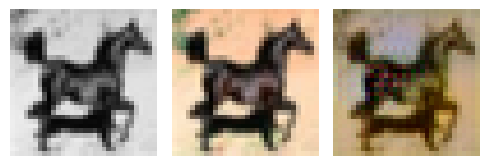

EPOCH: 97.505  trn_loss: 0.005  (7601.94s - 194.51s remaining)

EPOCH: 97.510  trn_loss: 0.005  (7602.31s - 194.12s remaining)

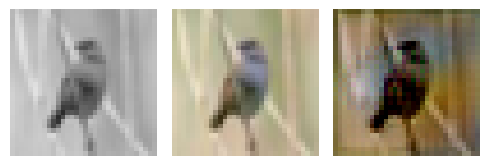

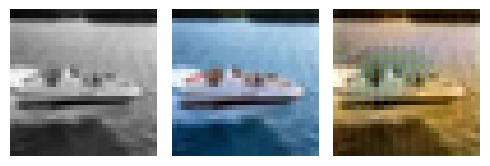

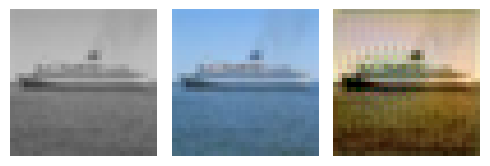

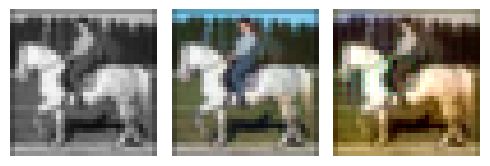

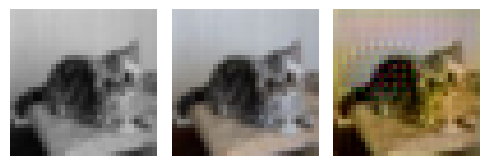

EPOCH: 97.760  trn_loss: 0.005  (7620.45s - 174.59s remaining)

EPOCH: 97.765  trn_loss: 0.004  (7620.80s - 174.19s remaining)

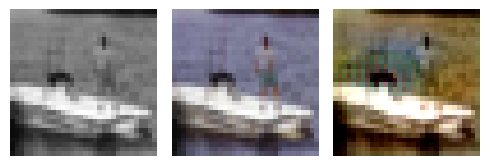

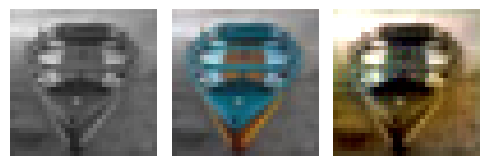

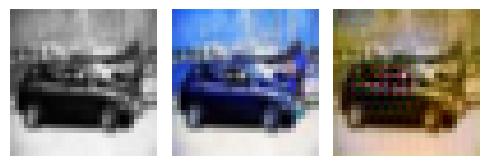

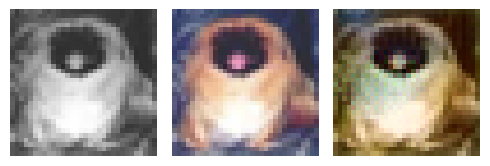

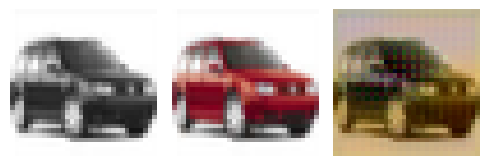

EPOCH: 98.000  val_loss: 0.003  (7645.84s - 156.04s remaining)

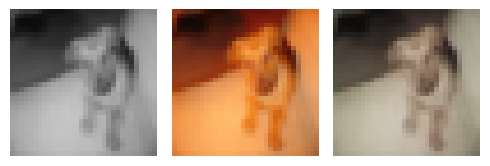

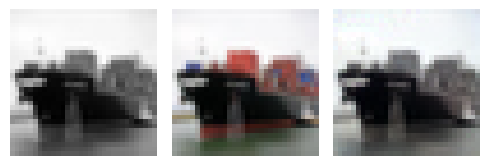

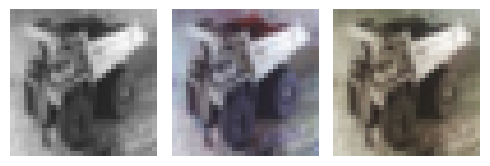

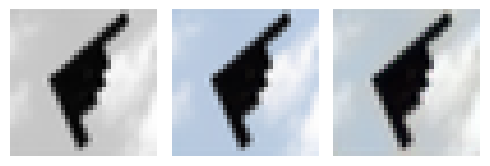

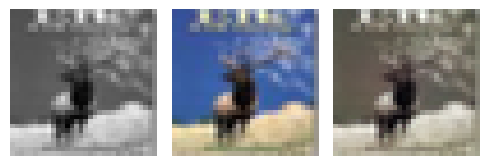

EPOCH: 98.250  trn_loss: 0.004  (7664.34s - 136.52s remaining)

EPOCH: 98.255  trn_loss: 0.006  (7664.69s - 136.12s remaining)

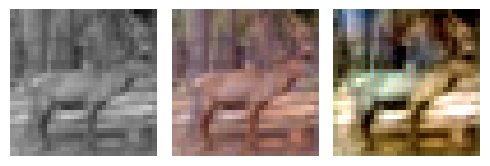

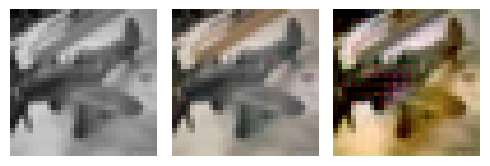

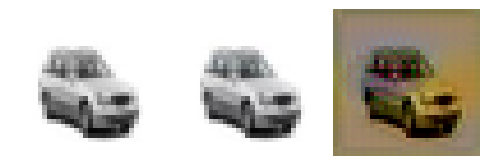

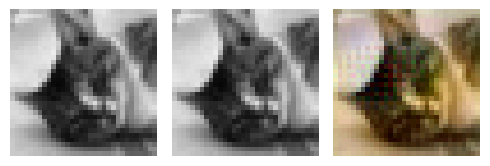

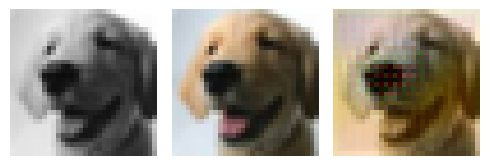

EPOCH: 98.505  trn_loss: 0.004  (7682.79s - 116.59s remaining)

EPOCH: 98.510  trn_loss: 0.004  (7683.14s - 116.19s remaining)

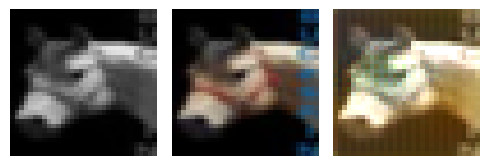

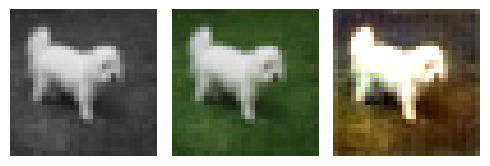

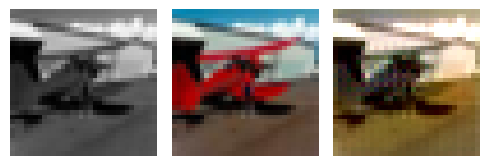

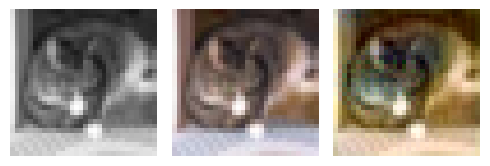

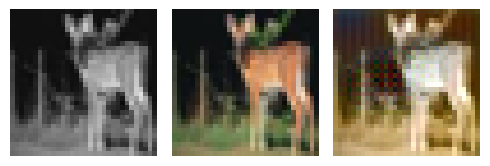

EPOCH: 98.760  trn_loss: 0.004  (7701.56s - 96.68s remaining)

EPOCH: 98.765  trn_loss: 0.005  (7701.91s - 96.28s remaining)

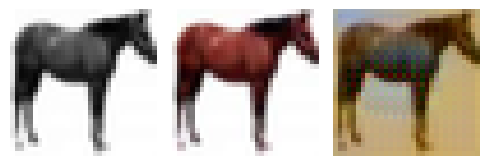

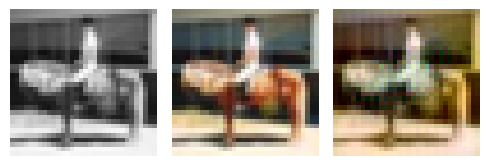

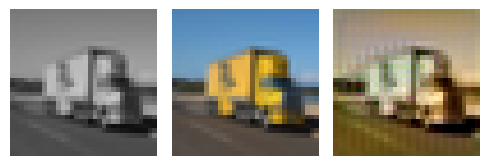

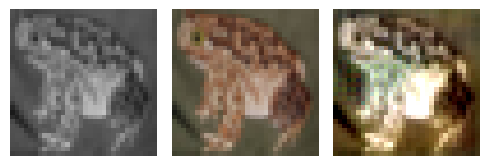

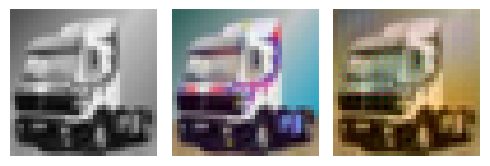

EPOCH: 98.950  val_loss: 0.005  (7726.34s - 81.99s remaining)

EPOCH: 99.000  val_loss: 0.003  (7726.56s - 78.05s remaining)

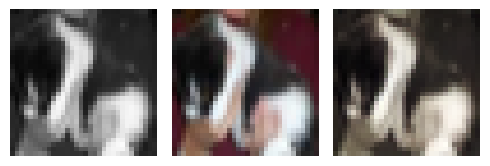

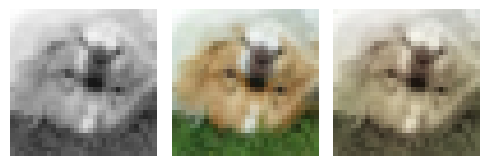

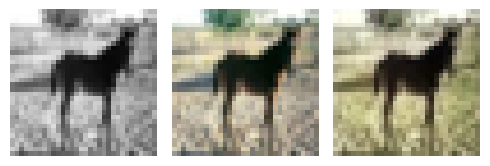

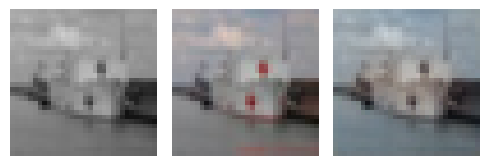

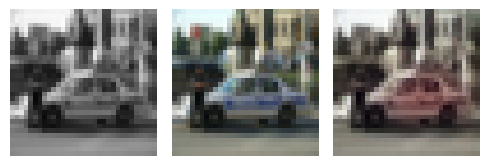

EPOCH: 99.250  trn_loss: 0.005  (7744.83s - 58.53s remaining)

EPOCH: 99.255  trn_loss: 0.005  (7745.19s - 58.13s remaining)

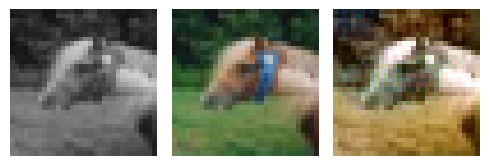

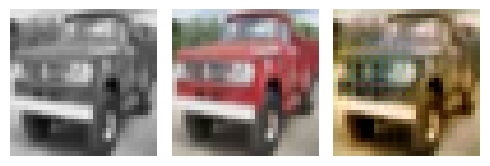

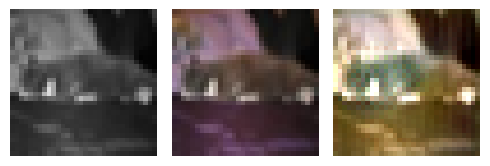

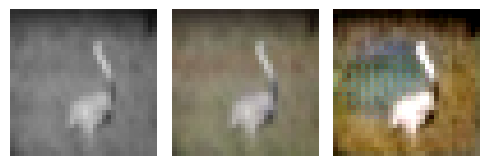

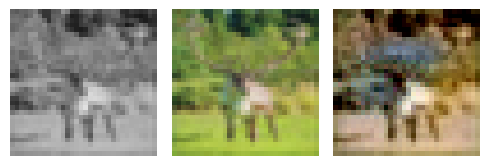

EPOCH: 99.505  trn_loss: 0.005  (7763.74s - 38.61s remaining)

EPOCH: 99.510  trn_loss: 0.004  (7764.09s - 38.22s remaining)

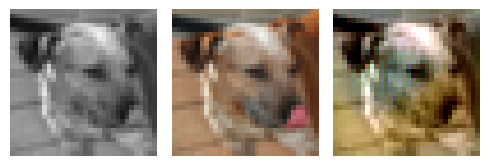

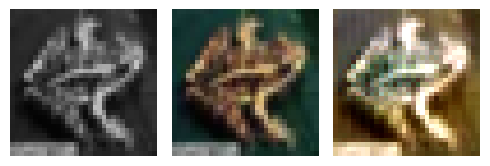

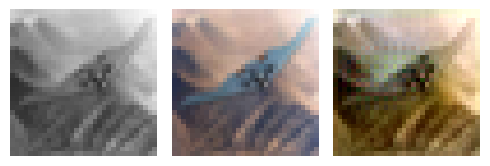

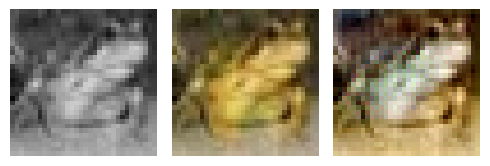

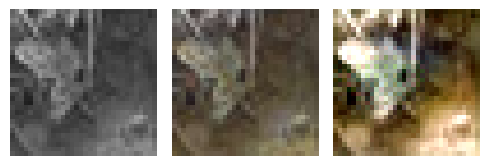

EPOCH: 99.760  trn_loss: 0.004  (7782.28s - 18.71s remaining)

EPOCH: 99.765  trn_loss: 0.004  (7782.63s - 18.31s remaining)

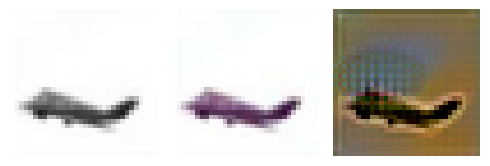

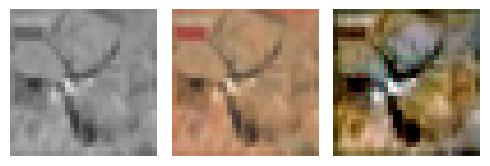

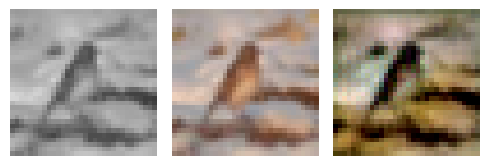

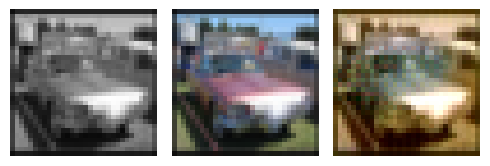

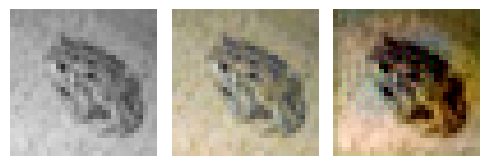

EPOCH: 100.000  trn_loss: 0.005  val_loss: 0.005  (7807.62s - 0.00s remaining)


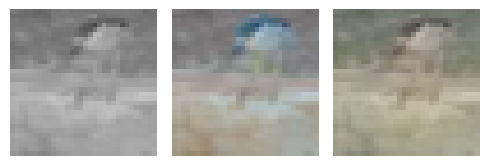

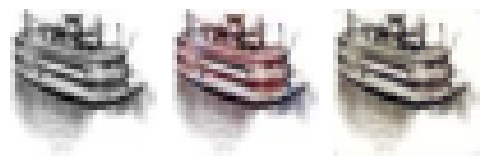

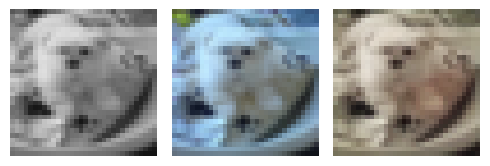

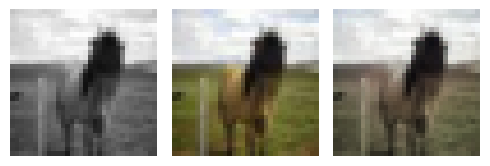

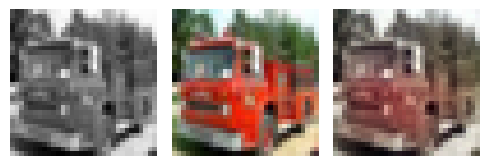

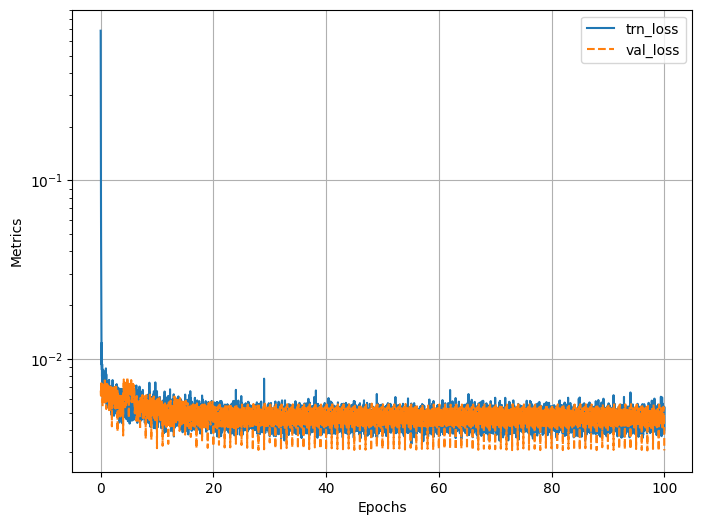

In [29]:
model, optimizer, criterion = get_model()
exp_lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

_val_dl = DataLoader(val_ds, batch_size=1, shuffle=True)

n_epochs = 100
log = Report(n_epochs)
for ex in range(n_epochs):
    N = len(trn_dl)
    for bx, data in enumerate(trn_dl):
        loss = train_batch(model, data, optimizer, criterion)
        log.record(ex+(bx+1)/N, trn_loss=loss, end='\r')
        if (bx+1)%50 == 0:
            for _ in range(5):
                a,b = next(iter(_val_dl))
                _b = model(a)
                subplots([a[0], b[0], _b[0]], nc=3, figsize=(5,5))

    N = len(val_dl)
    for bx, data in enumerate(val_dl):
        loss = validate_batch(model, data, criterion)
        log.record(ex+(bx+1)/N, val_loss=loss, end='\r')

    exp_lr_scheduler.step()
    if (ex+1) % 5 == 0: log.report_avgs(ex+1)

    for _ in range(5):
        a,b = next(iter(_val_dl))
        _b = model(a)
        subplots([a[0], b[0], _b[0]], nc=3, figsize=(5,5))

log.plot(log=True)

100%|██████████| 201/201 [00:00<00:00, 277.09it/s]


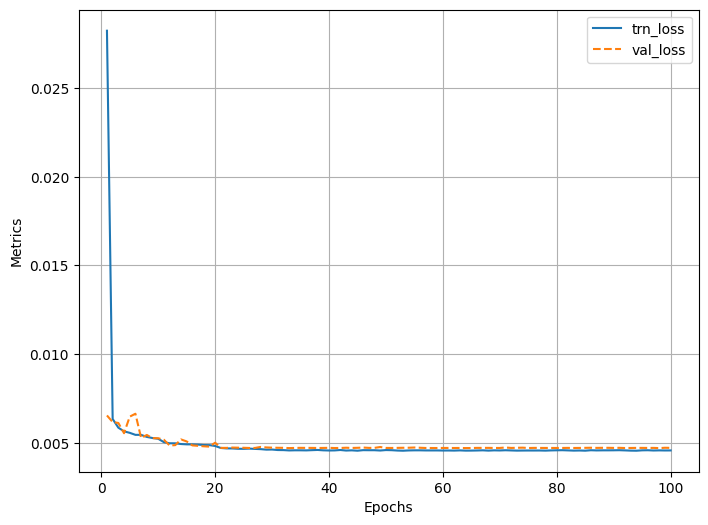

In [30]:

log.plot_epochs()

In [31]:
torch.save(model.to('cpu').state_dict(), 'mymodel.pth')

In [32]:
model.state_dict()

OrderedDict([('d1.model.1.weight',
              tensor([[[[-1.1089e-01, -1.1186e-01,  6.0878e-02],
                        [-5.0333e-03, -3.3017e-03,  1.3314e-01],
                        [ 6.3877e-02,  5.0701e-02,  1.7805e-02]],
              
                       [[-1.7384e-01, -1.0226e-01, -8.8557e-02],
                        [-1.7034e-01, -1.0819e-01,  1.7876e-01],
                        [-1.2781e-01,  7.0783e-02,  1.2701e-01]],
              
                       [[-4.7011e-02,  3.9422e-02, -1.4182e-01],
                        [ 1.3364e-01,  6.4950e-02,  6.6421e-02],
                        [ 4.1647e-02, -1.2711e-02,  1.5963e-01]]],
              
              
                      [[[-7.2932e-02,  1.5681e-01,  1.2955e-01],
                        [-4.4853e-02, -2.4352e-02,  1.2757e-01],
                        [ 6.5655e-02, -1.2808e-01,  3.4760e-02]],
              
                       [[ 9.6053e-02, -9.9768e-02, -1.4641e-01],
                        [-5.0872e-02,  8

In [33]:
torch.save(model,'mymodel')